In [1]:
# import ants
import tifffile
import numpy as np
import os
# import cv2
import json
import time

import math
import pandas as pd
# import SimpleITK as sitk
import pickle

# import seaborn as sns
from scipy import stats
import gc
from tifffile import TiffFile
# from skimage import io
import tifffile
from scipy.ndimage import zoom
import traceback
import gzip
import shutil
from skimage import measure
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.mplot3d.art3d import Poly3DCollection

import cfospy
%matplotlib inline
import matplotlib.pyplot as plt

from multiprocessing import Pool
plt.gray()

import json, os.path, os, re, time
# import joblib
import subprocess as sp
# import nibabel as nib
import scipy.spatial
from scipy.signal import convolve
from matplotlib.colors import Normalize, LinearSegmentedColormap, BoundaryNorm, ListedColormap, hsv_to_rgb
from skimage import measure
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
import matplotlib.patches as patches

/home/gpu_data/data1/kinoshita


<Figure size 640x480 with 0 Axes>

In [2]:
class mapping_to_atlas():
    def __init__(self,data_atlas_path, ants_dir_name, data_ants_path, before_ants_file):
        self.ants_voxel_unit = Resize_um
        self.original_voxel_unit = Resize_um
        self.img_voxel_unit = Resize_um

        
        self.atlas_tif_path = data_atlas_path
        self.atlas_nii_path = self.atlas_tif_path.replace(".tif",".nii.gz")
        
        #for image size check
        
        
#         self.flip_tif_path =  os.path.join(data_parent_path,"{}/{}/ANTs/density_img_50um_flip.tif".format(organ_name,sample_name))
#         self.flip_txt_path = os.path.join(data_parent_path,"{}/{}/ANTs/flip_memo.txt".format(organ_name,sample_name))

        self.ants_dst_dir = os.path.join(data_ants_path, ants_dir_name+"/")
    
        self.sample_resize_img_path =  os.path.join(data_ants_path,before_ants_file)
        
        #self.flip_tif_path --->  self.sample_nii_path
        self.sample_nii_path = os.path.join(data_ants_path ,before_ants_file.replace(".tif",".nii.gz"))
        
        self.before_ants_np_path = os.path.join(data_ants_path,"all_points_um.npy")
        
        if not os.path.exists(self.ants_dst_dir):
            print("make ants folder {}".format(self.ants_dst_dir))
            os.makedirs(self.ants_dst_dir)
        else:
            print("{} already exists".format(self.ants_dst_dir))

        self.moving_nii_path = self.sample_nii_path
        
        self.output_nii_path = os.path.join(self.ants_dst_dir, "after_ants.nii.gz")
        
        self.prefix_ants ="/opt/ANTs/bin/"# "/usr/local/ANTs/"
        
#         self.moving_points_path = os.path.join(self.ants_dst_dir,"moving.csv")   #?
#         self.moved_points_path = os.path.join(self.ants_dst_dir,"moved.csv")#?
#         self.moved_denstity_path = os.path.join(self.ants_dst_dir,"moved_denstity.tif")
    
        
    def tif2nii(self, tif_path, nii_path, nii_voxel_unit):
        tif_img = tifffile.imread(tif_path)
#         nii_img = nib.Nifti1Image(np.swapaxes(tif_img,0,2), affine=None)
        nii_img = nib.Nifti1Image(tif_img, affine=None)
        aff = np.diag([-nii_voxel_unit,-nii_voxel_unit,nii_voxel_unit,1])
        nii_img.header.set_qform(aff, code=2)
        nii_img.to_filename(nii_path)
        return



    def run_antsRegistration(self,prefix_ants, atlas_file, moving_file, dst_dir, threads):
        cmd = "ITK_GLOBAL_DEFAULT_NUMBER_OF_THREADS={THREADS} && "
        cmd += "{EXECUTABLE} -d 3 "
        cmd += "--initial-moving-transform [{ATLAS_FILE},{MOVING_FILE},1] "
        cmd += "--interpolation Linear "
        cmd += "--use-histogram-matching 0 "
        cmd += "--winsorize-image-intensities [0.05,1.0] "  
        cmd += "--float 0 "
        cmd += "--output [{DST_PREFIX},{WARPED_FILE},{INVWARPED_FILE}] "
        cmd += "--transform Affine[0.1] --metric MI[{ATLAS_FILE},{MOVING_FILE},1,128,Regular,0.5] --convergence [10000x10000x10000,1e-5,15] --shrink-factors 4x2x1 --smoothing-sigmas 2x1x0vox "
        cmd += "--transform SyN[0.1,3.0,0.0] --metric CC[{ATLAS_FILE},{MOVING_FILE},1,5] --convergence [300x100x30,1e-6,10] --shrink-factors 4x2x1 --smoothing-sigmas 2x1x0vox"

#         cmd += "--transform Affine[0.1] --metric MI[{ATLAS_FILE},{MOVING_FILE},1,128,Regular,0.5] --convergence [10000x10000x10000,1e-5,15] --shrink-factors 8x4x2 --smoothing-sigmas 3x2x1vox "
#         cmd += "--transform SyN[0.1,3.0,0.0] --metric CC[{ATLAS_FILE},{MOVING_FILE},1,4] --convergence [500x500x500x50,1e-6,10] --shrink-factors 8x4x2x1 --smoothing-sigmas 3x2x1x0vox"
        cmd = cmd.format(
            THREADS = threads,
            EXECUTABLE = os.path.join(prefix_ants, "antsRegistration"),
            DST_PREFIX = os.path.join(dst_dir, "F2M_"),
            WARPED_FILE = os.path.join(dst_dir, "F2M_Warped.nii.gz"),
            INVWARPED_FILE = os.path.join(dst_dir, "F2M_InvWarped.nii.gz"),
            ATLAS_FILE = atlas_file,
            MOVING_FILE = moving_file,
        )
        print("[*] Executing : {}".format(cmd))
        sp.call(cmd, shell=True)
        return


    #def set_
    
    #scale of list is atlas_voxel_unit
    def make_density_image(self,list_x,list_y,list_z,size_x,size_y,size_z):
        depth,height,width = size_z,size_y,size_x
        density_img,_ = np.histogramdd(
            np.vstack([list_z,list_y,list_x]).T,
            bins=(depth, height, width),
            range=[(0,depth-1),(0,height-1),(0,width-1)]
        )
        return density_img
    
    def run_antsApplyTransformsToPoints(self, prefix_ants, src_csv, dst_csv, ANTs_image_dir):
        cmd = "{EXECUTABLE} "
        cmd += "-d 3 "
        cmd += "-i {SRC_CSV} "
        cmd += "-o {DST_CSV} "
        cmd += "-t [{AFFINE_MAT},1] "
        cmd += "-t {INVWARP_NII}"
        cmd = cmd.format(
            EXECUTABLE = os.path.join(prefix_ants, "antsApplyTransformsToPoints"),
            AFFINE_MAT = os.path.join(ANTs_image_dir, "F2M_0GenericAffine.mat"),
            INVWARP_NII = os.path.join(ANTs_image_dir, "F2M_1InverseWarp.nii.gz"),
            SRC_CSV = src_csv,
            DST_CSV = dst_csv,
        )
        #print("[*] Executing : {}".format(cmd))
        # supress output
        with open(os.devnull, 'w') as devnull:
            sp.check_call(cmd, shell=True, stdout=devnull)
        return
    
    def run_antsApplyTransforms(self, prefix_ants, src_file, atlas_file, dst_file, ANTs_image_dir):
        cmd = "{EXECUTABLE} "
        cmd += "-d 3 "
        cmd += "-e 0 "  #choose 0/1/2/3 mapping to scalar/vector/tensor/time-series
        cmd += "-i {SRC_FILE} "
        cmd += "-r {REF} "
        cmd += "-o {DST_FILE} "
        cmd += "-n {INTERP} "
        cmd += "-t {INVWARP_NII} "
        cmd += "-t {AFFINE_MAT} "
#         cmd += "-t [{AFFINE_MAT},1] "
#         cmd += "-t {INVWARP_NII} "
       
        cmd = cmd.format(
            EXECUTABLE = os.path.join(prefix_ants, "antsApplyTransforms"),
            SRC_FILE = src_file,
            REF = atlas_file,
            DST_FILE = dst_file,
            INTERP = "Linear",
            INVWARP_NII = os.path.join(ANTs_image_dir, "F2M_1Warp.nii.gz"),
            AFFINE_MAT = os.path.join(ANTs_image_dir, "F2M_0GenericAffine.mat"),
        
        )
        #print("[*] Executing : {}".format(cmd))
        # supress output
        with open(os.devnull, 'w') as devnull:
            sp.check_call(cmd, shell=True, stdout=devnull)
        return 
    
#2D slice tif images -> 3D tif image
def stack_2d_images(path):
    
    imgs = os.listdir(path)

    img0 = tifffile.imread(path + "/"+imgs[0])
    
    width = img0.shape[0]
    height  = img0.shape[1]
    
    stack_image = np.zeros((width, height, len(imgs)))
    
    for i, img_f in enumerate(imgs):
        if "ANTs" in img_f or "ANTsR" in img_f:
            continue
        img = tifffile.imread(path + "/"+img_f)
        stack_image[:,:,i]=img
    return stack_image



def convert_nii_to_tiff(nii_file, output_tiff_file):
    # NIfTI ファイルを読み込む
    nii_data = nib.load(nii_file)
    # NIfTI データを NumPy 配列に変換
    nii_array = nii_data.get_fdata()
    # NumPy 配列を TIFF ファイルに保存
    tifffile.imwrite(output_tiff_file, nii_array)

def decompress_gzip(input_file, output_file):
    with gzip.open(input_file, 'rb') as f_in:
        with open(output_file, 'wb') as f_out:
            shutil.copyfileobj(f_in, f_out)


def convolve_3d_array(data, kernel):
    # 各チャンネルに対して畳み込みを実行
    result = convolve(data, kernel, mode='same',method='direct')

    return result
    
# from statsmodels.stats.multitest import multipletests

# calculate max correlation
def calc_max_corr(vec, norm_base_s, norm_base_c):
    vec_m = vec - np.mean(vec, axis = 1).reshape(-1,1)
    norm_vec = (vec_m)/np.sqrt(np.sum((vec_m)*(vec_m), axis=1)).reshape(-1,1)
    # print("norm_base_c", norm_base_c.shape)
    # print("norm_base_s", norm_base_s.shape)
    # print("norm_vec", norm_vec.shape)
    # print("np.dot(norm_base_c, norm_vec.T)", np.dot(norm_base_c, norm_vec.T))
    # print("np.dot(norm_base_s, norm_vec.T)", np.dot(norm_base_s, norm_vec.T))
    max_corr_value = np.sqrt(np.power(np.dot(norm_base_c, norm_vec.T), 2) + np.power(np.dot(norm_base_s, norm_vec.T), 2))
    # print(max_corr_value)
    max_corr_phase = np.arctan2(np.dot(norm_base_s, norm_vec.T), np.dot(norm_base_c, norm_vec.T))
    return max_corr_value, max_corr_phase


def norm_bases(n_dp, n_dp_in_per):
    base_s = np.sin(np.arange(n_dp)/n_dp_in_per*2*np.pi)
    base_c = np.cos(np.arange(n_dp)/n_dp_in_per*2*np.pi)
    base_s_m = base_s - np.mean(base_s)
    base_c_m = base_c - np.mean(base_c)
    norm_base_s = (base_s_m)/np.sqrt(np.sum((base_s_m)*(base_s_m)))
    norm_base_c = (base_c_m)/np.sqrt(np.sum((base_c_m)*(base_c_m)))
    return norm_base_s, norm_base_c


def max_corr_pval(num_datapoints, max_corr):
    """ pvalue of the max Pearson correlations 
        max corr: the value of max correlation
        return: cumulative density
    """
    n = num_datapoints - 3
    p = np.power((1 - np.power(max_corr, 2)), n / 2)
    return p


def sem_ratio(avg_vector, sem_vector):
    """ ratio of the avg_vecotr at which the vector reaches the SEM sphere
        avg_vector: average vector
        sem_vector: SEM vector
        return: the ratio of the average vector from the origin to the SEM sphere over the average vector
    """
   
    ratio = 1.0 - 1.96 / np.sqrt(np.sum(np.power(avg_vector / sem_vector, 2))) # 1.96 is the 95% confidence interval
    return max(0, ratio)


def costest(avg_vec, sem_vec, n_dp, n_dp_in_per):
    # prepare bases
    norm_base_s, norm_base_c = norm_bases(n_dp, n_dp_in_per)

    ## prepare vectors to handle nan
    avg_vector = avg_vec.copy()
    
    sem_vector = sem_vec.copy()
    # each SEM needs to be >0
    sem_vector[~(sem_vector>0)] = np.nanmax(sem_vector)
    # replace nan in SEM with an effectively infinite SEM
    sem_vector[np.isnan(avg_vector)] = np.nanmax(sem_vector)*1000000
    # replace nan in AVG with median
    avg_vector[np.isnan(avg_vector)] = np.nanmedian(avg_vector)
    # taking the SEM into account
    sem_r = sem_ratio(avg_vector, sem_vector)

    # tuple of max-correlation value and the phase of max correlation
    mc, mc_ph = calc_max_corr(avg_vector, norm_base_s, norm_base_c)

    adj_mc = mc * sem_r
    p_org = max_corr_pval(n_dp, mc)
    p_sem_adj = max_corr_pval(n_dp, adj_mc)
    
    # max-correlation value, phase of max correlation, original p, SEM adjusted p
    return mc, mc_ph, p_org, p_sem_adj

import math
def rad2ph(rad):
#     return (int((2*np.pi+rad)*180/np.pi*24/360),  int((rad)*180/np.pi*24/360))[rad>=0]
    if math.isnan(rad):
        return np.nan
    else:
        return (round((2*np.pi+rad)*180/np.pi*24/360, 1),  round((rad)*180/np.pi*24/360, 1))[rad>=0]
    
def calc_vb_CT(n, xmin, ymin, zmin, x_b_num, y_b_num, z_b_num, vb_r, mo, vx,  path):

    print(path)

#     moved_points_dir = savedir+exp+"/" + sample +"/" +"SYTOX-G/"+ants_dir_name +"/"


    df_cell = pd.read_pickle(path)


    vb_CT[:,n]= np.array([(len(df_cell[(df_cell["X(um)"]>=xmin*vx+x*mo*vx-int(vb_r*vx/2))&(df_cell["X(um)"]<xmin*vx+x*mo*vx+int(vb_r*vx/2))&(df_cell["Y(um)"]>=ymin*vx+y*mo*vx-int(vb_r*vx/2))&(df_cell["Y(um)"]<ymin*vx+y*mo*vx+int(vb_r*vx/2))&(df_cell["Z(um)"]>=zmin*vx+z*mo*vx-int(vb_r*vx/2))&(df_cell["Z(um)"]<zmin*vx+z*mo*vx+int(vb_r*vx/2))])/len(df_cell)) for x in range(x_b_num) for y in range(y_b_num) for z in range(z_b_num)])

    

import cv2

def trim_image_top(input_path, output_path, margin_top=10):
    # PNG画像を読み込む
    image = cv2.imread(input_path, cv2.IMREAD_UNCHANGED)
    
    print(image.shape)
    
    image_zero = np.ones((image.shape[0], image.shape[1]), dtype="uint8")*0
    image_zero[np.where(image[:, :, :3] != (255, 255, 255))[0:2]] = 255

    coords = cv2.findNonZero(image_zero)
    x, y, w, h = cv2.boundingRect(coords)

    # yをmargin_topだけ上にシフト、hをその分増やす
    y = max(y - margin_top, 0)  # y座標が0未満にならないようにする
    h = min(h + margin_top, image.shape[0] - y)  # hが画像範囲を超えないようにする

    trimmed_image = image[y:y+h, x:x+w]

    plt.figure(figsize=(10, 10))
    plt.imshow(cv2.cvtColor(trimmed_image, cv2.COLOR_BGRA2RGBA))
    plt.axis('off')
    plt.show()

    # トリミングした画像を保存
    cv2.imwrite(output_path, trimmed_image)



def trim_image(input_path, output_path):
    # PNG画像を読み込む
    image = cv2.imread(input_path, cv2.IMREAD_UNCHANGED)
    
    print(image.shape)
    
    

    image_zero = np.ones((image.shape[0], image.shape[1]), dtype="uint8")*0

    image_zero[np.where(image!=(255,255,255, 255))[0:2]]=255

    coords = cv2.findNonZero(image_zero)
    x, y, w, h = cv2.boundingRect(coords)

    trimmed_image = image[y:y+h, x:x+w]


    plt.figure(figsize=(10, 10))
    plt.imshow(trimmed_image)
    plt.axis('off')
    plt.show()

    cv2.imwrite(output_path , trimmed_image)
    
def trim_image_r(input_path, output_path, angle):
    # PNG画像を読み込む
    image = cv2.imread(input_path, cv2.IMREAD_UNCHANGED)
    image = rotate_image(image, angle)
    
    print(image.shape)
    
    

    image_zero = np.ones((image.shape[0], image.shape[1]), dtype="uint8")*0

    image_zero[np.where(image!=(255,255,255, 255))[0:2]]=255

    coords = cv2.findNonZero(image_zero)
    x, y, w, h = cv2.boundingRect(coords)

    trimmed_image = image[y:y+h, x:x+w]


    plt.figure(figsize=(10, 10))
    plt.imshow(trimmed_image)
    plt.axis('off')
    plt.show()

    cv2.imwrite(output_path , trimmed_image)
    
def rotate_image(image, angle):
    # 画像の中心を計算
    (h, w) = image.shape[:2]
    center = (w / 2, h / 2)

    # 回転行列を計算
    M = cv2.getRotationMatrix2D(center, angle, 1.0)

    # 回転後の画像サイズを計算
    cos = np.abs(M[0, 0])
    sin = np.abs(M[0, 1])
    new_w = int((h * sin) + (w * cos))
    new_h = int((h * cos) + (w * sin))

    # 回転行列を調整して新しい画像サイズに合わせる
    M[0, 2] += (new_w / 2) - center[0]
    M[1, 2] += (new_h / 2) - center[1]

    # 画像を回転させる
    rotated_image = cv2.warpAffine(image, M, (new_w, new_h), borderValue=(255, 255, 255, 255))

    return rotated_image

In [3]:
# cfos_fol="/mnt/data1/yamashitaData1/231012_circadian_2nd_Data1/231012_circadian_2nd_Reconst/"
# exp = "2nd"
src = "/home/gpu_data/data1/kinoshita/"
dst = "/home/gpu_data/data8/kinoshita_cfos/"

cfos_fol="/home/gpu_data/data1/yamashitaData1/230828circadian_Data1/230828circadian_1st_Reconst/"
exp = "1st"
savedir = dst + "/cfos_app/"

CT_li = np.arange(0,48,4)
sample_ids = np.arange(1,7,1)

reconsts = os.listdir(cfos_fol)
sample_names=[]
colors=[]
data_parent_paths=[]
data_moving_paths =[]

for CT in CT_li:
#     if CT<44:
#         continue
    for sample_id in sample_ids:
#         if sample_id >1:
#             continue
        sample = "CT"+str(CT)+"_"+str(sample_id).zfill(2)

        for reconst in reconsts:
#             sample_names.append(("_").join(reconst.split("_")[1:3]))

            if sample in reconst:
                sample_names.append(sample)
                for color in os.listdir(cfos_fol+reconst):
                    if "cfos" in color:
                        data_moving_paths.append(cfos_fol+reconst+"/"+color)
                    else:
                        data_parent_paths.append(cfos_fol+reconst+"/"+color)

print(len(data_parent_paths))   
print(len(data_moving_paths))
print(len(sample_names))

72
72
72


In [4]:
#load atlas data


vx=20
rdir = src + "/CUBIC_R_atlas_ver5_scn/"

ca=cfospy.analysis.read_atlas_data(rdir, vx)

print(len(ca.ID_all))


uni_IDs,rev_IDs = ca.get_uni_rIDs()

df_sum = ca.get_sum_temp(uni_IDs)
print(df_sum)
df_sum["rgb_triplet2"] = df_sum["rgb_triplet"].apply(lambda x:np.array(list(map(int, x.strip('[]').split(', '))))/255)



atlas_mask = ca.get_atlas_mask()

print(ca.x_num)

target_file = "CUBIC-R_Atlas.csv"



voxel_num: 565541900
839
region_num: 833
remove IDs: [485, 928, 917, 514, 760]
     Unnamed: 0   id acronym                           node_name  graph_order  \
0             0  997    root                                root            0   
1             1    8    grey       Basic cell groups and regions            1   
2             2  567      CH                            Cerebrum            2   
3             3  688     CTX                     Cerebral cortex            3   
4             4  695   CTXpl                      Cortical plate            4   
..          ...  ...     ...                                 ...          ...   
834         834  129      V3                     third ventricle         1299   
835         835  140      AQ                   cerebral aqueduct         1300   
836         836  145      V4                    fourth ventricle         1301   
837         837  153     V4r                      lateral recess         1302   
838         838  164       c  

In [5]:
#read JTK data
jtkdir = src +"//JTK_results/"

res = "cos.cell_count_1st2nd_ai_fpr0.5.csv"
# f = open(path+res, "r")

CT_df = pd.read_csv(jtkdir+res, index_col=0)

# df_allen = pd.read_csv("Allen_ID_all.csv")

acronyms =[]
nodes =[]

# for i in CT_df["id"]:
#     acronyms.append(ca.df_allen[ca.df_allen["ID"]==i]["acronym"].iloc[0])
#     nodes.append(ca.df_allen[ca.df_allen["ID"]==i]["node_name"].iloc[0])
                
# CT_df.insert(1, "acronym",acronyms)
# CT_df.insert(2, "node_name",nodes)

# CT_df = CT_df.drop(["Unnamed: 0"], axis=1)

CT_df

,id,acronym,node_name,BH.Q,ADJ.P,PER,Ph,LAG,max_corr,CT0_01,...,CT88_03,CT88_04,CT88_05,CT88_06,CT92_01,CT92_02,CT92_03,CT92_04,CT92_05,CT92_06
474,186,LH,Lateral habenula,3.293912e-09,3.940086e-12,24.0,-0.826749,20.8,0.959395,961,...,754,770,703,764,1035,669,1056,764,1046,1113
472,958,EPI,Epithalamus,6.025417e-09,1.441487e-11,24.0,-0.836291,20.8,0.953743,1177,...,972,1005,914,971,1291,815,1331,964,1259,1342
588,100,IPN,Interpeduncular nucleus,1.545533e-08,7.066173e-11,24.0,-0.953105,20.4,0.945737,502,...,776,887,721,625,925,433,1038,738,923,1277
627,679,CS,Superior central nucleus raphe,1.545533e-08,7.394894e-11,24.0,-0.883115,20.6,0.945489,991,...,1366,1403,1109,1255,1924,897,1854,1150,1875,1994
587,12,IF,Interfascicular nucleus raphe,1.957662e-08,1.170851e-10,24.0,-0.715464,21.3,0.942913,296,...,336,323,343,261,354,246,455,305,394,393
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
345,743,ENTm6,"Entorhinal area, medial part, dorsal zone, lay...",9.070145e-01,9.037596e-01,24.0,2.738670,10.5,0.098064,1249,...,2268,1718,1536,1804,1463,1603,1495,1476,1700,1901
161,805,VISpm1,"posteromedial visual area, layer 1",9.125947e-01,9.104115e-01,24.0,-0.722282,21.2,0.094461,108,...,483,144,130,232,193,94,167,77,177,202
666,955,LRNm,"Lateral reticular nucleus, magnocellular part",9.658986e-01,9.647432e-01,24.0,-0.231746,23.1,0.058495,309,...,372,149,253,82,276,534,215,208,220,201
738,911,IVn,trochlear nerve,9.853607e-01,9.853607e-01,24.0,-2.012103,16.3,0.037514,11,...,13,11,9,11,9,12,7,12,7,13


In [7]:
del atlas_mask
gc.collect()

0

In [6]:
# def plot_range(ID_li, vx, df_atlas_cell, r):
# #     self.region = ca.df_allen[ca.df_allen["ID"]==rID]["acronym"].iloc[0]
   

#     region_cords= df_atlas_cell[df_atlas_cell["atlasID"].isin(ID_li)]  
#     print("num_of cells:",len(region_cords))
#     xmin = np.min(region_cords["X(um)"])/vx
#     ymin = np.min(region_cords["Y(um)"])/vx
#     zmin = np.min(region_cords["Z(um)"])/vx
#     xmax = np.max(region_cords["X(um)"])/vx
#     ymax = np.max(region_cords["Y(um)"])/vx
#     zmax = np.max(region_cords["Z(um)"])/vx

#     xmin = int(xmin -(xmax-xmin)/r)
#     ymin = int(ymin -(ymax-ymin)/r)
#     zmin = int(zmin -(zmax-zmin)/r)
#     xmax = int(xmax +(xmax-xmin)/r)
#     ymax = int(ymax +(ymax-ymin)/r)
#     zmax = int(zmax +(zmax-zmin)/r)

#     if xmax > ca.x_num:
#         xmax=ca.x_num
#     if ymax > ca.y_num:
#         ymax=ca.y_num
#     if zmax > ca.z_num:
#         zmax=ca.z_num

#     if xmin < 0:
#         xmin=0
#     if ymin < 0:
#         ymin=0
#     if zmin < 0:
#         zmin=0

#     return xmin, xmax, ymin, ymax, zmin, zmax




def mask_range(IDs, vx, r):
#     self.region = ca.df_allen[ca.df_allen["ID"]==rID]["acronym"].iloc[0]
    ID_li = []
    for rID in IDs:
    
        if not ca.smallID_q(rID):
#             ID_li=[]
#             if rID in atlas_ID_li:
#                 ID_li.append(rID)

            child_IDs, child_regions, middle_IDs, middle_regions = ca.get_child_IDs2(rID)
#             for m_ID in child_IDs + middle_IDs:
#                 if m_ID in atlas_ID_li:
#                     ID_li.append(m_ID)
            ID_li += child_IDs,  middle_IDs
        else:
             ID_li+=[rID]
                
#     print(ID_li[0])

    mask0 = np.isin(np.swapaxes((ca.voxel_ID_order_all).reshape(ca.x_num, ca.y_num, ca.z_num), 0, 2), ID_li[0])
    v_ind = np.where(mask0)
    nv_ind = np.where(~mask0)
    # v_ind_xl = v_ind[2][np.where(v_ind[2]<xc)[0]]
    #         print(len(v_ind_xl))
    # v_ind_xr = v_ind[2][np.where(v_ind[2]>=xc)[0]]
    #         print(len(v_ind_xr))
    # xmin_l =  np.min(v_ind_xl)
    xmin = np.min(v_ind[2])
    ymin = np.min(v_ind[1])
    zmin = np.min(v_ind[0])
    # xmax_l = np.max(v_ind_xl)
    xmax = np.max(v_ind[2])
    ymax = np.max(v_ind[1])
    zmax = np.max(v_ind[0])


    xmin= int(xmin -(xmax-xmin)/r)
    ymin = int(ymin -(ymax-ymin)/r)
    zmin =int(zmin -(zmax-zmin)/r)
    xmax = int(xmax +(xmax-xmin)/r)
    ymax = int(ymax +(ymax-ymin)/r)
    zmax = int(zmax +(zmax-zmin)/r)

    if xmin < 0 :
        xmin =0
    # if xmin_l>xc:
    #     xmin_l = xc
    if xmax > ca.x_num:
        xmax = ca.x_num
    # if xmin_r<xc:
    #     xmin_r = xc
    if ymin < 0 :
        ymin =0
    if ymax > ca.y_num:
        ymax = ca.y_num
    if zmin < 0 :
        zmin =0
    if zmax > ca.z_num:
        zmax = ca.z_num

    return xmin, xmax, ymin, ymax, zmin, zmax

def mask_range_0(IDs, vx):
#     self.region = ca.df_allen[ca.df_allen["ID"]==rID]["acronym"].iloc[0]
    ID_li = []
    for rID in IDs:
    
        if not ca.smallID_q(rID):
#             ID_li=[]
#             if rID in atlas_ID_li:
#                 ID_li.append(rID)

            child_IDs, child_regions, middle_IDs, middle_regions = ca.get_child_IDs2(rID)
#             for m_ID in child_IDs + middle_IDs:
#                 if m_ID in atlas_ID_li:
#                     ID_li.append(m_ID)
            ID_li += child_IDs,  middle_IDs
        else:
             ID_li+=[rID]
                
#     print(ID_li[0])

    mask0 = np.isin(np.swapaxes((ca.voxel_ID_order_all).reshape(ca.x_num, ca.y_num, ca.z_num), 0, 2), ID_li[0])
    v_ind = np.where(mask0)
    nv_ind = np.where(~mask0)
    # v_ind_xl = v_ind[2][np.where(v_ind[2]<xc)[0]]
    #         print(len(v_ind_xl))
    # v_ind_xr = v_ind[2][np.where(v_ind[2]>=xc)[0]]
    #         print(len(v_ind_xr))
    # xmin_l =  np.min(v_ind_xl)
    xmin = np.min(v_ind[2])
    ymin = np.min(v_ind[1])
    zmin = np.min(v_ind[0])
    # xmax_l = np.max(v_ind_xl)
    xmax = np.max(v_ind[2])
    ymax = np.max(v_ind[1])
    zmax = np.max(v_ind[0])


    if xmin < 0 :
        xmin =0
    # if xmin_l>xc:
    #     xmin_l = xc
    if xmax > ca.x_num:
        xmax = ca.x_num
    # if xmin_r<xc:
    #     xmin_r = xc
    if ymin < 0 :
        ymin =0
    if ymax > ca.y_num:
        ymax = ca.y_num
    if zmin < 0 :
        zmin =0
    if zmax > ca.z_num:
        zmax = ca.z_num

    return xmin, xmax, ymin, ymax, zmin, zmax


def mask_range_hemi(IDs, vx, r):
#     self.region = ca.df_allen[ca.df_allen["ID"]==rID]["acronym"].iloc[0]
    ID_li = []
    for rID in IDs:
    
        if not ca.smallID_q(rID):
#             ID_li=[]
#             if rID in atlas_ID_li:
#                 ID_li.append(rID)

            child_IDs, child_regions, middle_IDs, middle_regions = ca.get_child_IDs2(rID)
#             for m_ID in child_IDs + middle_IDs:
#                 if m_ID in atlas_ID_li:
#                     ID_li.append(m_ID)
            ID_li += child_IDs,  middle_IDs
        else:
             ID_li+=[rID]
                
#     print(ID_li[0])

    mask0 = np.isin(np.swapaxes((ca.voxel_ID_order_all).reshape(ca.x_num, ca.y_num, ca.z_num), 0, 2), ID_li[0])
    xc = int(ca.x_num/2)
    v_ind = np.where(mask0)
    nv_ind = np.where(~mask0)
    v_ind_xl = v_ind[2][np.where(v_ind[2]<xc)[0]]
#     print(len(v_ind_xl))
    v_ind_xr = v_ind[2][np.where(v_ind[2]>=xc)[0]]
#     print(len(v_ind_xr))
        
    
    xmin_l =  np.min(v_ind_xl)
    xmin_r = np.min(v_ind_xr)
    ymin = np.min(v_ind[1])
    zmin = np.min(v_ind[0])
    xmax_l = np.max(v_ind_xl)
    xmax_r = np.max(v_ind_xr)
    ymax = np.max(v_ind[1])
    zmax = np.max(v_ind[0])


    xmin_l= int(xmin_l -(xmax_l-xmin_l)/r)
    xmin_r= int(xmin_r -(xmax_r-xmin_r)/r)
    ymin = int(ymin -(ymax-ymin)/r)
    zmin =int(zmin -(zmax-zmin)/r)
    xmax_l = int(xmax_l +(xmax_l-xmin_l)/r)
    xmax_r = int(xmax_r +(xmax_r-xmin_r)/r)
    ymax = int(ymax +(ymax-ymin)/r)
    zmax = int(zmax +(zmax-zmin)/r)

    if xmin_l < 0 :
        xmin_l =0
    # if xmin_l>xc:
    #     xmin_l = xc
    if xmax_r > ca.x_num:
        xmax_r = ca.x_num
    # if xmin_r<xc:
    #     xmin_r = xc
    if ymin < 0 :
        ymin =0
    if ymax > ca.y_num:
        ymax = ca.y_num
    if zmin < 0 :
        zmin =0
    if zmax > ca.z_num:
        zmax = ca.z_num
    return xmin_l, xmax_l, xmin_r, xmax_r, ymin, ymax, zmin, zmax


def mask_range_hemi_0(IDs, vx):
#     self.region = ca.df_allen[ca.df_allen["ID"]==rID]["acronym"].iloc[0]
    ID_li = []
    for rID in IDs:
    
        if not ca.smallID_q(rID):
#             ID_li=[]
#             if rID in atlas_ID_li:
#                 ID_li.append(rID)

            child_IDs, child_regions, middle_IDs, middle_regions = ca.get_child_IDs2(rID)
#             for m_ID in child_IDs + middle_IDs:
#                 if m_ID in atlas_ID_li:
#                     ID_li.append(m_ID)
            ID_li += child_IDs,  middle_IDs
        else:
             ID_li+=[rID]
                
#     print(ID_li[0])

    mask0 = np.isin(np.swapaxes((ca.voxel_ID_order_all).reshape(ca.x_num, ca.y_num, ca.z_num), 0, 2), ID_li[0])
    xc = int(ca.x_num/2)
    v_ind = np.where(mask0)
    nv_ind = np.where(~mask0)
    v_ind_xl = v_ind[2][np.where(v_ind[2]<xc)[0]]
#     print(len(v_ind_xl))
    v_ind_xr = v_ind[2][np.where(v_ind[2]>=xc)[0]]
#     print(len(v_ind_xr))
        
    
    xmin_l =  np.min(v_ind_xl)
    xmin_r = np.min(v_ind_xr)
    ymin = np.min(v_ind[1])
    zmin = np.min(v_ind[0])
    xmax_l = np.max(v_ind_xl)
    xmax_r = np.max(v_ind_xr)
    ymax = np.max(v_ind[1])
    zmax = np.max(v_ind[0])



    if xmin_l < 0 :
        xmin_l =0
    # if xmin_l>xc:
    #     xmin_l = xc
    if xmax_r > ca.x_num:
        xmax_r = ca.x_num
    # if xmin_r<xc:
    #     xmin_r = xc
    if ymin < 0 :
        ymin =0
    if ymax > ca.y_num:
        ymax = ca.y_num
    if zmin < 0 :
        zmin =0
    if zmax > ca.z_num:
        zmax = ca.z_num
    return xmin_l, xmax_l, xmin_r, xmax_r, ymin, ymax, zmin, zmax

def mask_range_SCH(IDs, vx, r):

    mask0 = np.isin(np.swapaxes((ca.voxel_ID_order_all).reshape(ca.x_num, ca.y_num, ca.z_num), 0, 2), 286)
    v_ind = np.where(mask0)
    nv_ind = np.where(~mask0)
    # v_ind_xl = v_ind[2][np.where(v_ind[2]<xc)[0]]
    #         print(len(v_ind_xl))
    # v_ind_xr = v_ind[2][np.where(v_ind[2]>=xc)[0]]
    #         print(len(v_ind_xr))
    # xmin_l =  np.min(v_ind_xl)
    xmin = np.min(v_ind[2])
    ymin = np.min(v_ind[1])
    zmin = np.min(v_ind[0])
    # xmax_l = np.max(v_ind_xl)
    xmax = np.max(v_ind[2])
    ymax = np.max(v_ind[1])
    zmax = np.max(v_ind[0])


    xmin= int(xmin -(xmax-xmin)/r)
    ymin = int(ymin -(ymax-ymin)/r)
    zmin =int(zmin -(zmax-zmin)/r)
    xmax = int(xmax +(xmax-xmin)/r)
    ymax = int(ymax +(ymax-ymin)/r)
    zmax = int(zmax +(zmax-zmin)/r)

    if xmin < 0 :
        xmin =0
    # if xmin_l>xc:
    #     xmin_l = xc
    if xmax > ca.x_num:
        xmax = ca.x_num
    # if xmin_r<xc:
    #     xmin_r = xc
    if ymin < 0 :
        ymin =0
    if ymax > ca.y_num:
        ymax = ca.y_num
    if zmin < 0 :
        zmin =0
    if zmax > ca.z_num:
        zmax = ca.z_num

    return xmin, xmax, ymin, ymax, zmin, zmax

def corner_rounding(orig_mask, kn=3):
    mask = np.copy(orig_mask)
    nonzero_indices = np.nonzero(mask)
    half = kn//2
    for z, y, x in zip(*nonzero_indices):
        if z < half or z > mask.shape[0]-half-1:
            continue
        if y < half or y > mask.shape[1]-half-1:
            continue
        if x < half or x > mask.shape[2]-half-1:
            continue
        zero_count = 0
        for i in range(-half, half+1):
            for j in range(-half, half+1):
                for k in range(-half, half+1):
                    if mask[z+i, y+j, x+k] == 0:
                        zero_count += 1
        if zero_count > (kn**3)//2:
            mask[z, y, x] = 0
    return mask


In [7]:
ca.x_num

847

In [8]:
def plot_range_SCH(ID_li, vx, df_atlas_cell, r):
#     self.region = ca.df_allen[ca.df_allen["ID"]==rID]["acronym"].iloc[0]
   

    region_cords= df_atlas_cell[df_atlas_cell["atlasID"].isin(ID_li)]  
    print("num_of cells:",len(region_cords))
    xmin = np.min(region_cords["X(um)"])/vx
    ymin = np.min(region_cords["Y(um)"])/vx
    zmin = np.min(region_cords["Z(um)"])/vx
    xmax = np.max(region_cords["X(um)"])/vx
    ymax = np.max(region_cords["Y(um)"])/vx
    zmax = np.max(region_cords["Z(um)"])/vx

    xmin = int(xmin -(xmax-xmin)/r)
    ymin = int(ymin -(ymax-ymin)/r)
    zmin = int(zmin -(zmax-zmin)/r)
    xmax = int(xmax +(xmax-xmin)/r)
    ymax = int(ymax +(ymax-ymin)/r)
    zmax = int(zmax +(zmax-zmin)/r)

    if xmax > ca.x_num :
        xmax=ca.x_num
    if ymax > ca.y_num:
        ymax=ca.y_num
    if zmax > ca.z_num:
        zmax=ca.z_num

    if xmin < 0:
        xmin=0
    if ymin < 0:
        ymin=0
    if zmin < 0:
        zmin=0
        
    xmin = xmin -15
    xmax = xmax -15
    ymin = ymin -8
    ymax = ymax -8
    zmin = zmin -5
    zmax = zmax -5

    return xmin, xmax, ymin, ymax, zmin, zmax

In [9]:
#voxel goto
unit = "vb"
op_b = "border"  #noborder
type_v = "count"


if type_v == "count":
    calc_fol = "whole_{}_a".format(unit)
    
elif type_v == "count_ratio":
    calc_fol = "whole_{}_cir".format(unit)
   
op1="fdr"
op2="nuc_atlas"

vb_r=8  #8
mo=1  
r=100

n=3
b = 0.01
a = (1-b)/(-1)**n


fol = "/"+calc_fol+"/{}um/{}/vb{}_mo{}/".format(vx, "whole", vb_r, mo)


# img_vx = tifffile.imread(savedir +"{}/{}um/whole/vb{}_mo{}/vb_{}_img.tif".format(calc_fol,vx,vb_r, mo, op1))

cos_v_df = pd.read_csv(savedir + fol+"/" + "cos_1st2nd.csv")
print(cos_v_df)


ph_li = (cos_v_df["LAG"]/24)
ph_li = 1-ph_li
ph_li = [(hue + 1/3 - 1) if (hue + 1/3) > 1 else (hue + 1/3) for hue in ph_li]
color_li = [hsv_to_rgb([1,1,i]) for i in ph_li]

fdr_vs = np.array(cos_v_df["BH.Q"])
alpha_li = -np.log10(fdr_vs)
a_max = np.max(alpha_li)
alpha_li = alpha_li/a_max
alpha_li = (-a*(alpha_li-1)**n + 1)

brain_ind = np.where(np.ravel(np.swapaxes(atlas_mask, 0, 2))==1)[0]




           Unnamed: 0         id     ADJ.P  PER      BH.Q   LAG           RAD  \
0                   0          0  0.577648   24  0.667839   0.4  1.015350e-01   
1                   1          1  0.388474   24  0.500939   1.1  2.810349e-01   
2                   2          2  0.554111   24  0.648019   1.1  2.810349e-01   
3                   3          3  0.773192   24  0.824516   1.4  3.601138e-01   
4                   4          4  0.791459   24  0.839536   2.1  5.620697e-01   
...               ...        ...       ...  ...       ...   ...           ...   
133092072   133092072  133092072  0.376644   24  0.497296   0.8  2.049284e-01   
133092073   133092073  133092073  0.563020   24  0.655191   1.6  4.086378e-01   
133092074   133092074  133092074  0.888077   24  0.914652   0.0  8.125297e-08   
133092075   133092075  133092075  0.886193   24  0.913327  23.3 -1.901256e-01   
133092076   133092076  133092076  0.912650   24  0.933920  24.0 -1.000359e-08   

           max_corr  
0    

           Unnamed: 0         id     ADJ.P  PER      BH.Q   LAG           RAD  \
0                   0          0  0.577648   24  0.667839   0.4  1.015350e-01   
1                   1          1  0.388474   24  0.500939   1.1  2.810349e-01   
2                   2          2  0.554111   24  0.648019   1.1  2.810349e-01   
3                   3          3  0.773192   24  0.824516   1.4  3.601138e-01   
4                   4          4  0.791459   24  0.839536   2.1  5.620697e-01   
...               ...        ...       ...  ...       ...   ...           ...   
133092072   133092072  133092072  0.376644   24  0.497296   0.8  2.049284e-01   
133092073   133092073  133092073  0.563020   24  0.655191   1.6  4.086378e-01   
133092074   133092074  133092074  0.888077   24  0.914652   0.0  8.125297e-08   
133092075   133092075  133092075  0.886193   24  0.913327  23.3 -1.901256e-01   
133092076   133092076  133092076  0.912650   24  0.933920  24.0 -1.000359e-08   

           max_corr  
0    

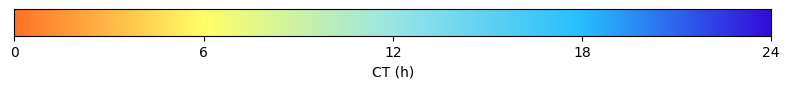

In [17]:
#voxel goto for color blindness

control_points_mod_final = [
    (0.00, (1.00, 0.45, 0.15)),  # orange
    (0.25, (1.00, 1.00, 0.40)),  # yellowish
    (0.50, (0.60, 0.90, 0.90)),  # light cyan
    (0.75, (0.15, 0.75, 1.00)),  # cyan-blue
    (1.00, (0.20, 0.05, 0.85))   # blue-violet
]


cmap_icefire = LinearSegmentedColormap.from_list(
    "erdc_icefire_darkred",
    control_points_mod_final,
    N=256
)

fig, ax = plt.subplots(figsize=(8, 1.0))
grad = np.linspace(0, 1, 1200)[None, :]
ax.imshow(grad, aspect='auto', cmap=cmap_icefire, extent=[0, 24, 0, 1])
ax.set_yticks([])
ax.set_xlim(0, 24)
ax.set_xlabel("CT (h)")
ax.set_xticks([0, 6, 12, 18, 24])
plt.tight_layout()




unit = "vb"
op_b = "border"  #noborder
type_v = "count"


if type_v == "count":
    calc_fol = "whole_{}_a".format(unit)
    
elif type_v == "count_ratio":
    calc_fol = "whole_{}_cir".format(unit)
   
op1="fdr"
op2="nuc_atlas"

vb_r=8
mo=1  
r=100

n=4
b = 0.1
a = (1-b)/(-1)**n


fol = "/"+calc_fol+"/{}um/{}/vb{}_mo{}/".format(vx, "whole", vb_r, mo)


# img_vx = tifffile.imread(savedir +"{}/{}um/whole/vb{}_mo{}/vb_{}_img.tif".format(calc_fol,vx,vb_r, mo, op1))

cos_v_df = pd.read_csv(savedir + fol+"/" + "cos_1st2nd.csv")
print(cos_v_df)


ph_li = (cos_v_df["LAG"]/24)
# ph_li = 1-ph_li
# ph_li = [(hue + 1/3 - 1) if (hue + 1/3) > 1 else (hue + 1/3) for hue in ph_li]rgba_float = cmap_icefire(np.array(ph_li)) #[cmap_icefire([i) for i in ph_li]
rgba_float = cmap_icefire(np.array(ph_li)) #[cmap_icefire([i) for i in ph_li]
# rgba_u8 = (rgba_float * 255).astype(np.uint8)   # shape=(N,4)
color_li  = rgba_float[:, :3]  

# color_li = [hsv_to_rgb([1,1,i]) for i in ph_li]

fdr_vs = np.array(cos_v_df["BH.Q"])
alpha_li = -np.log10(fdr_vs)
a_max = np.max(alpha_li)
alpha_li = alpha_li/a_max
alpha_li = (-a*(alpha_li-1)**n + 1)

brain_ind = np.where(np.ravel(np.swapaxes(atlas_mask, 0, 2))==1)[0]




In [18]:
# color_li = [hsv_to_rgb([i,1,1]) for i in ph_li]
non_sig_ind = cos_v_df[cos_v_df["BH.Q"] > 0.1].index


    
color_li = [(0.5, 0.5, 0.5) if i in non_sig_ind else color for i,color in enumerate(color_li)]
cos_v_df["color"] = color_li
cos_v_df["alpha"] = alpha_li


In [19]:
vx_cords =np.load(rdir+"/{}um/voxel_cords_brain.npy".format(vx))
vx_cords.shape
vx_cords = pd.DataFrame(vx_cords)
vx_cords.columns = ["X", "Y", "Z"]

cos_v_df = pd.concat([cos_v_df, vx_cords], axis=1)
cos_v_df

,Unnamed: 0,id,ADJ.P,PER,BH.Q,LAG,RAD,max_corr,color,alpha,X,Y,Z
0,0,0,0.577648,24,0.667839,0.4,1.015350e-01,0.225664,"(0.5, 0.5, 0.5)",0.165245,98,637,274
1,1,1,0.388474,24,0.500939,1.1,2.810349e-01,0.293456,"(0.5, 0.5, 0.5)",0.209508,98,637,275
2,2,2,0.554111,24,0.648019,1.1,2.810349e-01,0.233831,"(0.5, 0.5, 0.5)",0.169968,98,638,275
3,3,3,0.773192,24,0.824516,1.4,3.601138e-01,0.155566,"(0.5, 0.5, 0.5)",0.131645,98,638,276
4,4,4,0.791459,24,0.839536,2.1,5.620697e-01,0.148419,"(0.5, 0.5, 0.5)",0.128720,98,638,277
...,...,...,...,...,...,...,...,...,...,...,...,...,...
133092072,133092072,133092072,0.376644,24,0.497296,0.8,2.049284e-01,0.298000,"(0.5, 0.5, 0.5)",0.210608,767,662,274
133092073,133092073,133092073,0.563020,24,0.655191,1.6,4.086378e-01,0.230738,"(0.5, 0.5, 0.5)",0.168245,767,662,275
133092074,133092074,133092074,0.888077,24,0.914652,0.0,8.125297e-08,0.106024,"(0.5, 0.5, 0.5)",0.114736,767,663,271
133092075,133092075,133092075,0.886193,24,0.913327,23.3,-1.901256e-01,0.106963,"(0.5, 0.5, 0.5)",0.114974,767,663,272


In [20]:
# phase_li = cos_v_df["LAG"]
# new_phase_li=[]
# for phase in phase_li:
#     if 22 <= phase < 24 or 0 <= phase < 2:
#         phase=0
#     elif 2 <= phase < 6:
#         phase=4
#     elif 6 <= phase < 10:
#         phase=8
#     elif 10 <= phase < 14:
#         phase=12
#     elif 14 <= phase < 18:
#         phase=16
#     elif 18 <= phase < 22:
#         phase=20
#     new_phase_li.append(phase)
# cos_v_df["LAG2"]=new_phase_li
# cos_v_df["color"] = color_li


del color_li
del non_sig_ind
del ph_li
del fdr_vs
del a_max
# del new_phase_li
# del phase_li
del alpha_li

gc.collect()

16

In [21]:
del vx_cords
gc.collect()

0

385 VISp
Phase 0-1: 2.09%
Phase 1-2: 1.24%
Phase 2-3: 1.04%
Phase 3-4: 0.98%
Phase 4-5: 1.26%
Phase 5-6: 1.45%
Phase 6-7: 2.14%
Phase 7-8: 3.54%
Phase 8-9: 4.90%
Phase 9-10: 4.23%
Phase 10-11: 3.20%
Phase 11-12: 2.70%
Phase 12-13: 2.80%
Phase 13-14: 3.06%
Phase 14-15: 4.28%
Phase 15-16: 6.30%
Phase 16-17: 7.69%
Phase 17-18: 6.20%
Phase 18-19: 5.00%
Phase 19-20: 8.61%
Phase 20-21: 10.20%
Phase 21-22: 7.11%
Phase 22-23: 5.79%
Phase 23-24: 4.19%


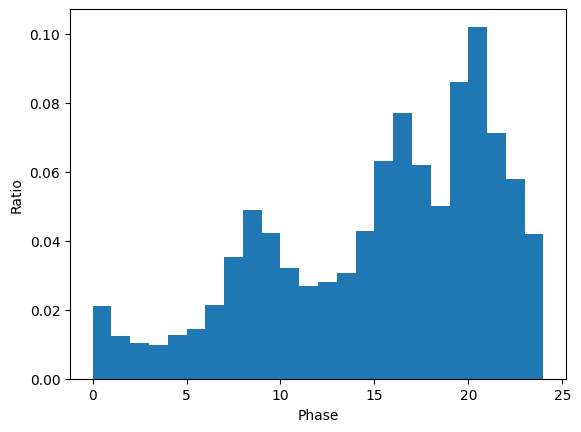

4 IC
Phase 0-1: 0.89%
Phase 1-2: 0.69%
Phase 2-3: 0.66%
Phase 3-4: 0.54%
Phase 4-5: 0.74%
Phase 5-6: 0.63%
Phase 6-7: 0.76%
Phase 7-8: 0.83%
Phase 8-9: 1.27%
Phase 9-10: 1.15%
Phase 10-11: 1.27%
Phase 11-12: 1.28%
Phase 12-13: 1.97%
Phase 13-14: 2.32%
Phase 14-15: 3.94%
Phase 15-16: 8.26%
Phase 16-17: 17.56%
Phase 17-18: 18.85%
Phase 18-19: 14.29%
Phase 19-20: 9.44%
Phase 20-21: 5.49%
Phase 21-22: 3.26%
Phase 22-23: 2.16%
Phase 23-24: 1.51%


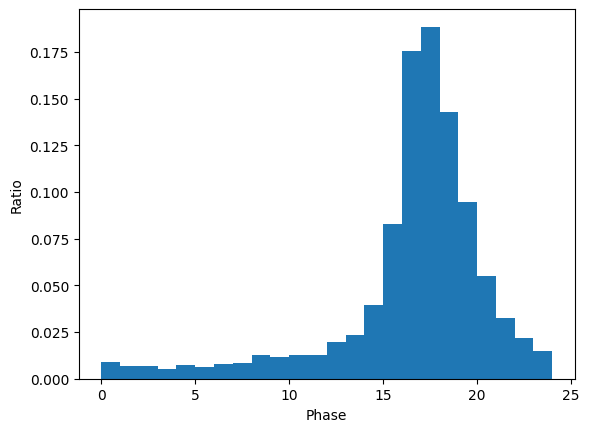

302 SCs
Phase 0-1: 0.75%
Phase 1-2: 0.86%
Phase 2-3: 1.12%
Phase 3-4: 1.42%
Phase 4-5: 3.14%
Phase 5-6: 7.89%
Phase 6-7: 19.11%
Phase 7-8: 22.44%
Phase 8-9: 12.31%
Phase 9-10: 5.26%
Phase 10-11: 3.18%
Phase 11-12: 2.29%
Phase 12-13: 2.41%
Phase 13-14: 2.36%
Phase 14-15: 2.90%
Phase 15-16: 2.99%
Phase 16-17: 3.13%
Phase 17-18: 1.59%
Phase 18-19: 0.83%
Phase 19-20: 0.56%
Phase 20-21: 0.80%
Phase 21-22: 0.53%
Phase 22-23: 0.67%
Phase 23-24: 0.77%


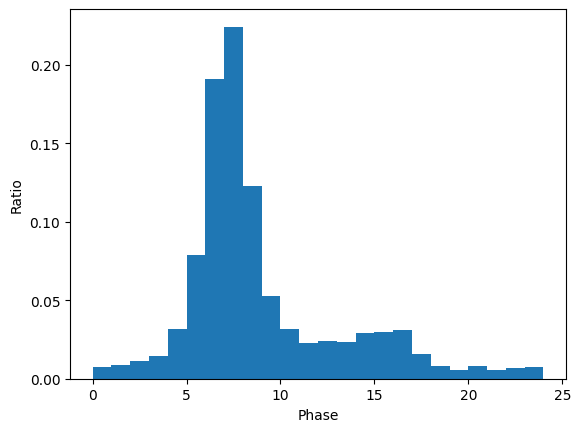

1002 AUDp
Phase 0-1: 0.17%
Phase 1-2: 0.09%
Phase 2-3: 0.05%
Phase 3-4: 0.03%
Phase 4-5: 0.02%
Phase 5-6: 0.01%
Phase 6-7: 0.01%
Phase 7-8: 0.01%
Phase 8-9: 0.01%
Phase 9-10: 0.01%
Phase 10-11: 0.01%
Phase 11-12: 0.01%
Phase 12-13: 0.01%
Phase 13-14: 0.02%
Phase 14-15: 0.04%
Phase 15-16: 0.07%
Phase 16-17: 0.27%
Phase 17-18: 8.31%
Phase 18-19: 29.46%
Phase 19-20: 25.20%
Phase 20-21: 29.33%
Phase 21-22: 5.34%
Phase 22-23: 1.11%
Phase 23-24: 0.42%


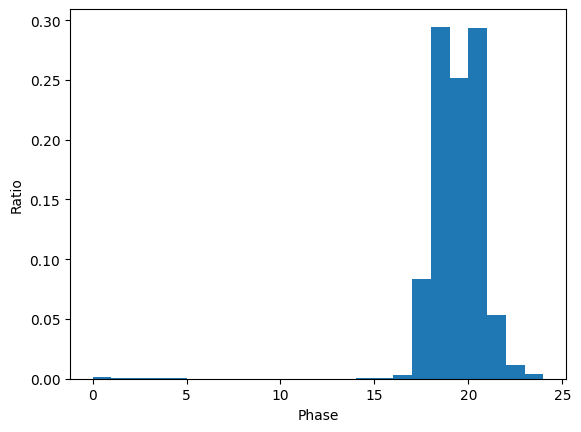

286 SCH
Phase 0-1: 0.02%
Phase 1-2: 1.88%
Phase 2-3: 4.10%
Phase 3-4: 11.66%
Phase 4-5: 16.36%
Phase 5-6: 22.18%
Phase 6-7: 29.56%
Phase 7-8: 11.31%
Phase 8-9: 1.86%
Phase 9-10: 0.36%
Phase 10-11: 0.16%
Phase 11-12: 0.16%
Phase 12-13: 0.08%
Phase 13-14: 0.06%
Phase 14-15: 0.05%
Phase 15-16: 0.05%
Phase 16-17: 0.05%
Phase 17-18: 0.03%
Phase 18-19: 0.01%
Phase 19-20: 0.00%
Phase 20-21: 0.01%
Phase 21-22: 0.00%
Phase 22-23: 0.02%
Phase 23-24: 0.02%


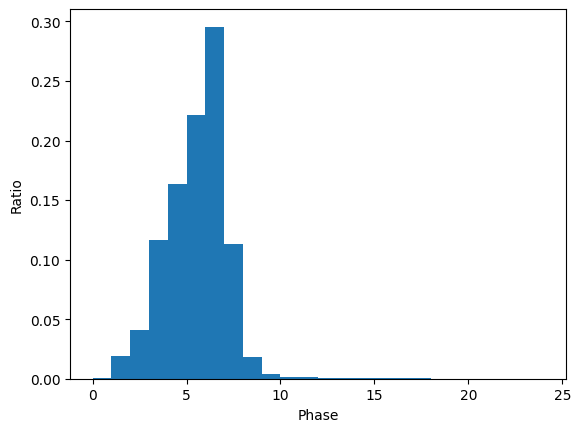

830 DMH
Phase 0-1: 8.23%
Phase 1-2: 2.28%
Phase 2-3: 1.39%
Phase 3-4: 0.84%
Phase 4-5: 0.45%
Phase 5-6: 0.23%
Phase 6-7: 0.16%
Phase 7-8: 0.15%
Phase 8-9: 0.19%
Phase 9-10: 0.20%
Phase 10-11: 0.24%
Phase 11-12: 0.35%
Phase 12-13: 0.57%
Phase 13-14: 1.07%
Phase 14-15: 2.08%
Phase 15-16: 2.25%
Phase 16-17: 2.92%
Phase 17-18: 4.32%
Phase 18-19: 6.47%
Phase 19-20: 8.49%
Phase 20-21: 10.31%
Phase 21-22: 16.77%
Phase 22-23: 16.05%
Phase 23-24: 13.98%


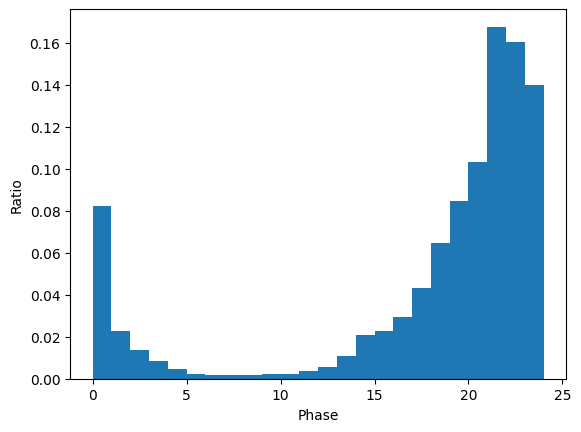

382 CA1


In [ ]:

#phase % by regions
fig_dir = savedir + "region_ph_ratio/"
region_IDs = [385, 4, 302, 1002, 286, 830, 382, 909, 1079, 347]#uni_IDs[5:] #[194, 56, 689,  170, 749, 830]#

phase_li = np.arange(0,24, 4)
num_frames = 6


vx=20
vx2 = 20
rx=vx/vx2
r = 5

angles  = ["hor"]#, "cor", "sag"]
elev = 30

# child_IDs_o, child_regions_o, middle_IDs_o, middle_regions_o = ca.get_child_IDs2(1089)


for i, rID in enumerate(region_IDs):
#     print(rID, middle_regions_o[i])
#     name = "{}_vx".format(middle_regions_o[i])
    region = ca.df_allen[ca.df_allen["ID"]==rID]["acronym"].iloc[0]
    print(rID, region)
    
    if "/" in region:
                region = region.replace("/", "_")
            
    
    name = "{}_vx".format(region)
    if os.path.exists(fig_dir +name+"/phase_rot_{}_{}.png".format(elev, 4)):
        continue
    os.makedirs(fig_dir+name, exist_ok=True)
    
    
    if ca.smallID_q(rID):
        
    #     child_IDs, child_regions, middle_IDs, middle_regions = ca.get_child_IDs2(rID)
        index =[]
    #     for rID in child_IDs+middle_IDs:

        index += np.where(ca.voxel_ID_order_all==rID)[0].tolist()  #get indexes having region ID 
#         cos_v_df2 = cos_v_df.iloc[index]
    else:
        child_IDs, child_regions, middle_IDs, middle_regions = ca.get_child_IDs2(rID)
        index =[]
        index += np.where(ca.voxel_ID_order_all==rID)[0].tolist()
        for mID in child_IDs+middle_IDs:

            index += np.where(ca.voxel_ID_order_all==mID)[0].tolist()  #get indexes having region ID 


    index2 = [int(np.where(brain_ind == t)[0][0]) for t in index]
    cos_v_df2 = cos_v_df.iloc[index2]

#     brain_IDs =[315, rID]#,698, 1089, 703, 477, 803, 549, 1097,  313, 771, 354,  512]
   
#     xmin, xmax, ymin, ymax, zmin, zmax = mask_range(brain_IDs, vx, 100)
    
    
    

    ph_li = cos_v_df2["LAG"].tolist()
    
    # ビンの定義（0〜24 を 1 間隔で区切る）
    bins = np.arange(0, 24 + 1, 1)  # [0,1,2,…,24]
    
    # --- 置き換え部分 ---
    ph_arr = np.asarray(ph_li)
    
    # np.histogram で一発
    # group_counts: ビンごとのカウント、_ はビンの境界 (bins) が返るが今回は無視
    group_counts, _ = np.histogram(ph_arr, bins=bins)
    
    total_count = ph_arr.size
    group_ratios = group_counts / total_count
    
    # 出力
    for i, (start, end) in enumerate(zip(bins[:-1], bins[1:])):
        print(f"Phase {start}-{end}: {group_ratios[i]*100:.2f}%")
    
    # ヒストグラムの描画
    plt.bar(bins[:-1], group_ratios, width=1.0, align="edge")
    plt.xlabel("Phase")
    plt.ylabel("Ratio")
    plt.show()
    # # 入力の浮動小数点リスト
    # total_count = len(ph_li)
    # interval = 1
    # max_value = 24# グループ分けの範囲を作成
    # bins = [i for i in range(0, max_value + interval, interval)] # 各グループにデータを分類
    # group_counts = [0] * (len(bins) - 1) 
    
    # for value in ph_li:     
    #     for i in range(len(bins) - 1):         
    #         if bins[i] <= value < bins[i + 1]:  
    #             group_counts[i] += 1            
    #             break# 全データ数を計算total_count = len(data) # 割合を計算

    # group_ratios = [count / total_count for count in group_counts] # 結果を出力
    # for i in range(len(bins) - 1):     
    #     print(f"Phase {bins[i]}-{bins[i+1]}: {group_ratios[i]*100:.2f}%")

    # plt.hist(ph_li)
    # plt.show()

In [21]:
np.where(brain_ind==286)[0].tolist()

[]

In [16]:
cos_v_df

,Unnamed: 0,id,ADJ.P,PER,BH.Q,LAG,RAD,max_corr,color,X,Y,Z,alpha
0,0,0,0.577648,24,0.667839,0.4,1.015350e-01,0.225664,"(0.5, 0.5, 0.5)",98,637,274,0.064331
1,1,1,0.388474,24,0.500939,1.1,2.810349e-01,0.293456,"(0.5, 0.5, 0.5)",98,637,275,0.101793
2,2,2,0.554111,24,0.648019,1.1,2.810349e-01,0.233831,"(0.5, 0.5, 0.5)",98,638,275,0.068303
3,3,3,0.773192,24,0.824516,1.4,3.601138e-01,0.155566,"(0.5, 0.5, 0.5)",98,638,276,0.036223
4,4,4,0.791459,24,0.839536,2.1,5.620697e-01,0.148419,"(0.5, 0.5, 0.5)",98,638,277,0.033790
...,...,...,...,...,...,...,...,...,...,...,...,...,...
133092072,133092072,133092072,0.376644,24,0.497296,0.8,2.049284e-01,0.298000,"(0.5, 0.5, 0.5)",767,662,274,0.102731
133092073,133092073,133092073,0.563020,24,0.655191,1.6,4.086378e-01,0.230738,"(0.5, 0.5, 0.5)",767,662,275,0.066853
133092074,133092074,133092074,0.888077,24,0.914652,0.0,8.125297e-08,0.106024,"(0.5, 0.5, 0.5)",767,663,271,0.022182
133092075,133092075,133092075,0.886193,24,0.913327,23.3,-1.901256e-01,0.106963,"(0.5, 0.5, 0.5)",767,663,272,0.022379


68 FRP1
667 FRP2/3


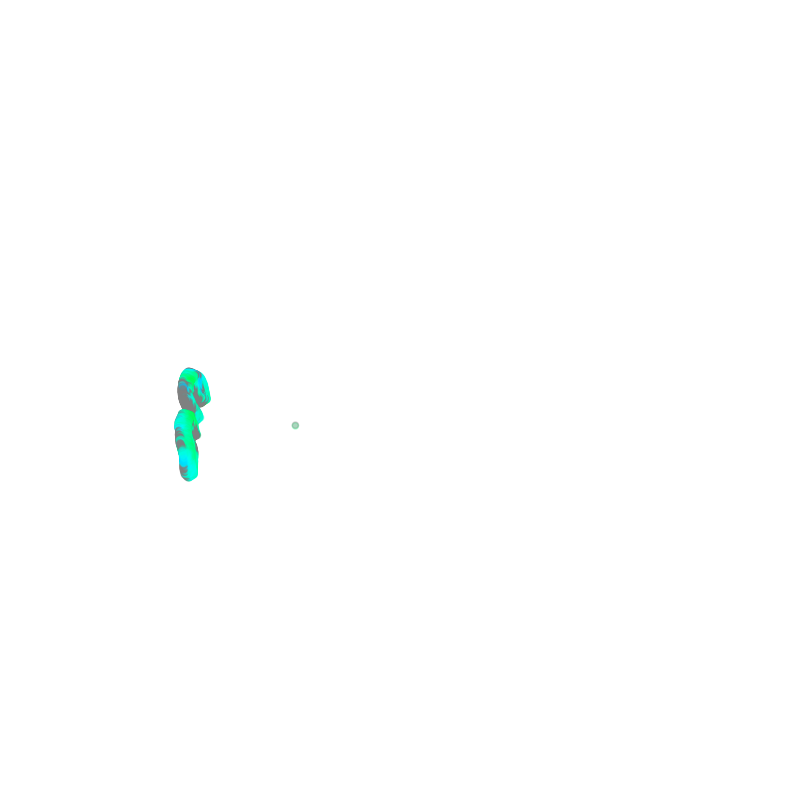

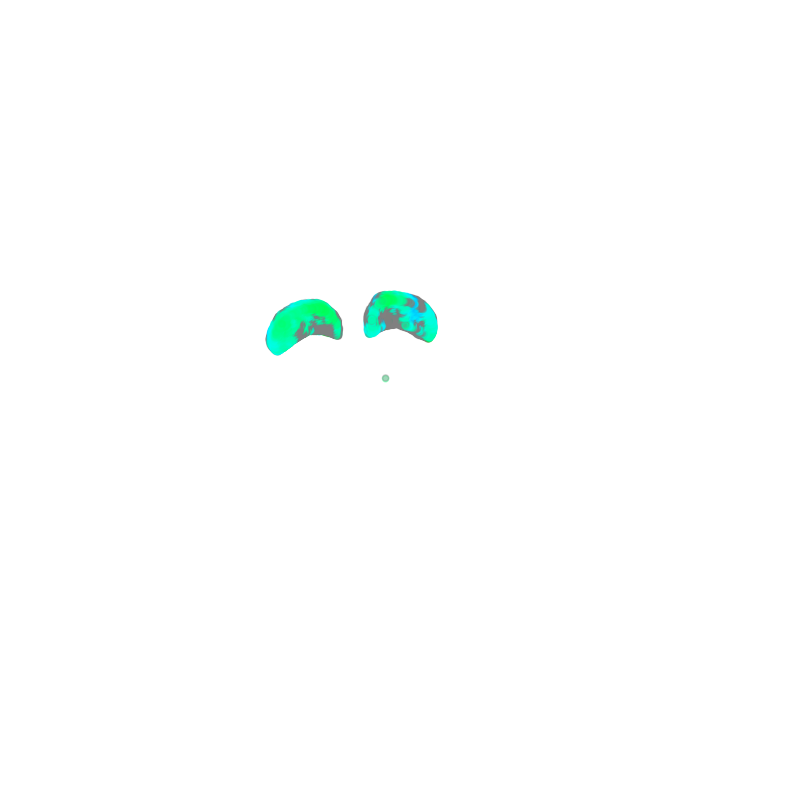

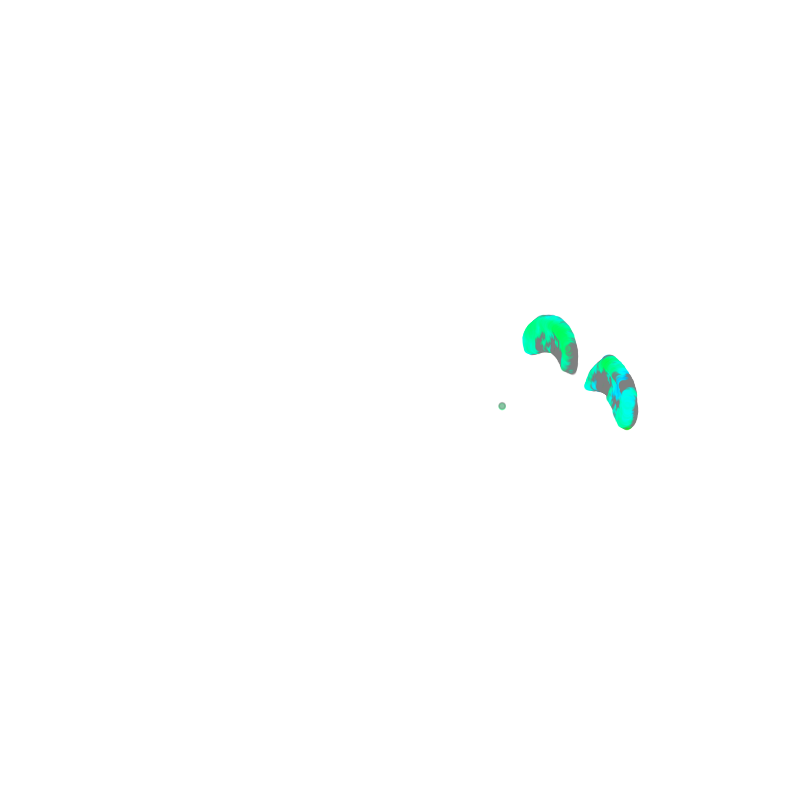

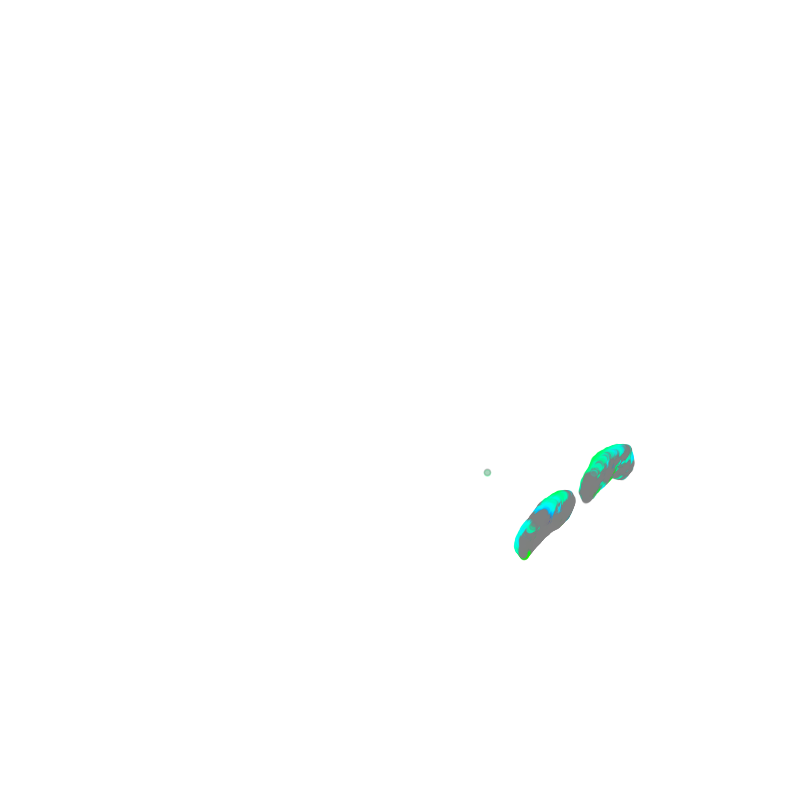

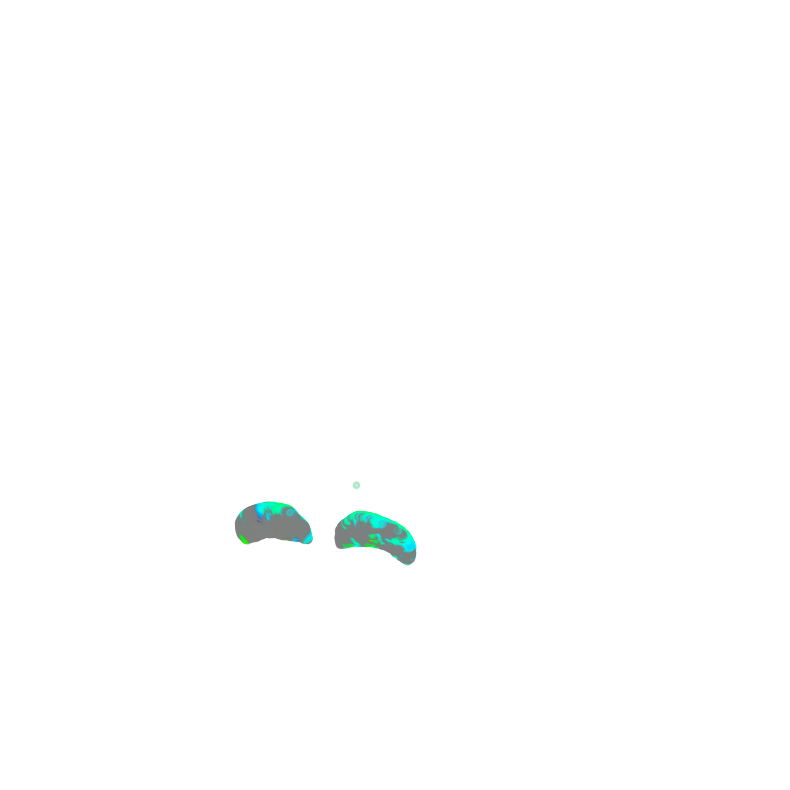

52192 FRP5
52196 FRP6a
52264 FRP6b
500 MO
985 MOp
320 MOp1
943 MOp2/3


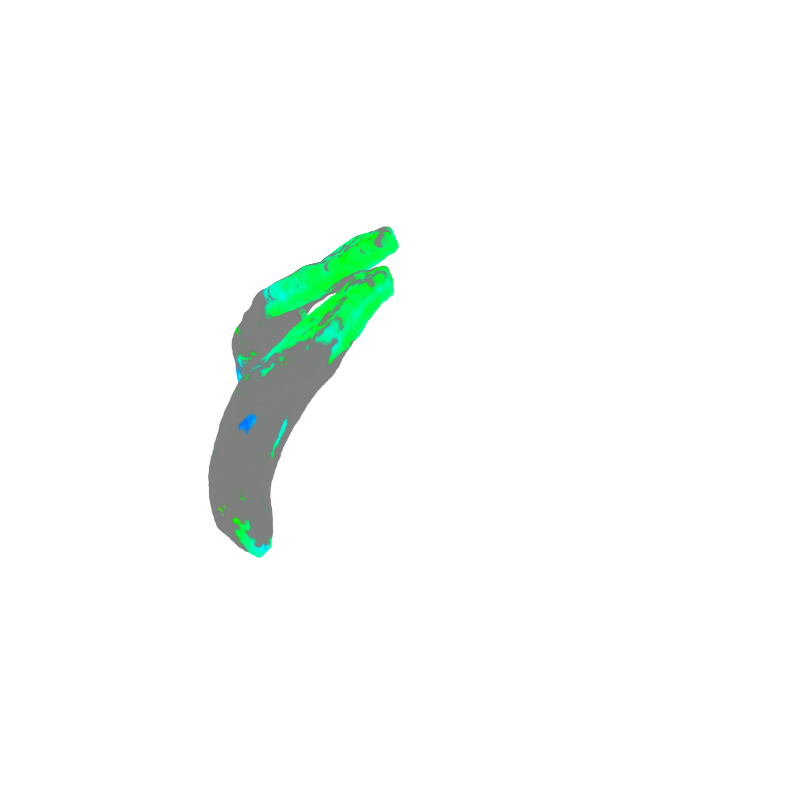

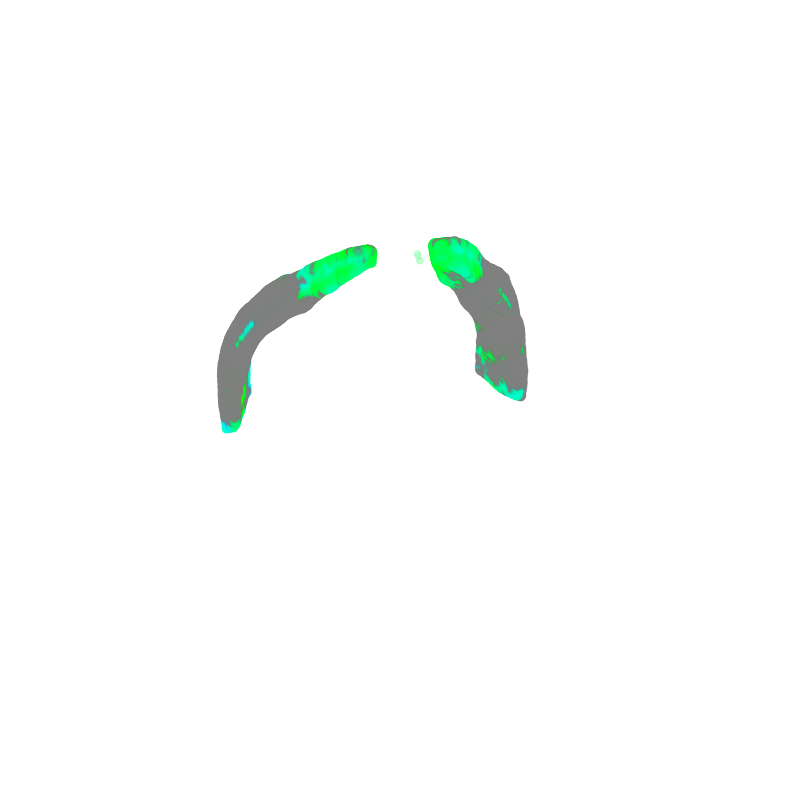

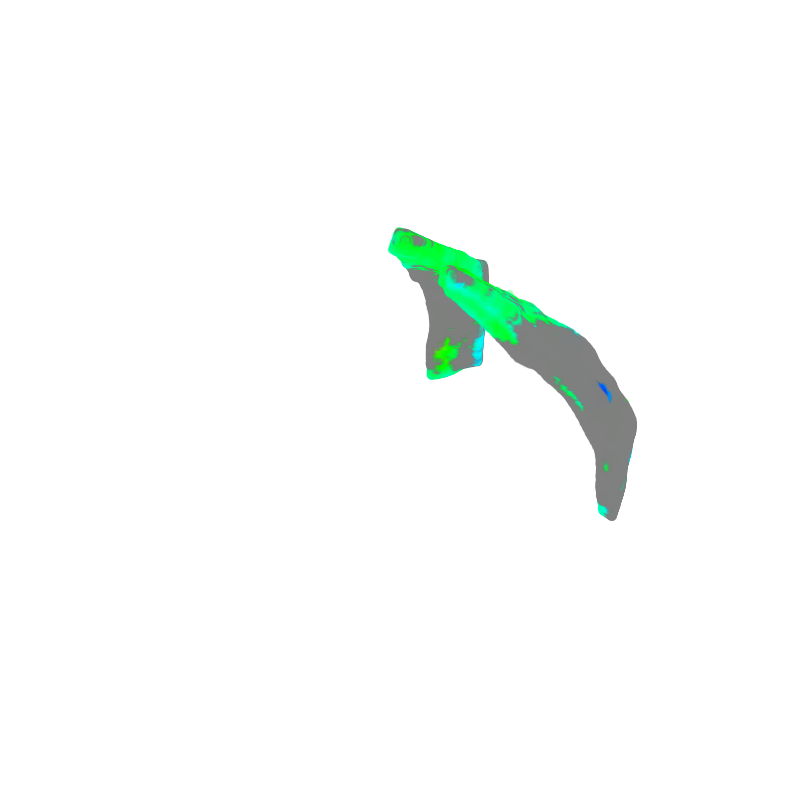

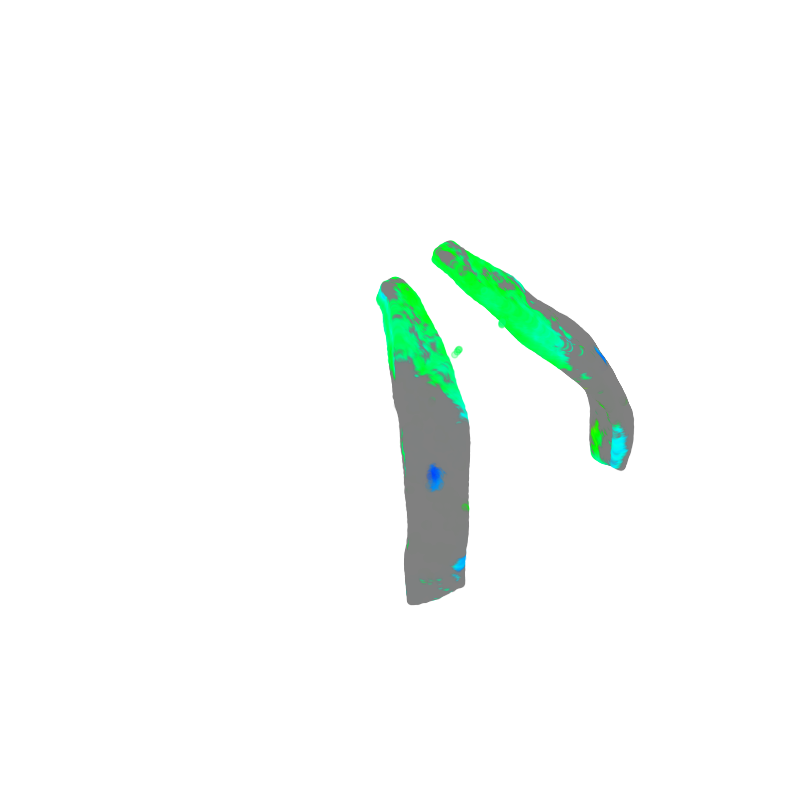

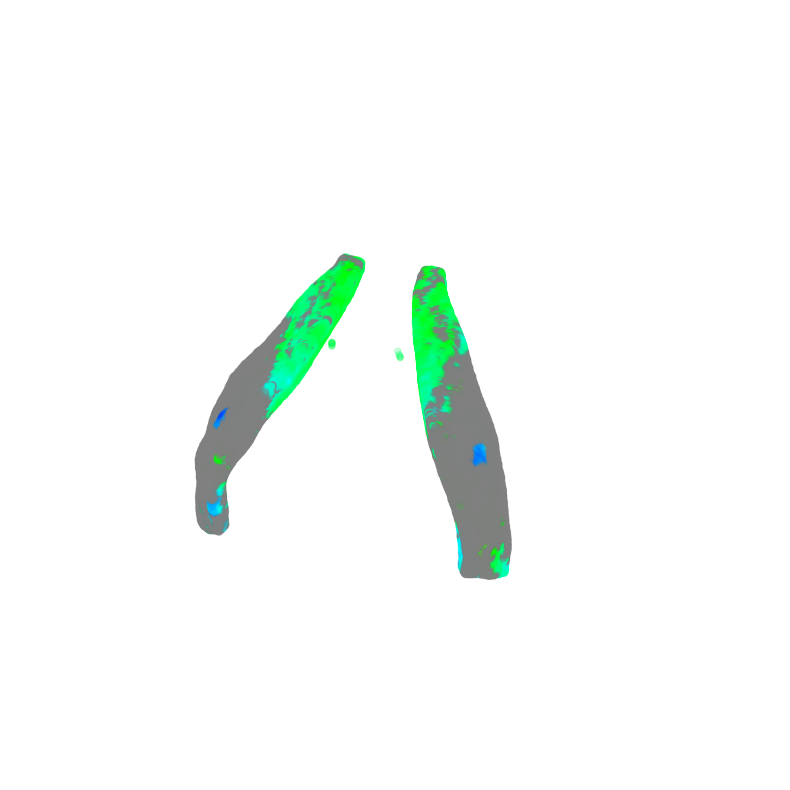

648 MOp5
844 MOp6a
882 MOp6b
993 MOs
656 MOs1
962 MOs2/3


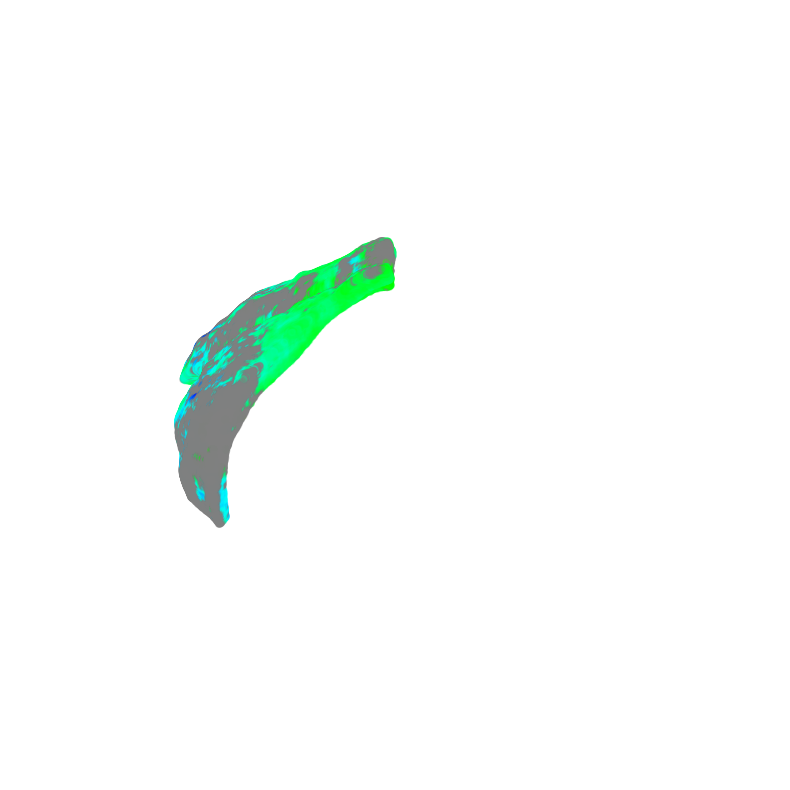

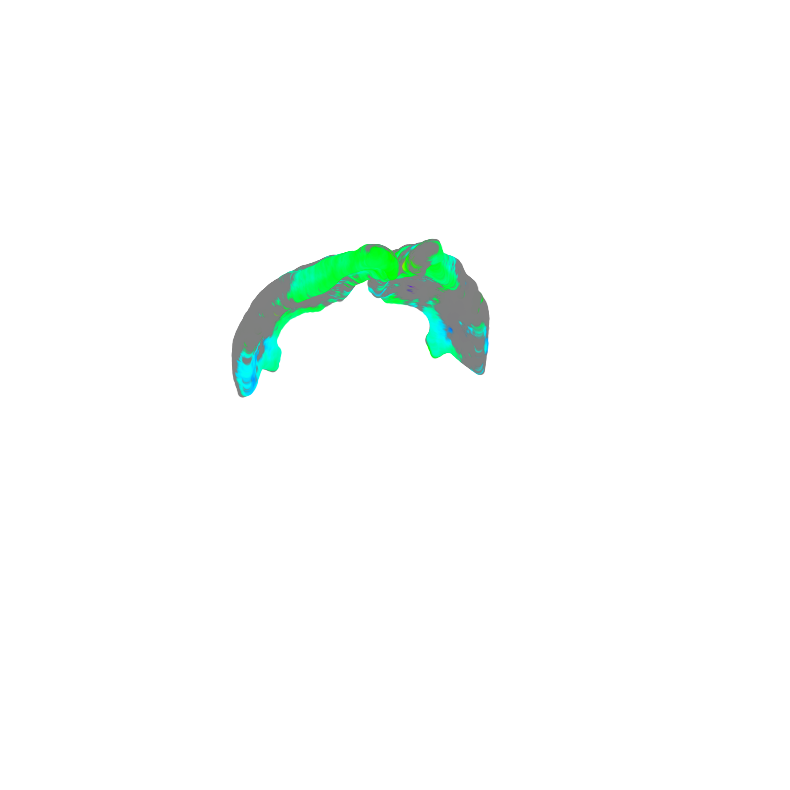

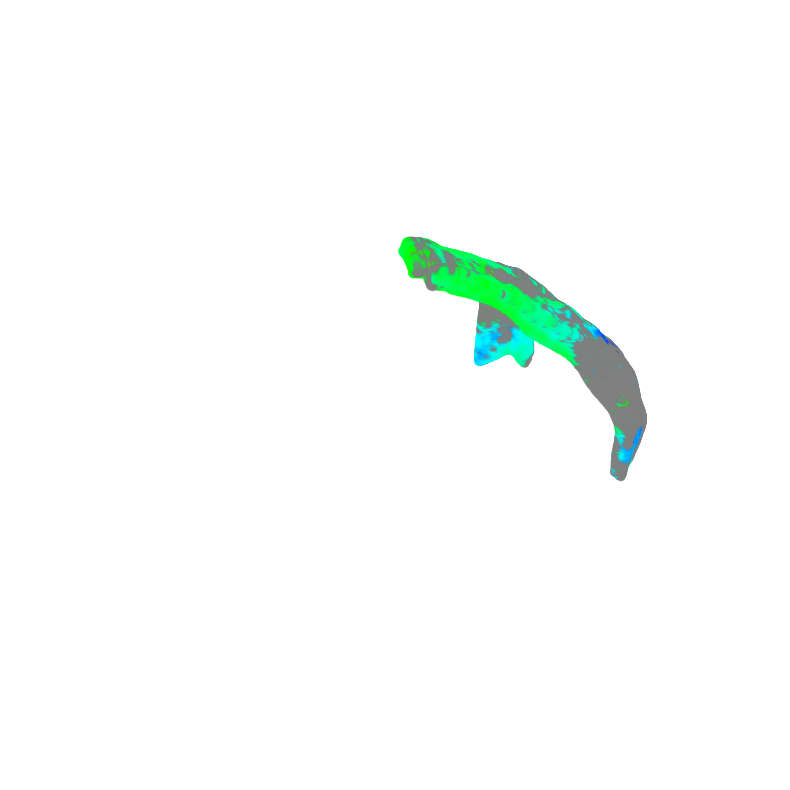

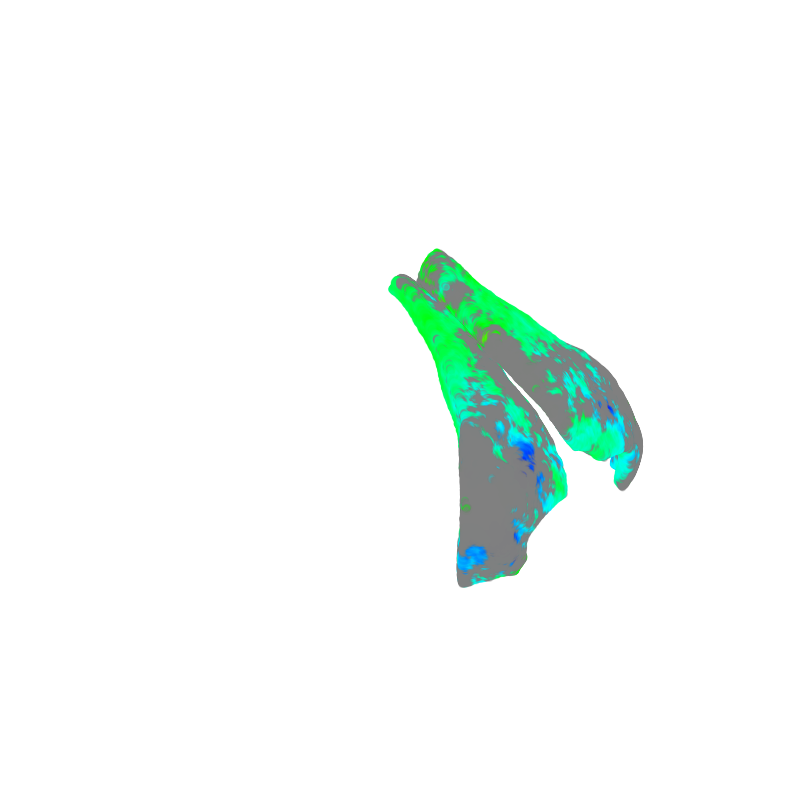

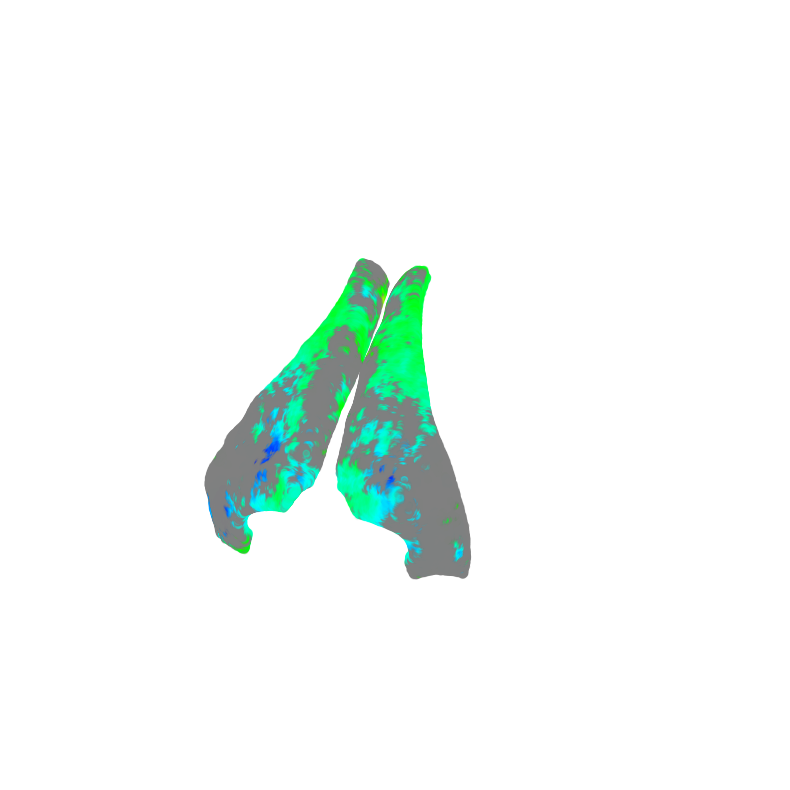

767 MOs5
1021 MOs6a
1085 MOs6b
453 SS
322 SSp
353 SSp-n
558 SSp-n1
838 SSp-n2/3


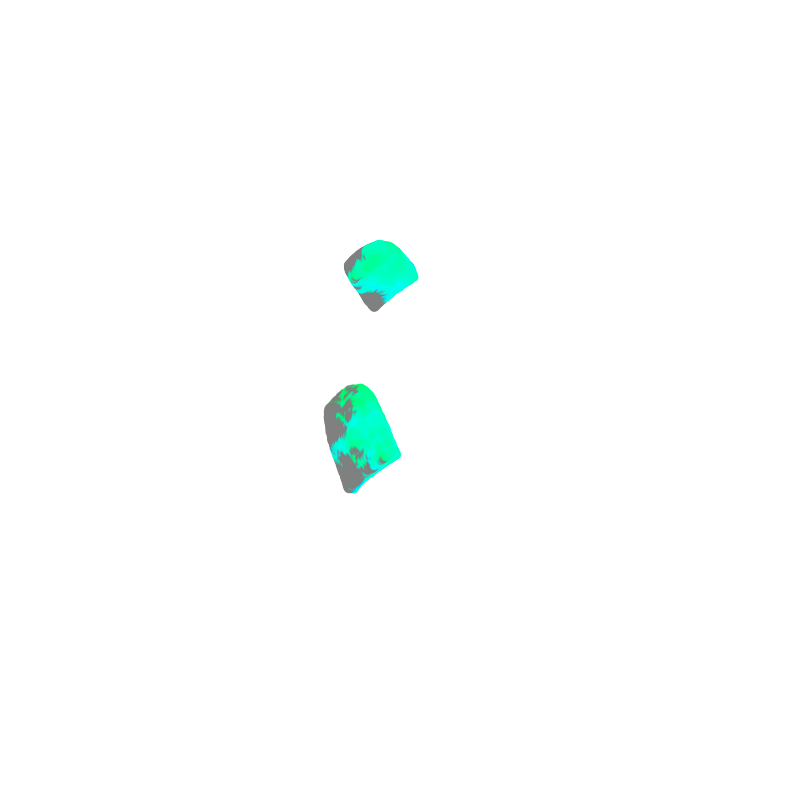

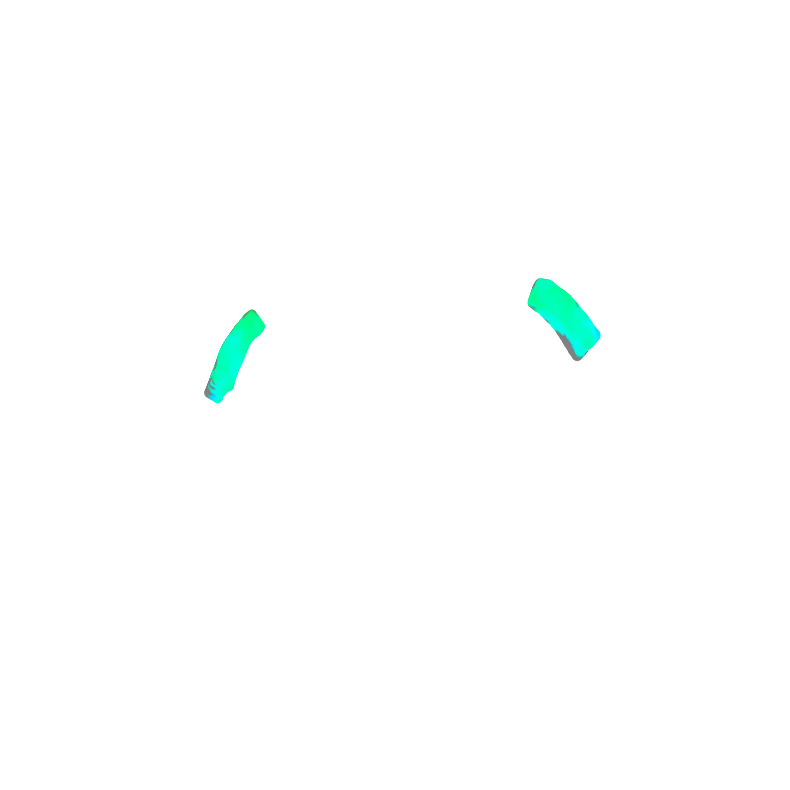

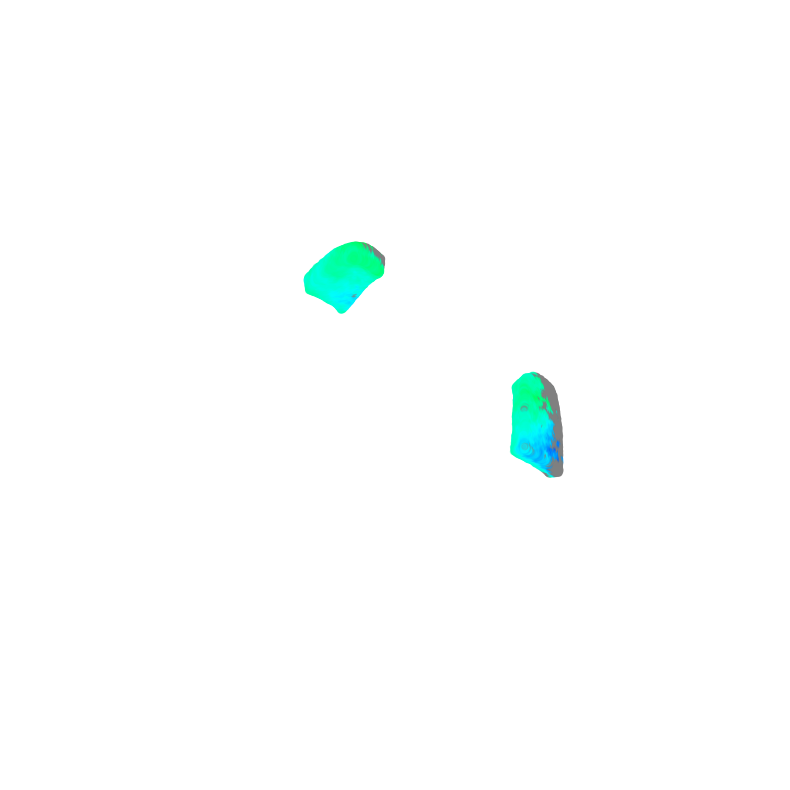

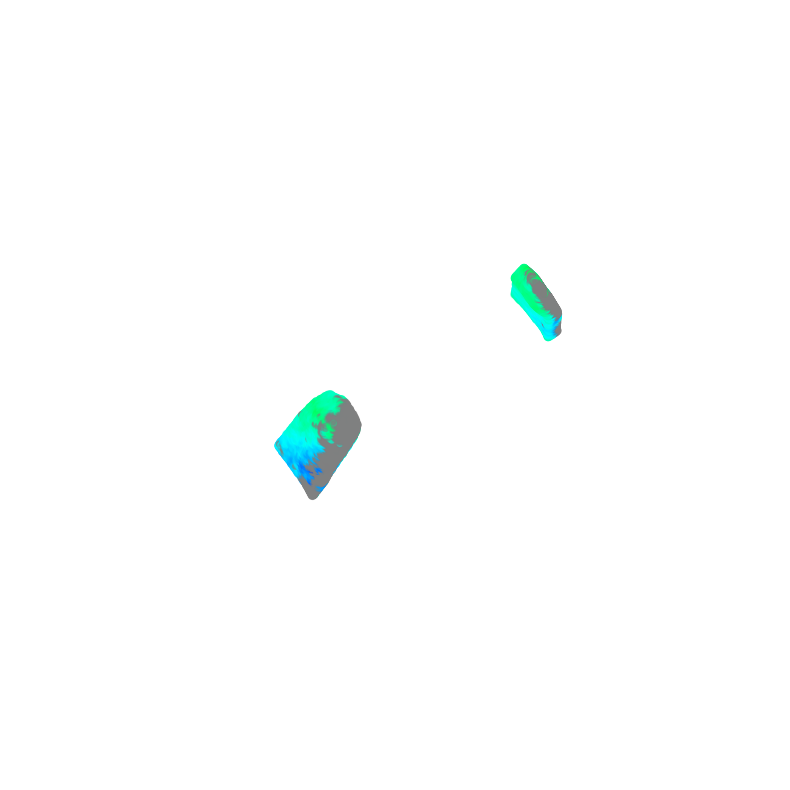

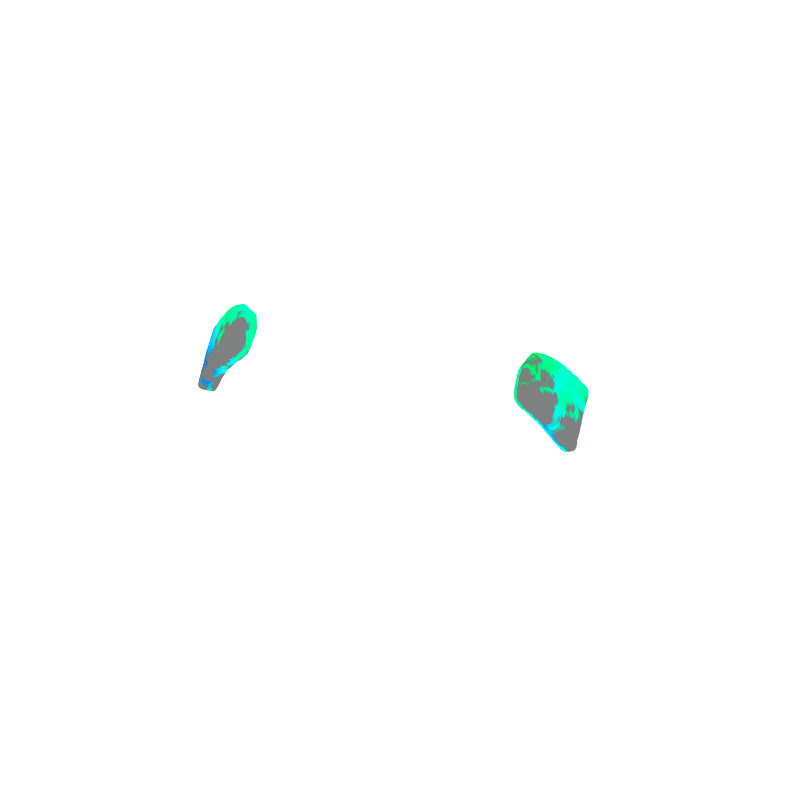

654 SSp-n4
702 SSp-n5
889 SSp-n6a
929 SSp-n6b
329 SSp-bfd
981 SSp-bfd1
201 SSp-bfd2/3


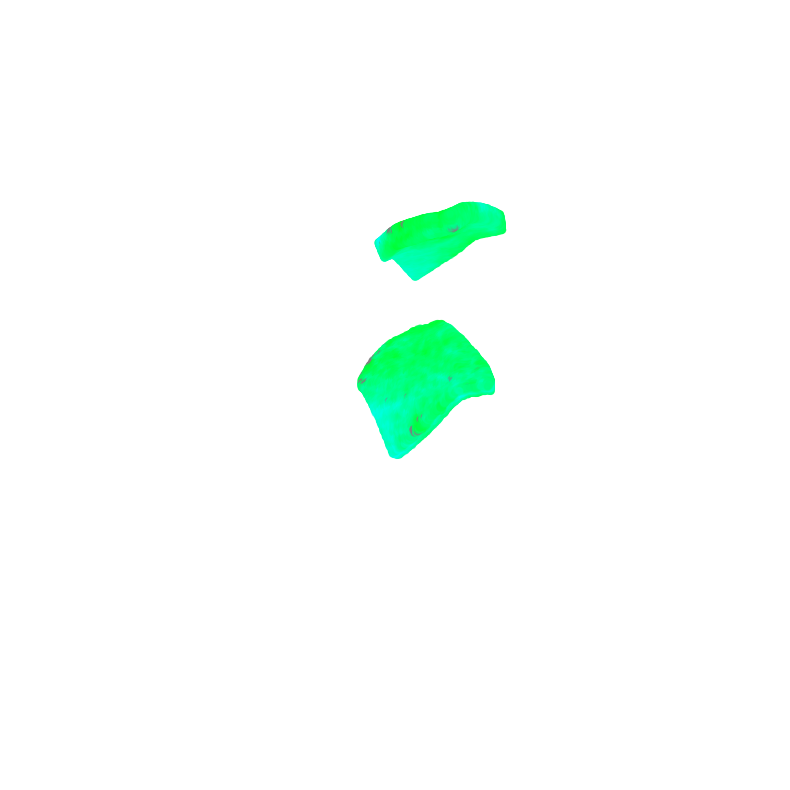

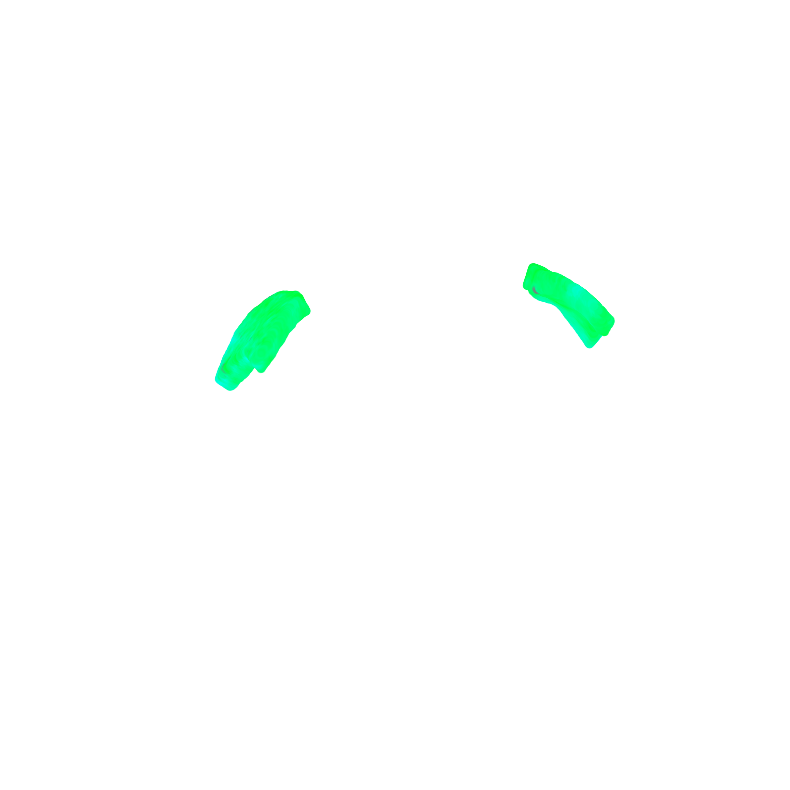

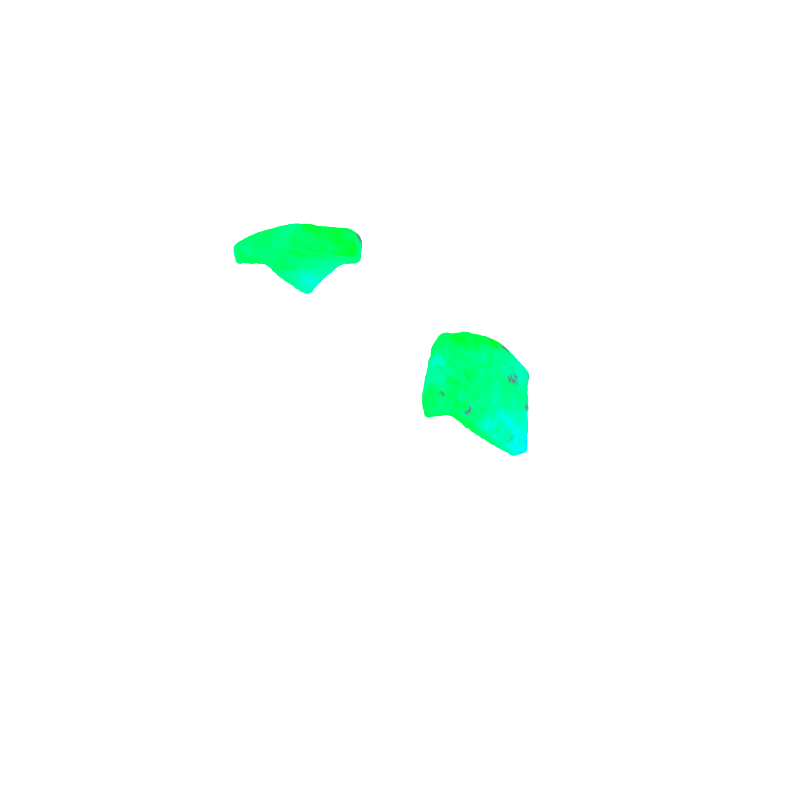

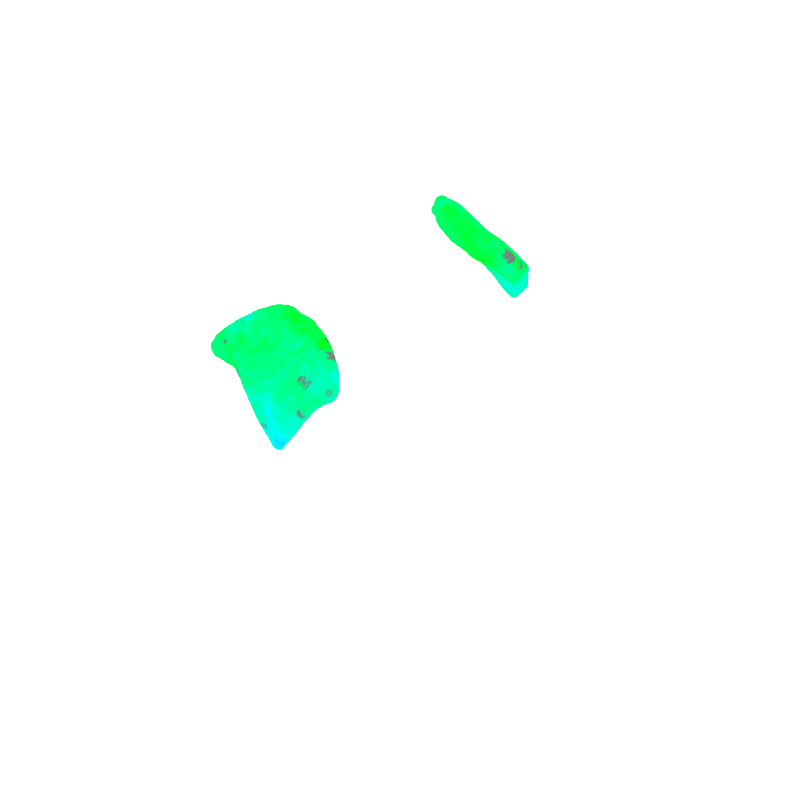

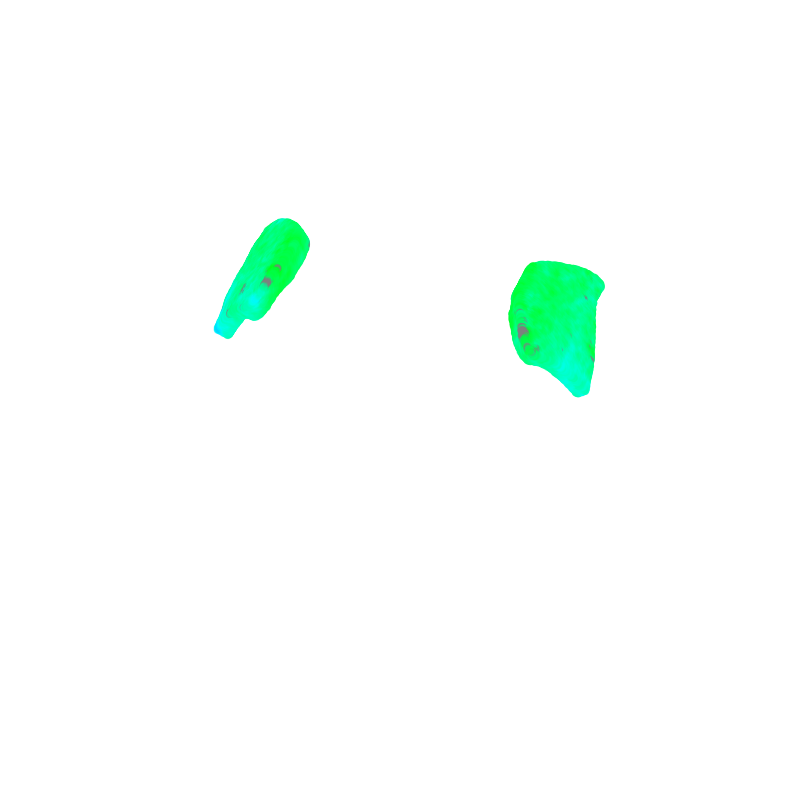

1047 SSp-bfd4
1070 SSp-bfd5
1038 SSp-bfd6a
1062 SSp-bfd6b
337 SSp-ll
1030 SSp-ll1
113 SSp-ll2/3


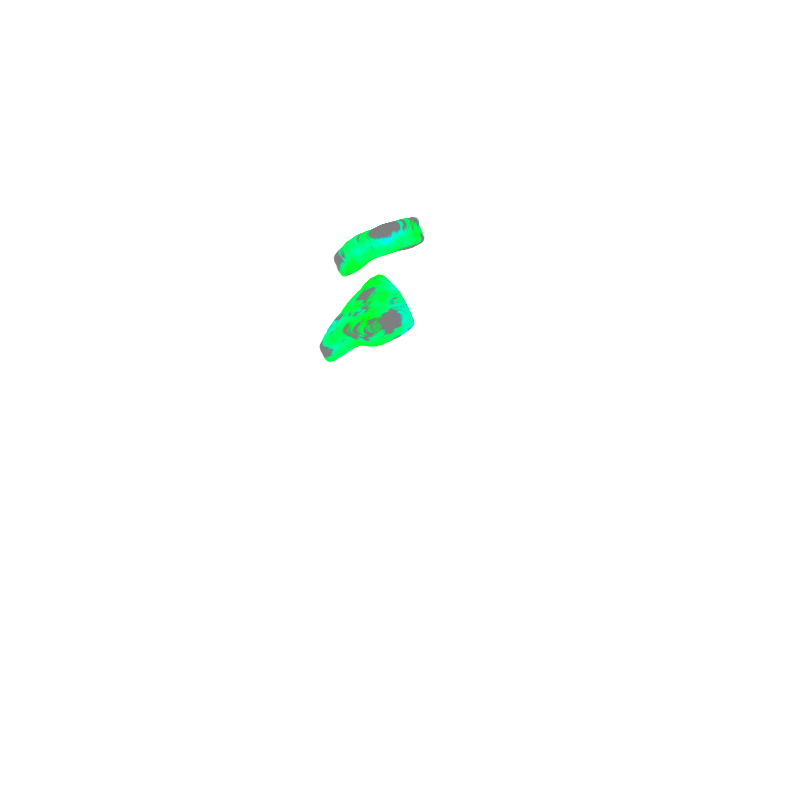

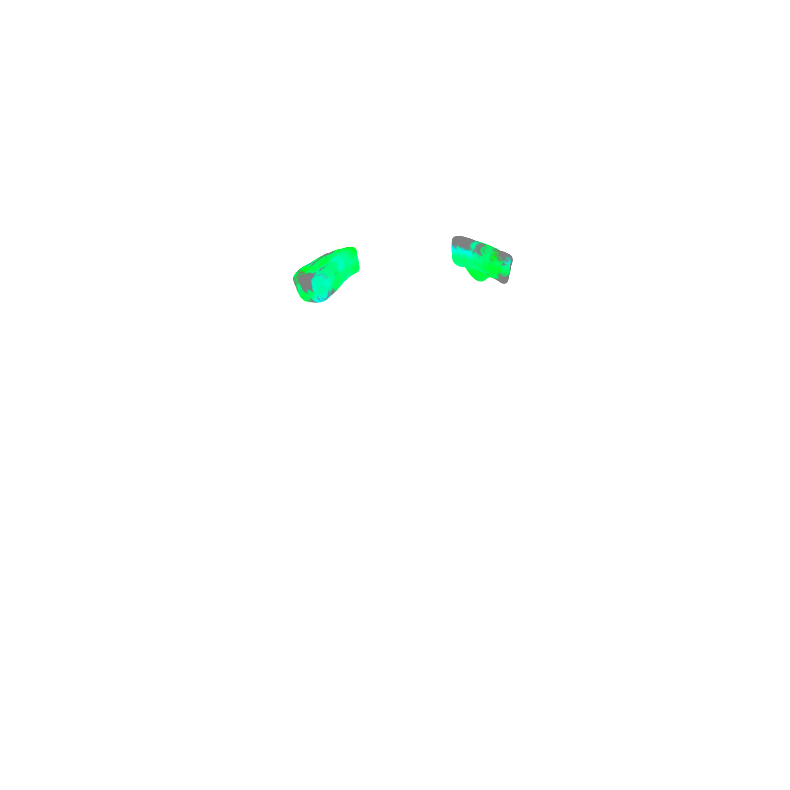

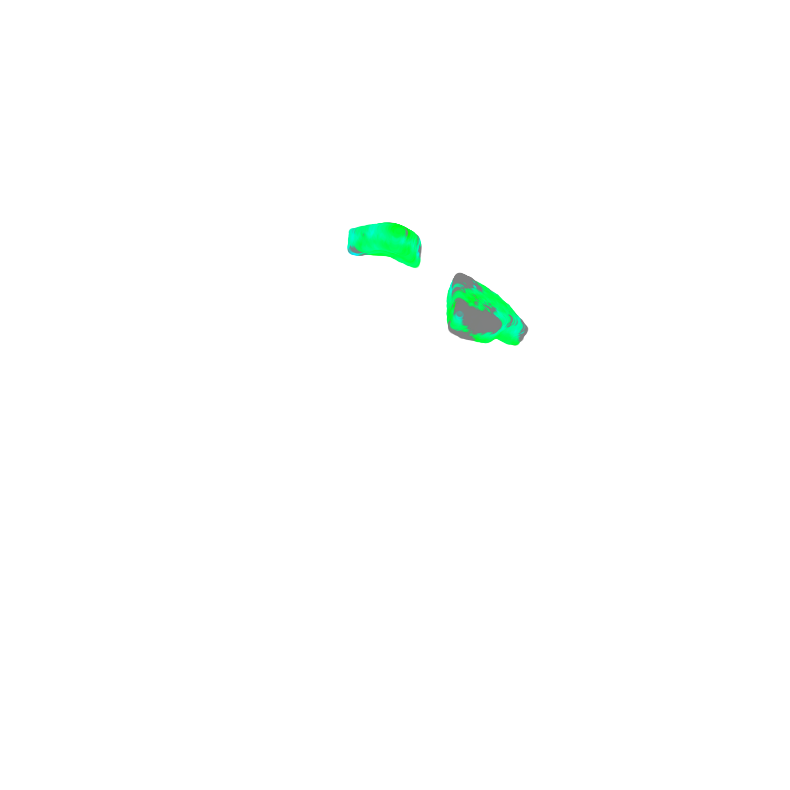

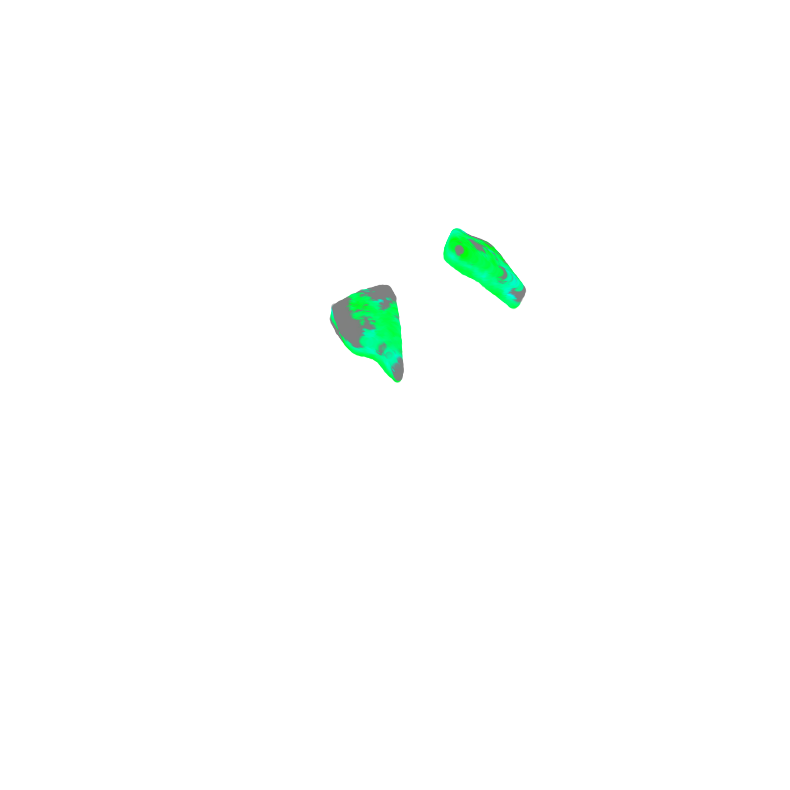

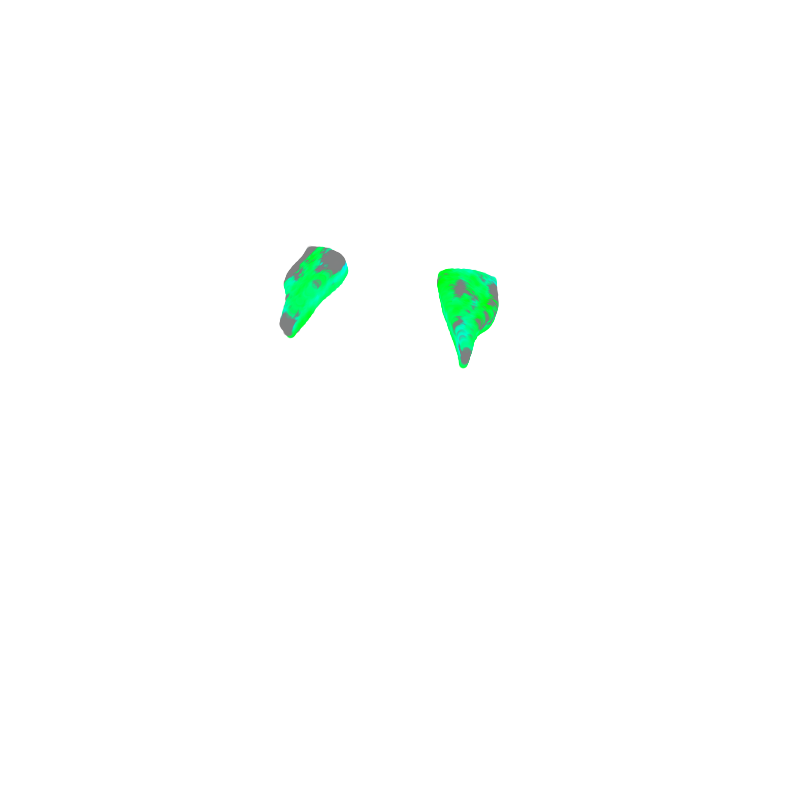

1094 SSp-ll4
1128 SSp-ll5
478 SSp-ll6a
510 SSp-ll6b
345 SSp-m
878 SSp-m1
657 SSp-m2/3


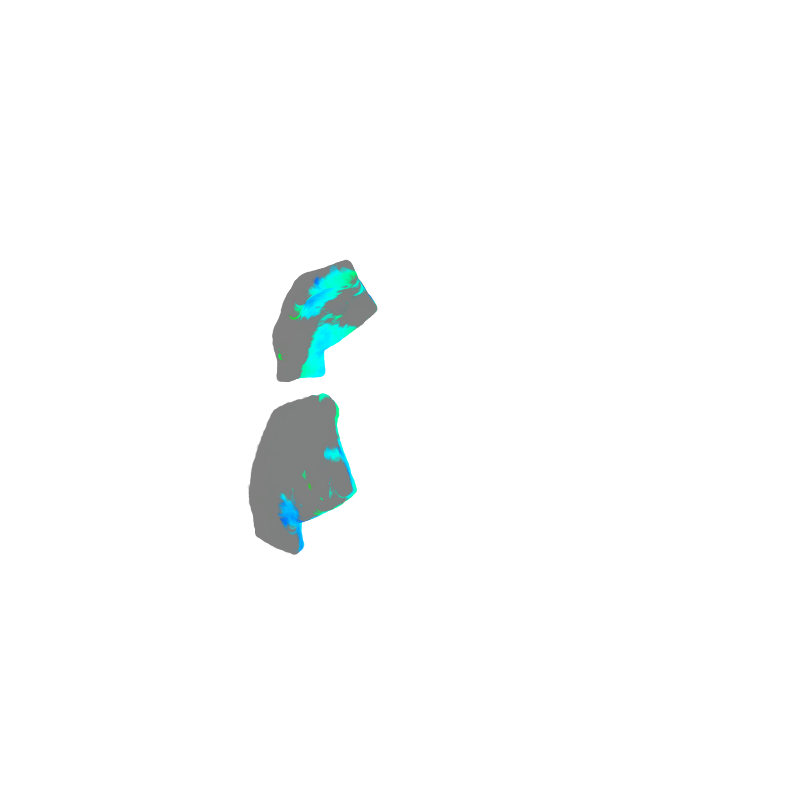

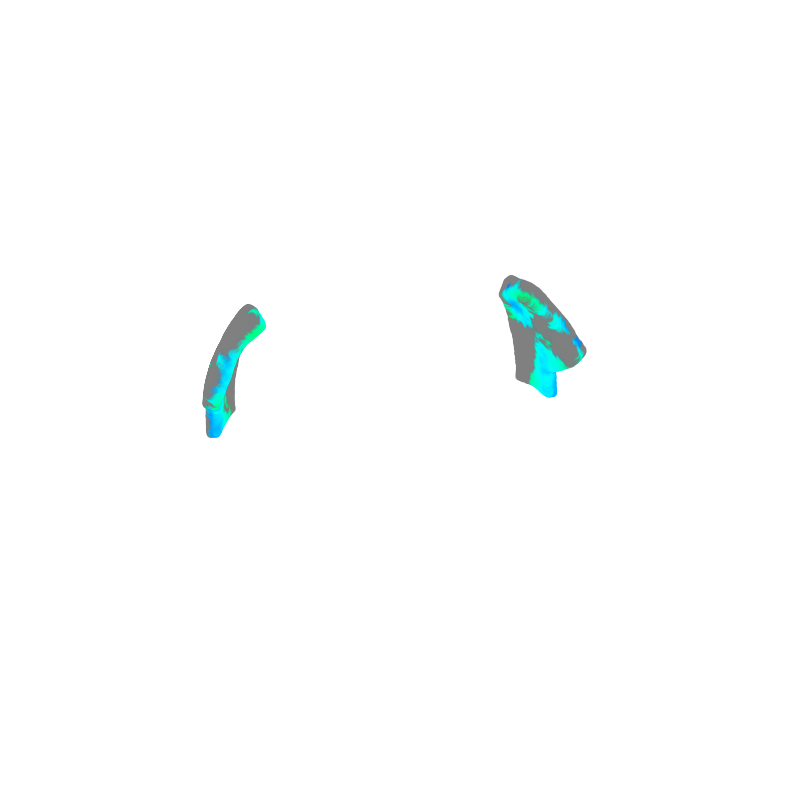

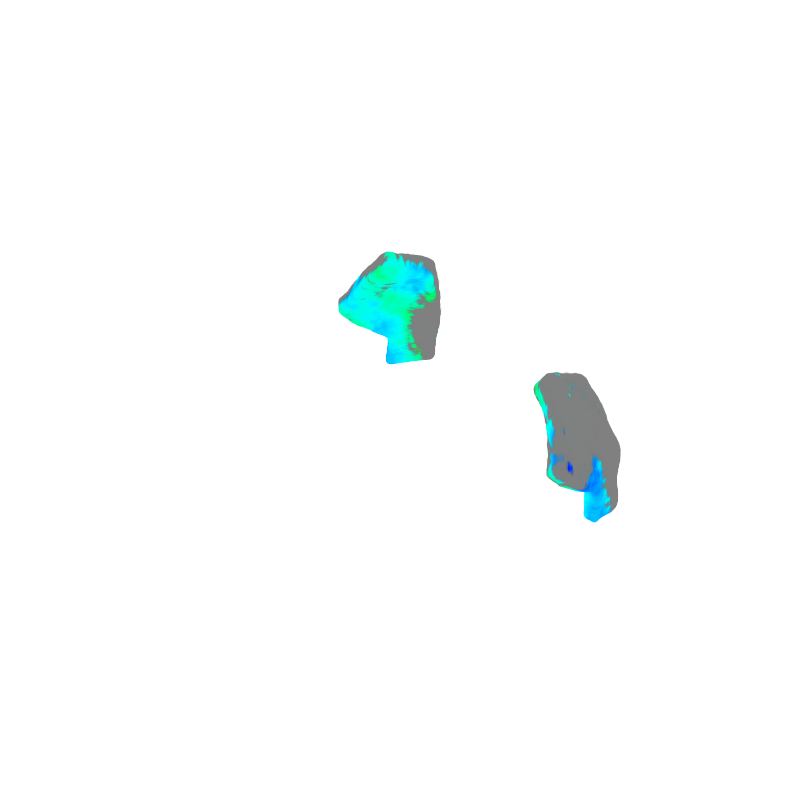

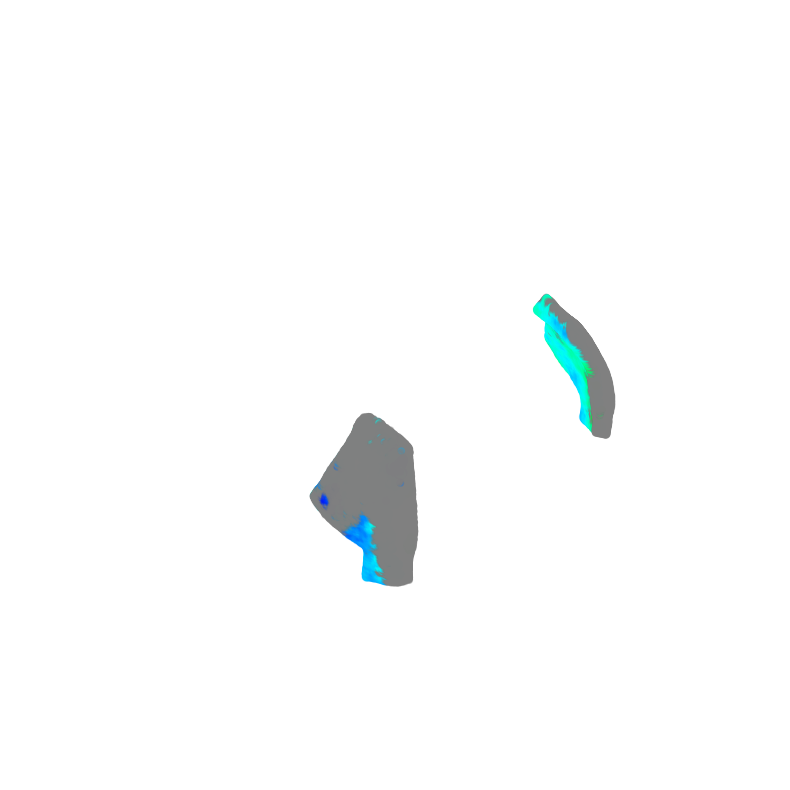

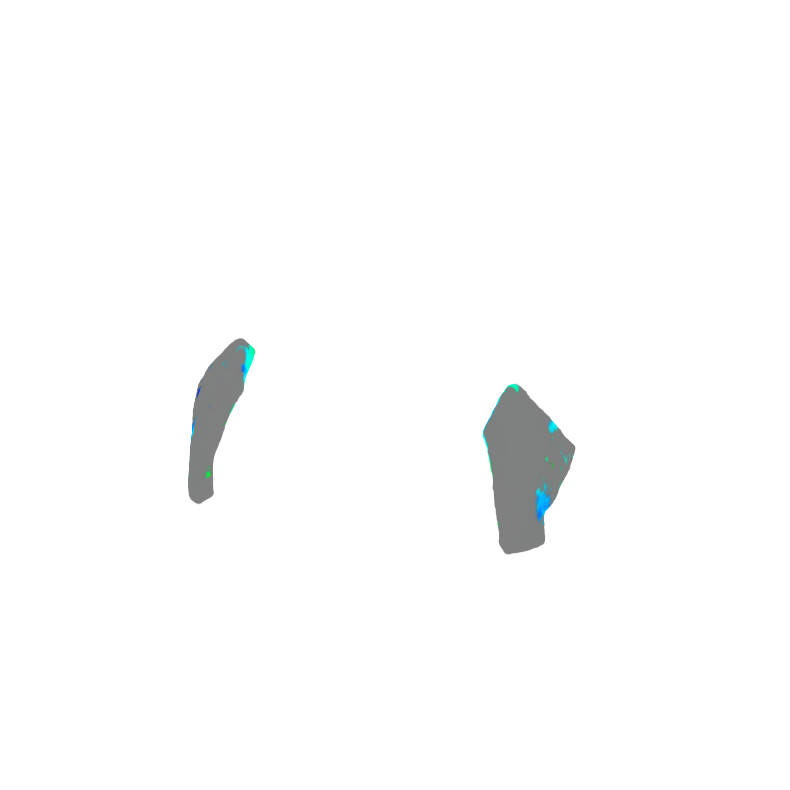

950 SSp-m4
974 SSp-m5
1102 SSp-m6a
2 SSp-m6b
369 SSp-ul
450 SSp-ul1
854 SSp-ul2/3


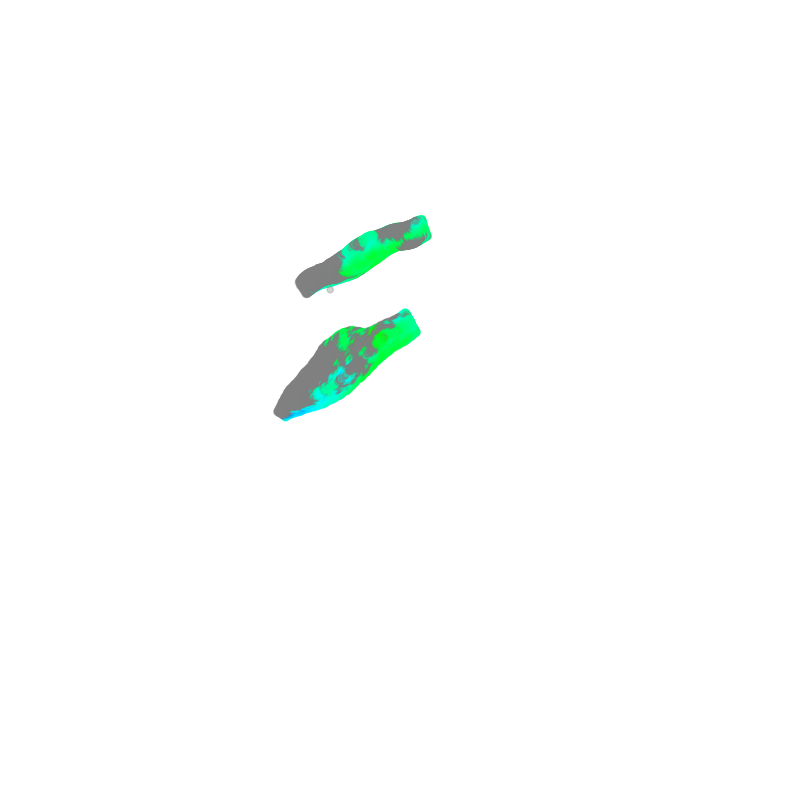

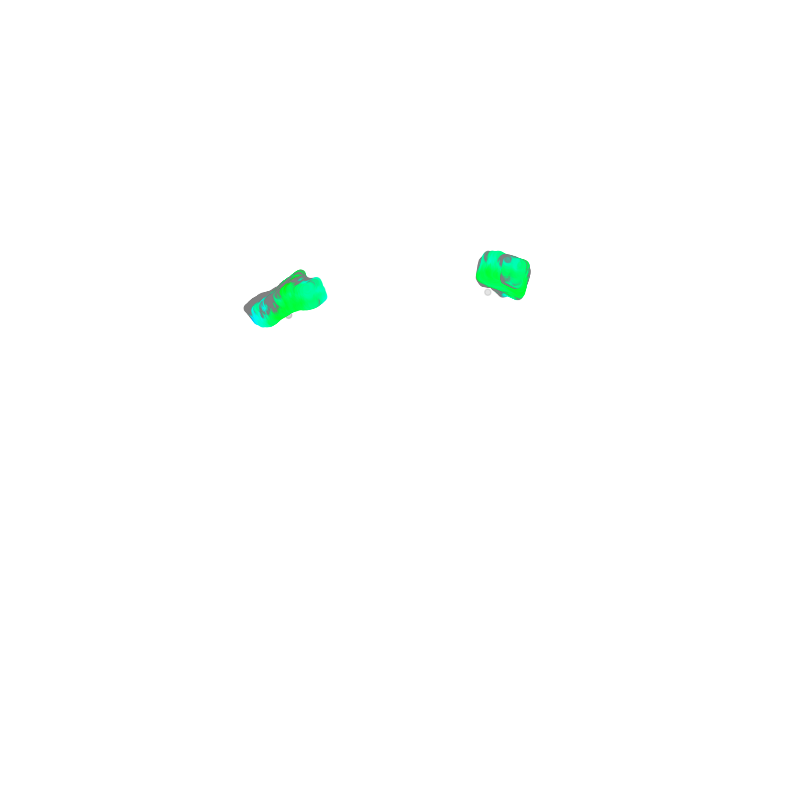

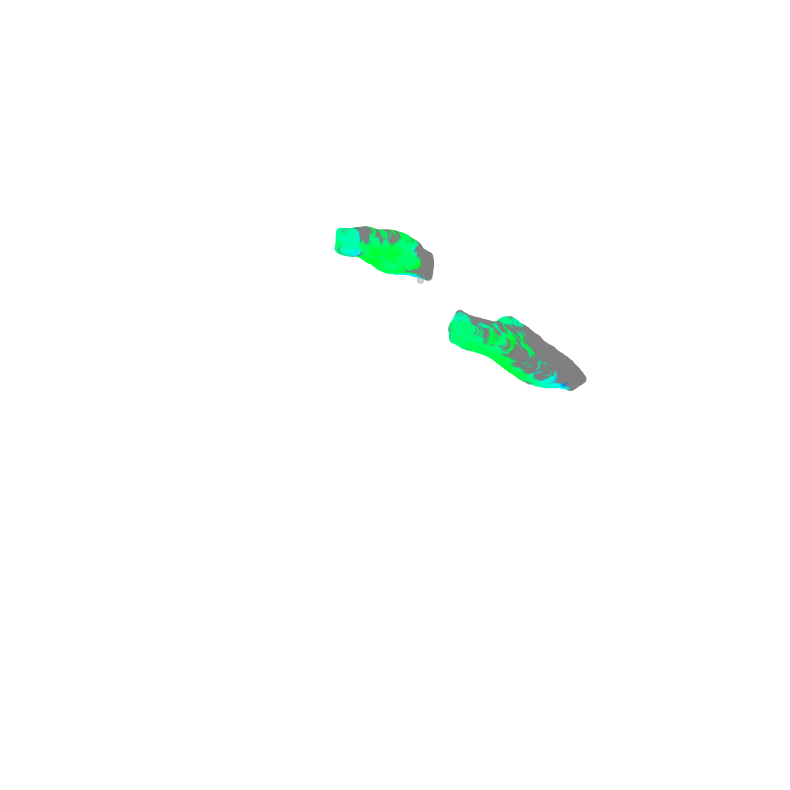

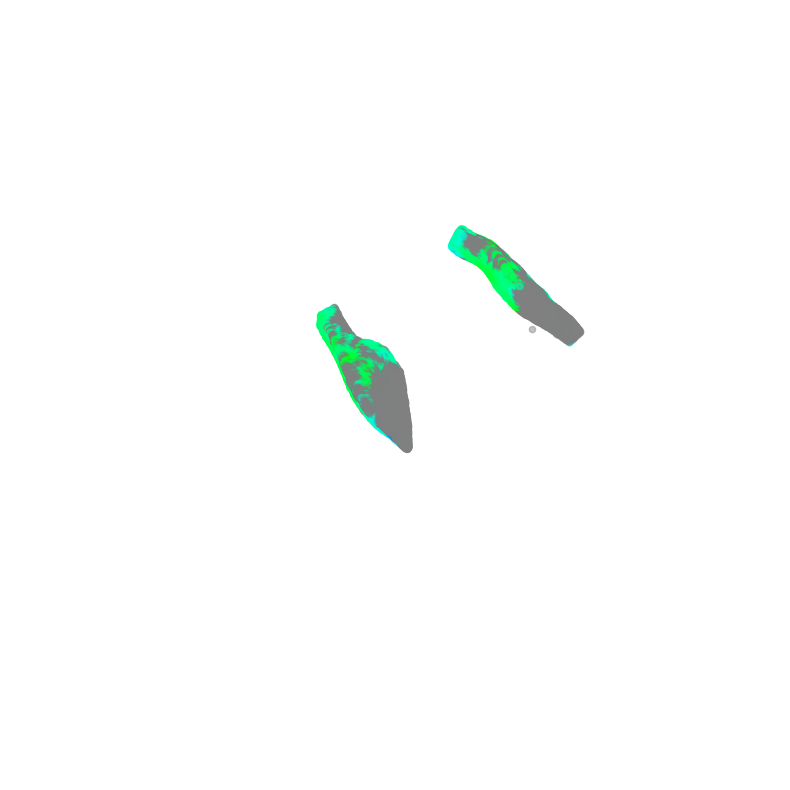

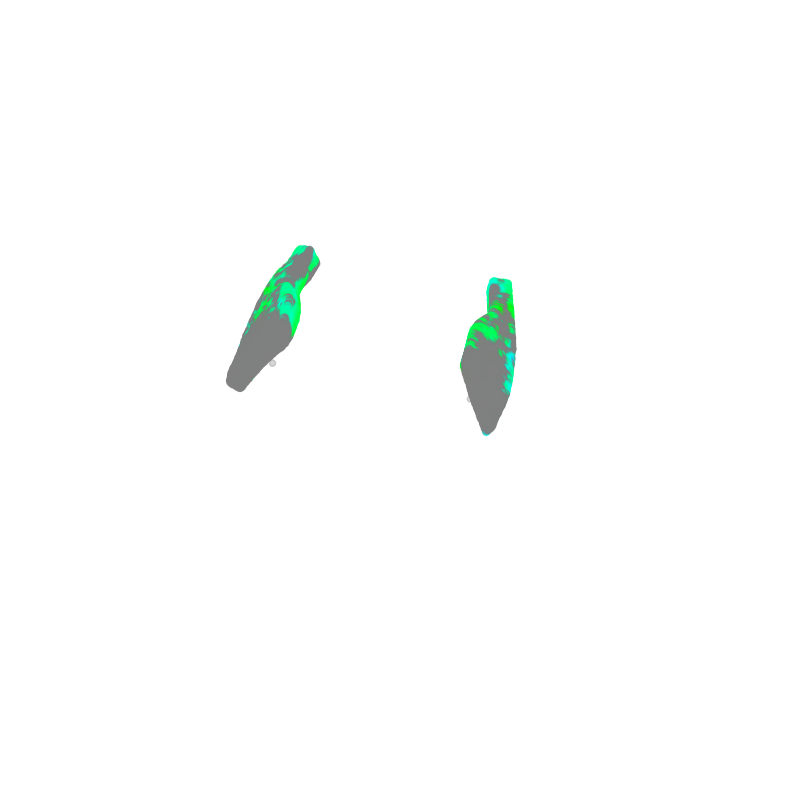

577 SSp-ul4
625 SSp-ul5
945 SSp-ul6a
1026 SSp-ul6b
361 SSp-tr
1006 SSp-tr1
670 SSp-tr2/3


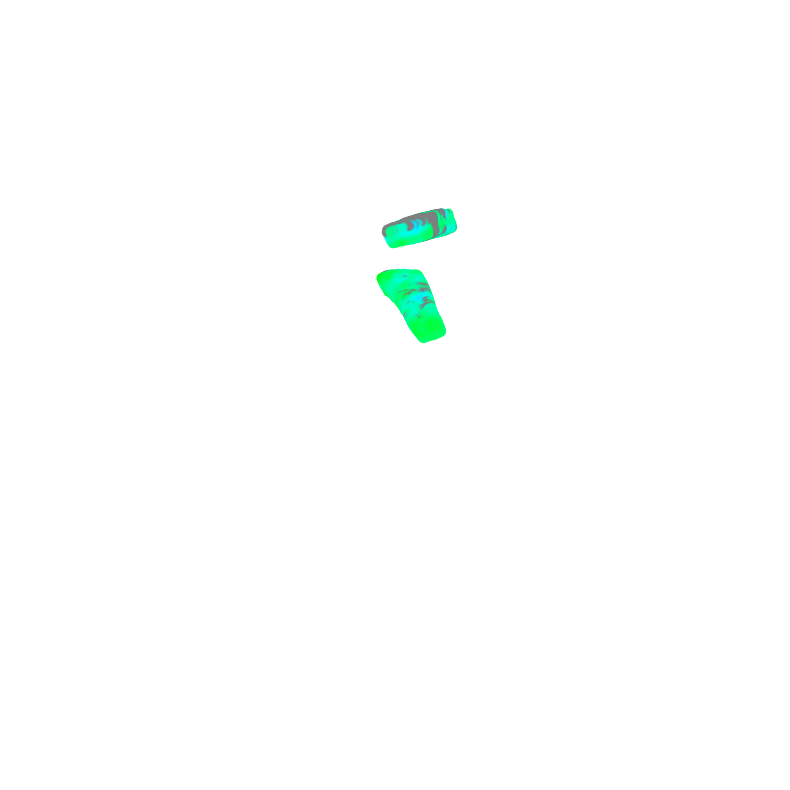

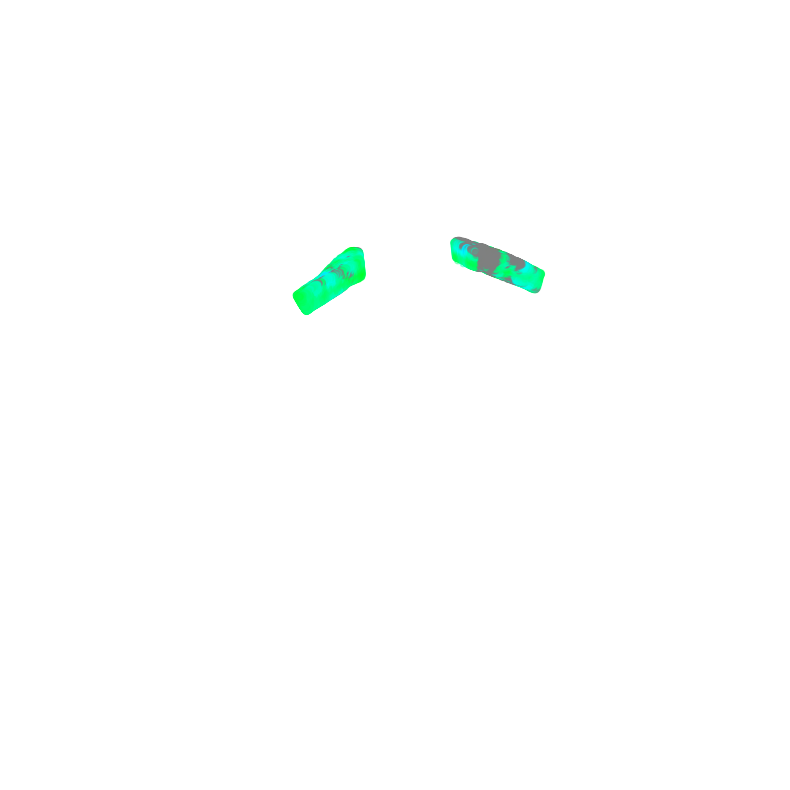

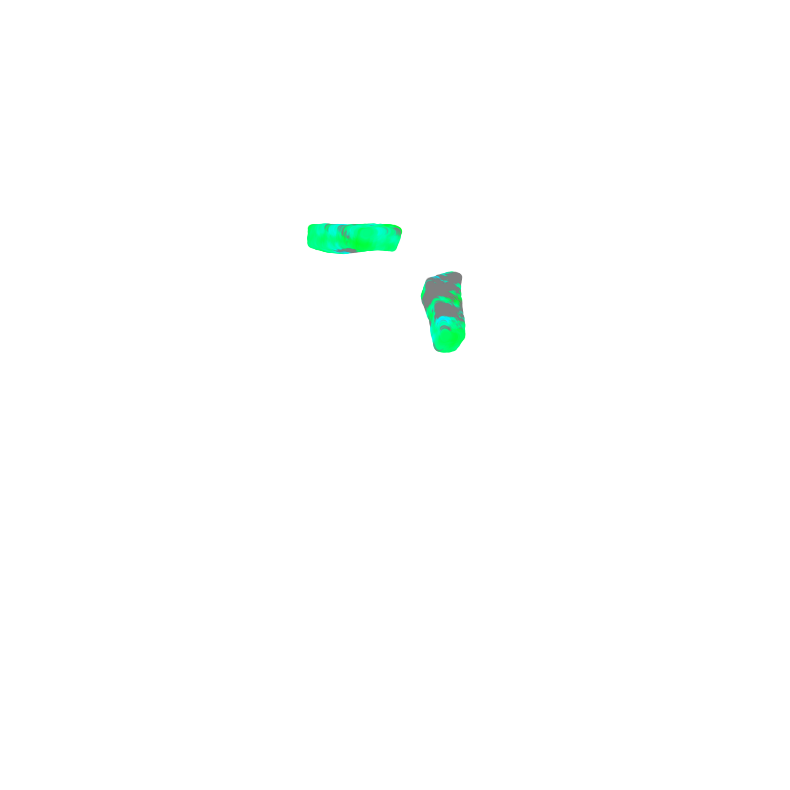

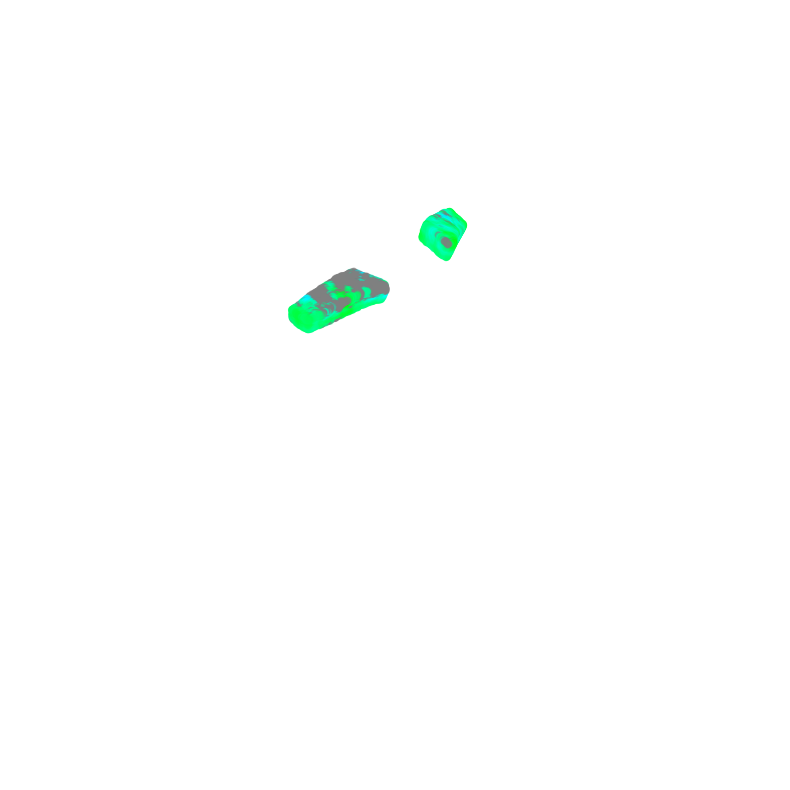

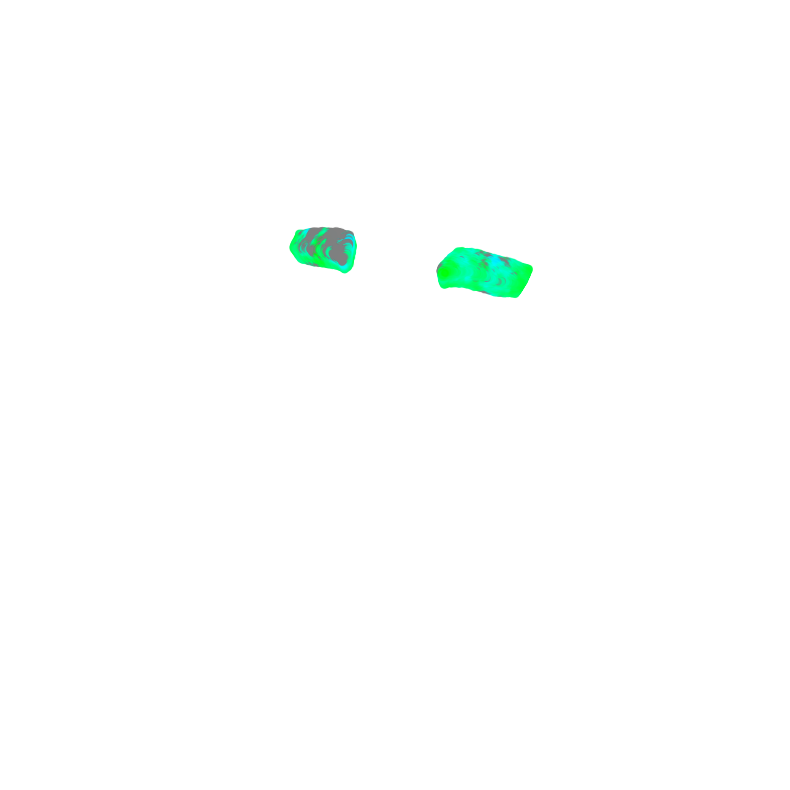

1086 SSp-tr4
1111 SSp-tr5
9 SSp-tr6a
461 SSp-tr6b
18689 SSp-un
18693 SSp-un1
18697 SSp-un2/3


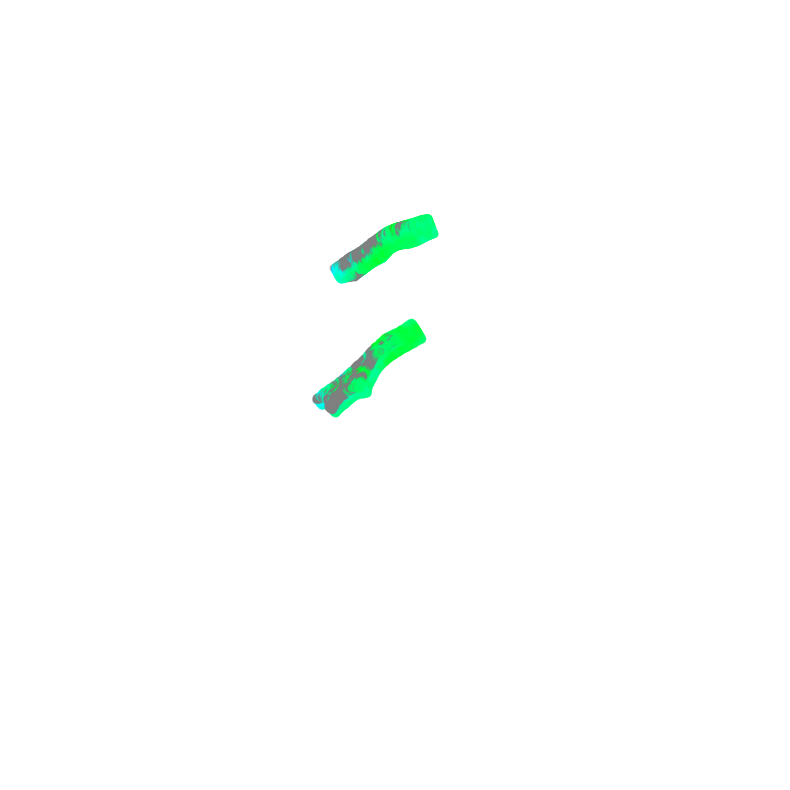

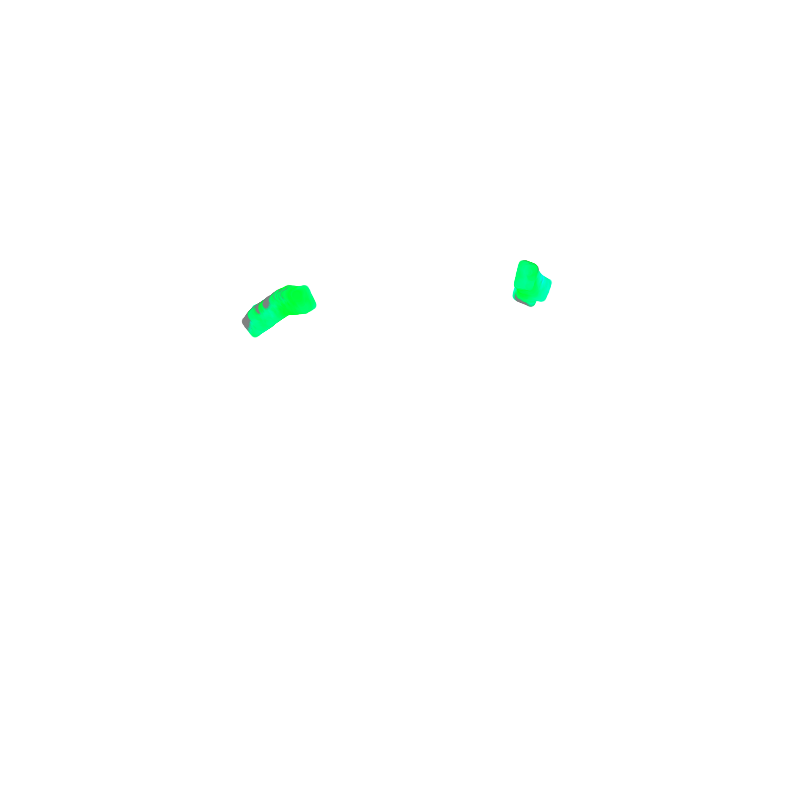

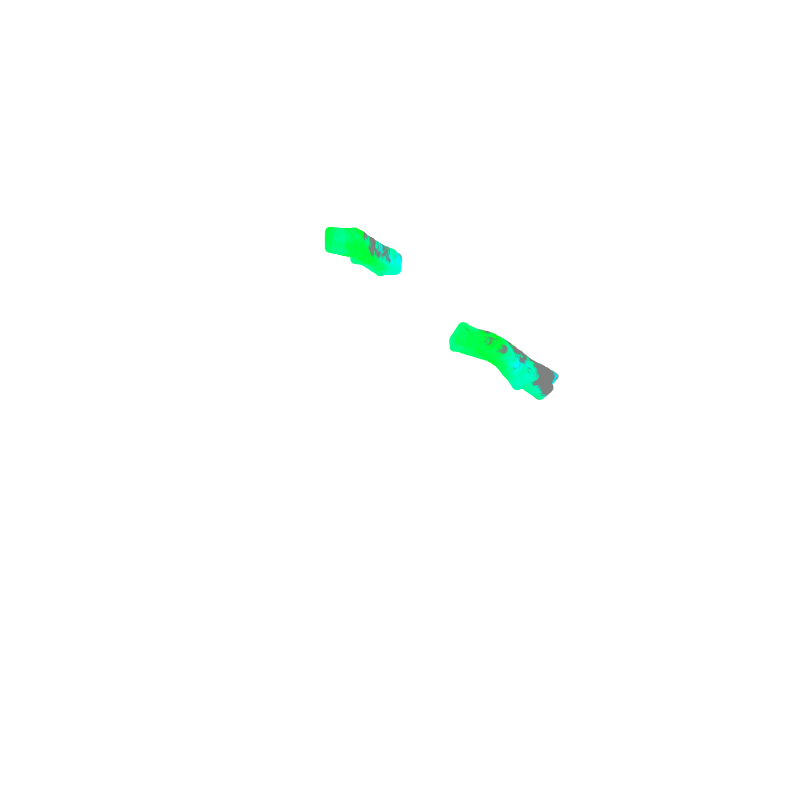

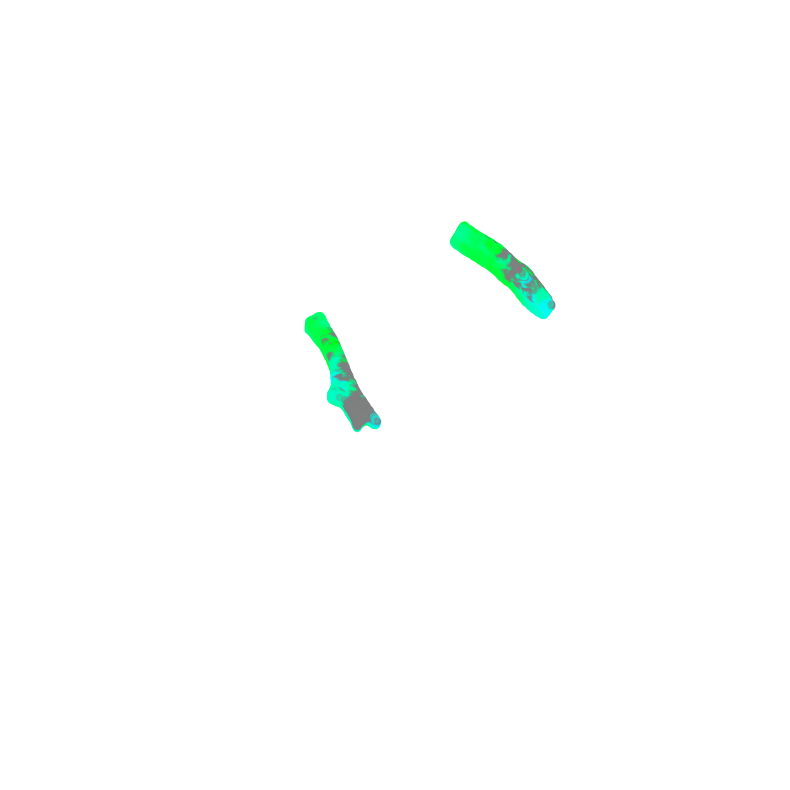

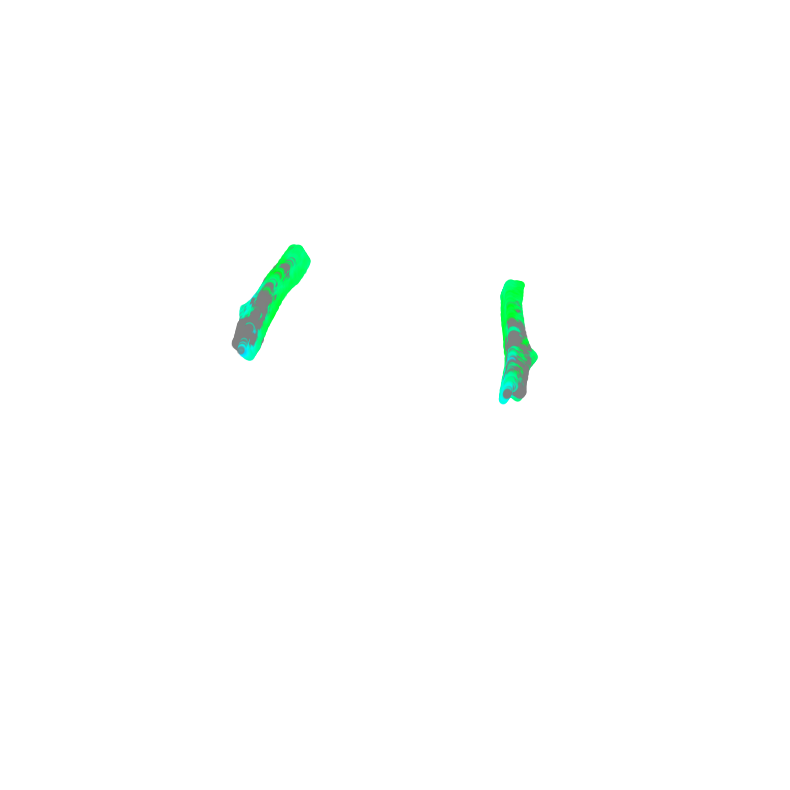

18701 SSp-un4
18705 SSp-un5
18709 SSp-un6a
18713 SSp-un6b
378 SSs
873 SSs1
806 SSs2/3


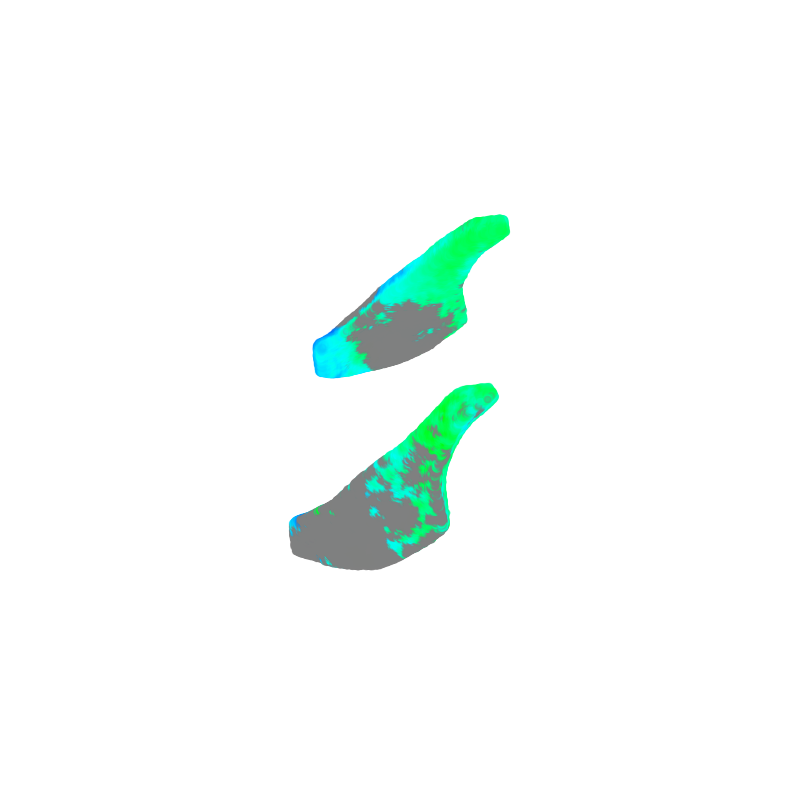

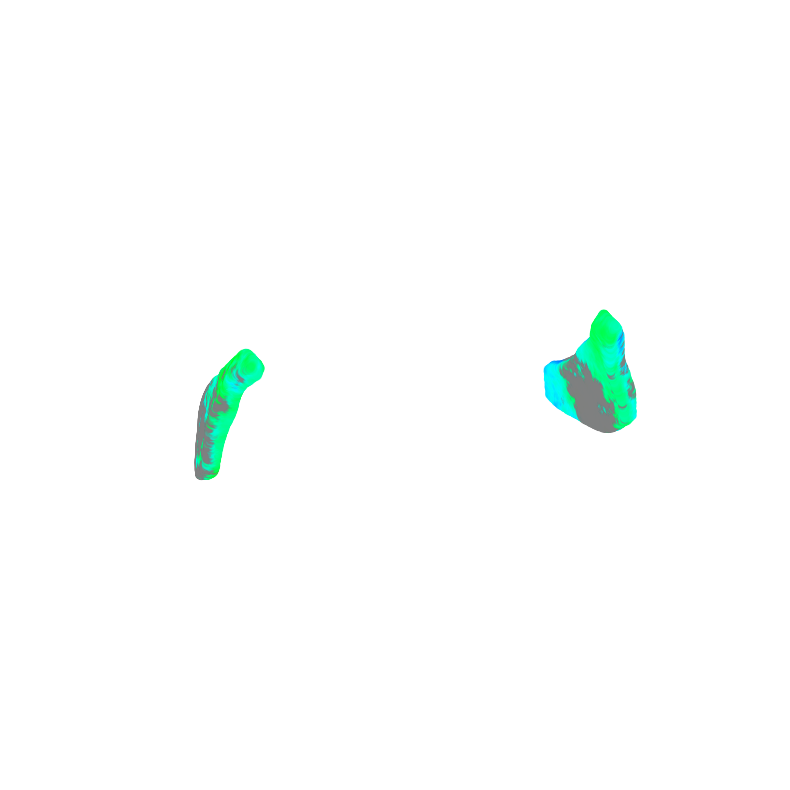

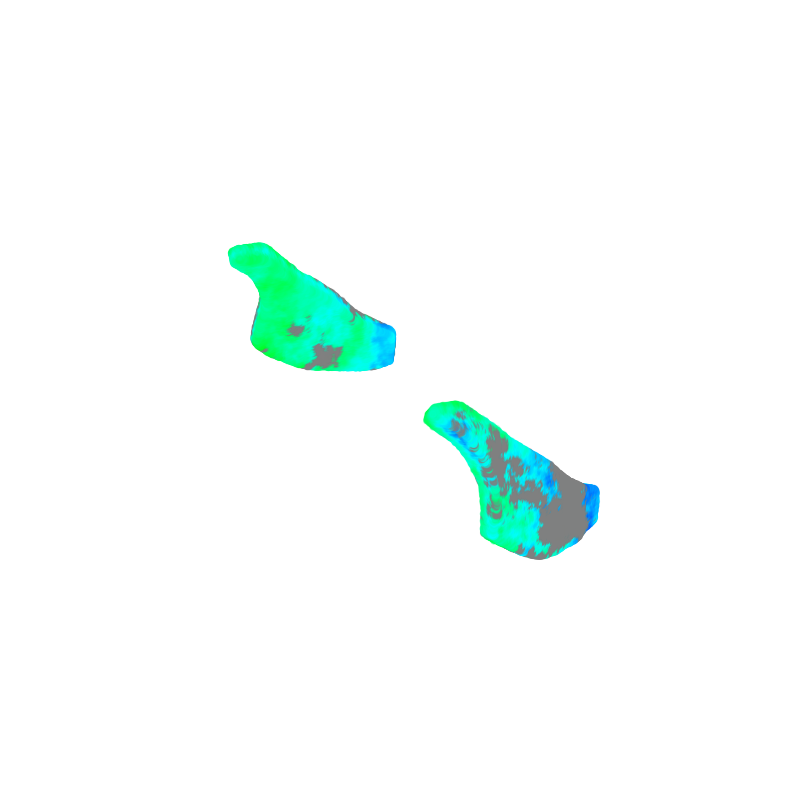

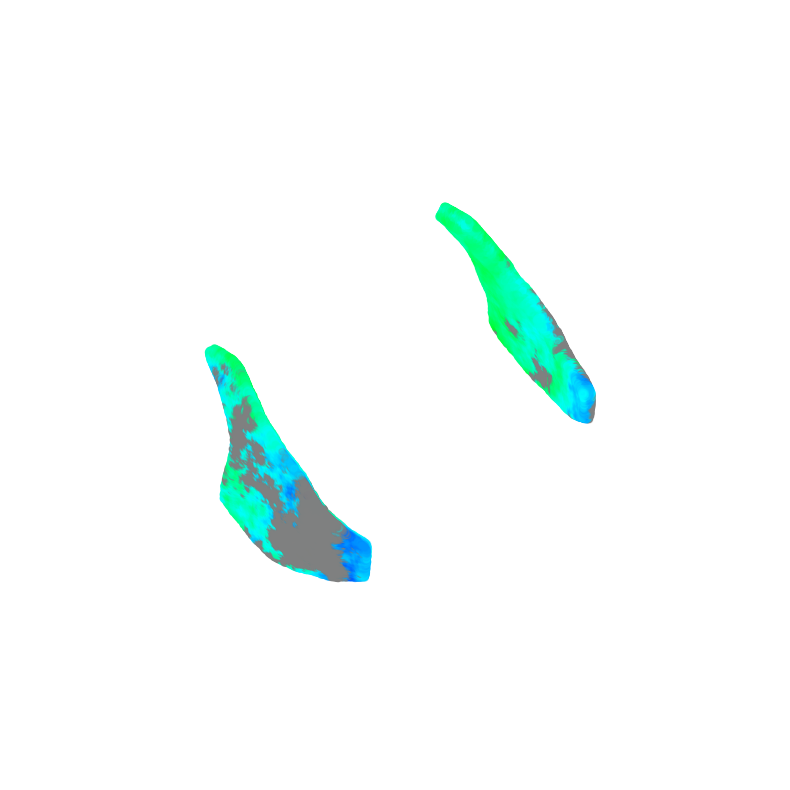

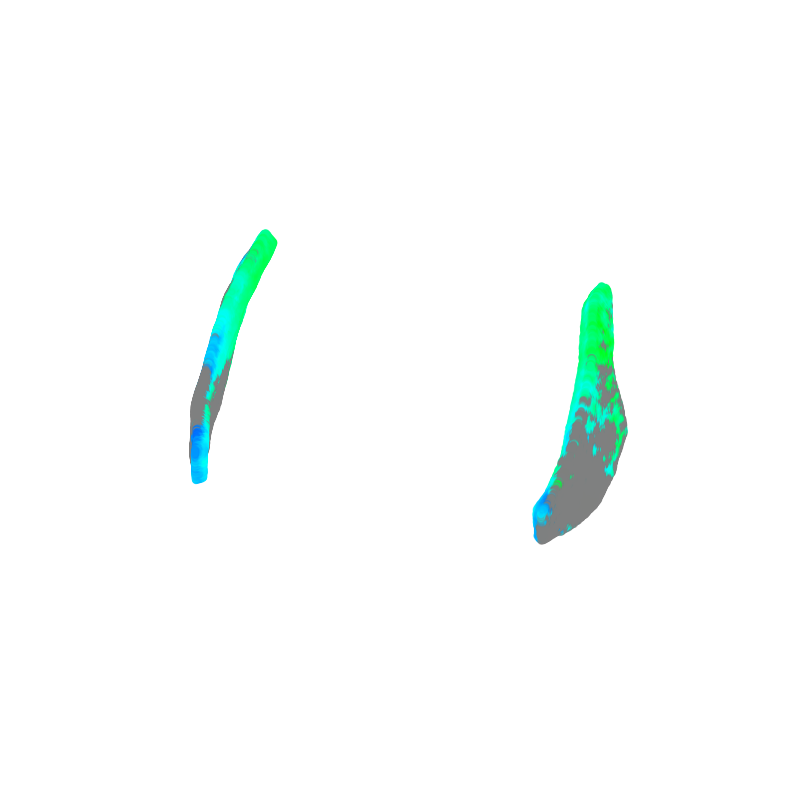

1035 SSs4
1090 SSs5
862 SSs6a
893 SSs6b
1057 GU
36 GU1
180 GU2/3


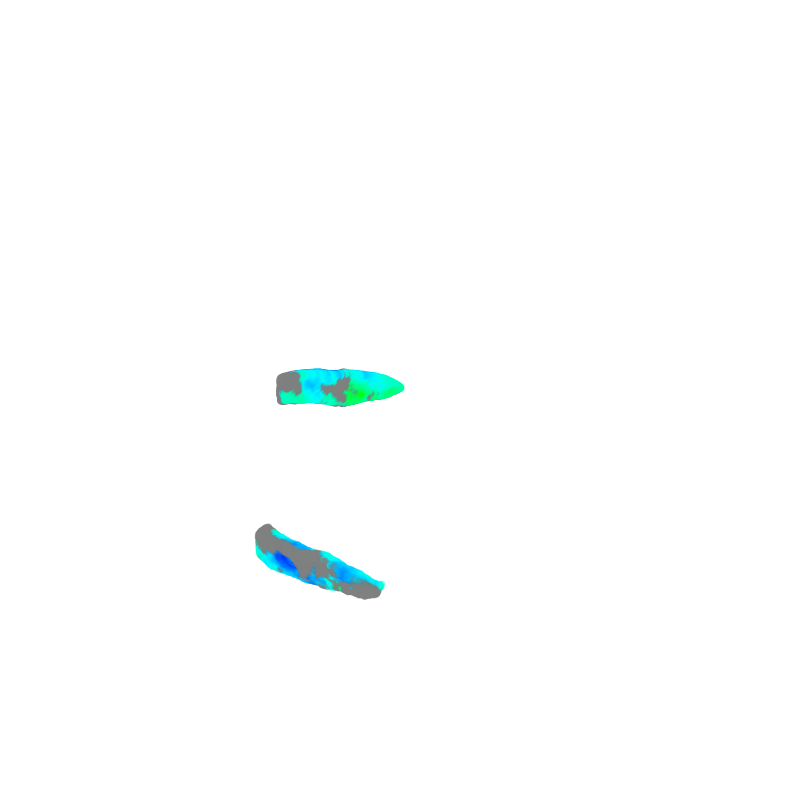

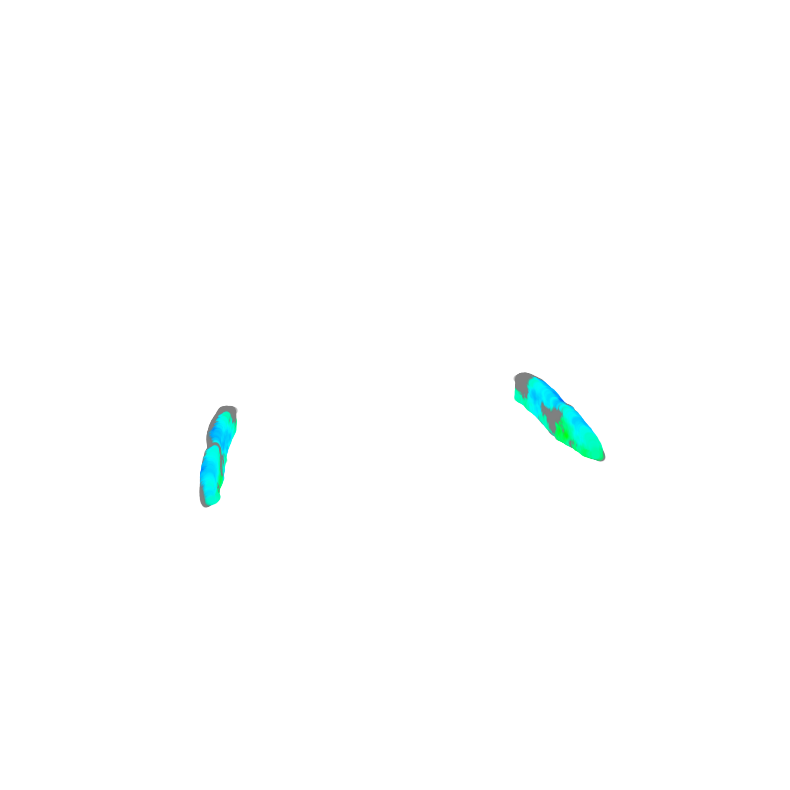

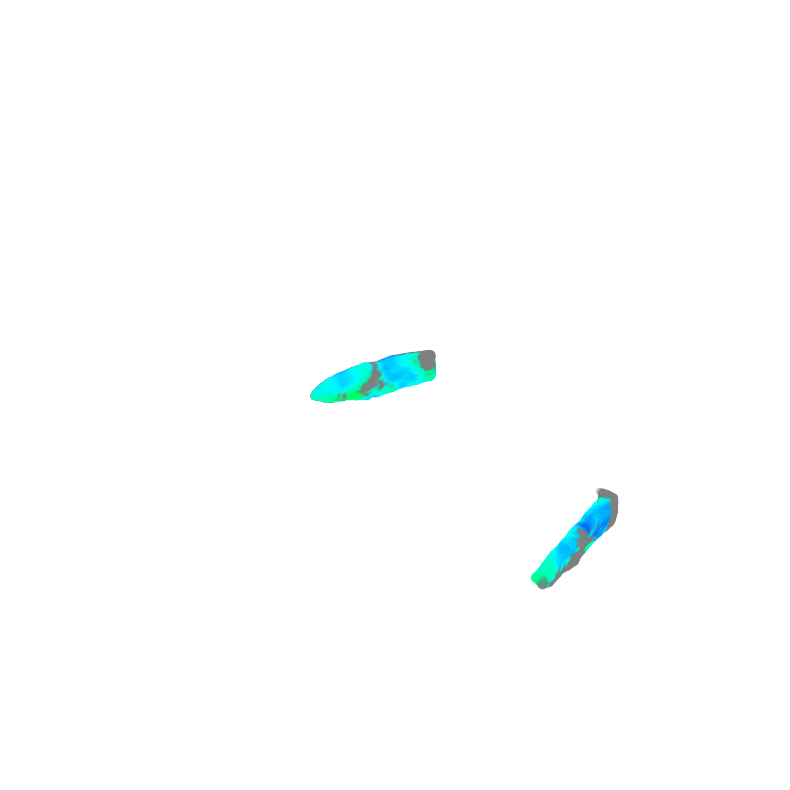

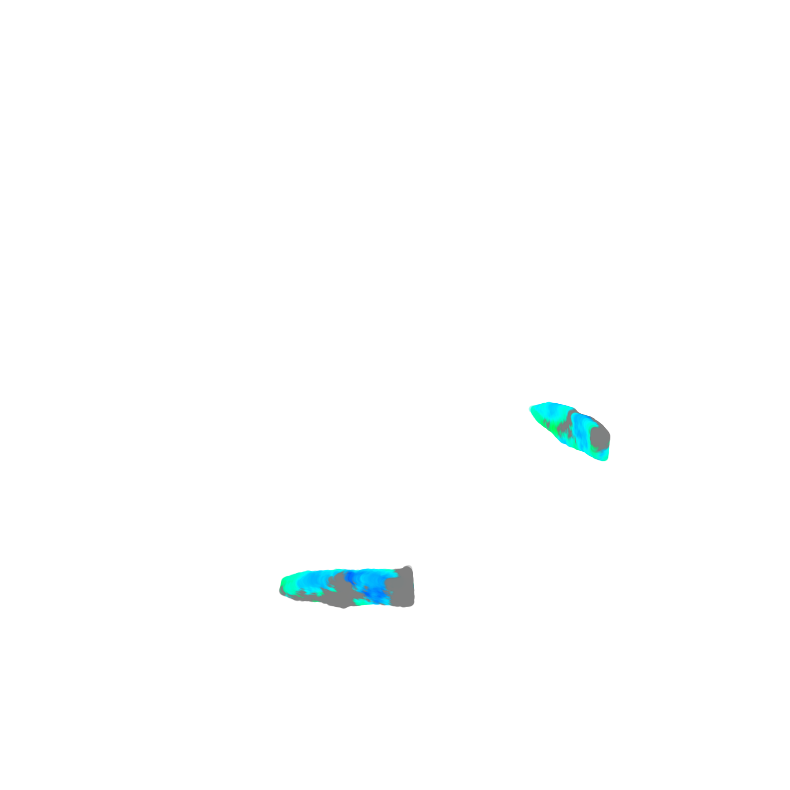

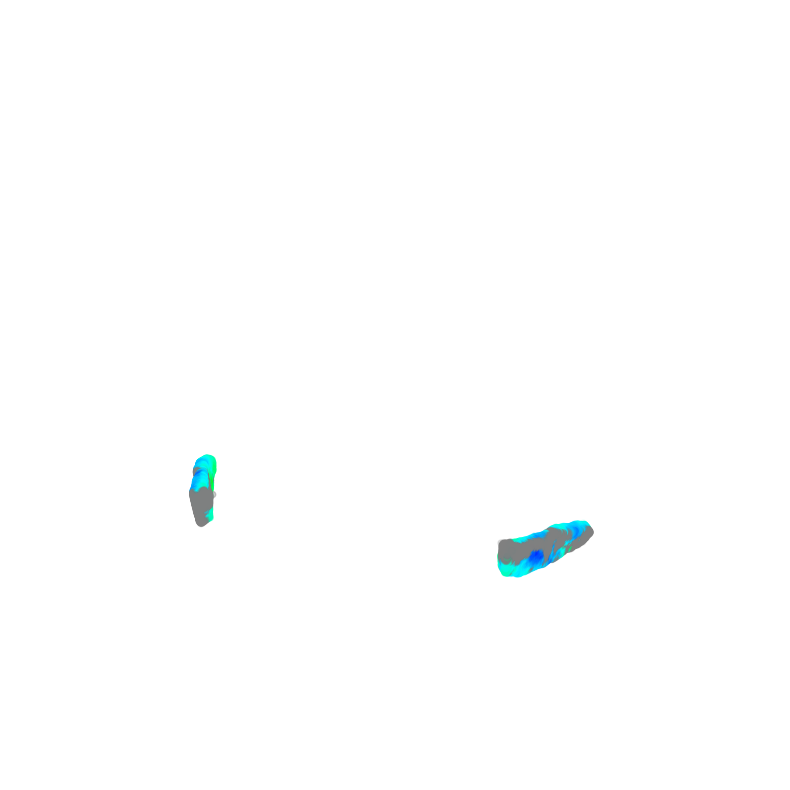

148 GU4
187 GU5
638 GU6a
662 GU6b
677 VISC
897 VISC1
1106 VISC2/3


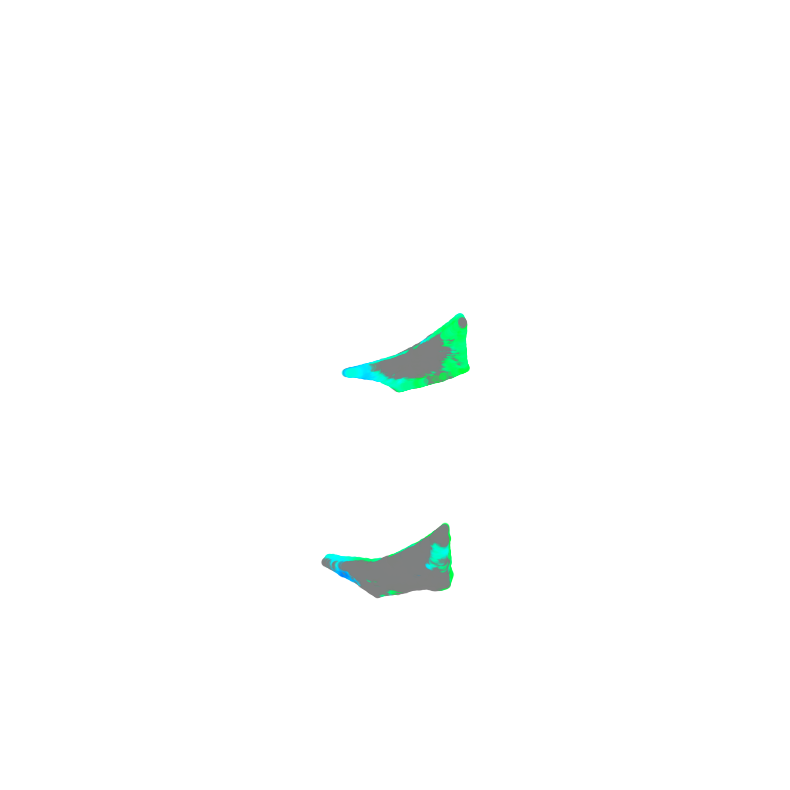

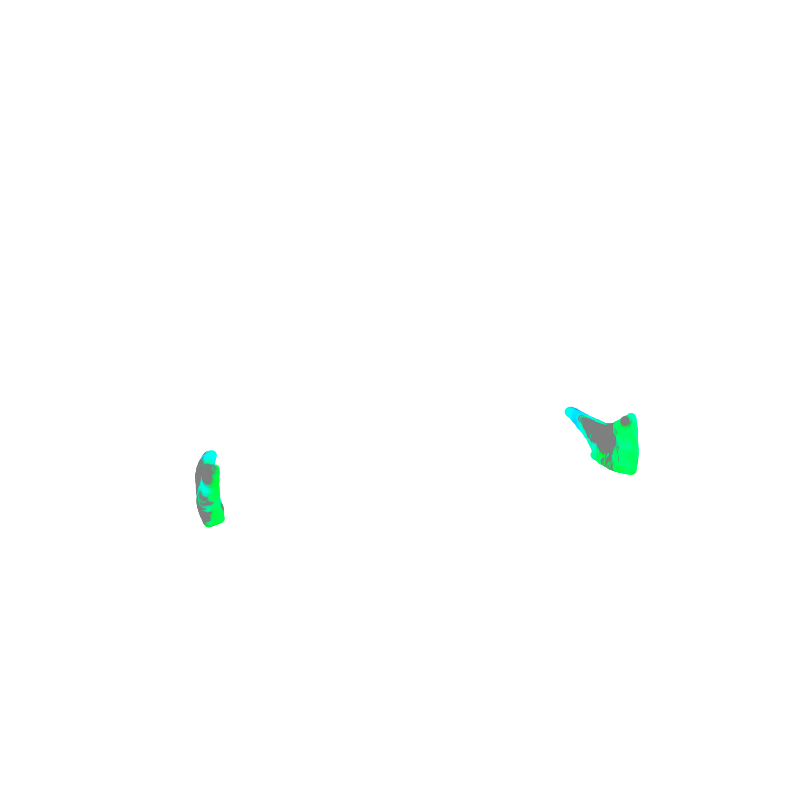

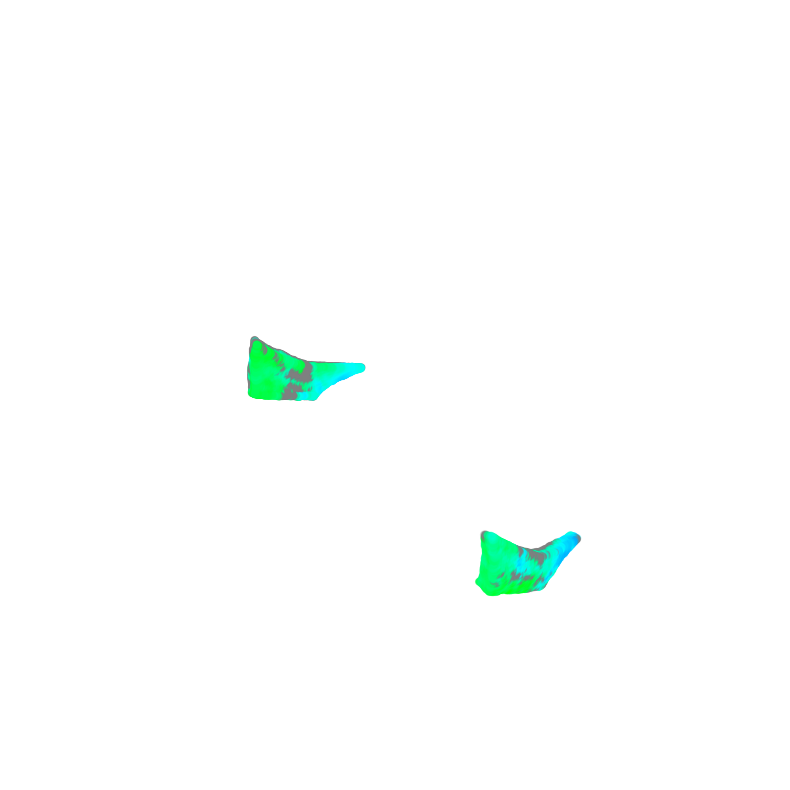

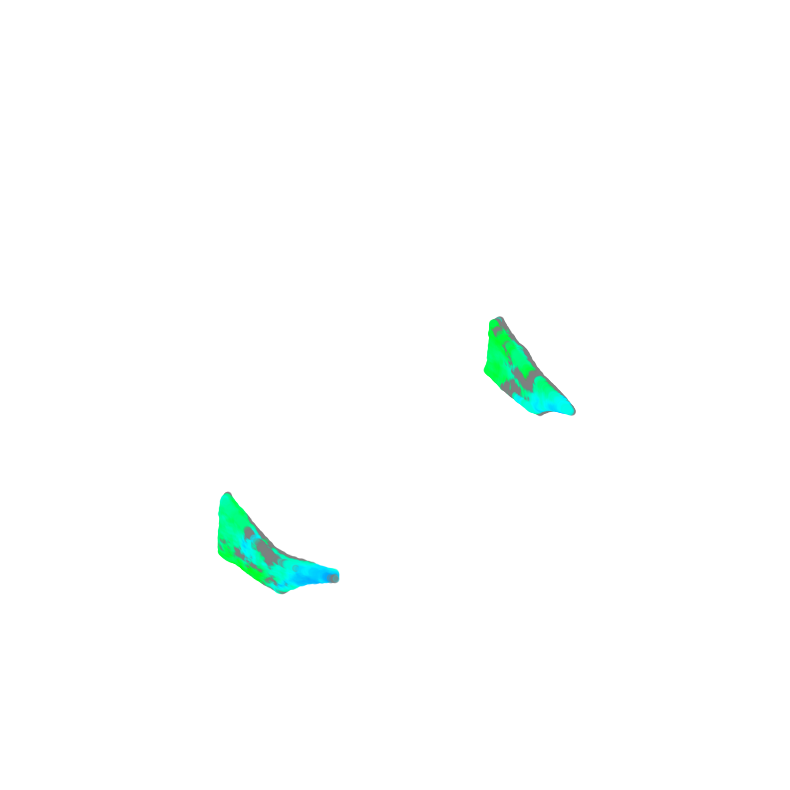

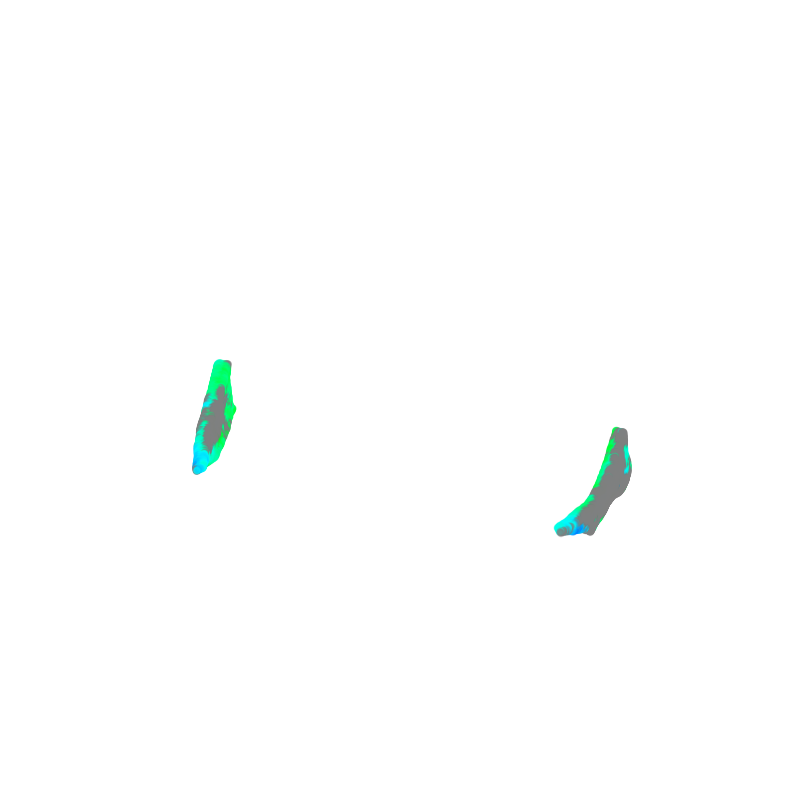

1010 VISC4
1058 VISC5
857 VISC6a
849 VISC6b
247 AUD
1011 AUDd
527 AUDd1
600 AUDd2/3


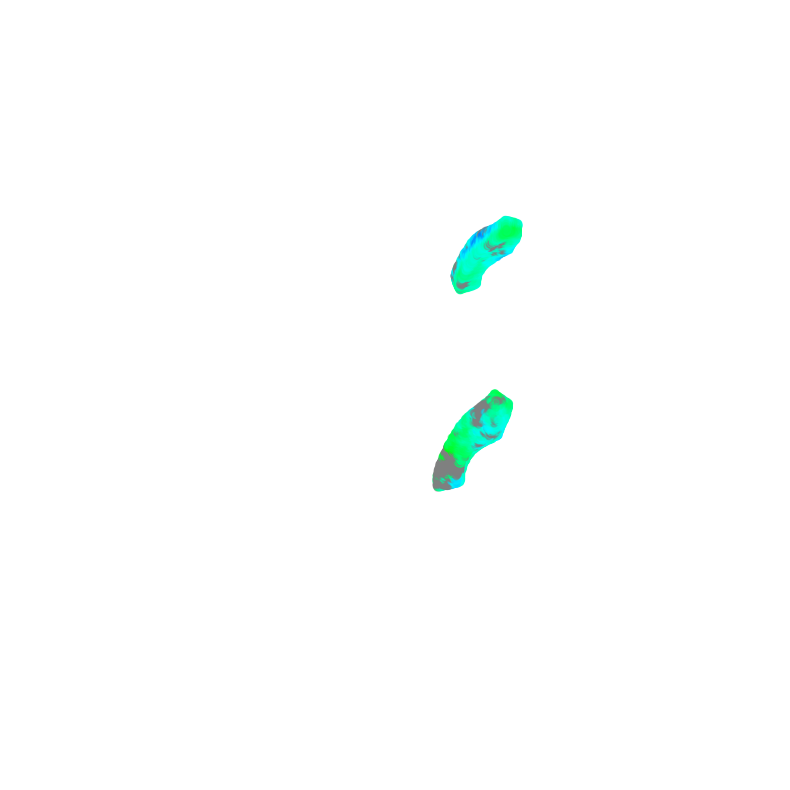

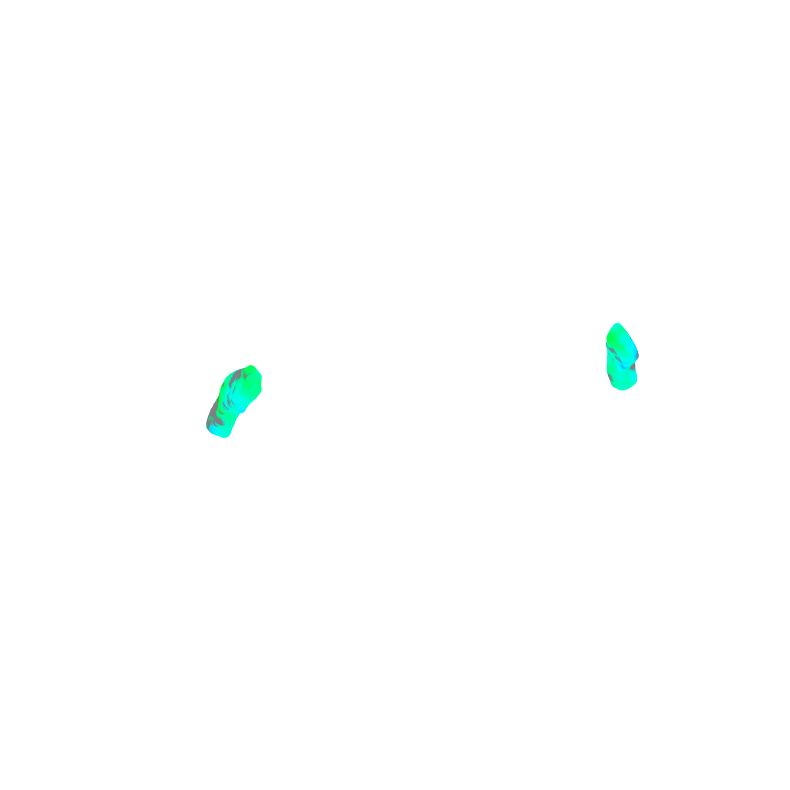

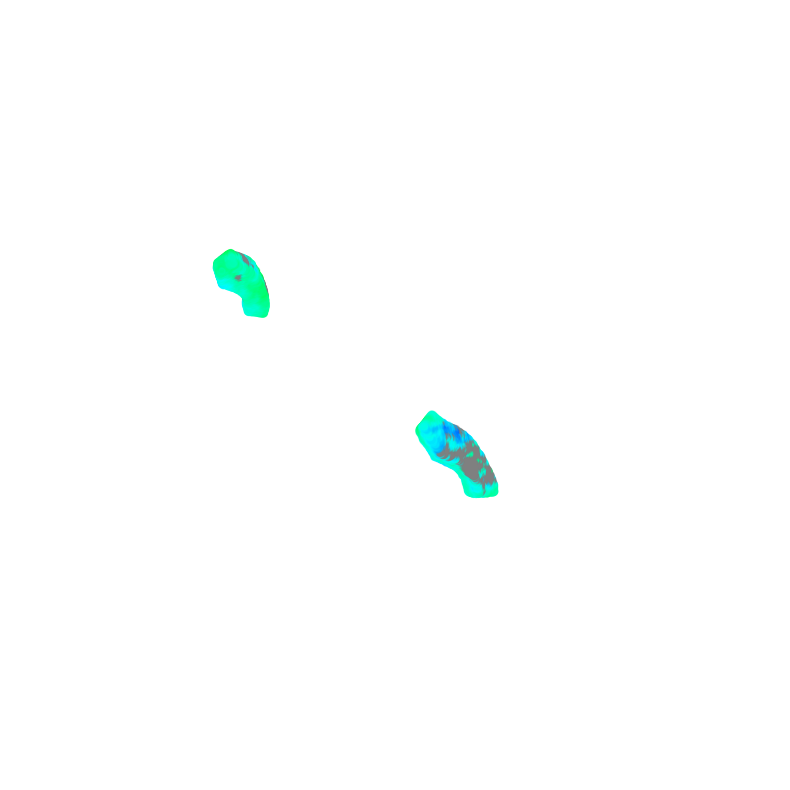

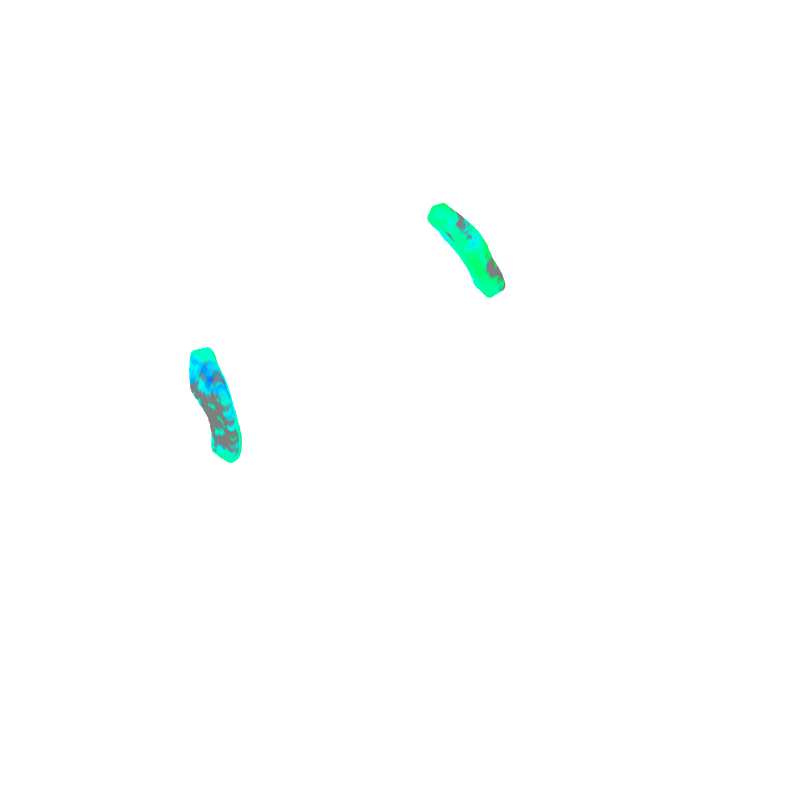

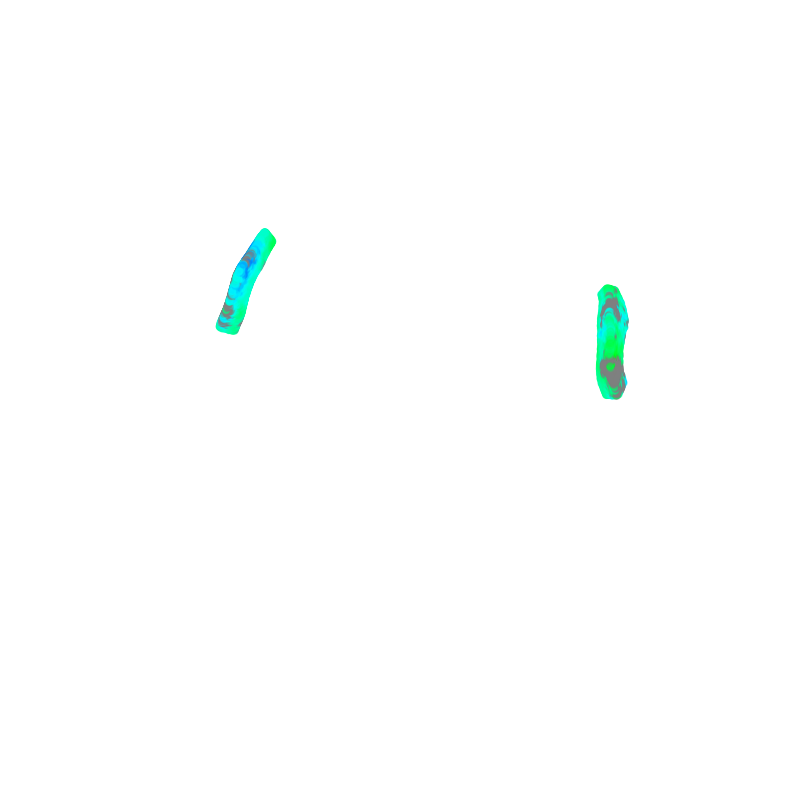

678 AUDd4
252 AUDd5
156 AUDd6a
243 AUDd6b
1002 AUDp
735 AUDp1
251 AUDp2/3


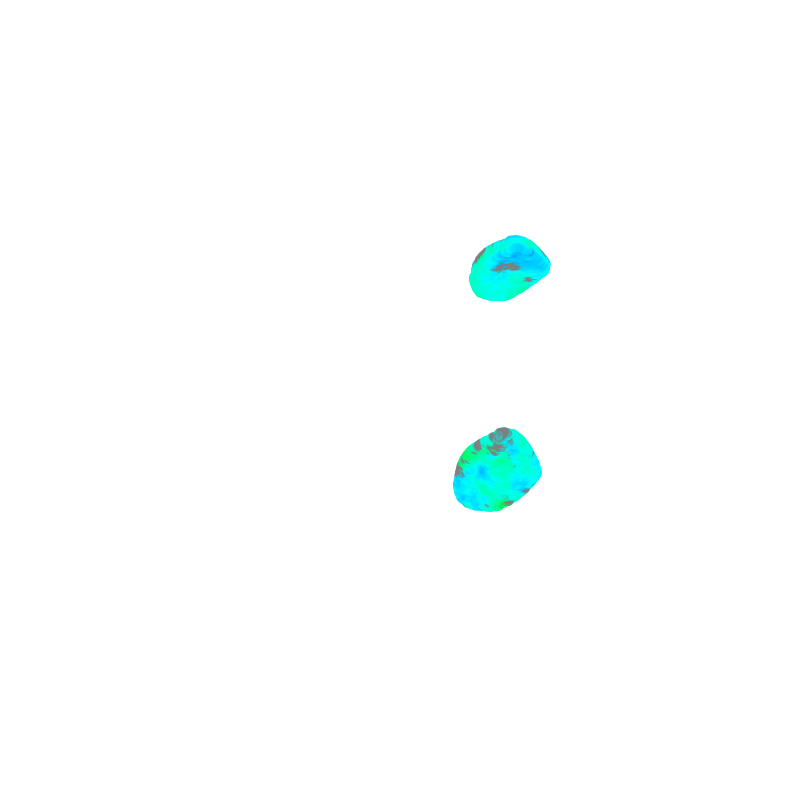

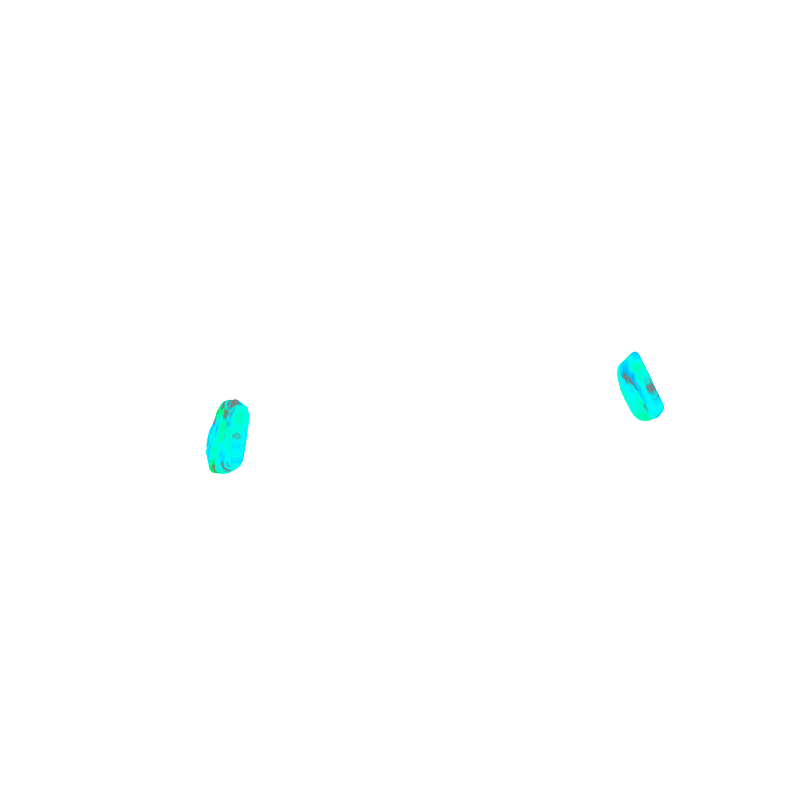

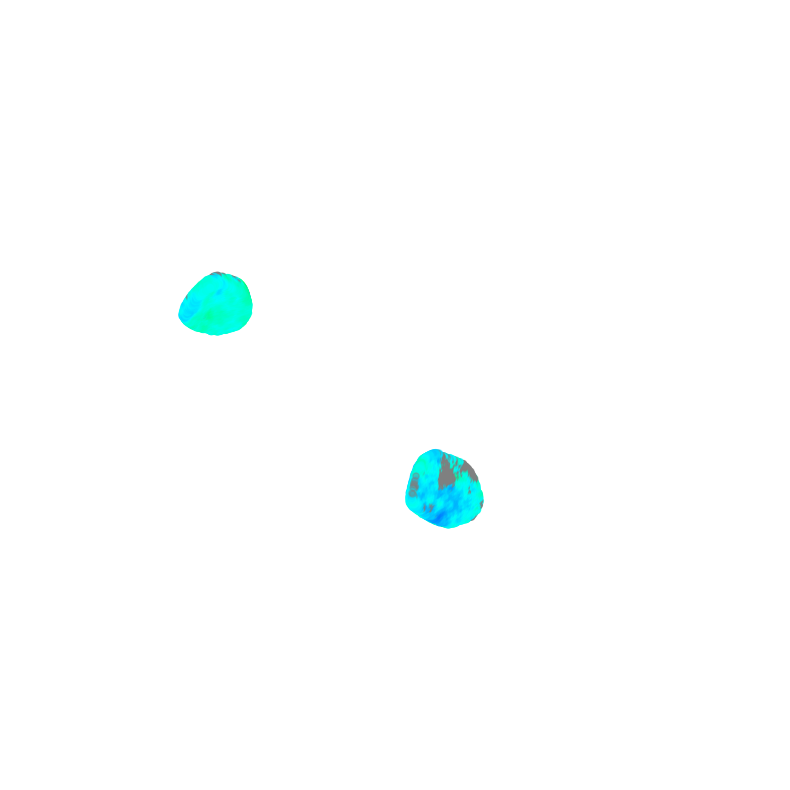

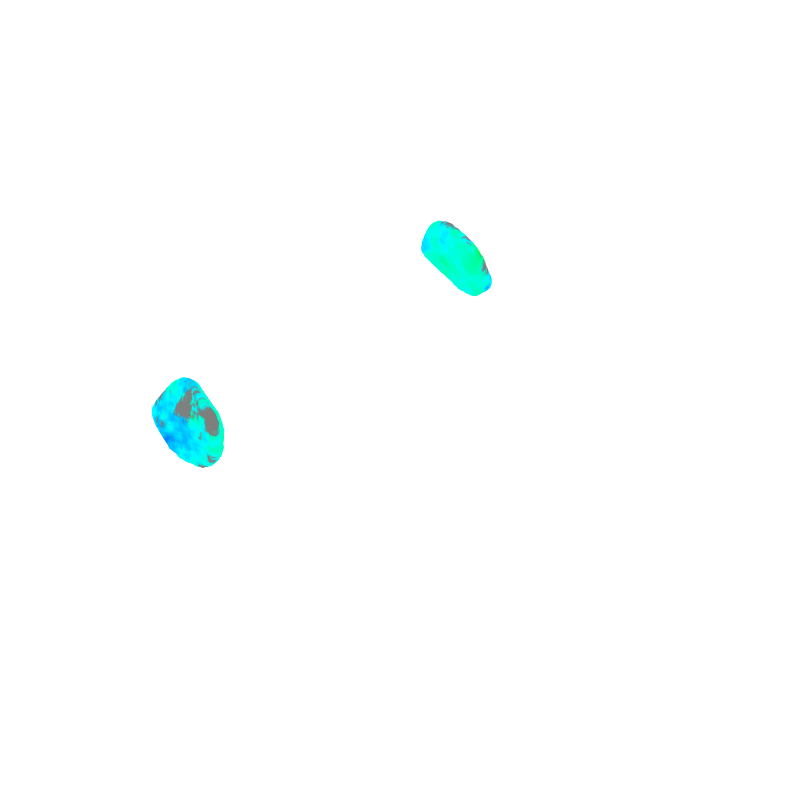

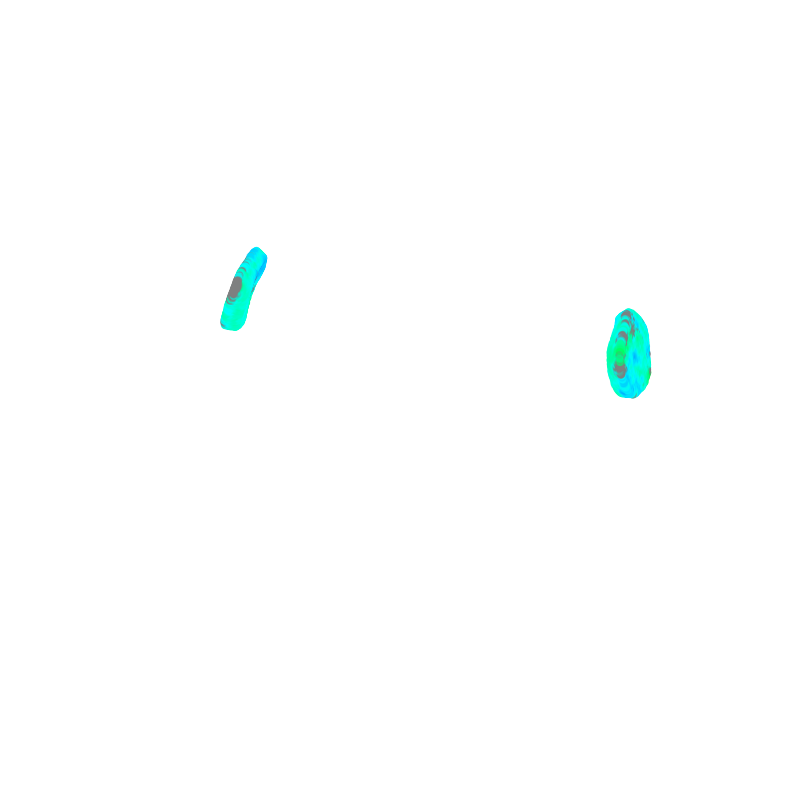

816 AUDp4
847 AUDp5
954 AUDp6a
1005 AUDp6b
1027 AUDpo
696 AUDpo1
643 AUDpo2/3


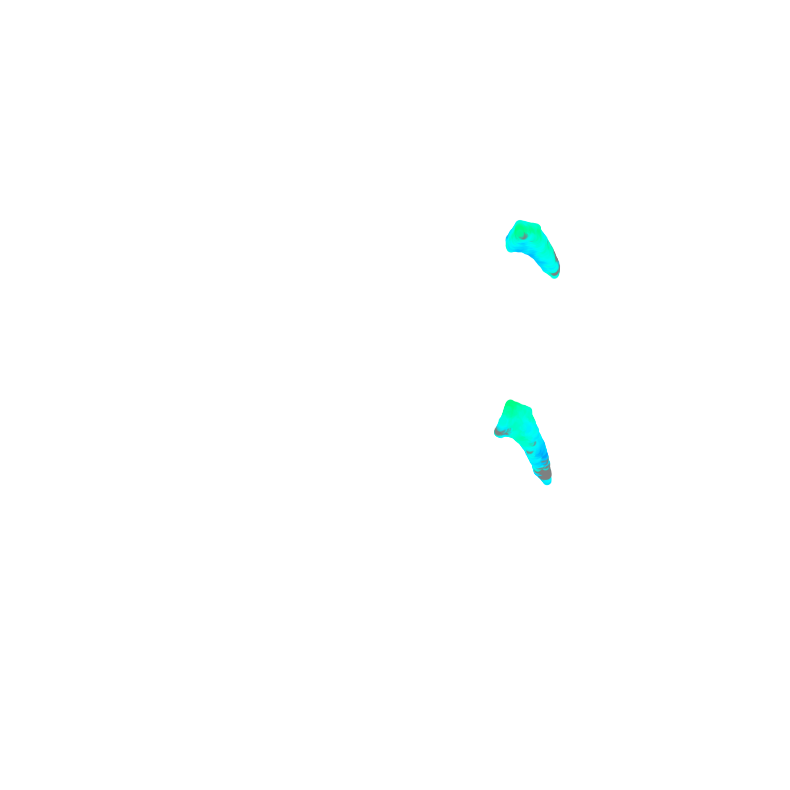

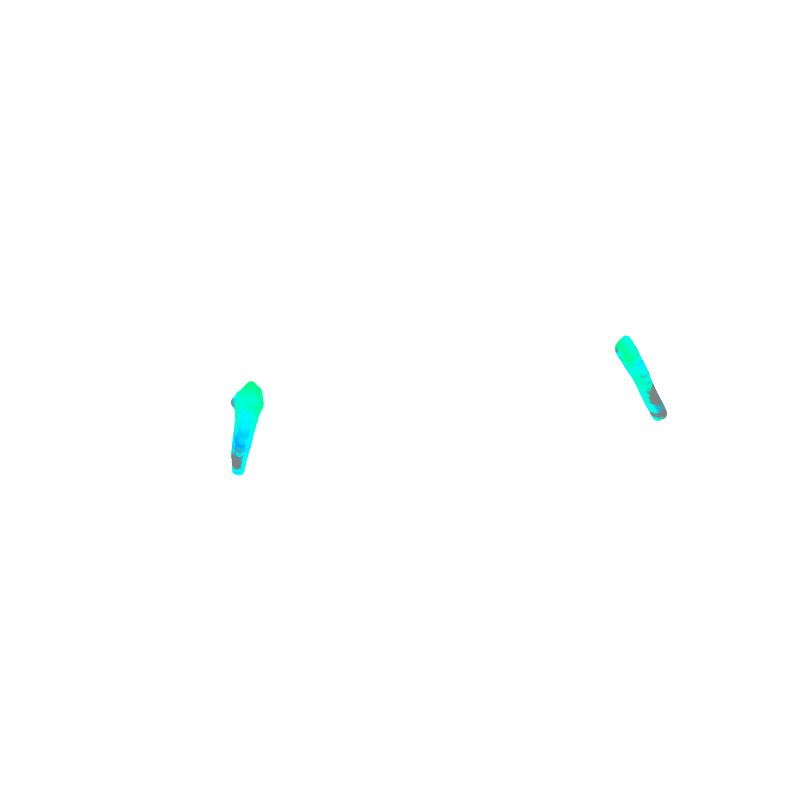

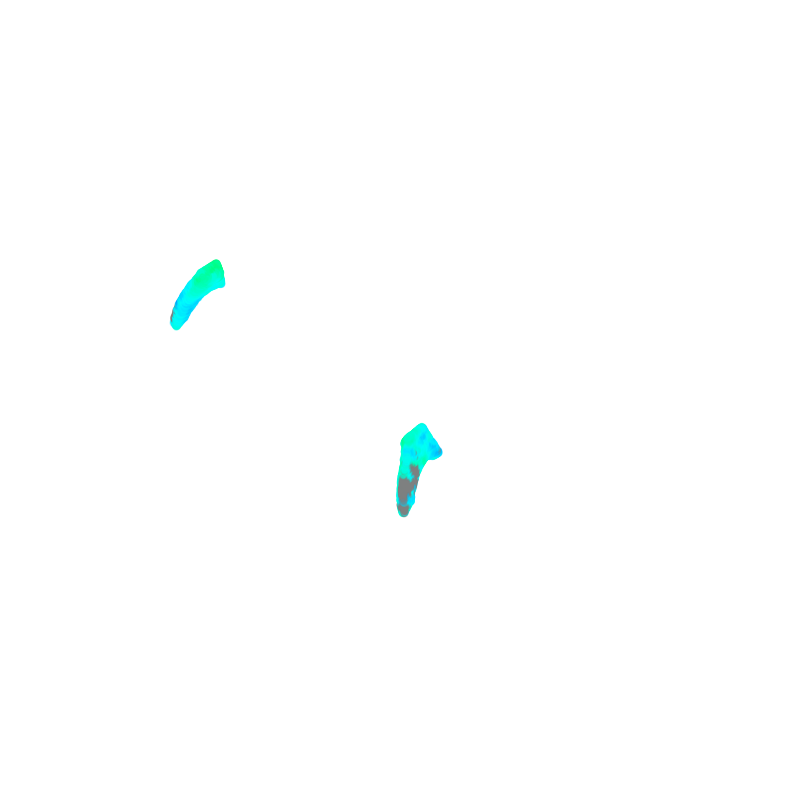

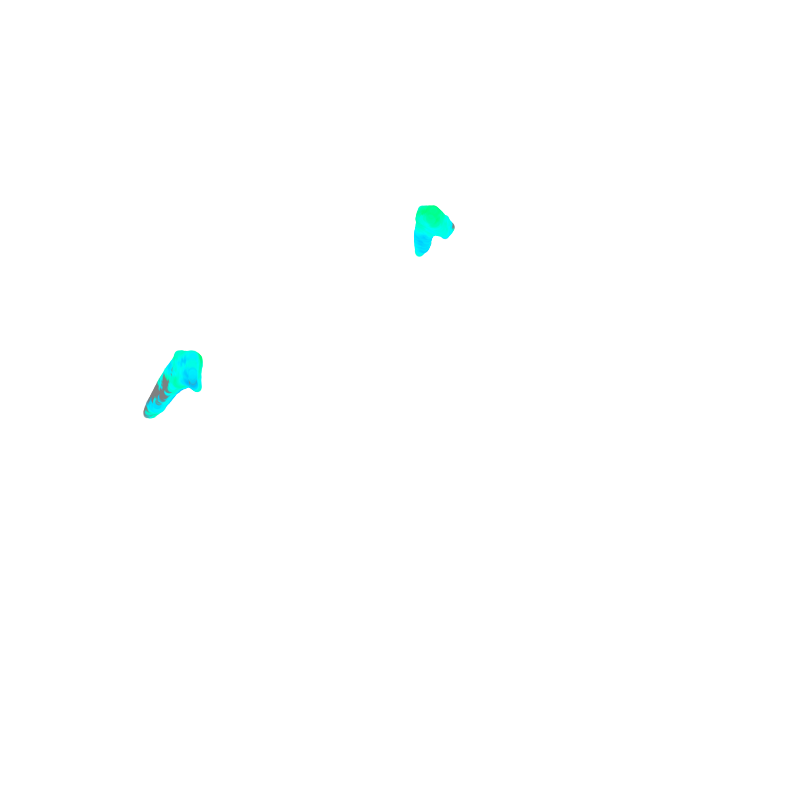

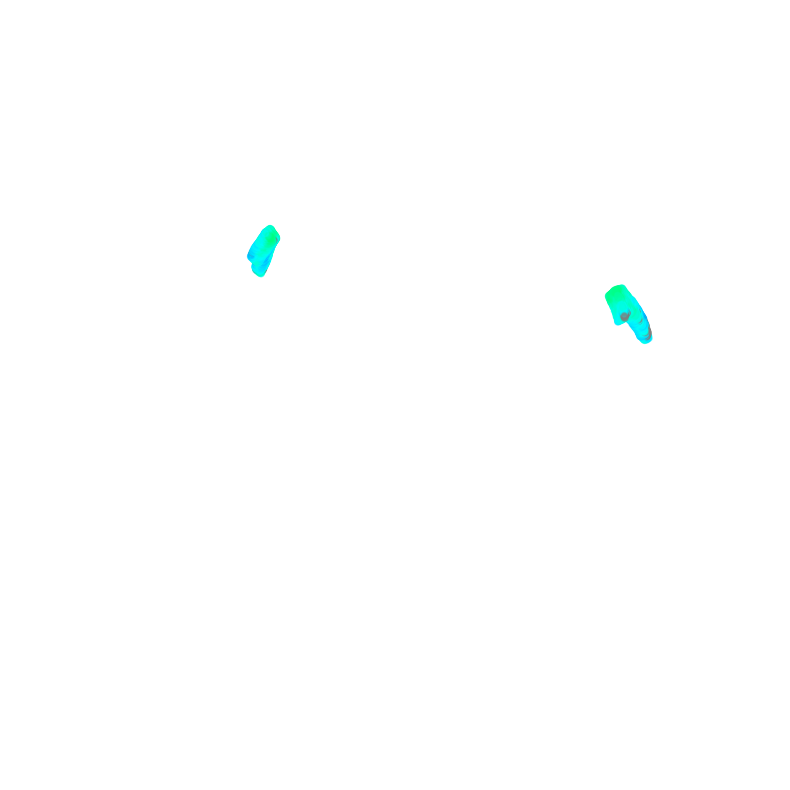

759 AUDpo4
791 AUDpo5
249 AUDpo6a
456 AUDpo6b
1018 AUDv
959 AUDv1
755 AUDv2/3


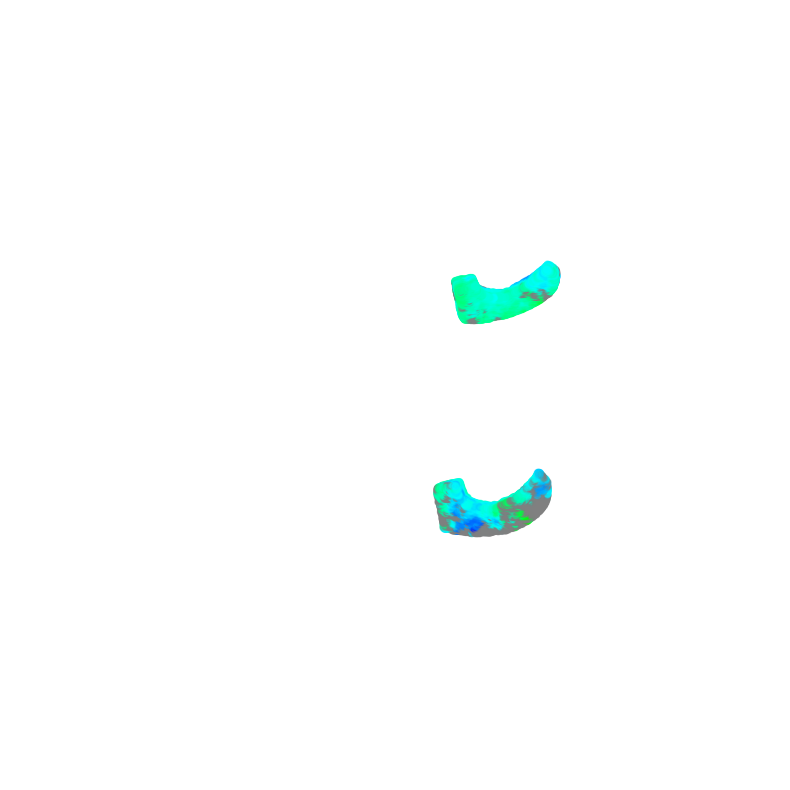

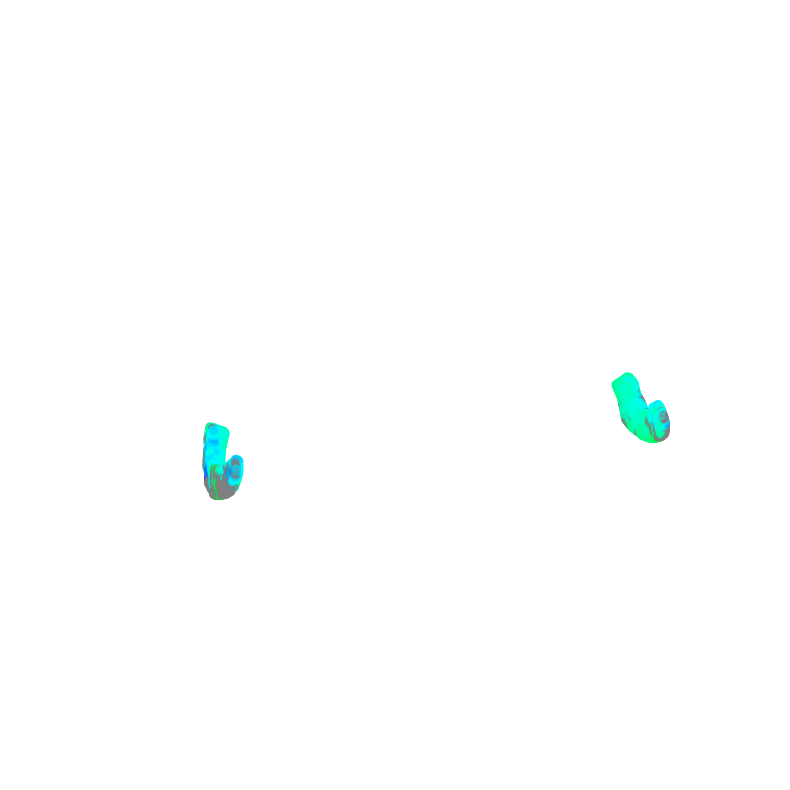

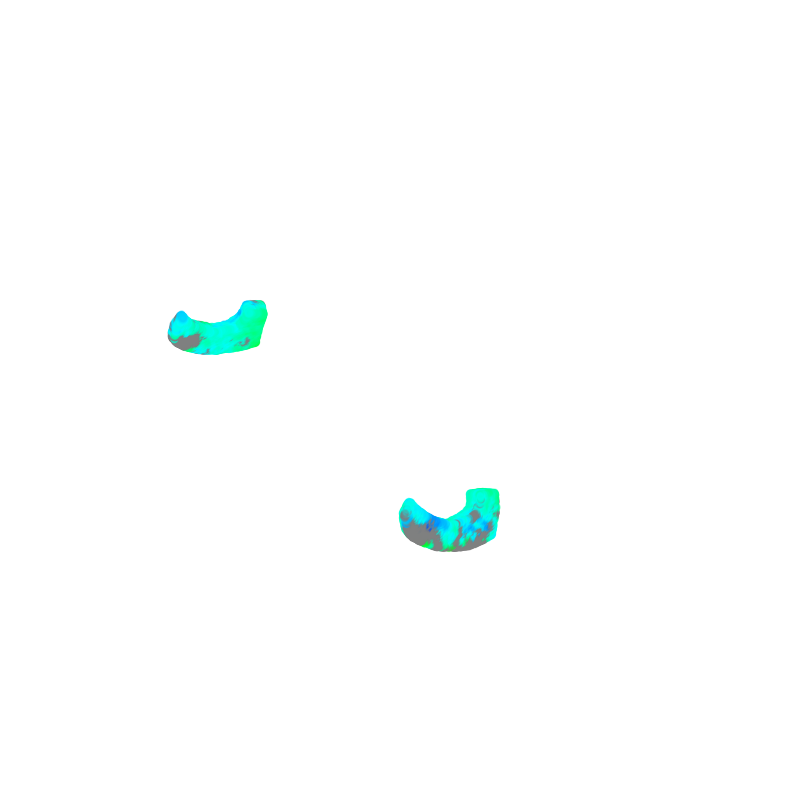

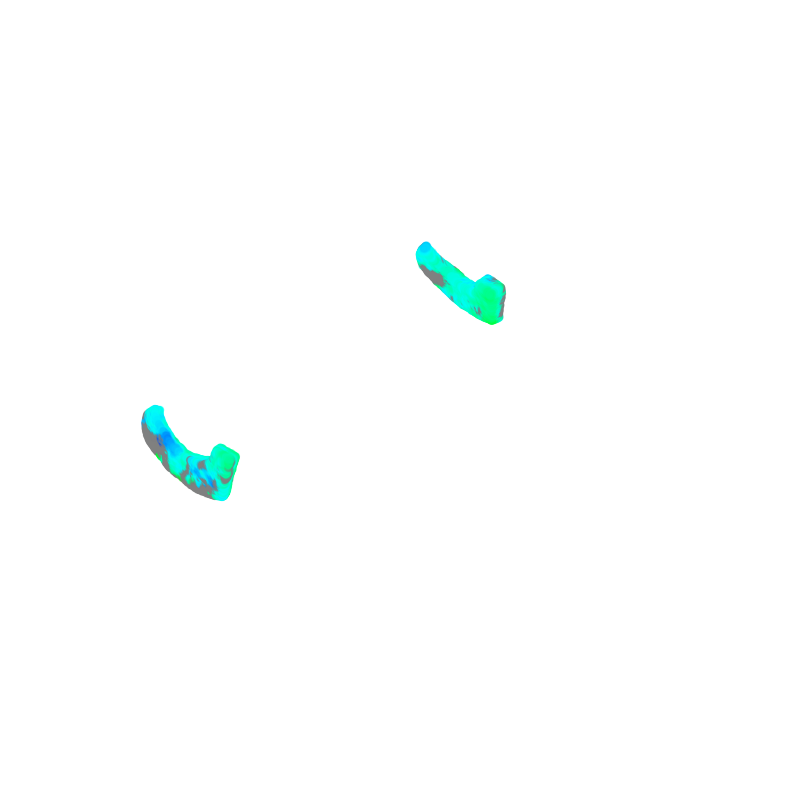

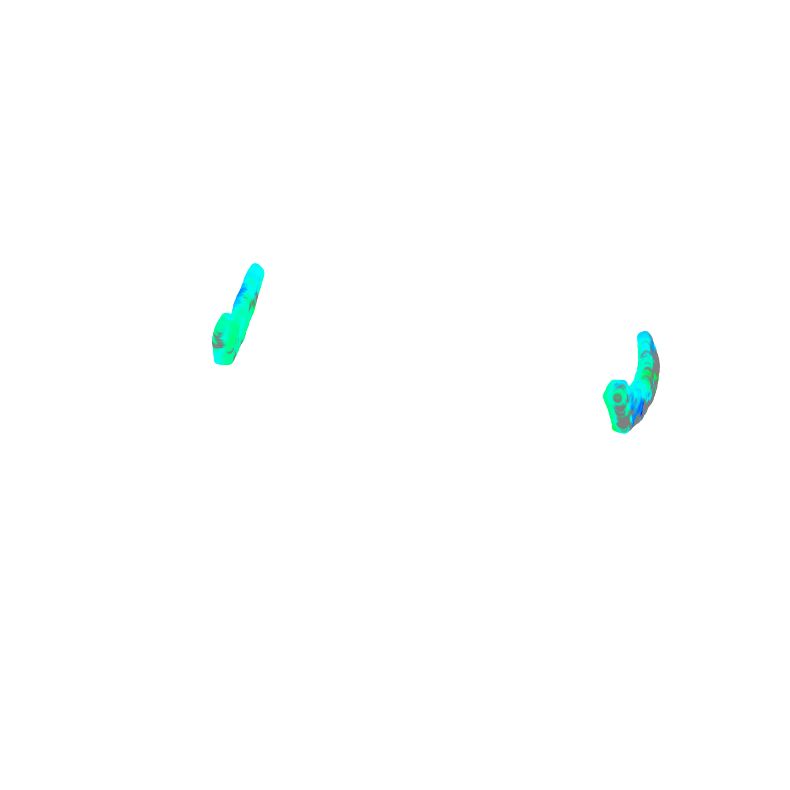

990 AUDv4
1023 AUDv5
520 AUDv6a
598 AUDv6b
669 VIS
402 VISal
1074 VISal1
905 VISal2/3


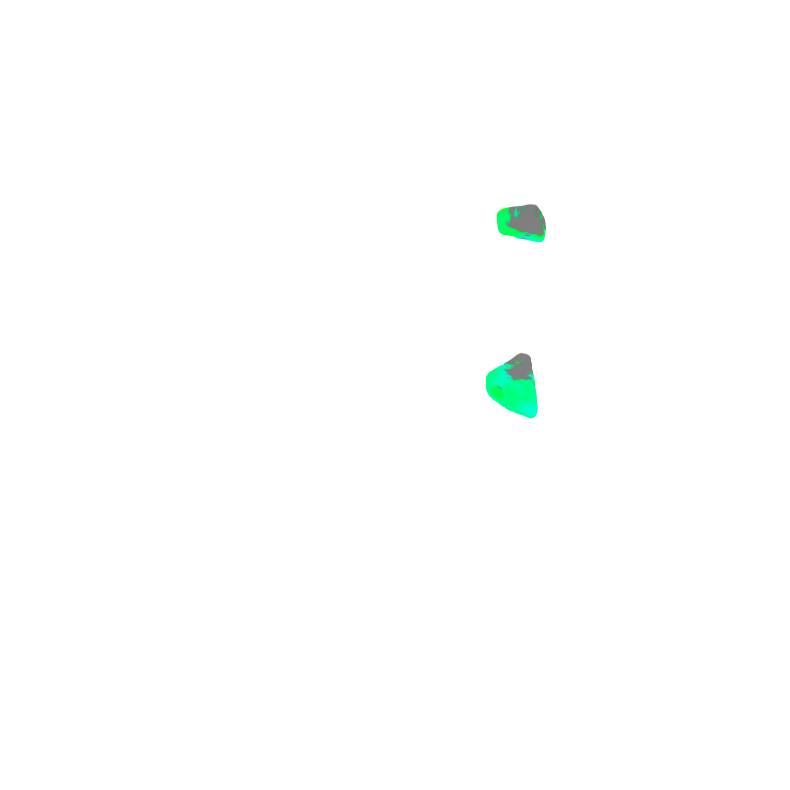

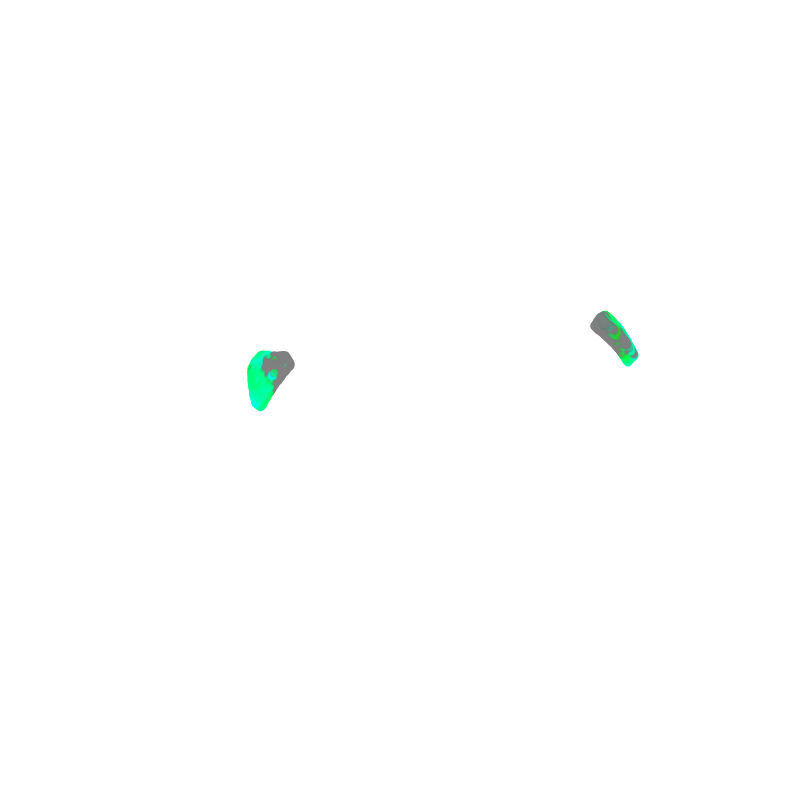

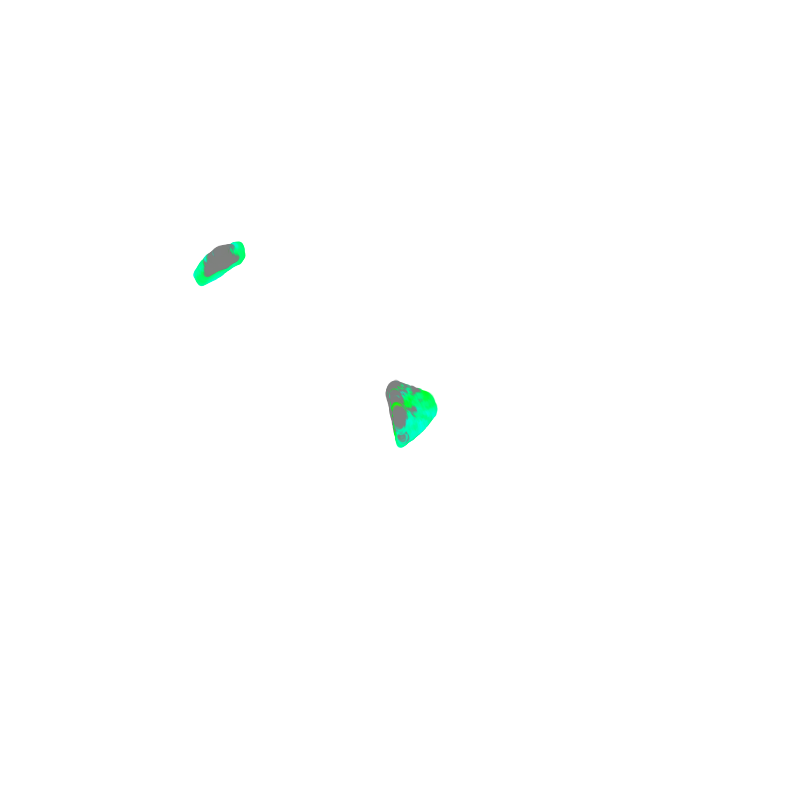

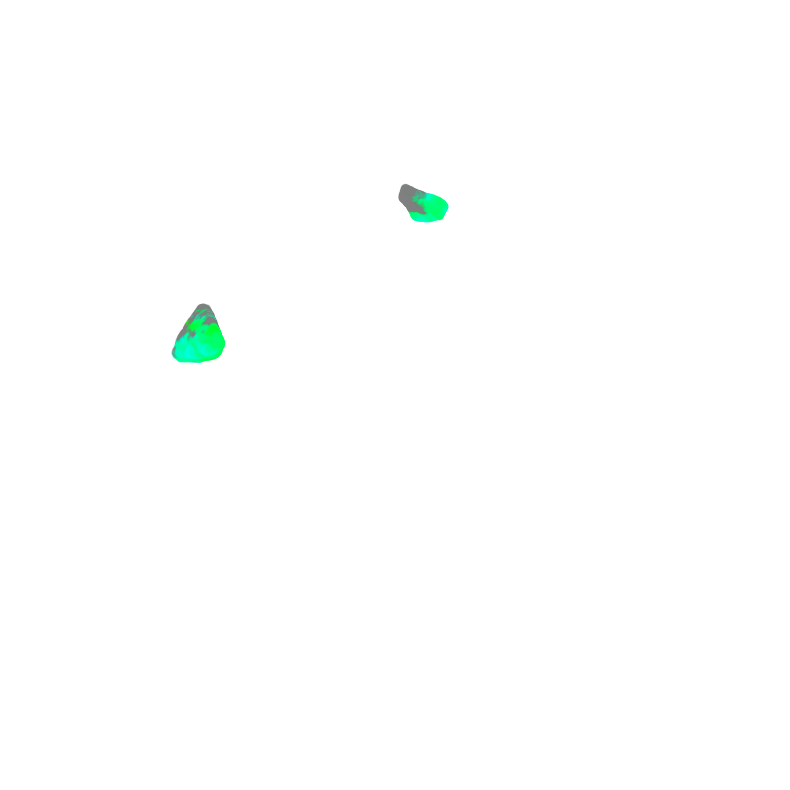

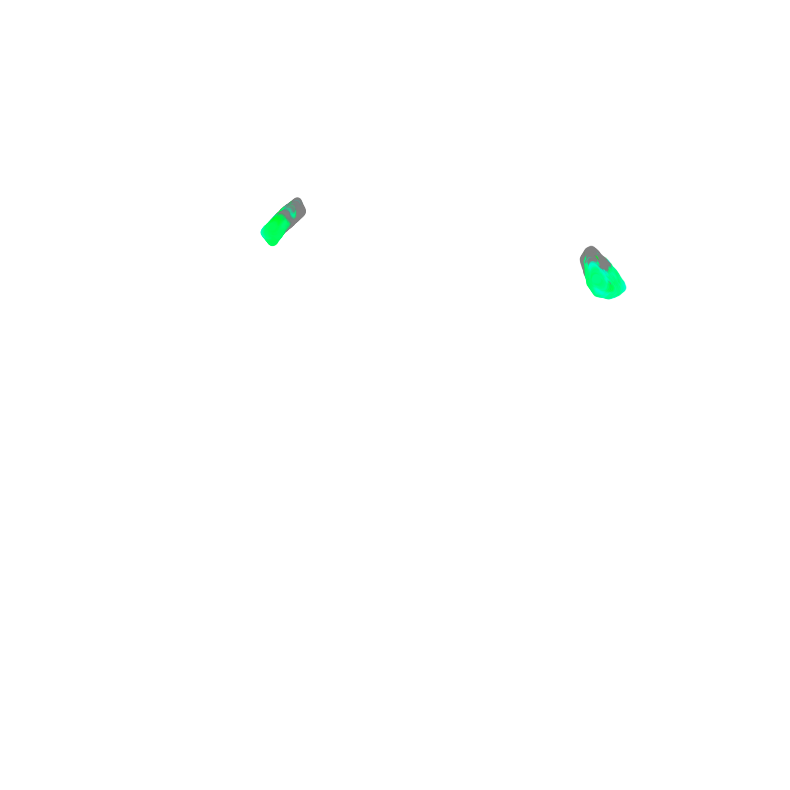

1114 VISal4
233 VISal5
601 VISal6a
649 VISal6b
394 VISam
281 VISam1
1066 VISam2/3


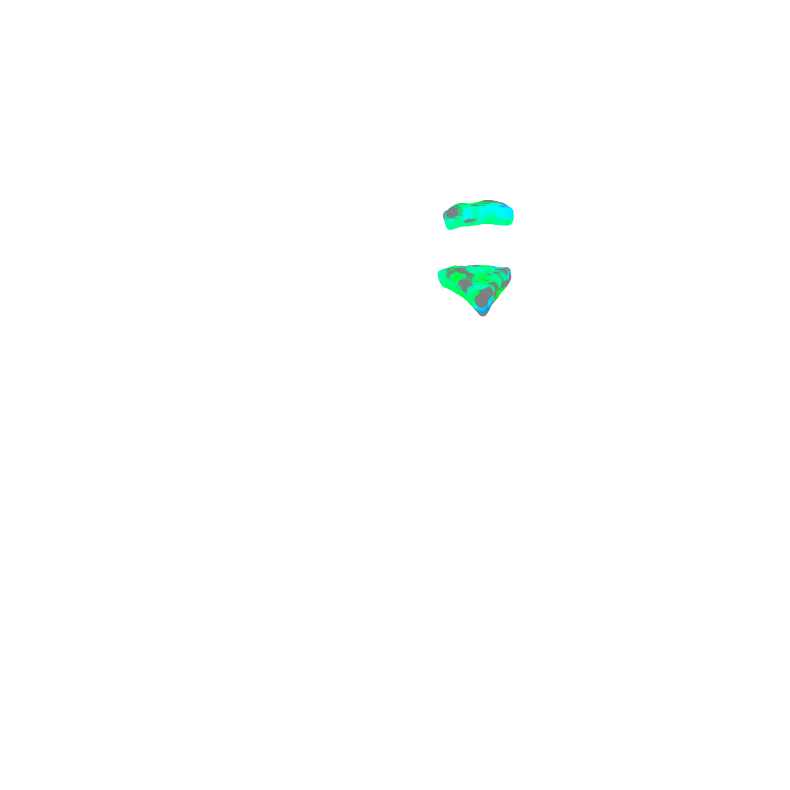

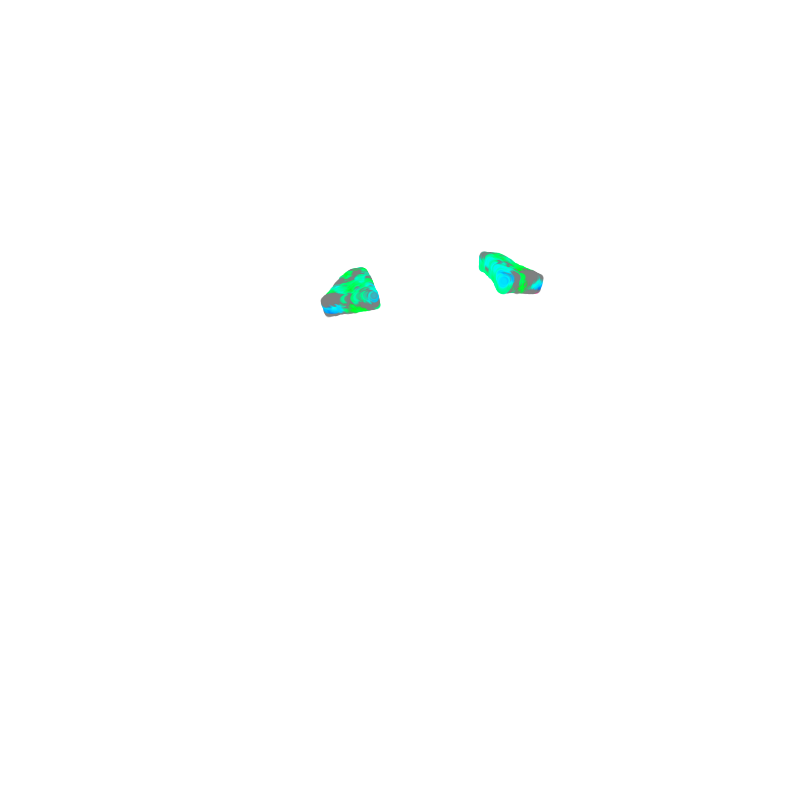

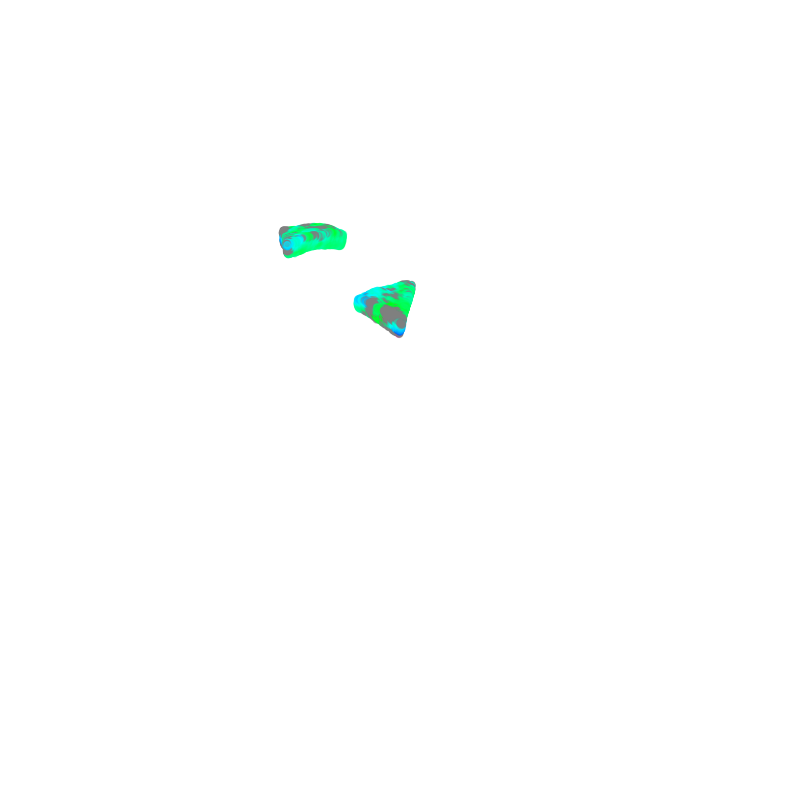

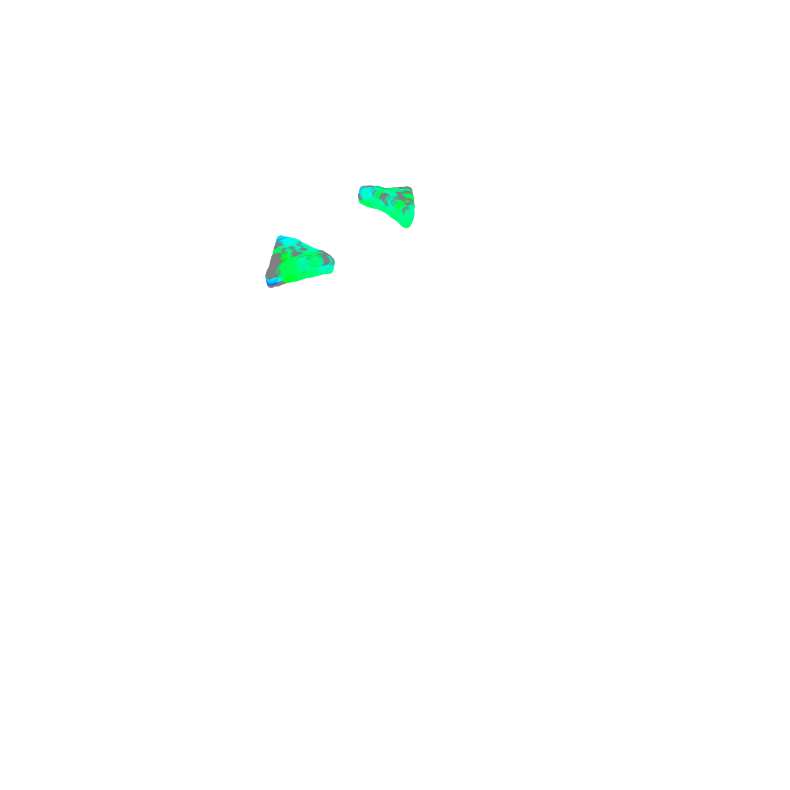

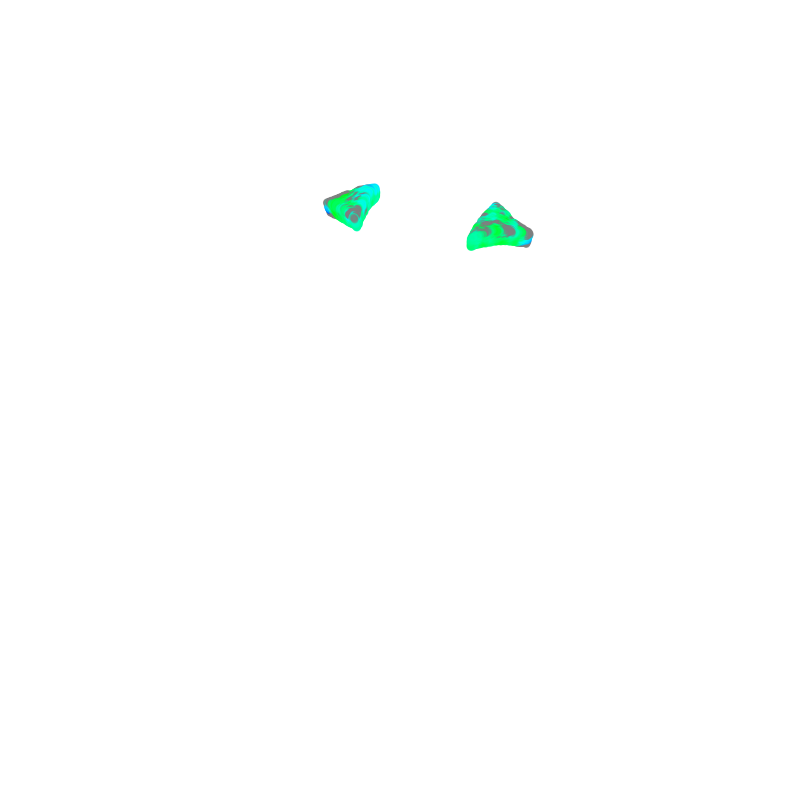

401 VISam4
433 VISam5
1046 VISam6a
441 VISam6b
409 VISl
421 VISl1
973 VISl2/3


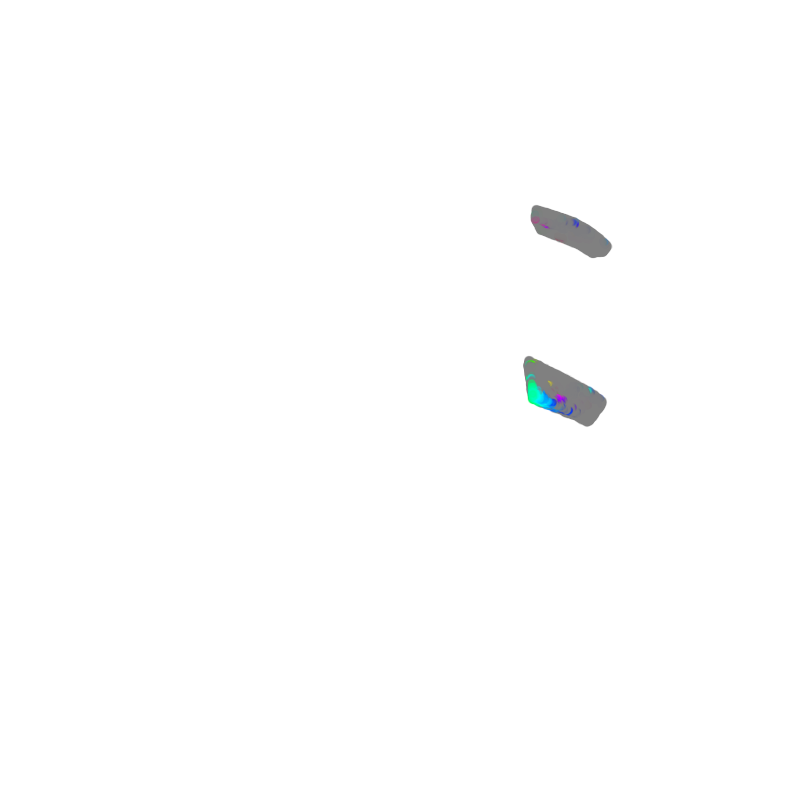

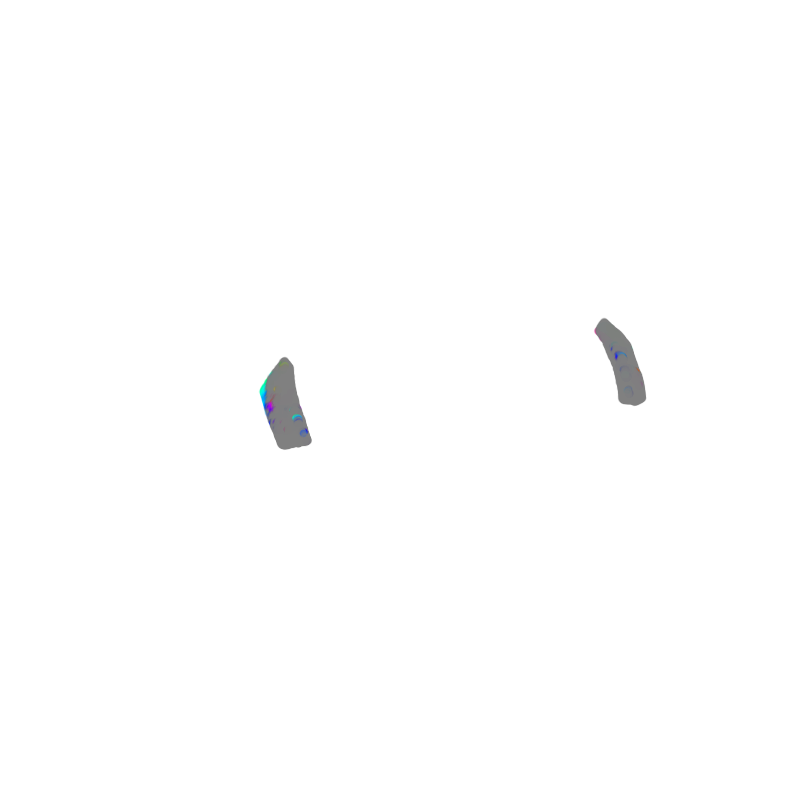

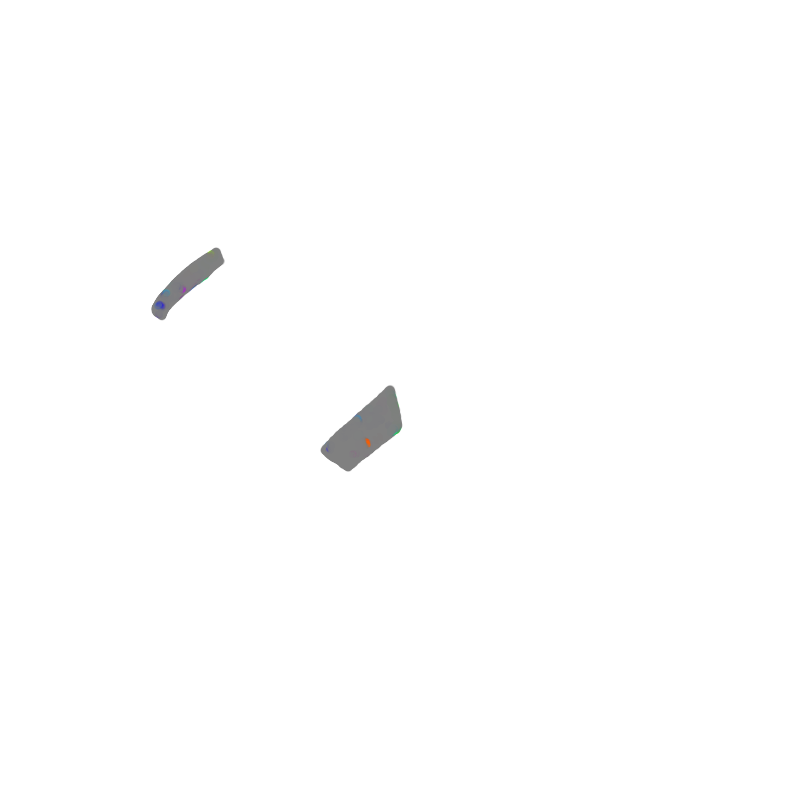

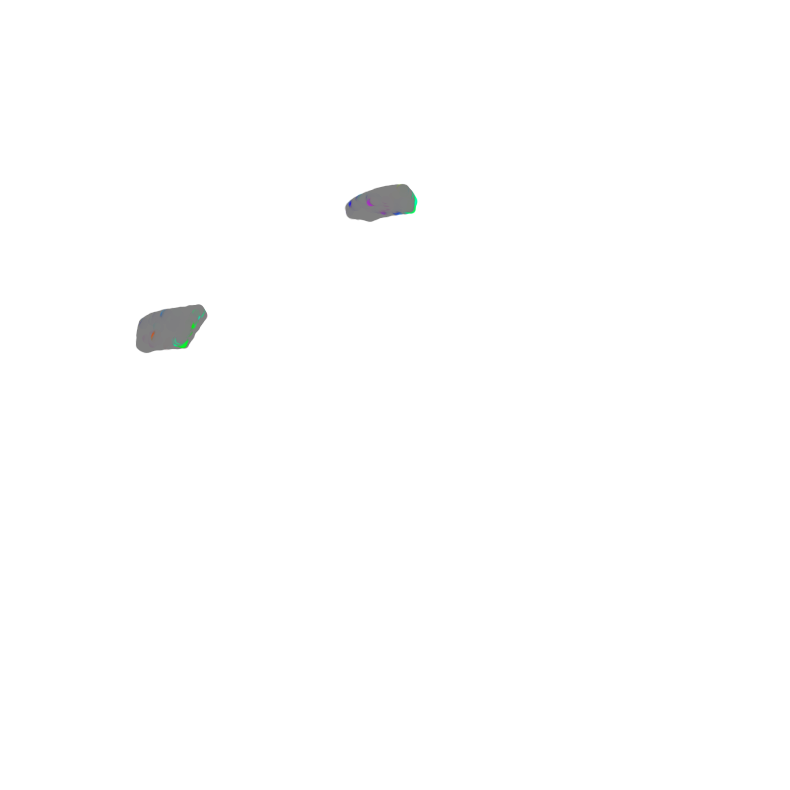

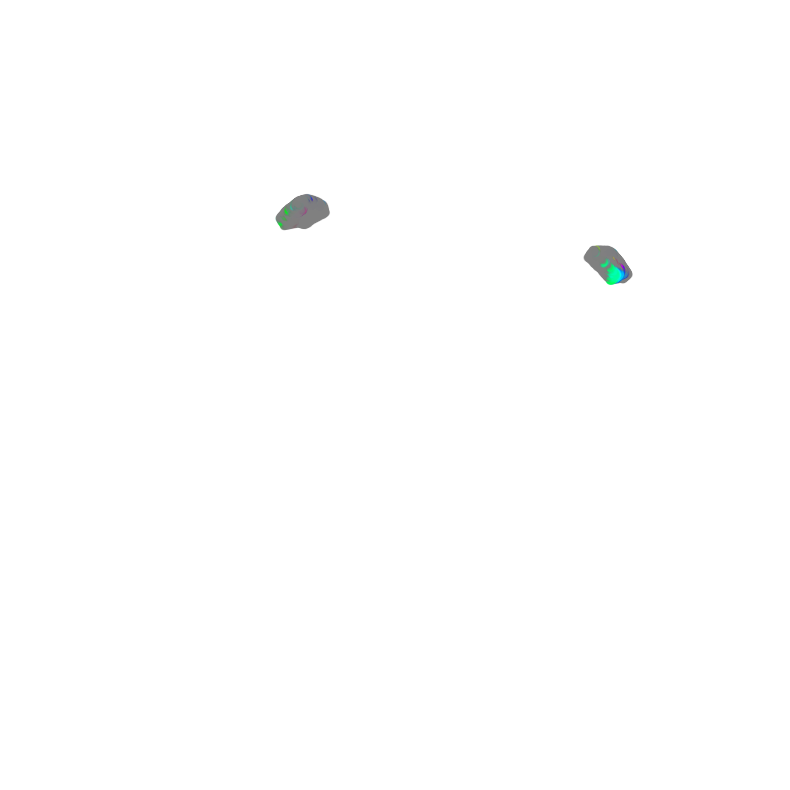

573 VISl4
613 VISl5
74 VISl6a
121 VISl6b
385 VISp
593 VISp1
821 VISp2/3


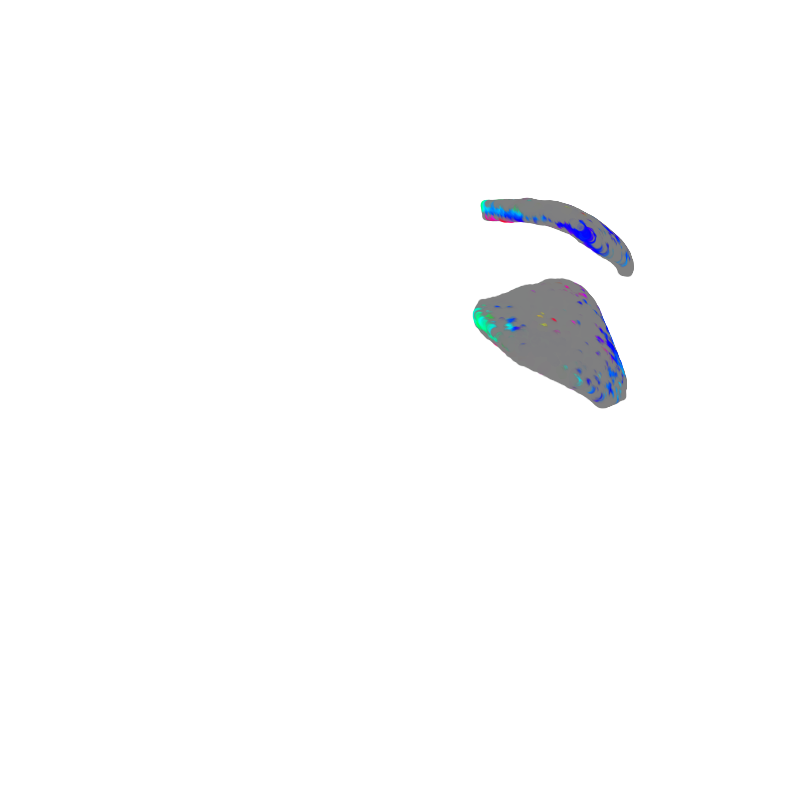

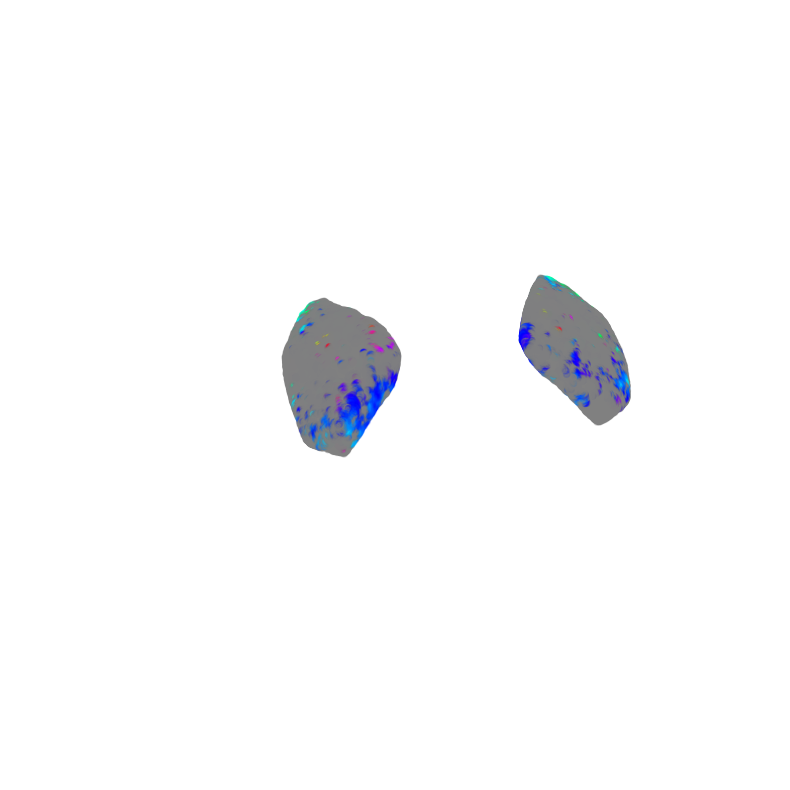

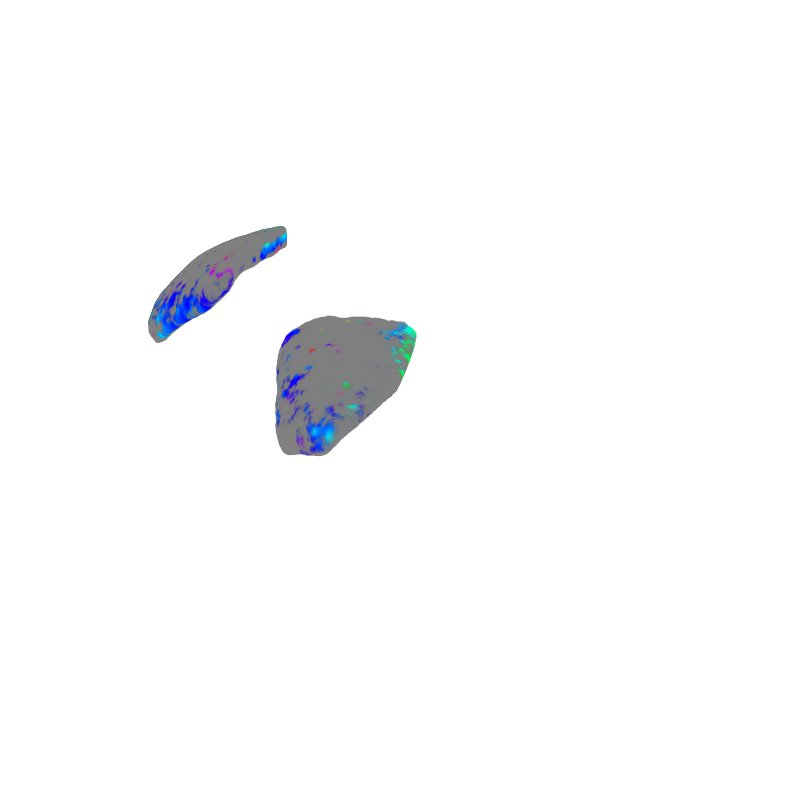

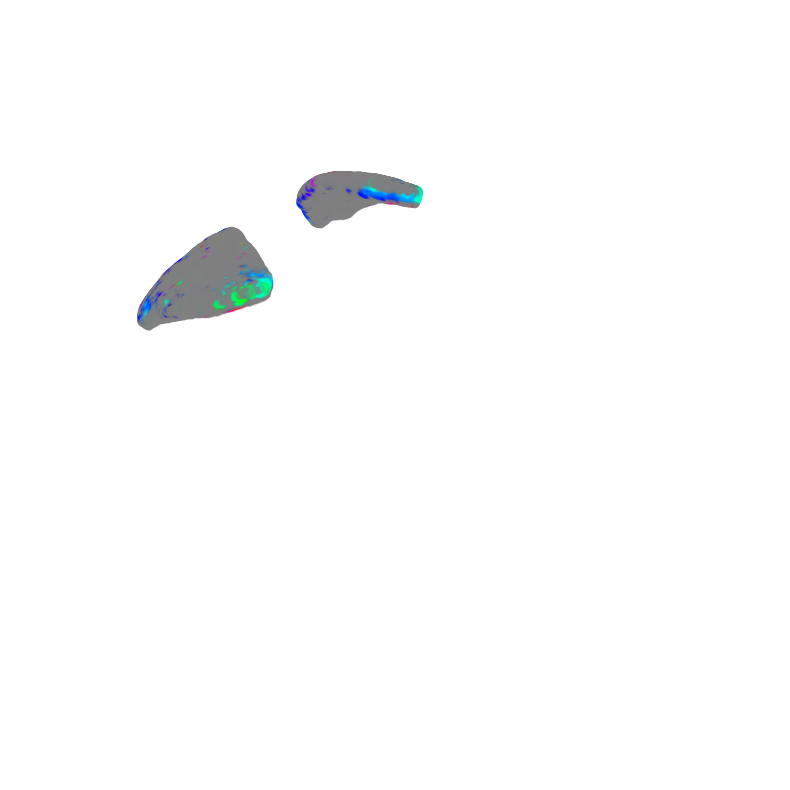

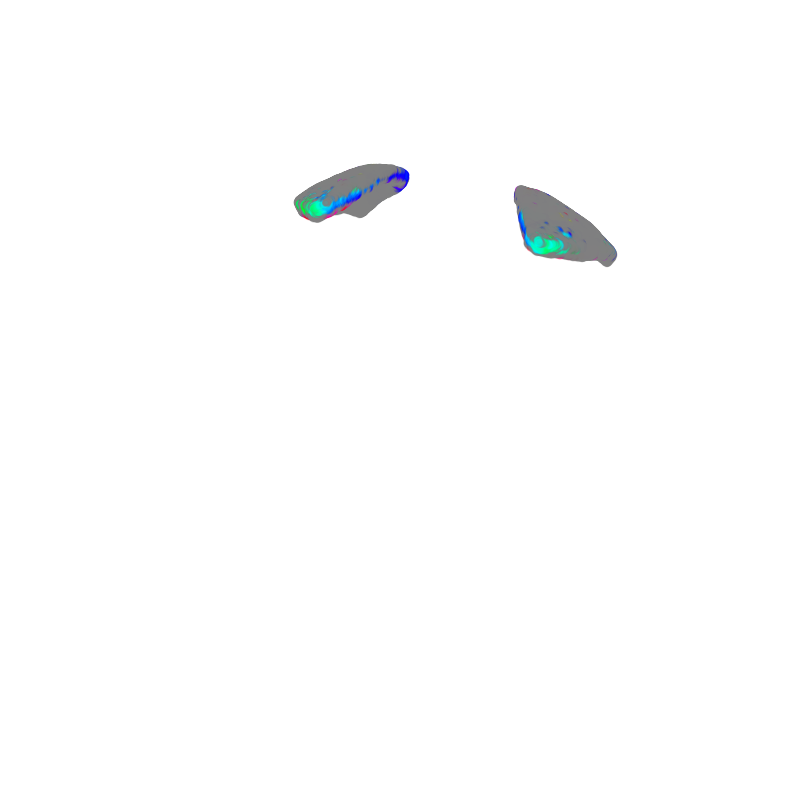

721 VISp4
778 VISp5
33 VISp6a
305 VISp6b
425 VISpl
750 VISpl1
269 VISpl2/3


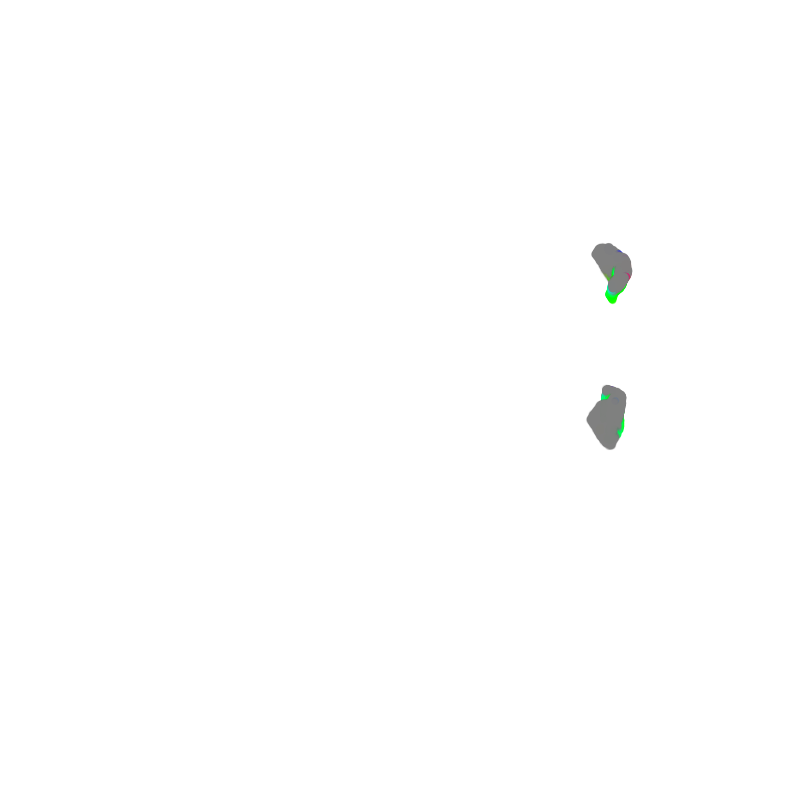

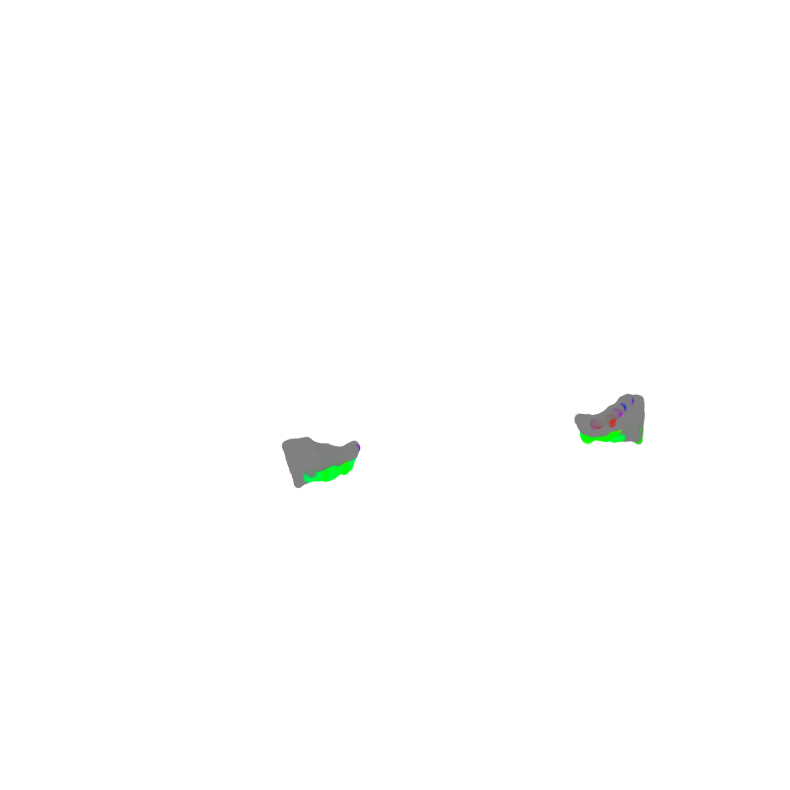

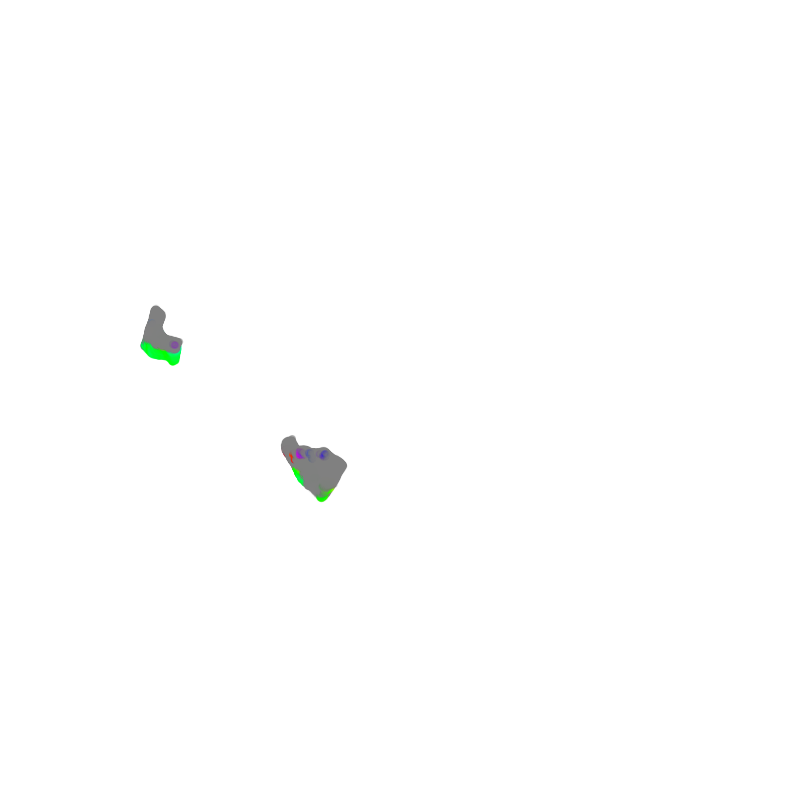

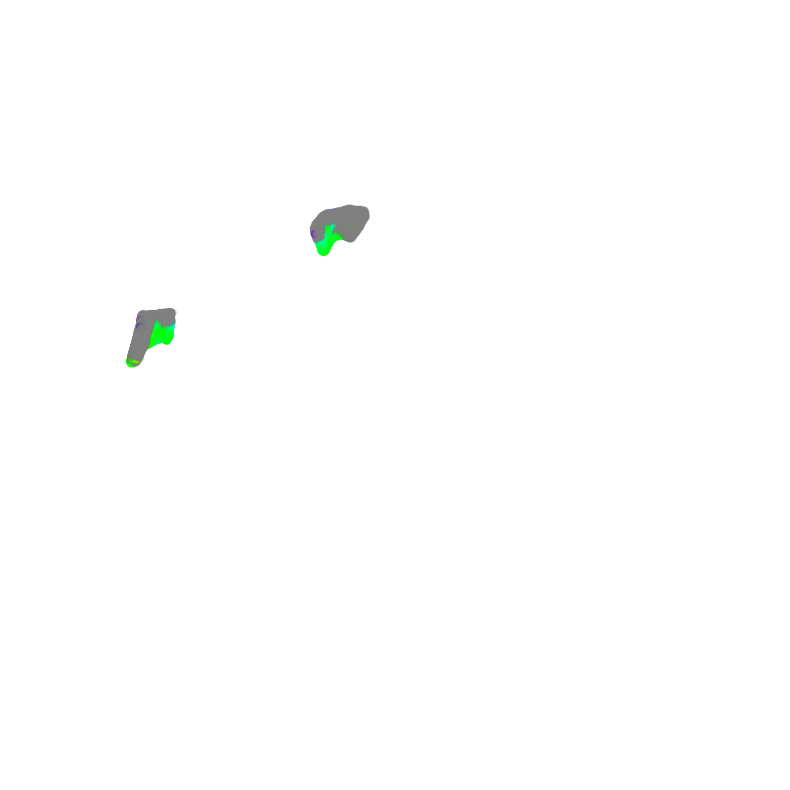

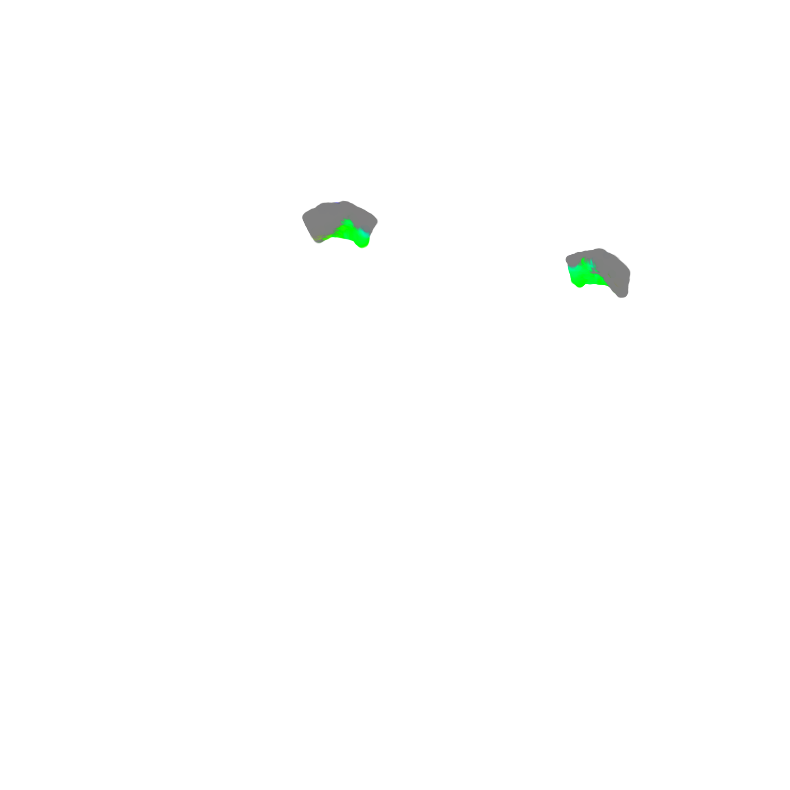

869 VISpl4
902 VISpl5
377 VISpl6a
393 VISpl6b
533 VISpm
805 VISpm1
41 VISpm2/3


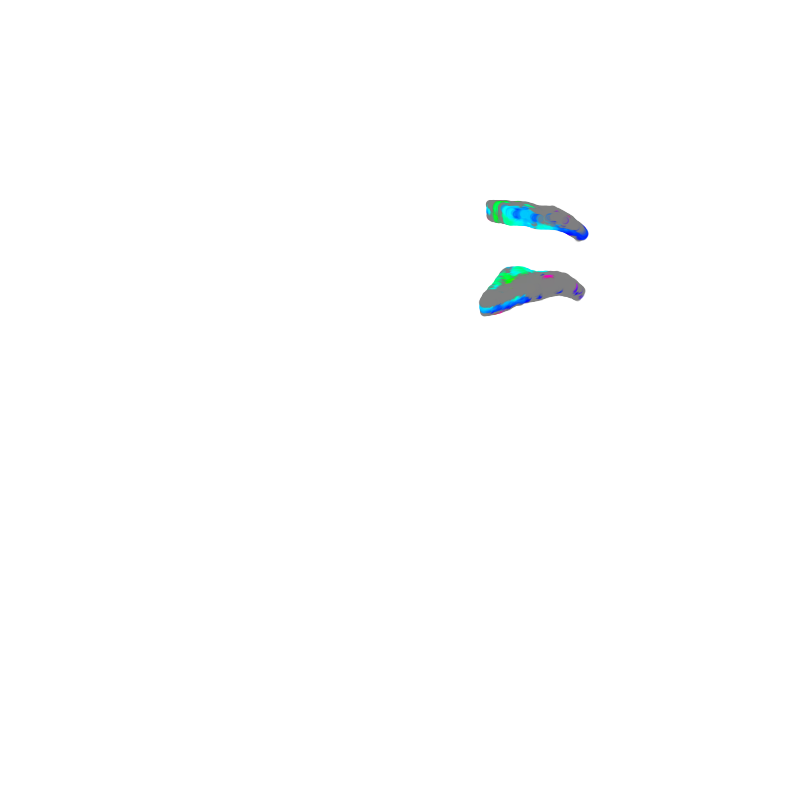

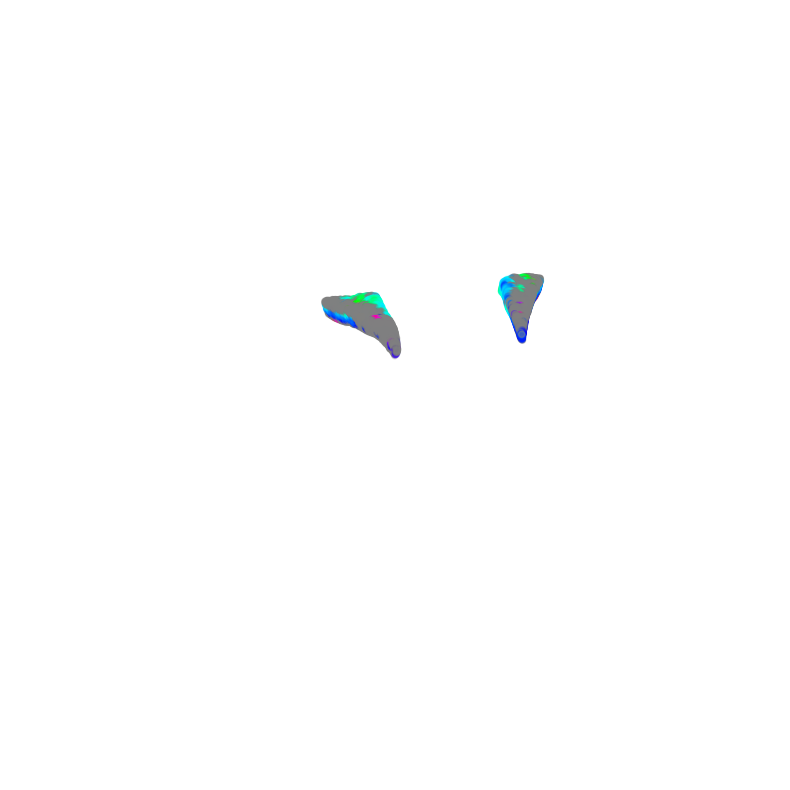

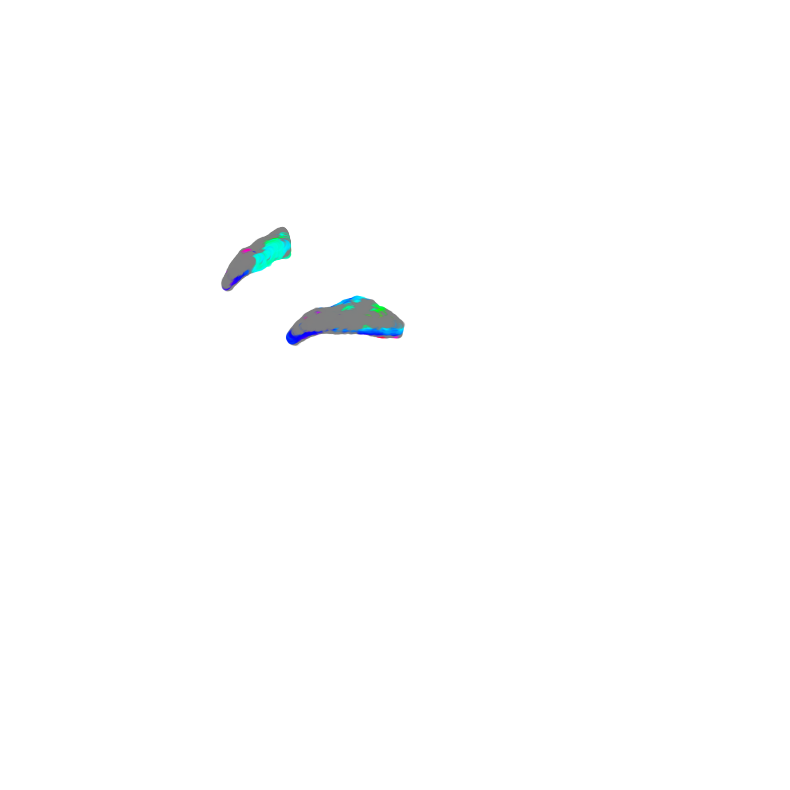

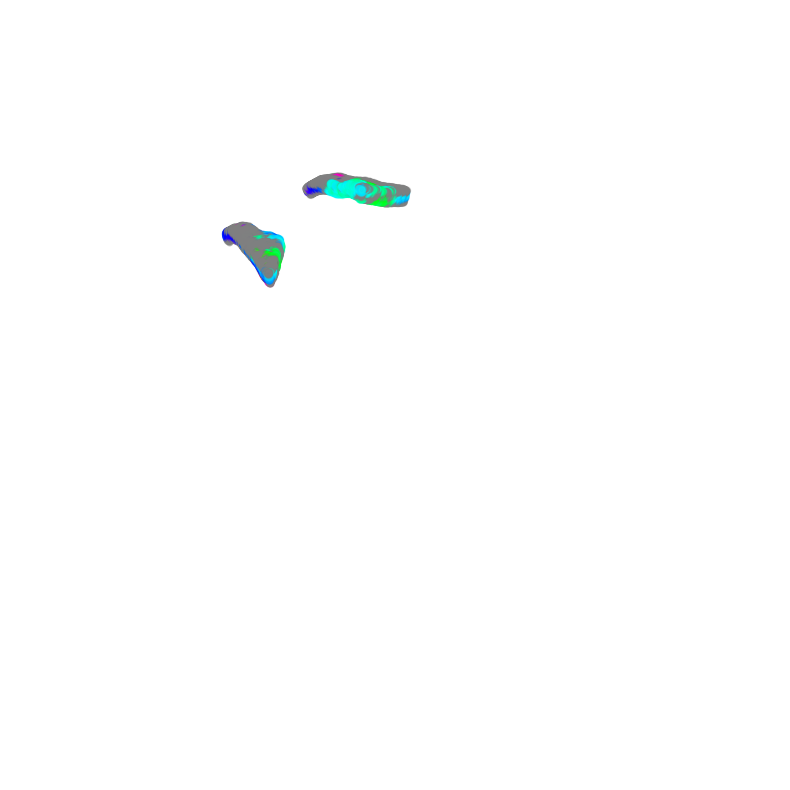

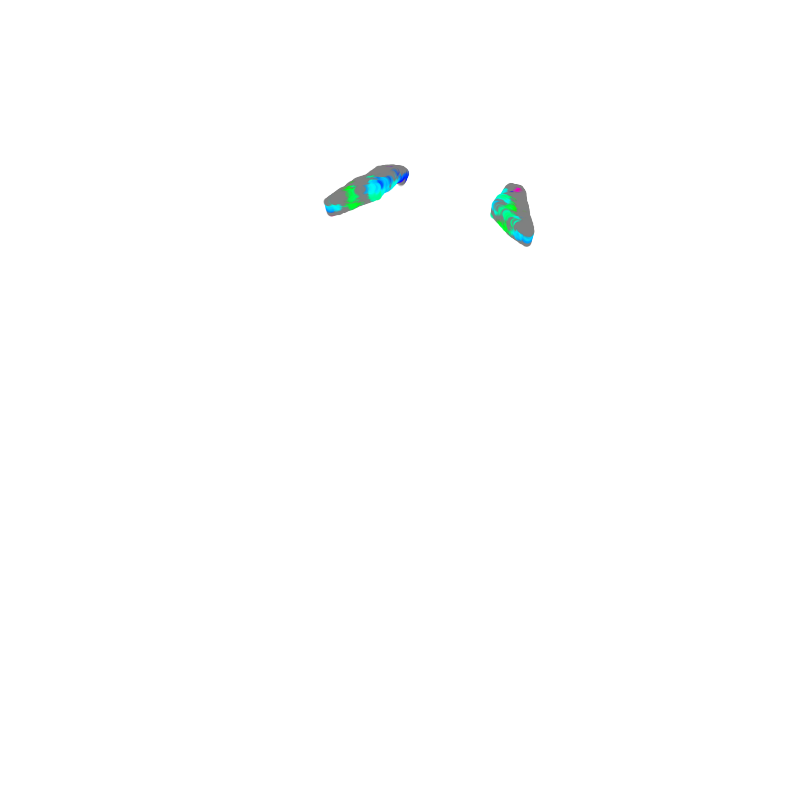

501 VISpm4
565 VISpm5
257 VISpm6a
469 VISpm6b
31574 VISli
31578 VISli1
31582 VISli2/3


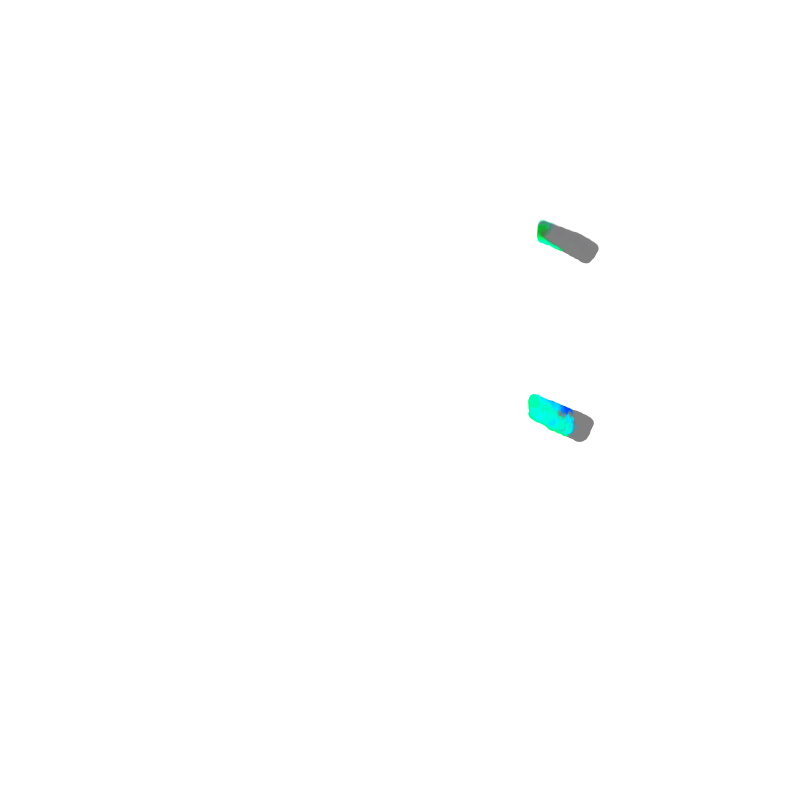

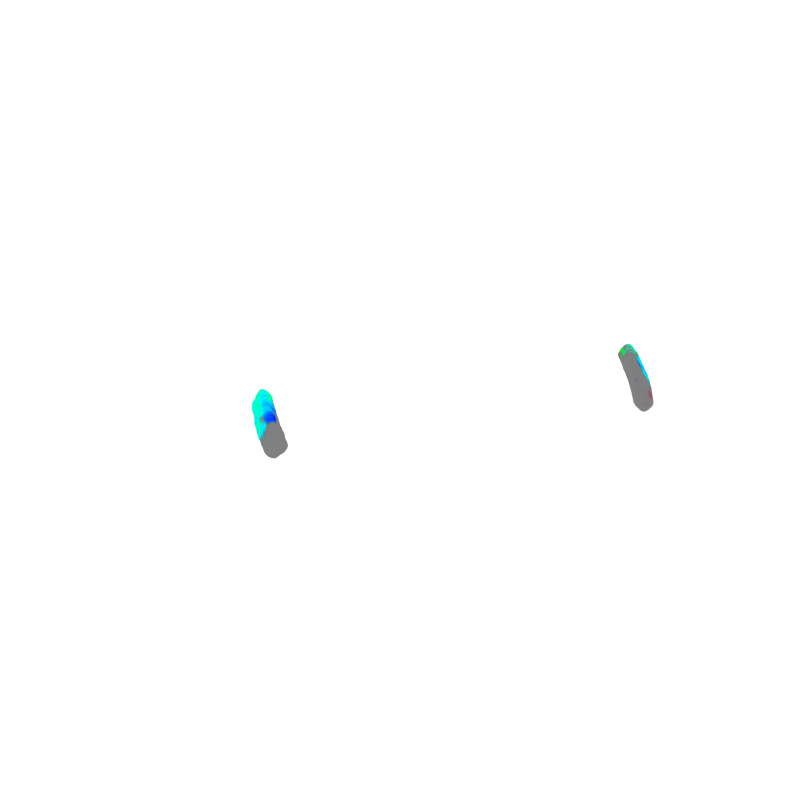

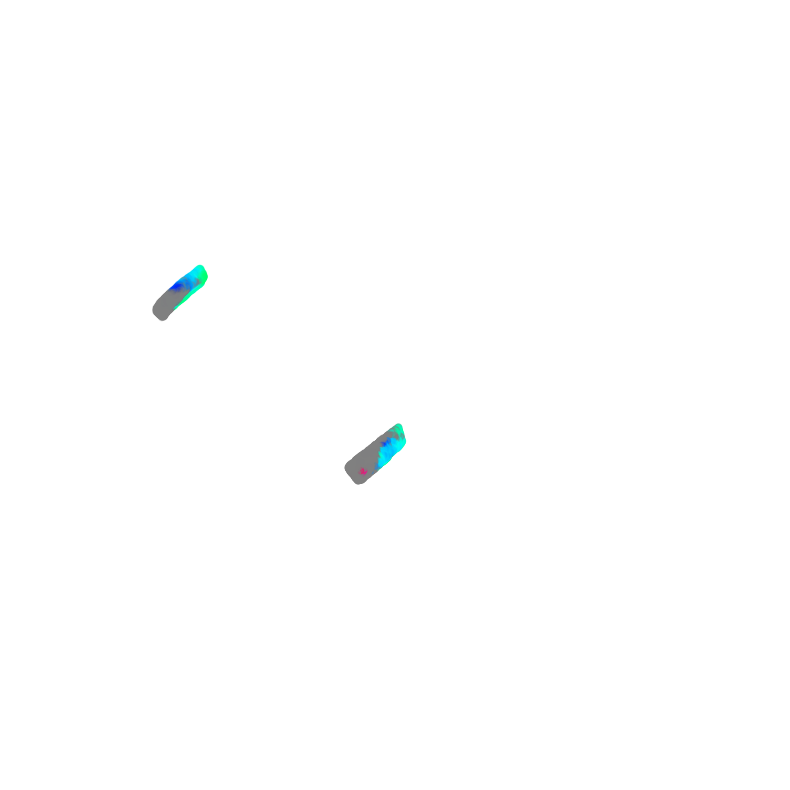

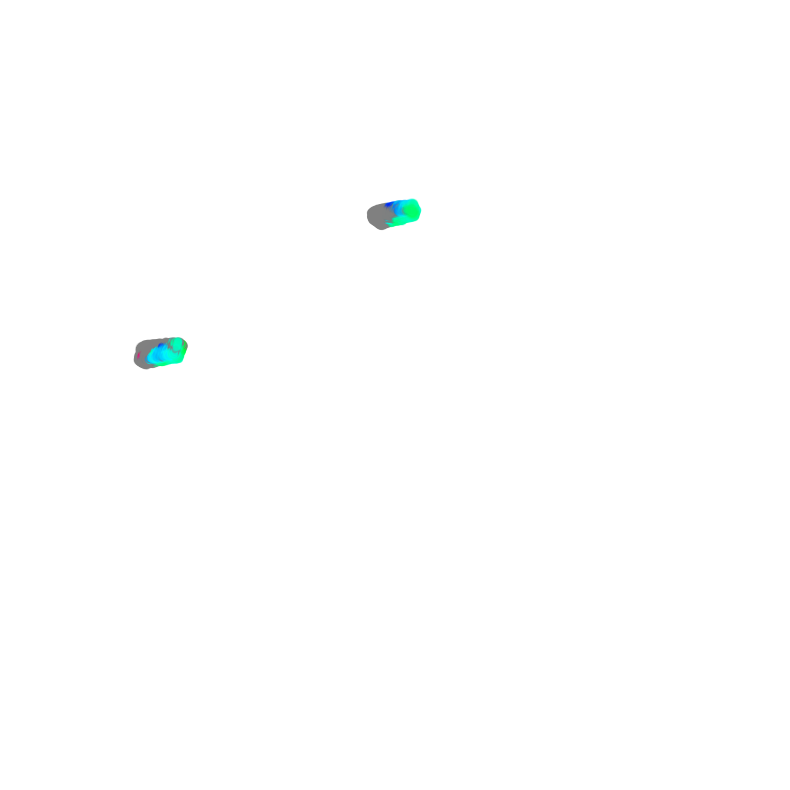

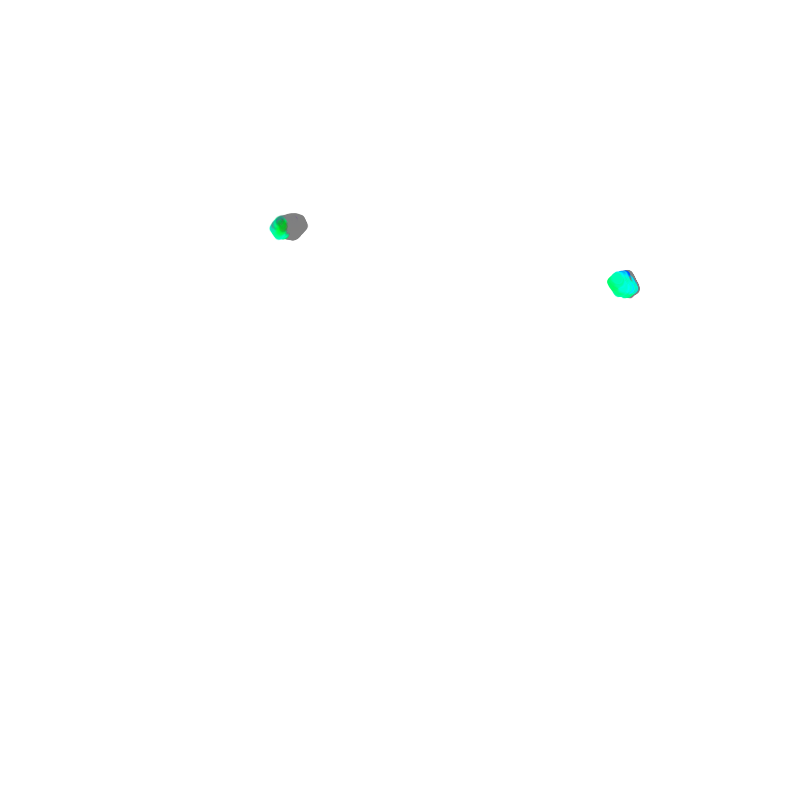

31586 VISli4
31590 VISli5
31594 VISli6a
31598 VISli6b
31628 VISpor
31632 VISpor1
31636 VISpor2/3


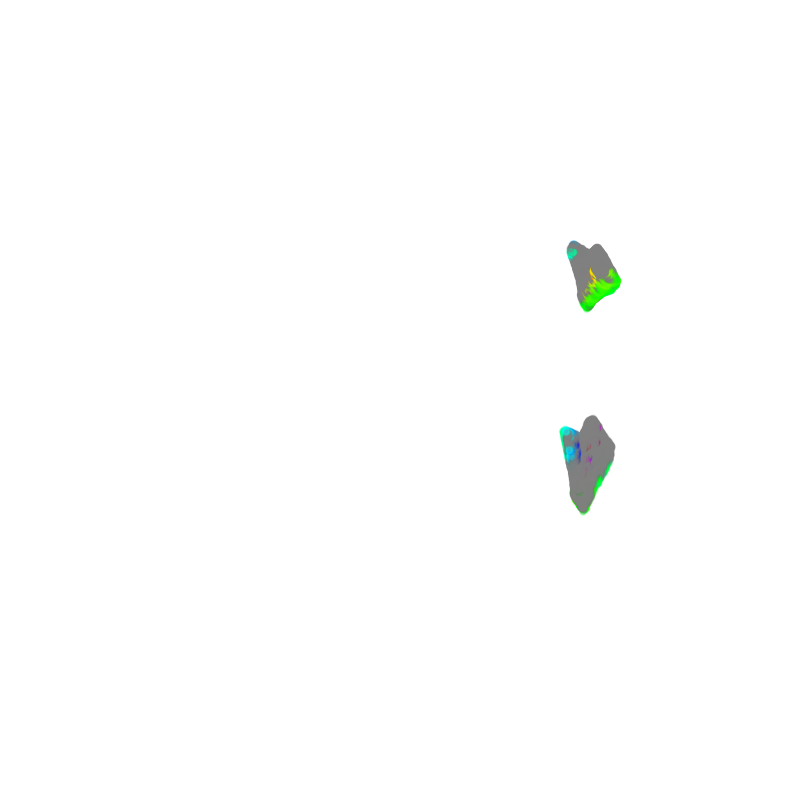

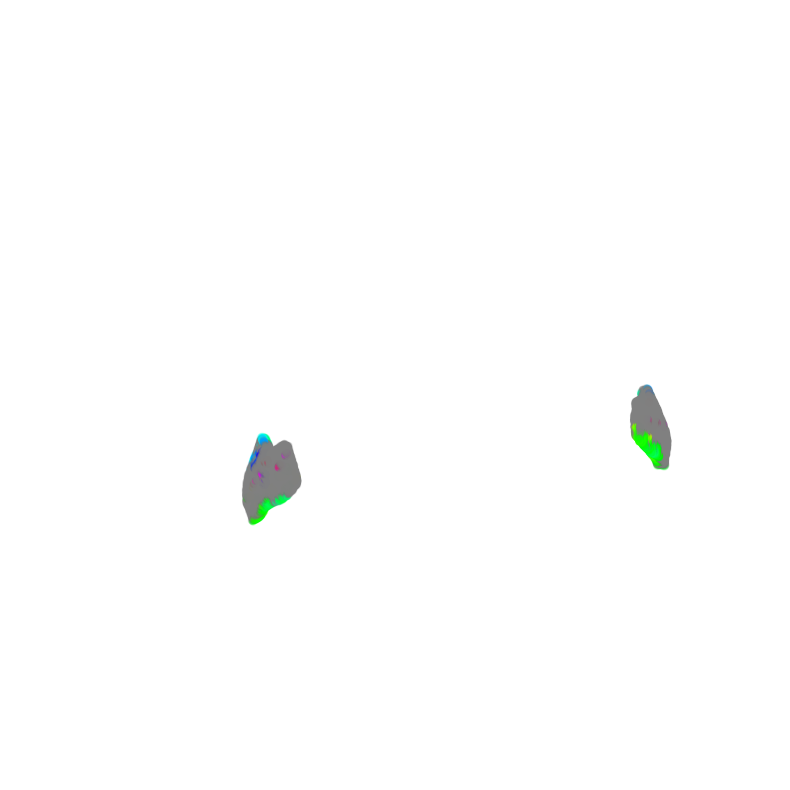

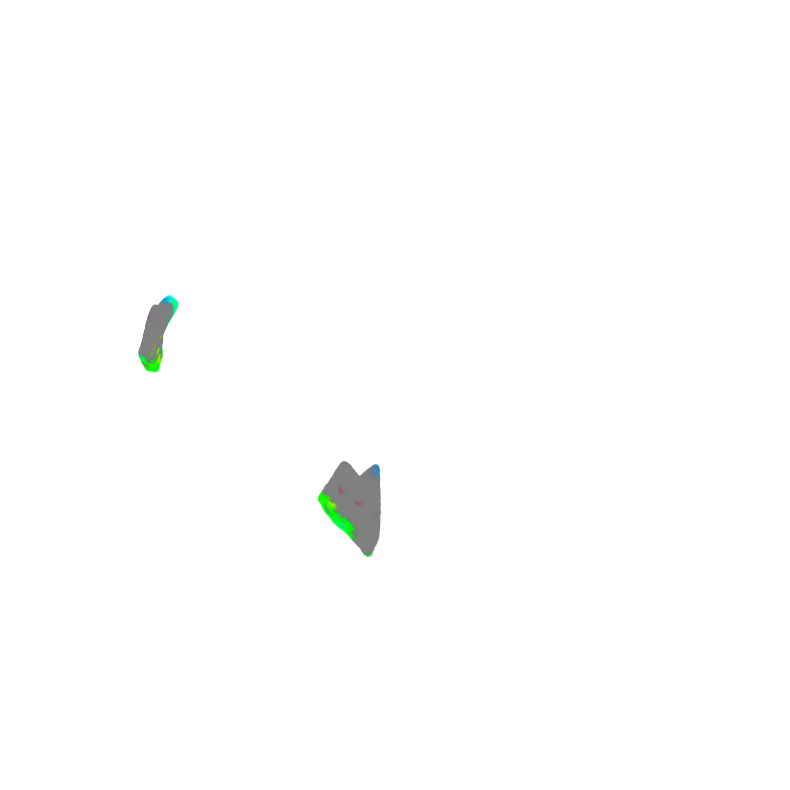

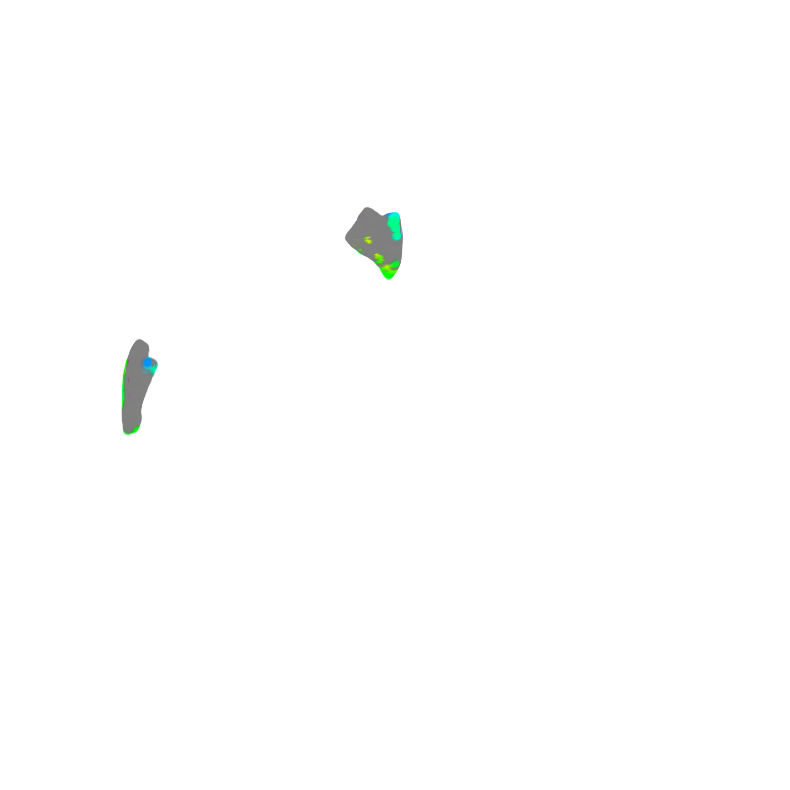

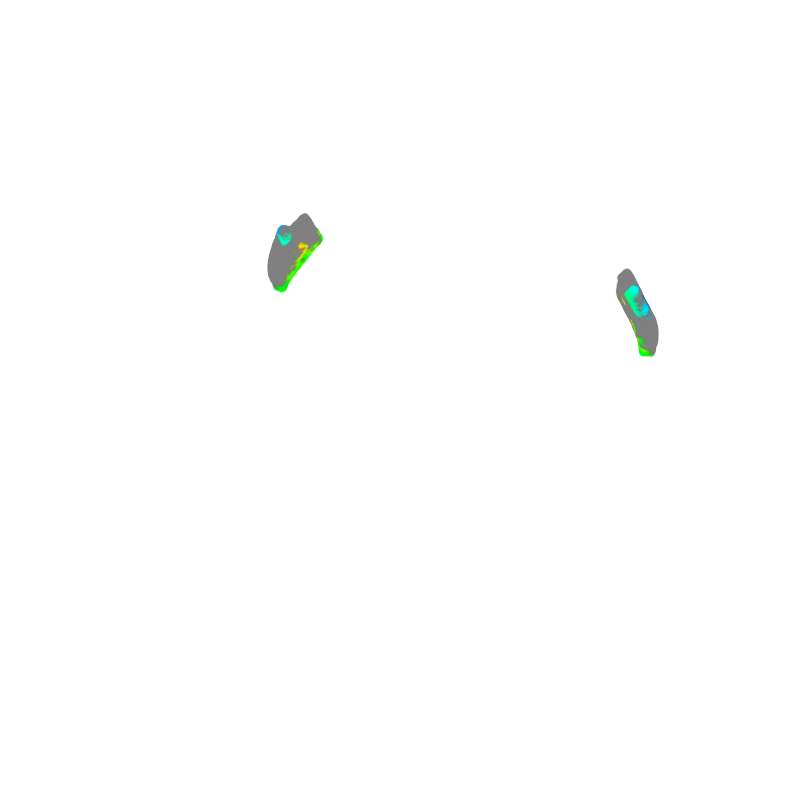

31640 VISpor4
31644 VISpor5
31648 VISpor6a
31652 VISpor6b
31 ACA
39 ACAd
935 ACAd1
211 ACAd2/3


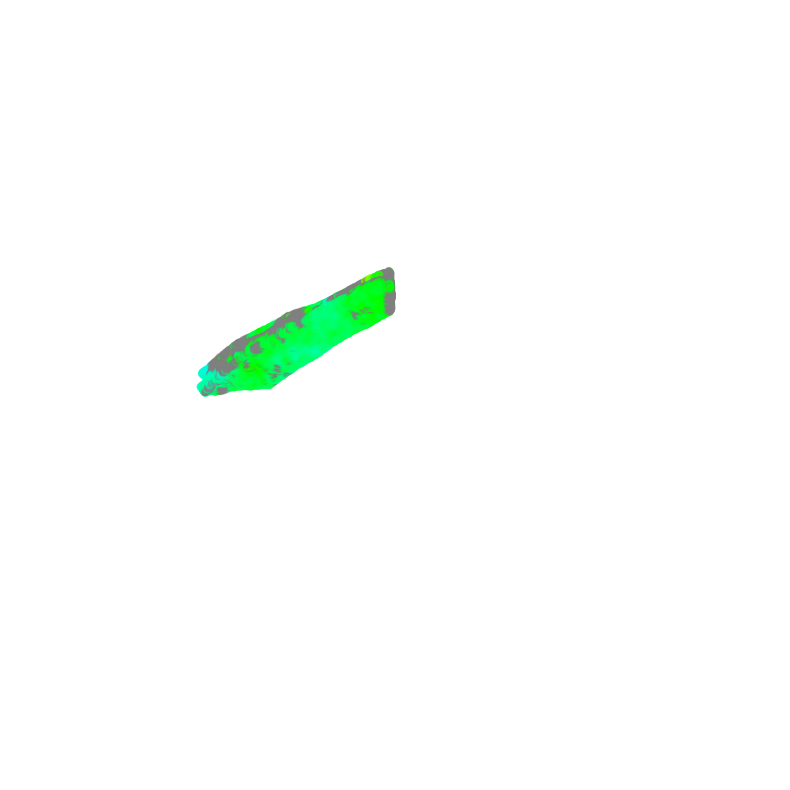

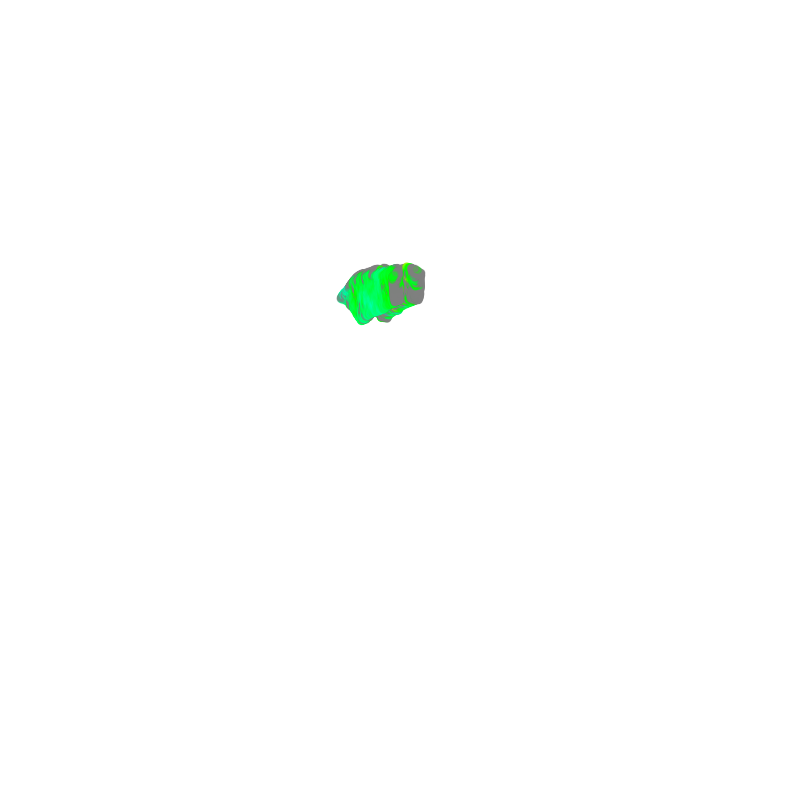

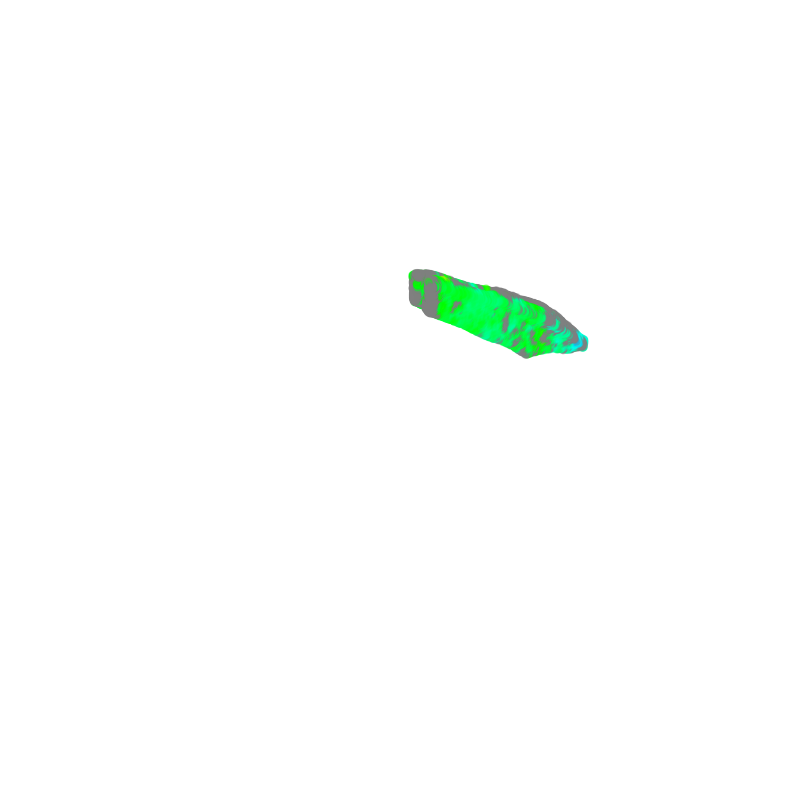

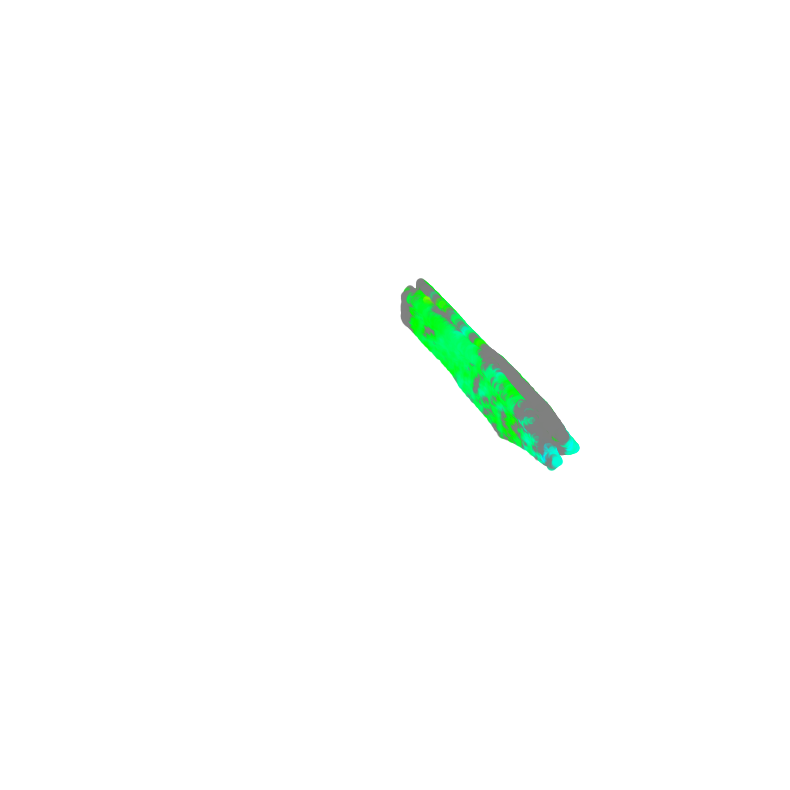

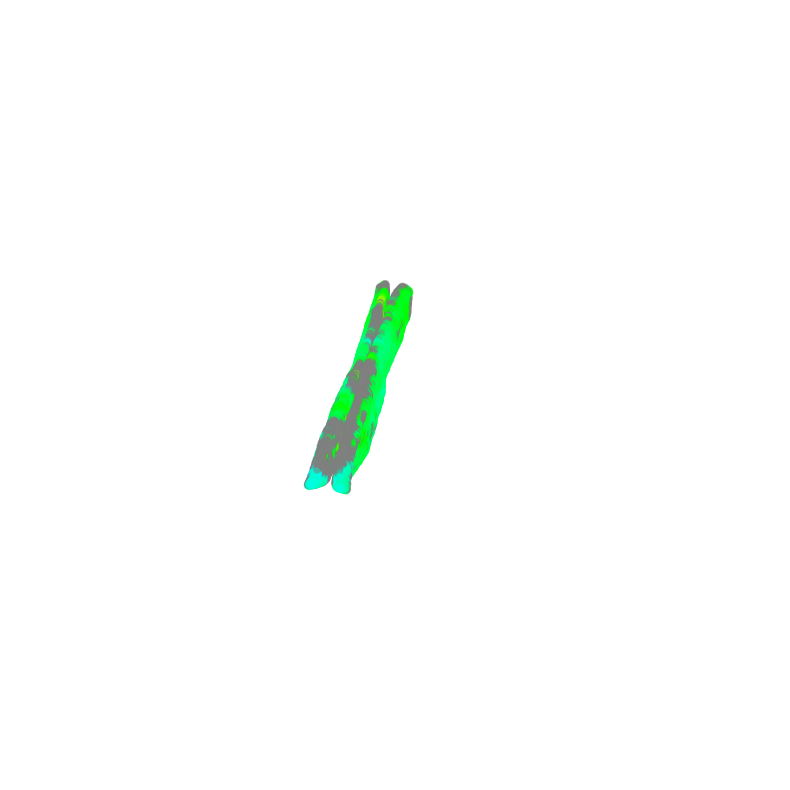

1015 ACAd5
919 ACAd6a
927 ACAd6b
48 ACAv
588 ACAv1
296 ACAv2/3


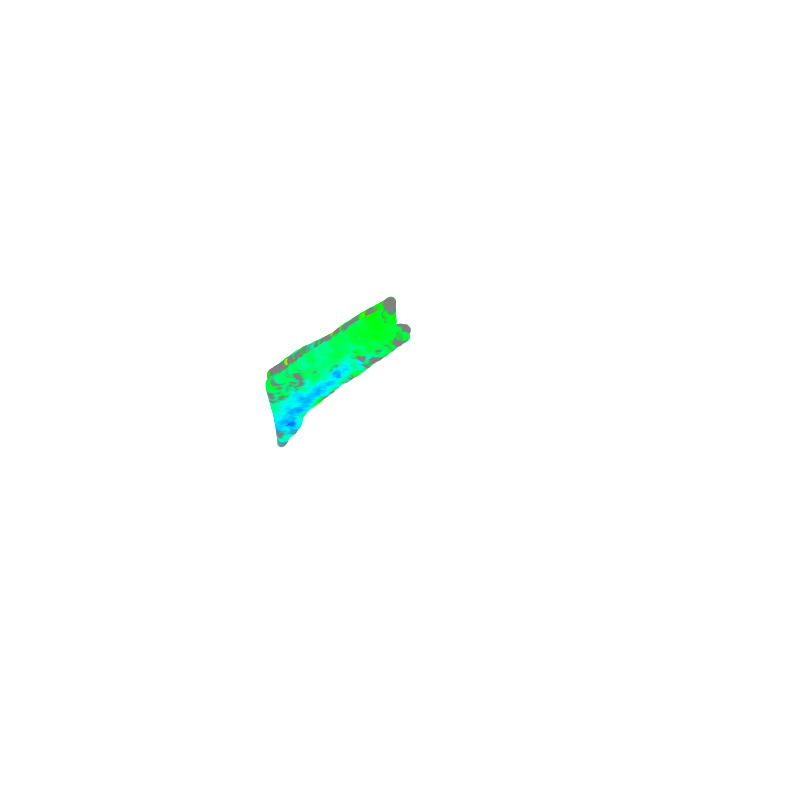

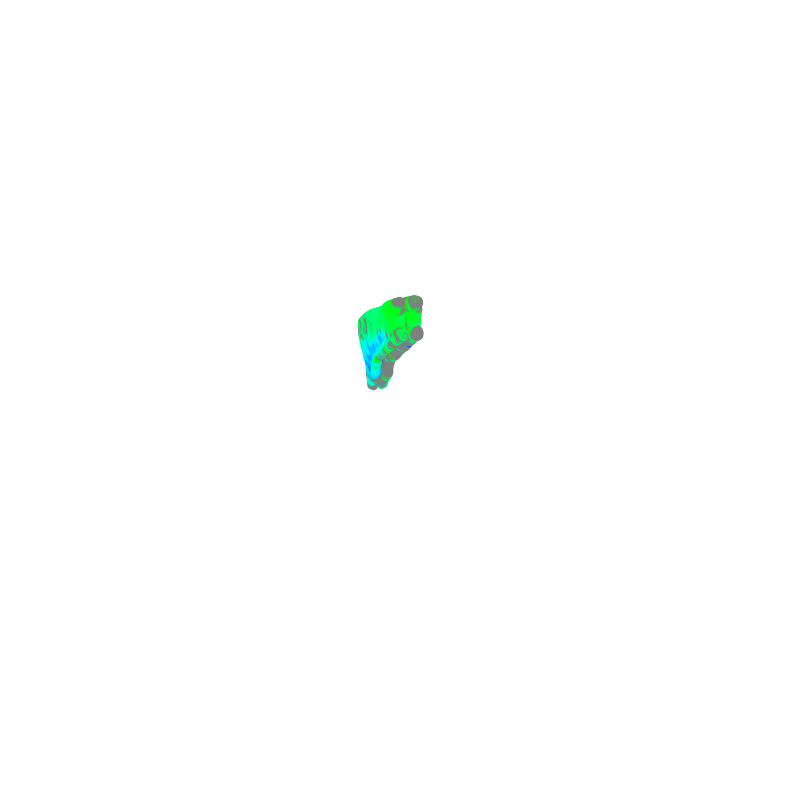

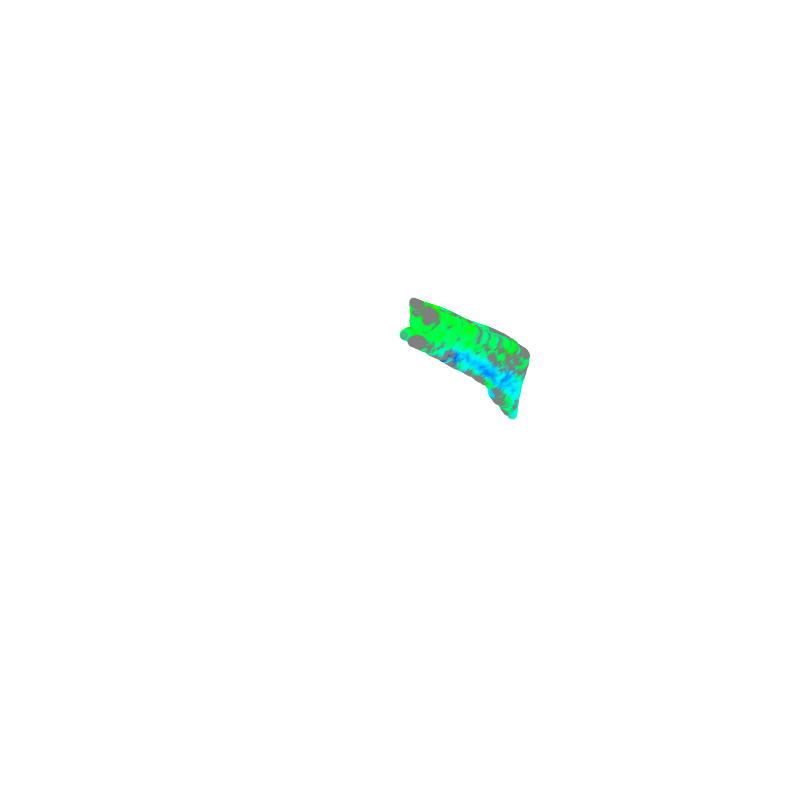

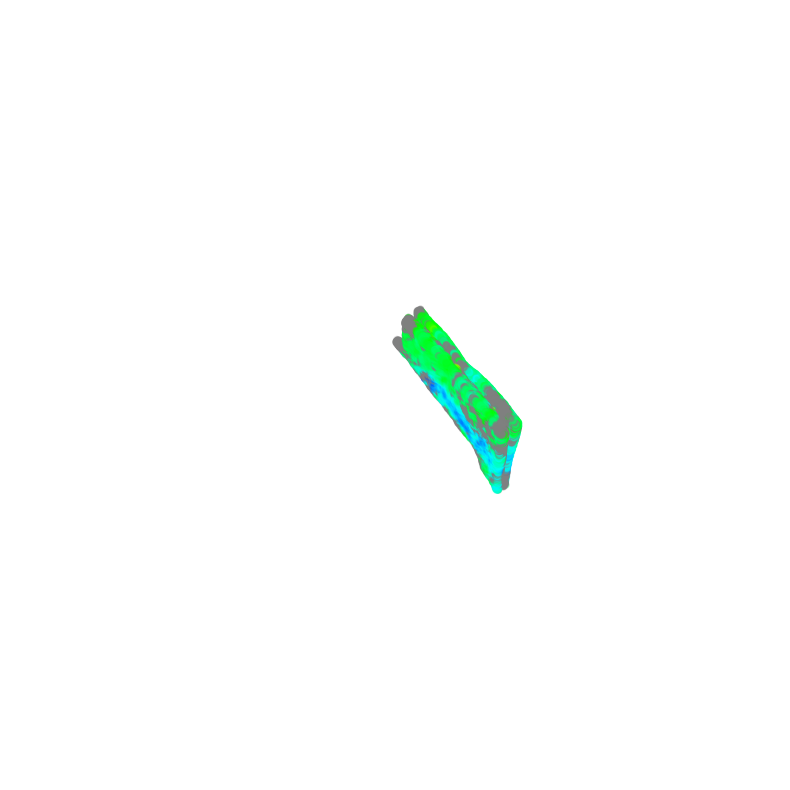

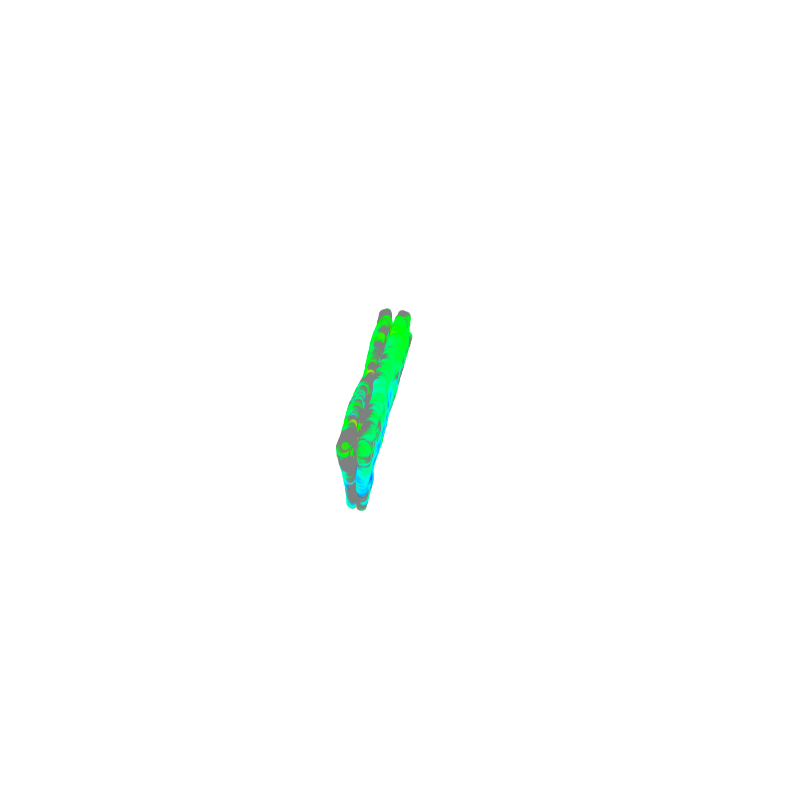

772 ACAv5
810 ACAv6a
819 ACAv6b
972 PL
171 PL1
304 PL2/3


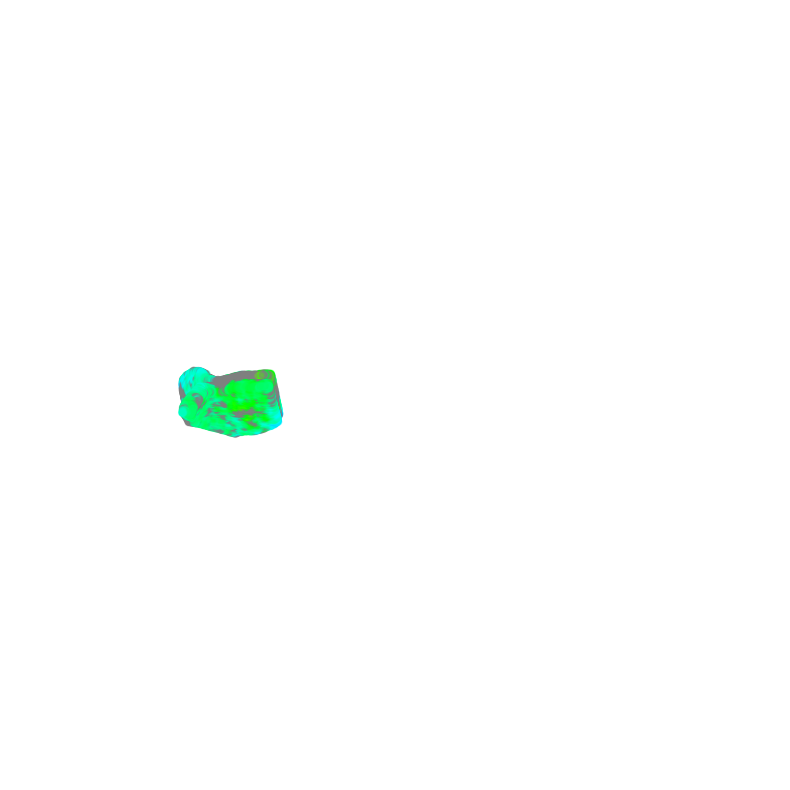

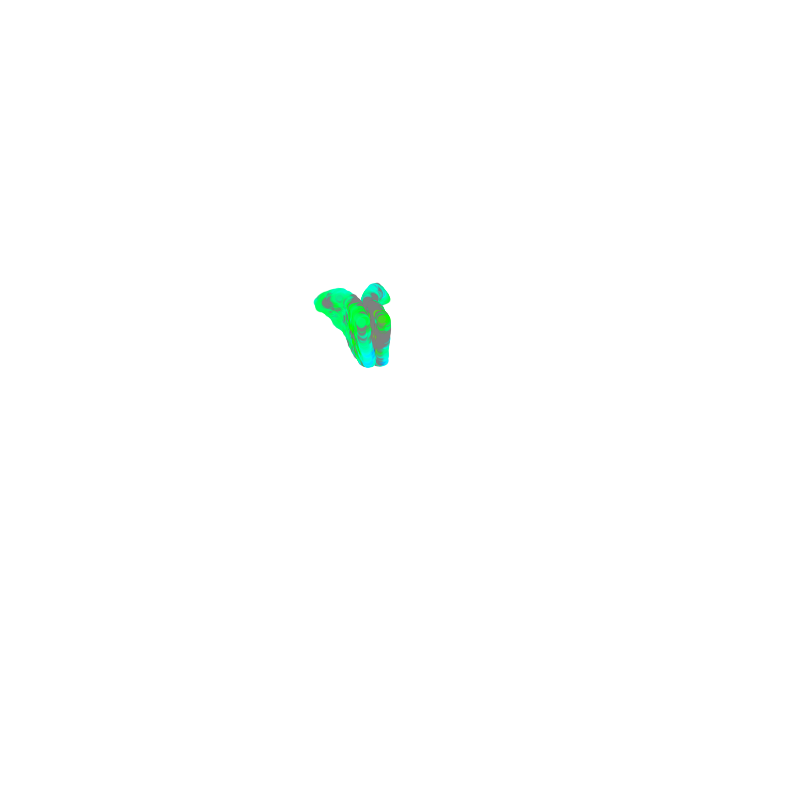

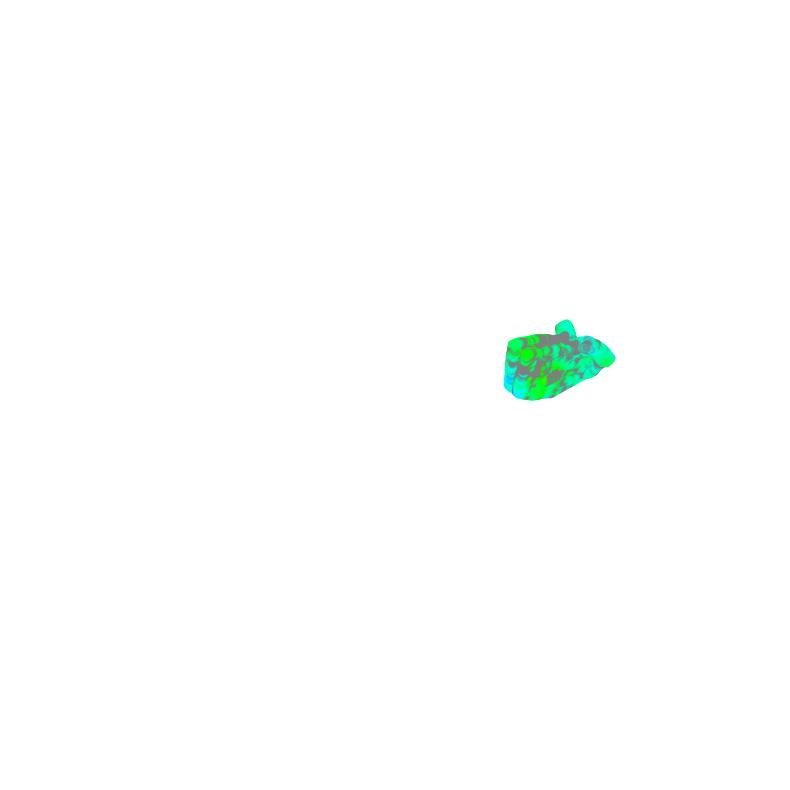

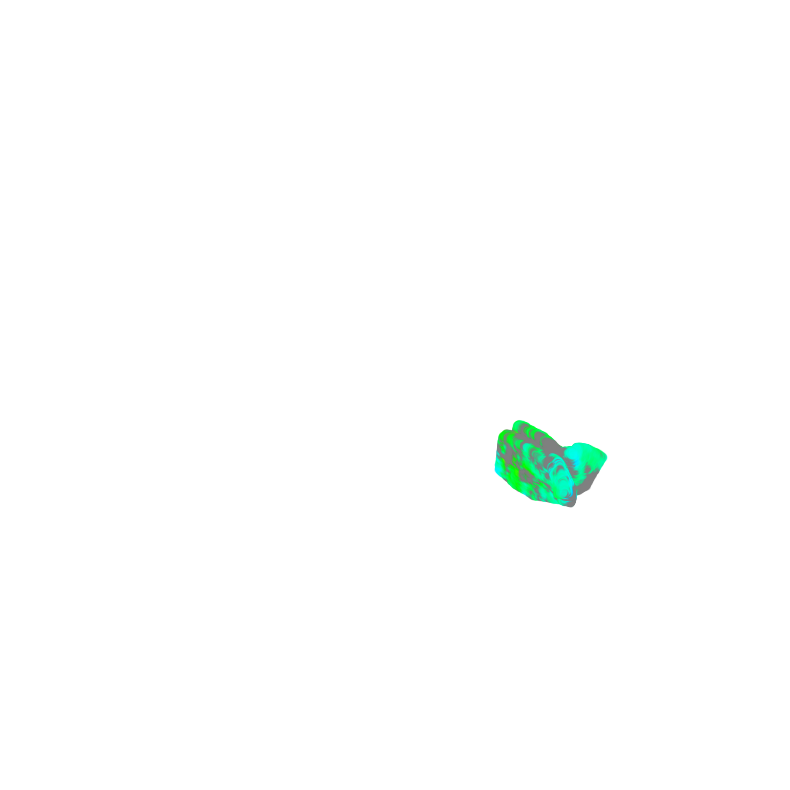

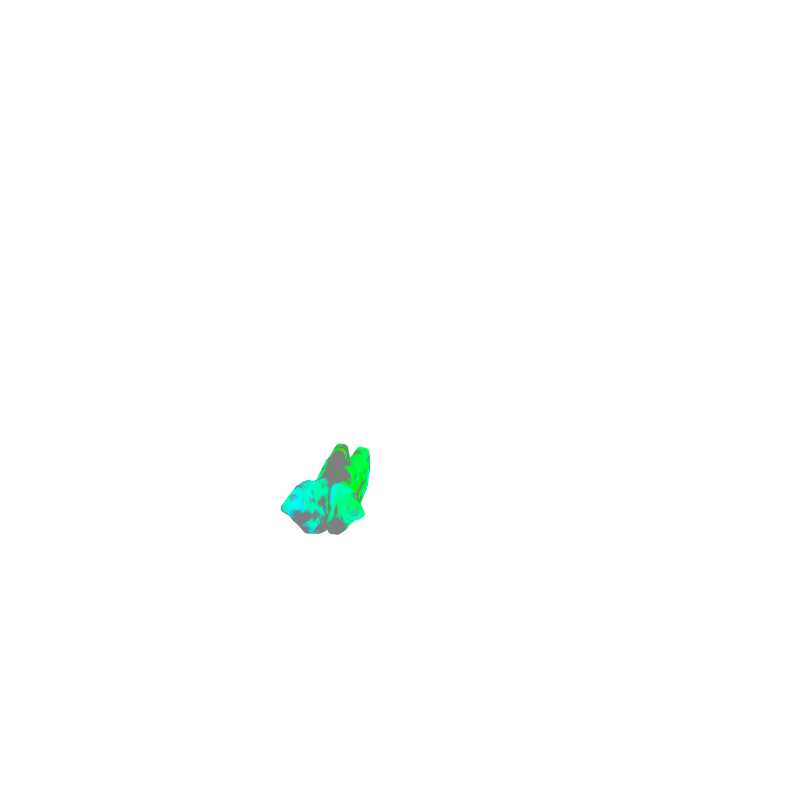

363 PL5
84 PL6a
132 PL6b
44 ILA
707 ILA1
556 ILA2/3


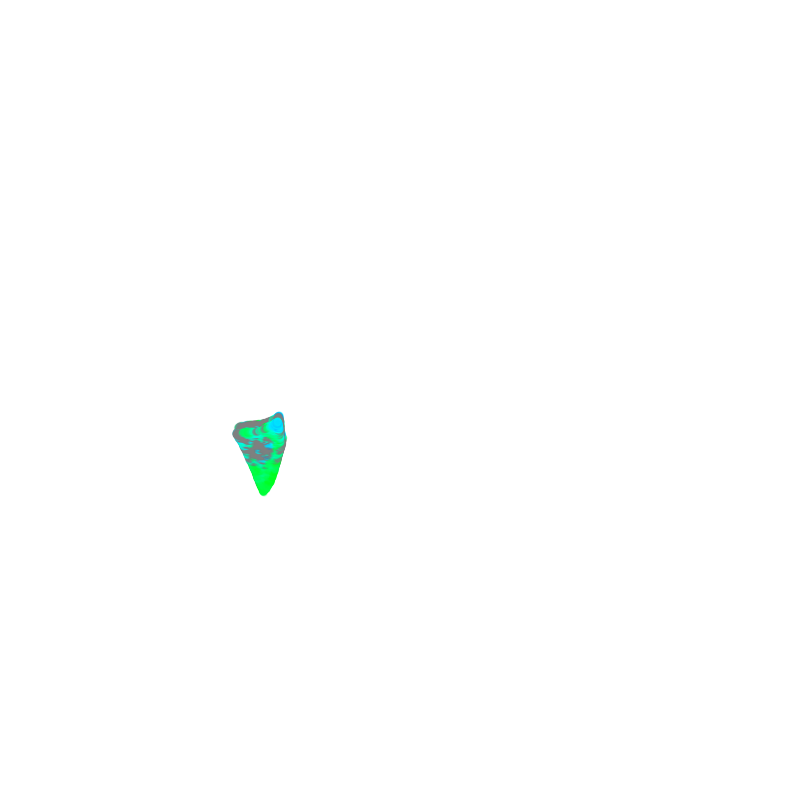

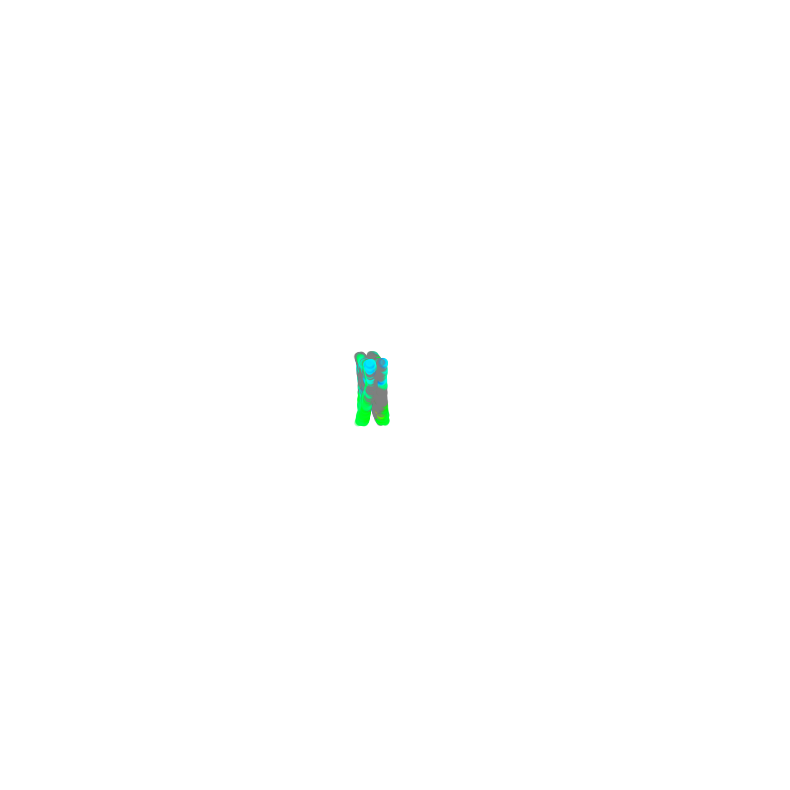

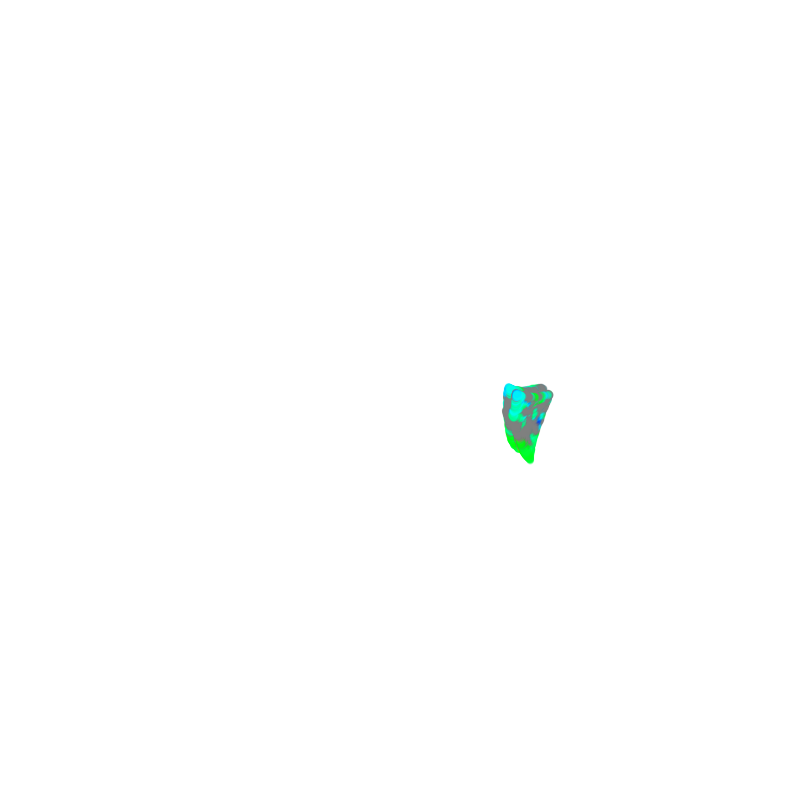

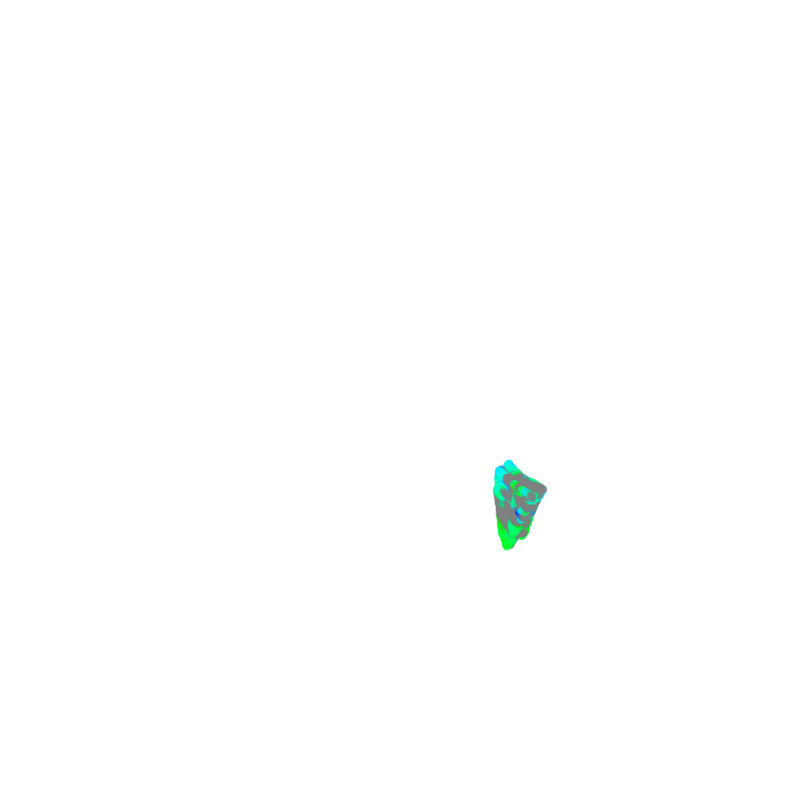

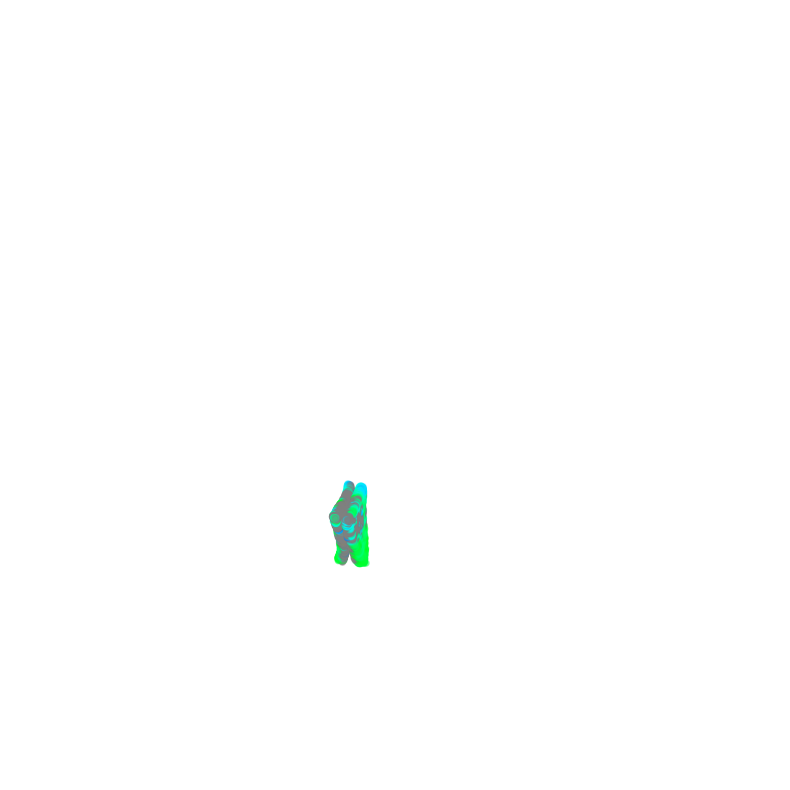

827 ILA5
1054 ILA6a
1081 ILA6b
714 ORB
723 ORBl
448 ORBl1
412 ORBl2/3


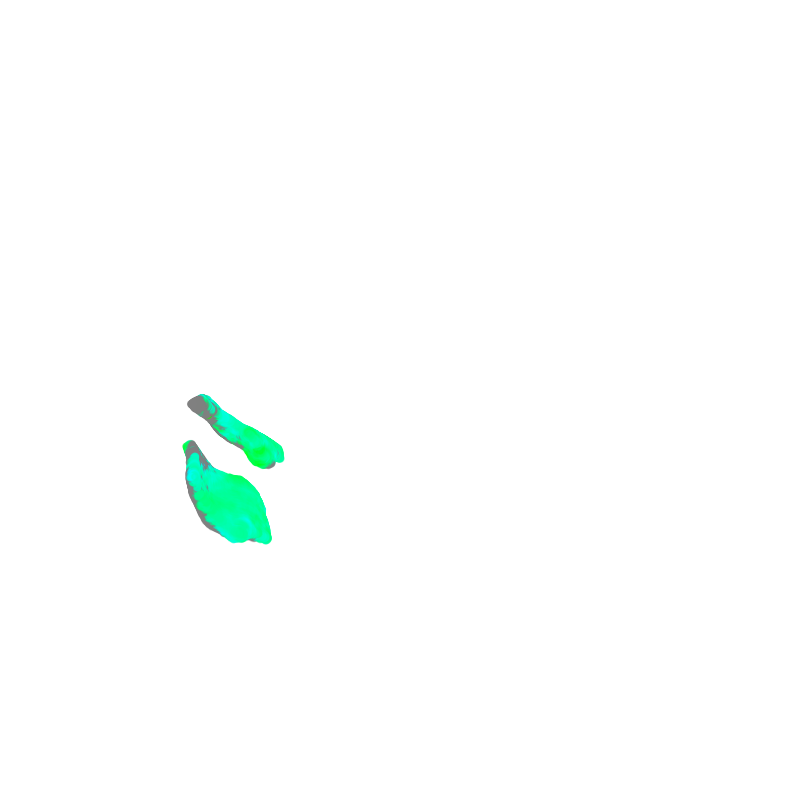

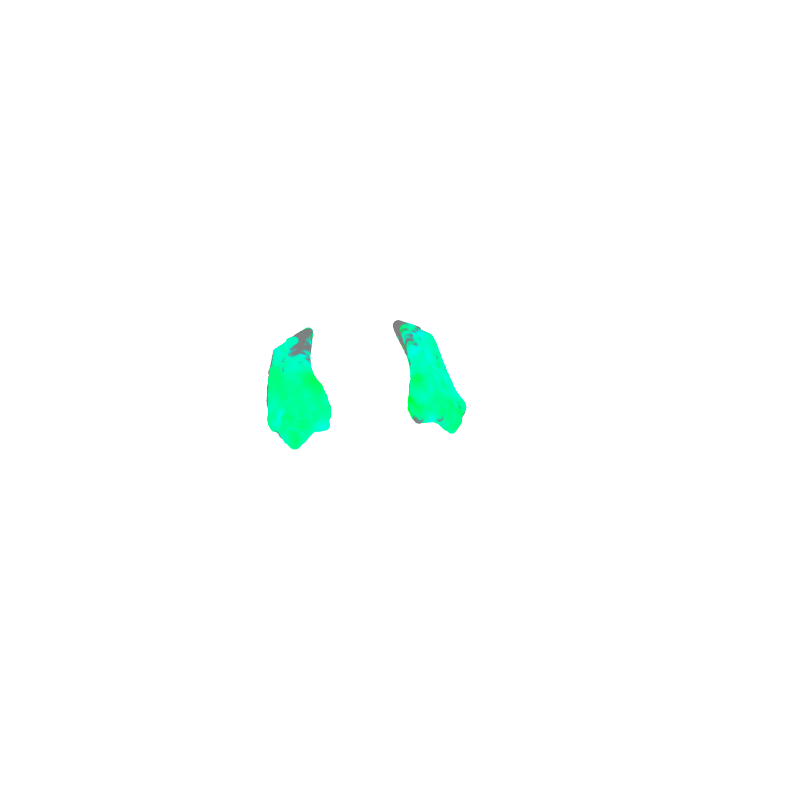

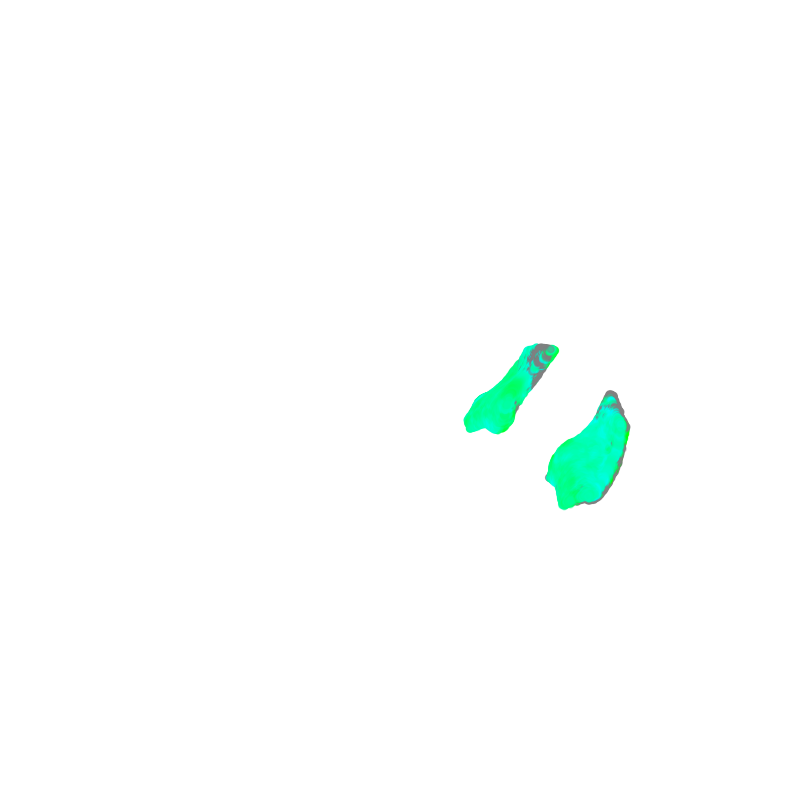

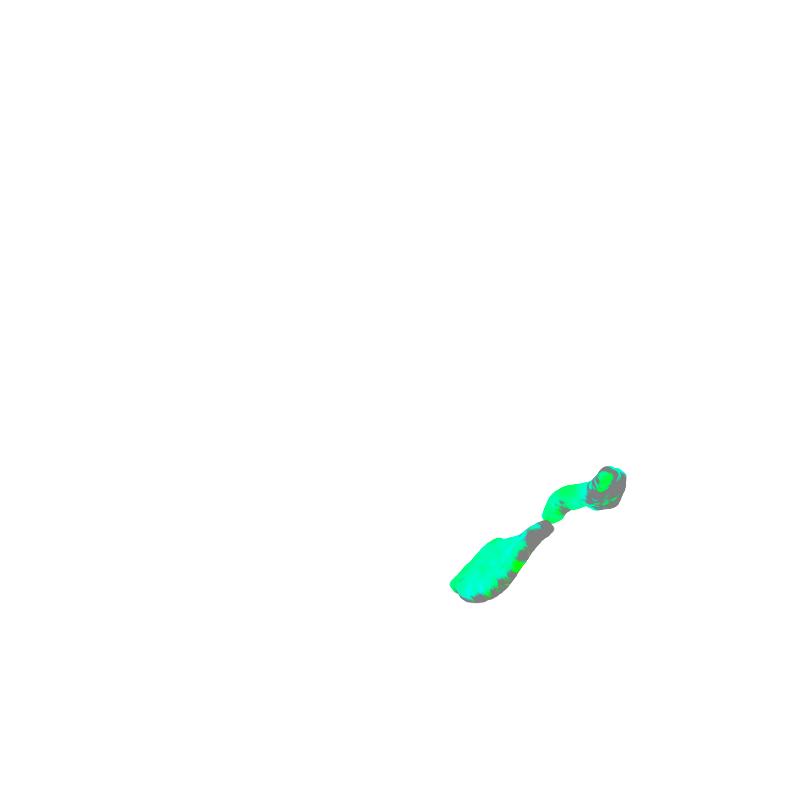

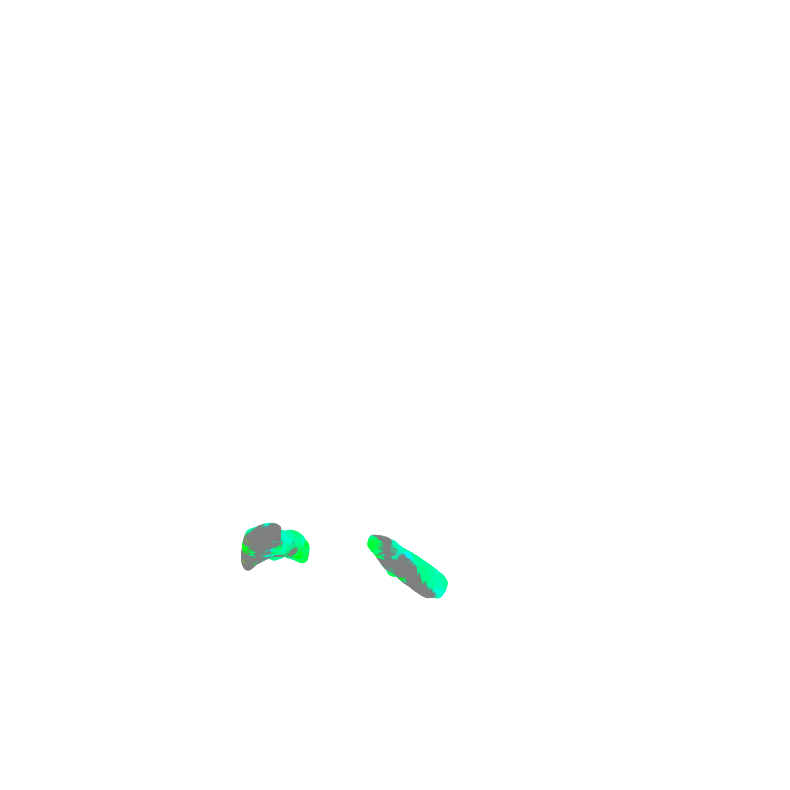

630 ORBl5
440 ORBl6a
488 ORBl6b
731 ORBm
484 ORBm1
582 ORBm2/3


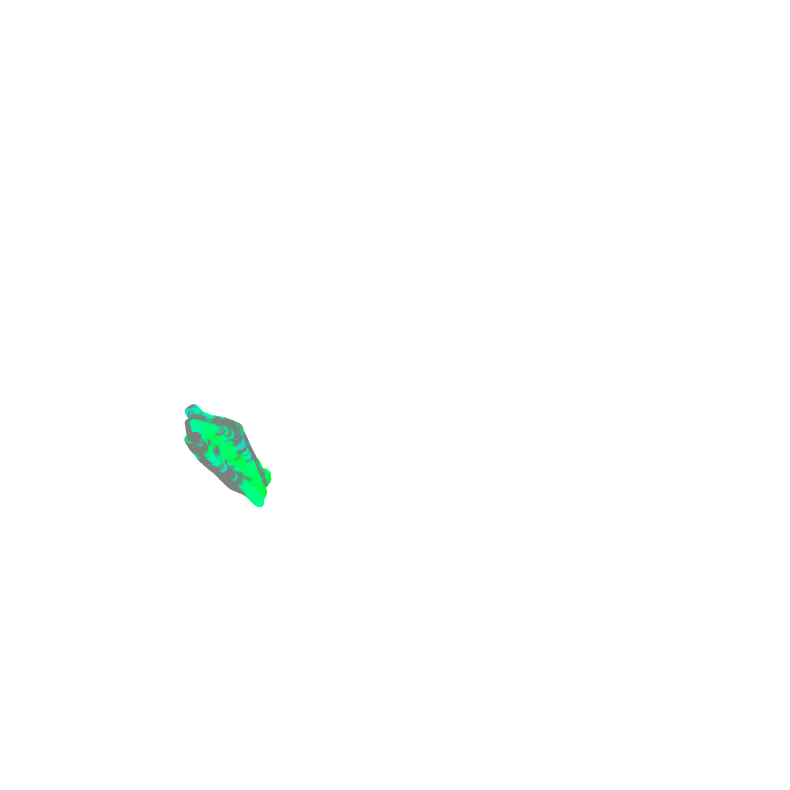

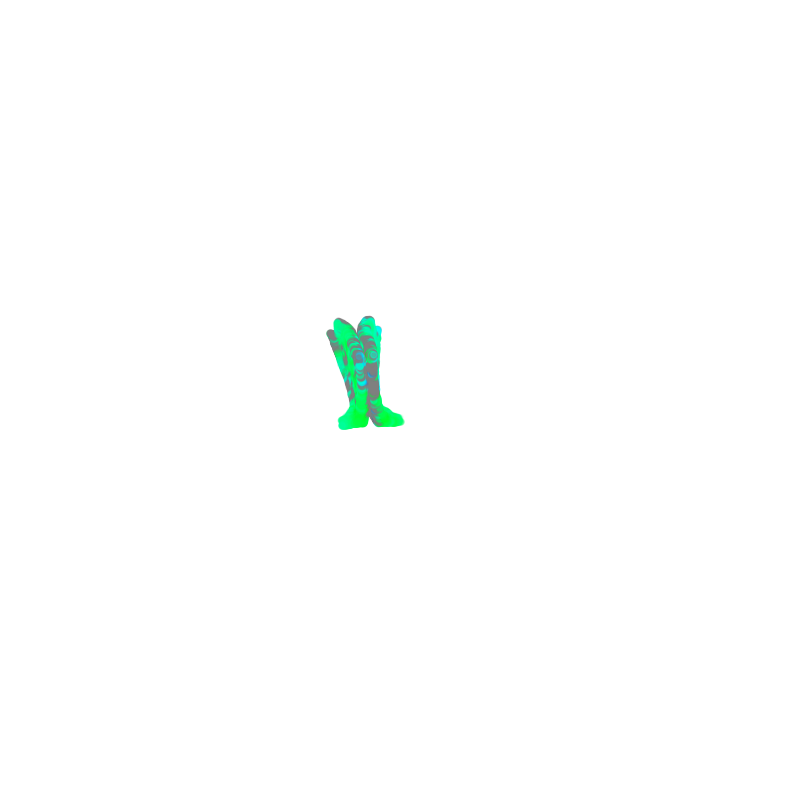

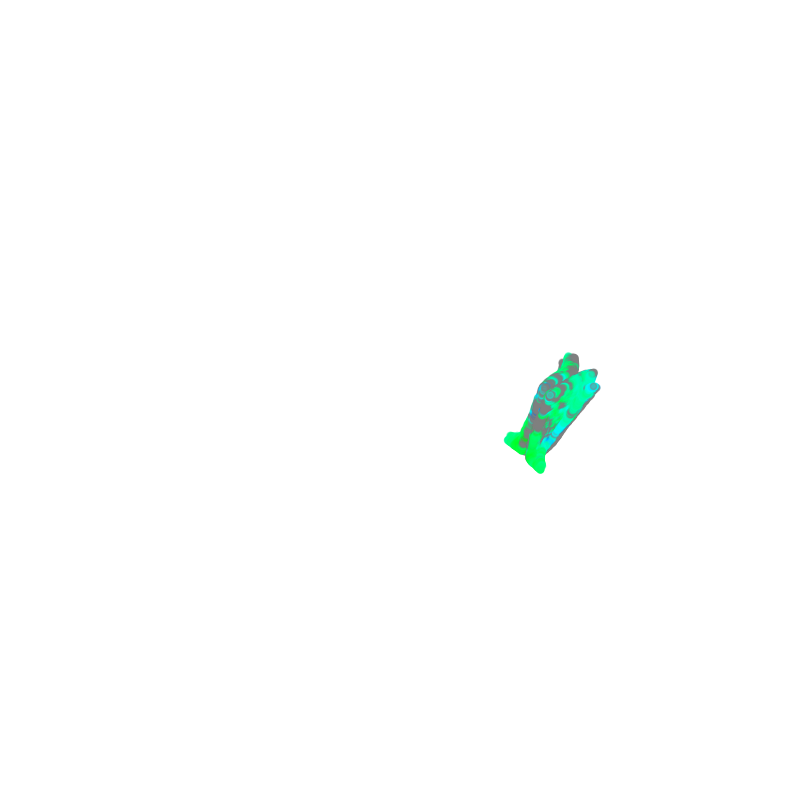

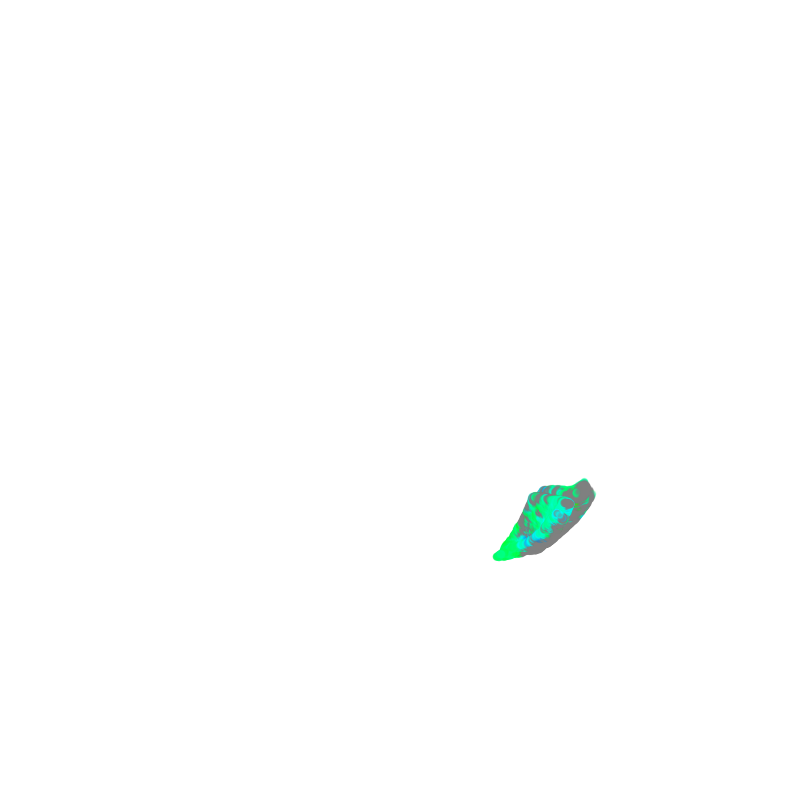

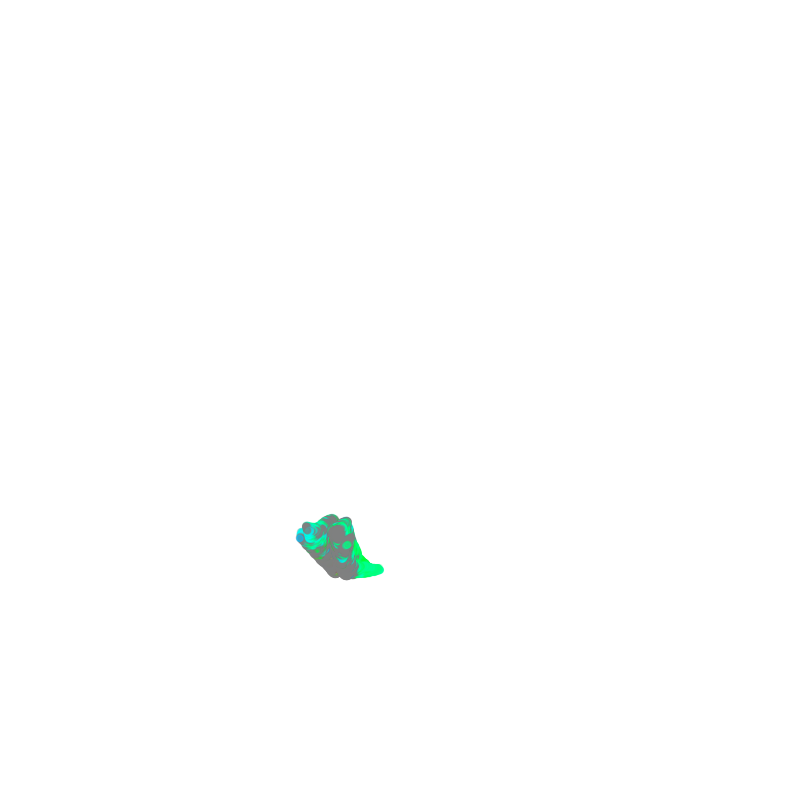

620 ORBm5
910 ORBm6a
52977 ORBm6b
746 ORBvl
969 ORBvl1
288 ORBvl2/3


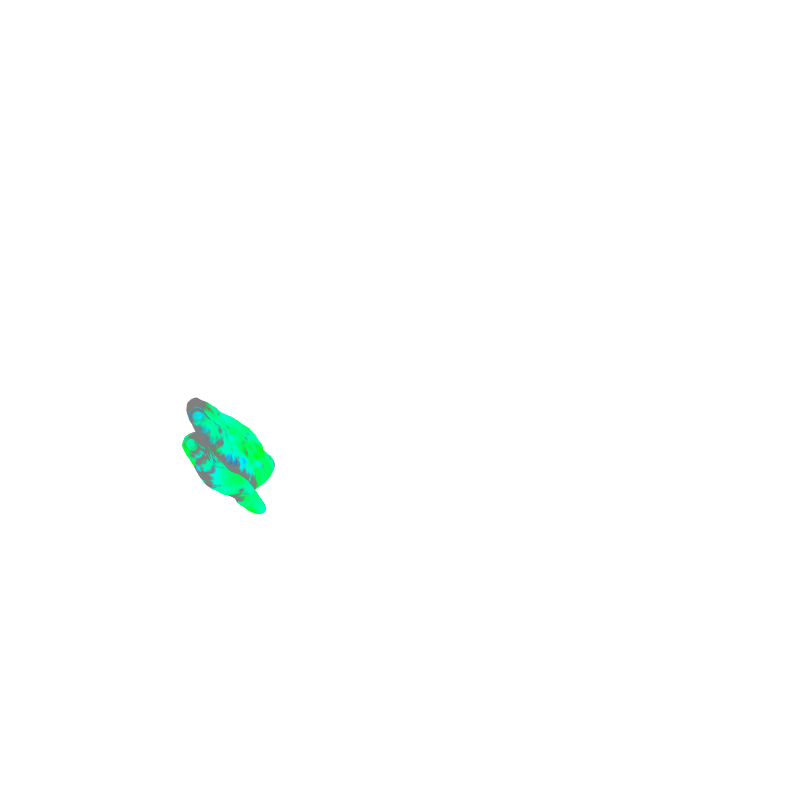

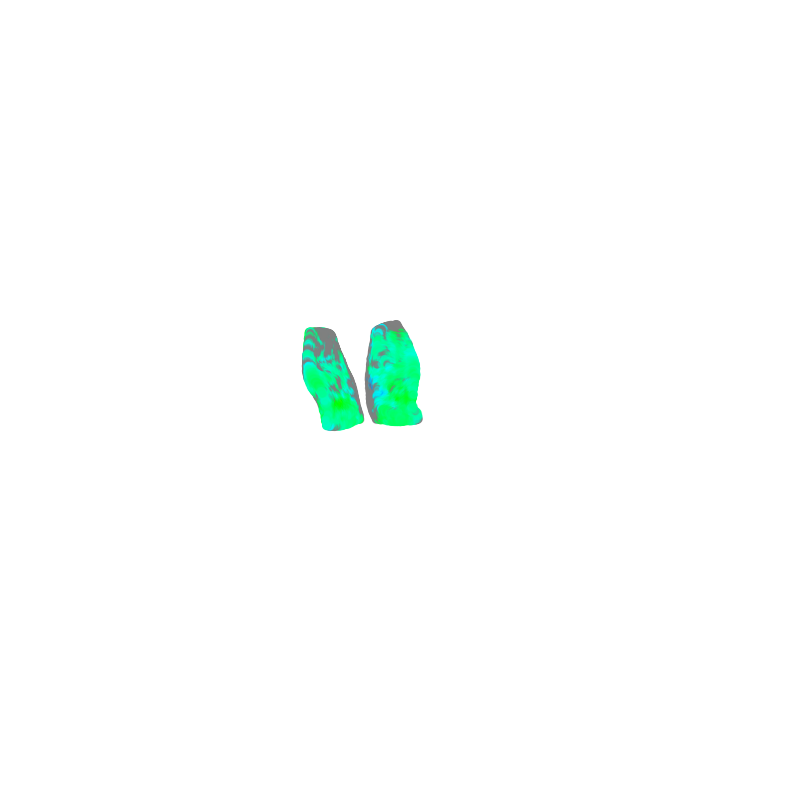

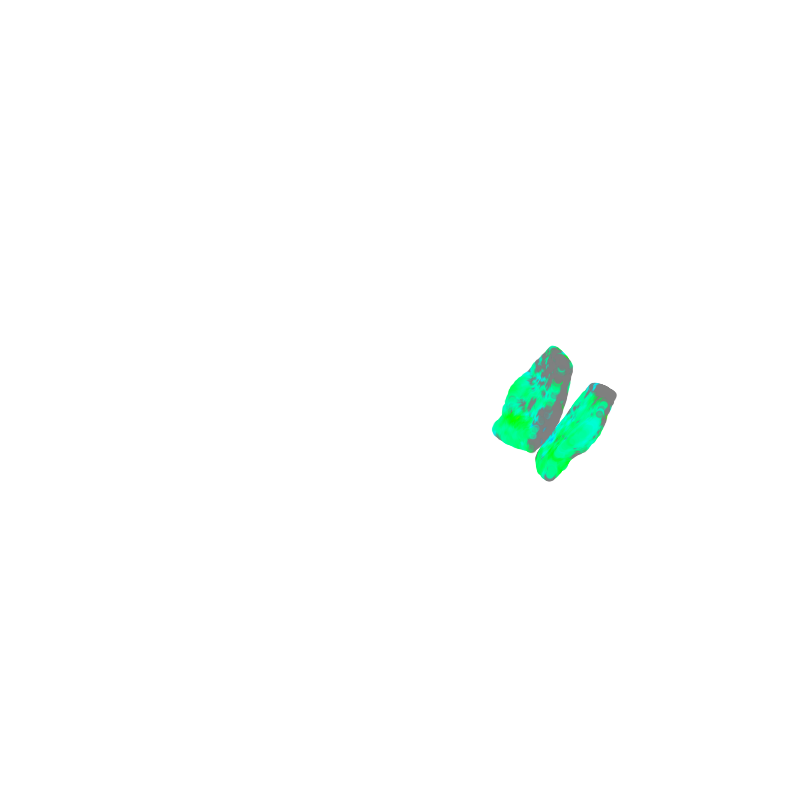

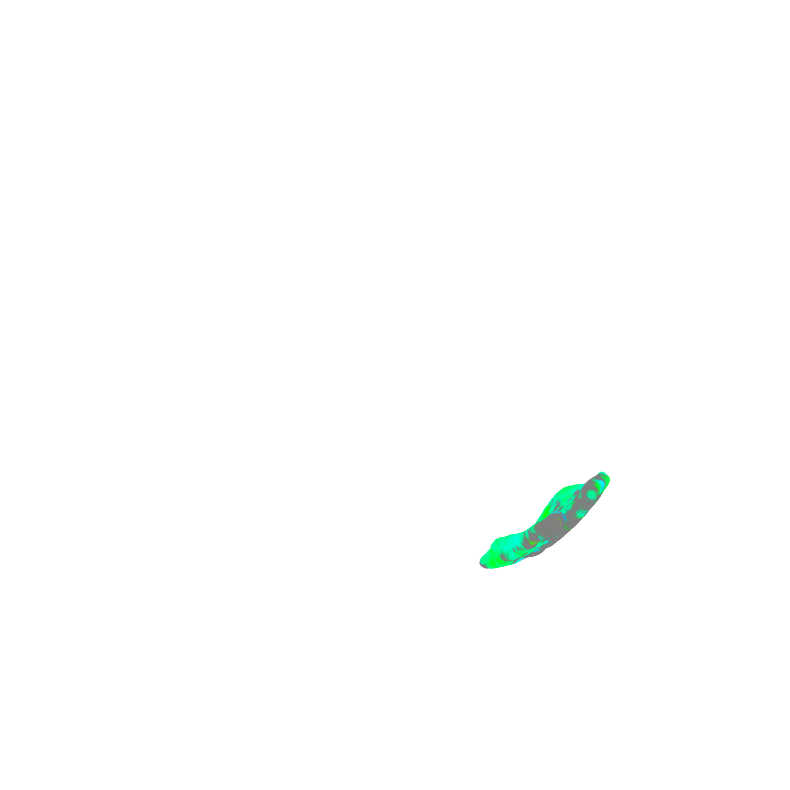

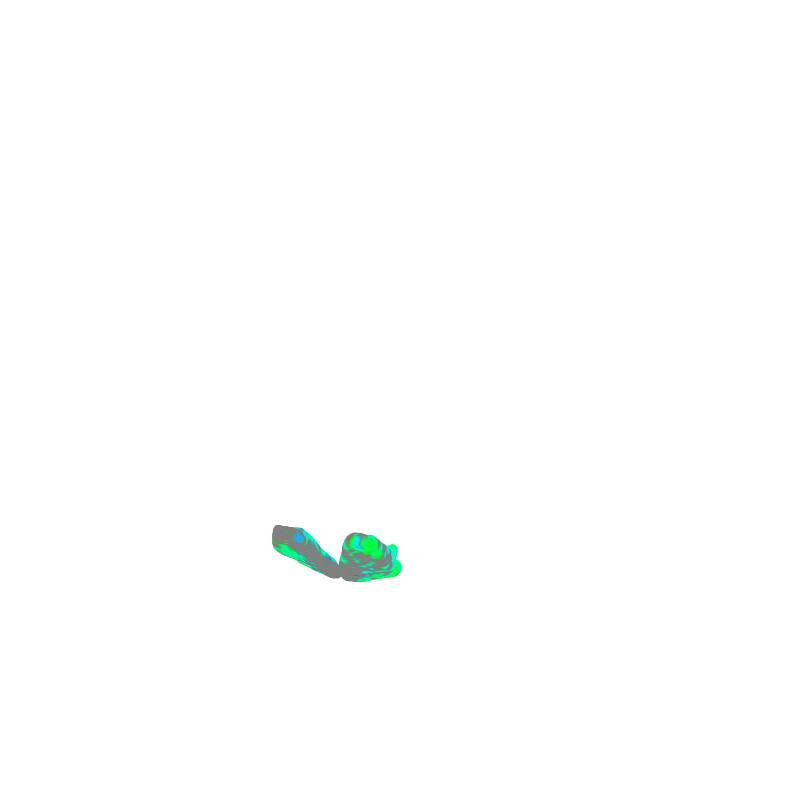

1125 ORBvl5
608 ORBvl6a
680 ORBvl6b
95 AI
104 AId
996 AId1
328 AId2/3


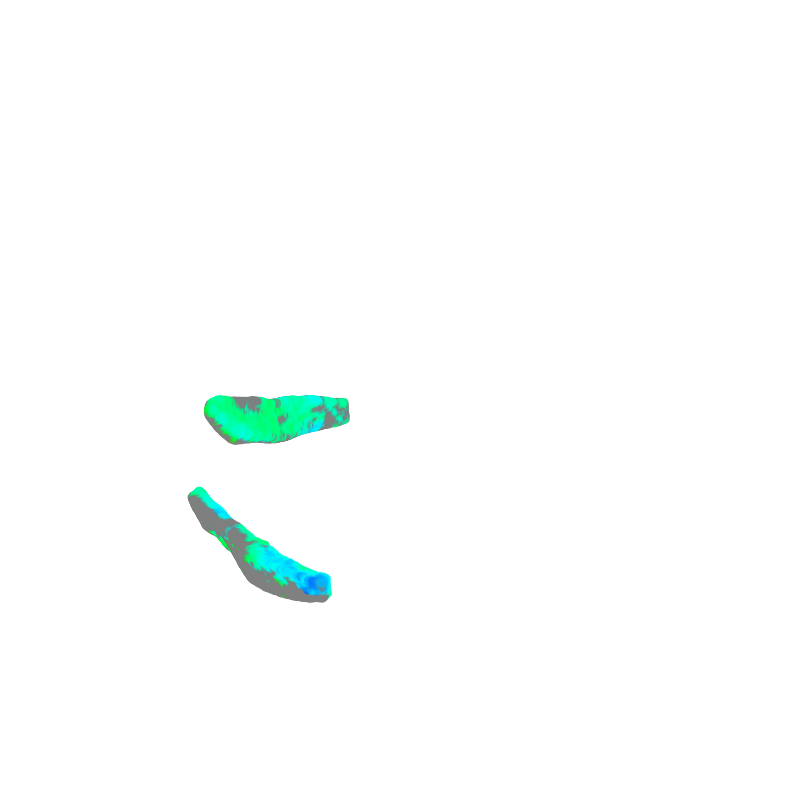

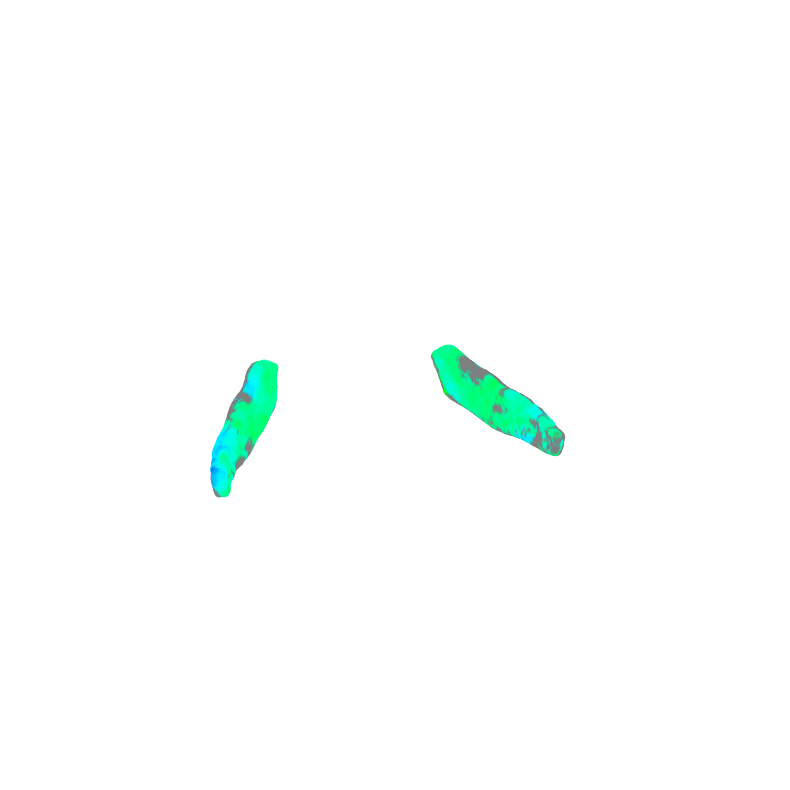

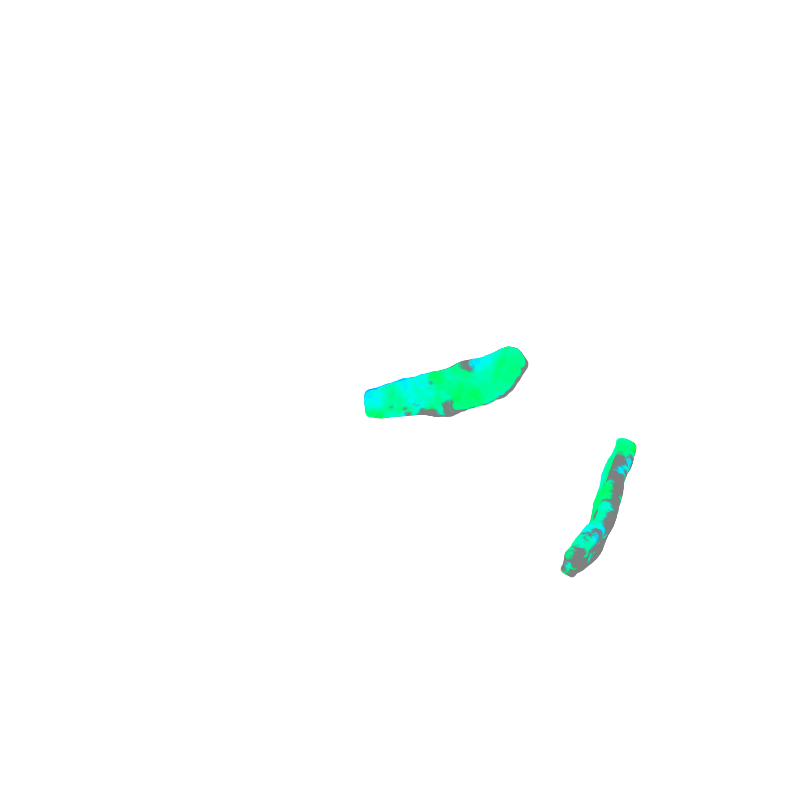

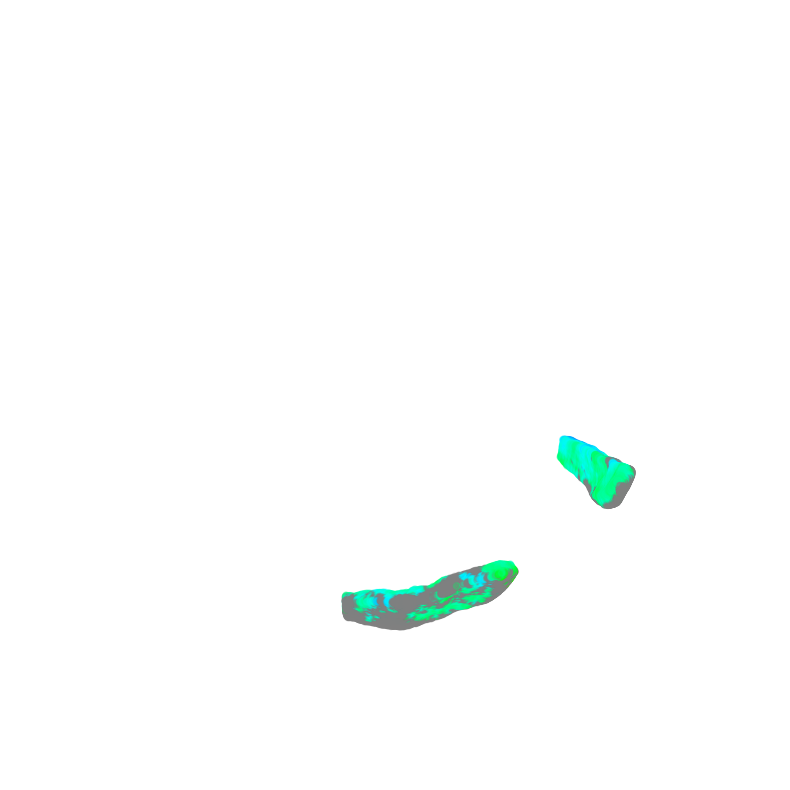

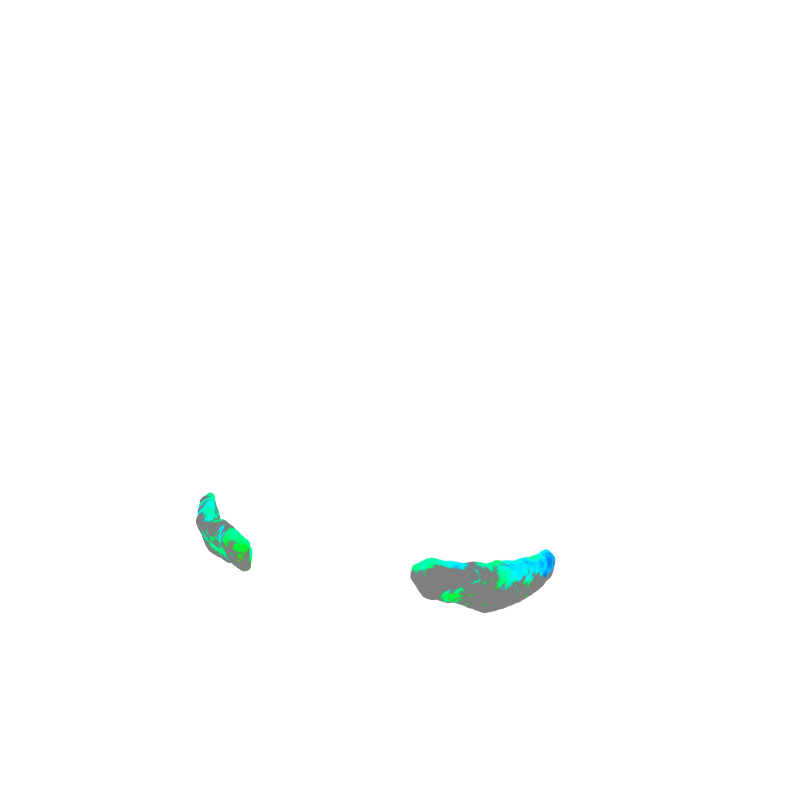

1101 AId5
783 AId6a
831 AId6b
111 AIp
120 AIp1
163 AIp2/3


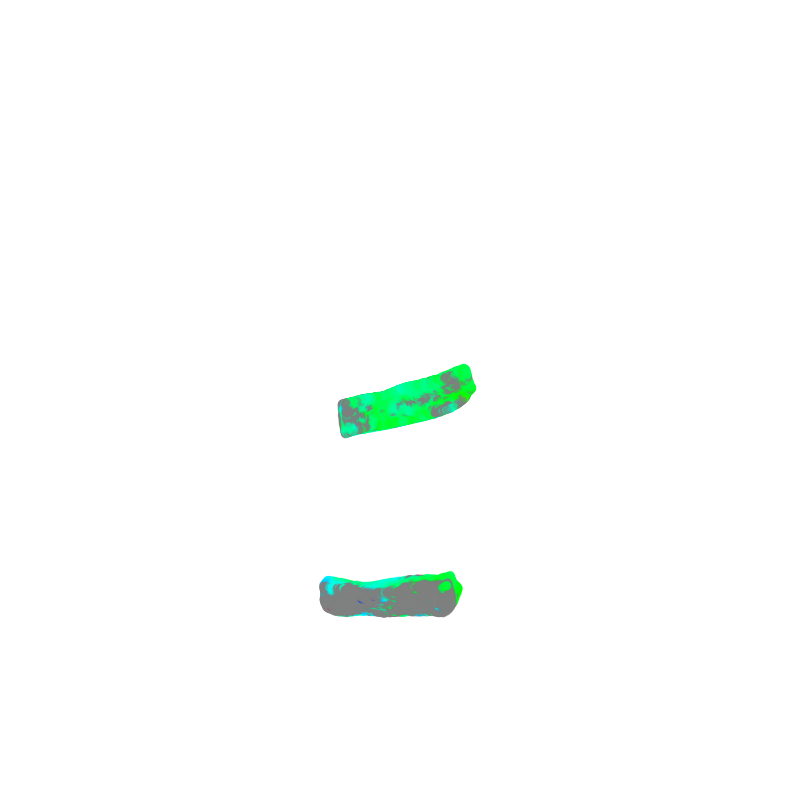

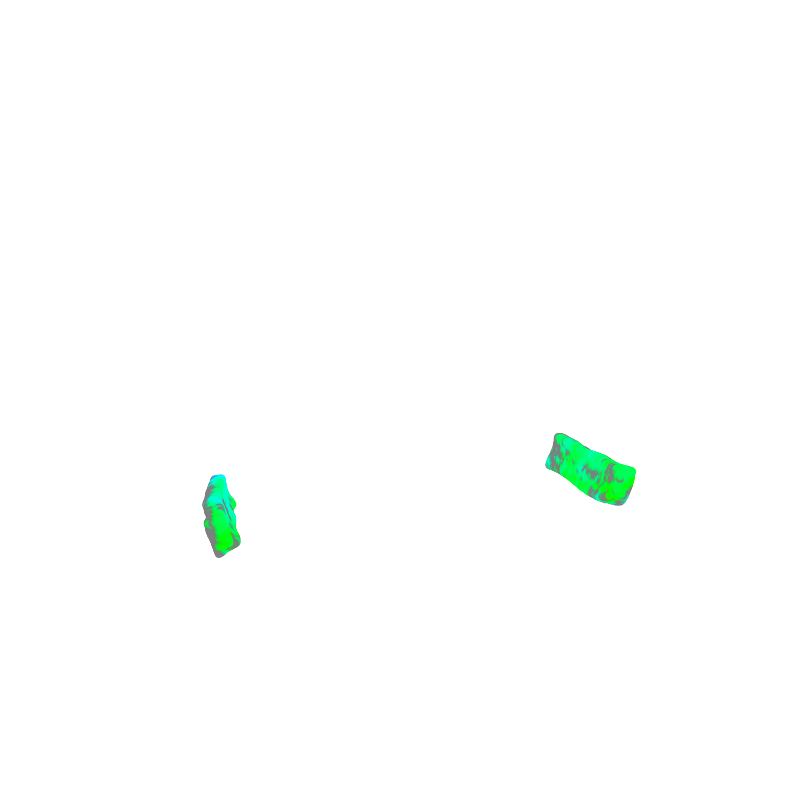

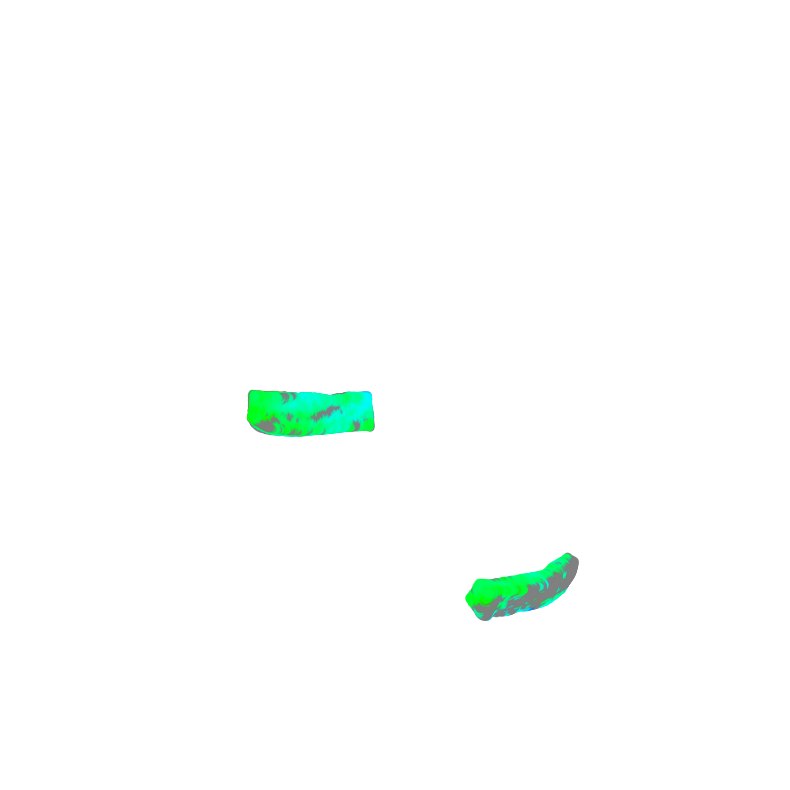

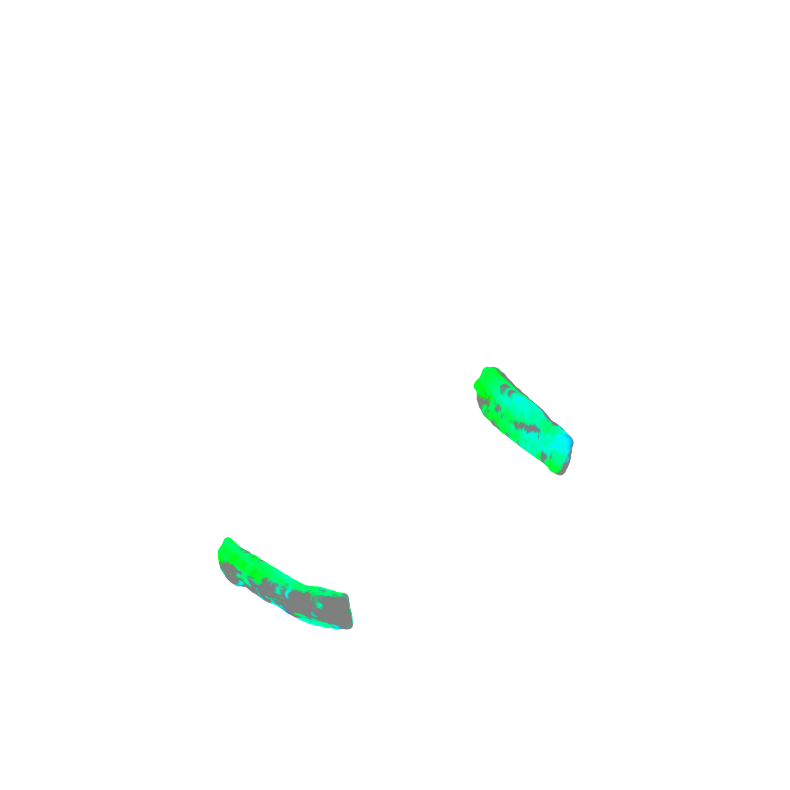

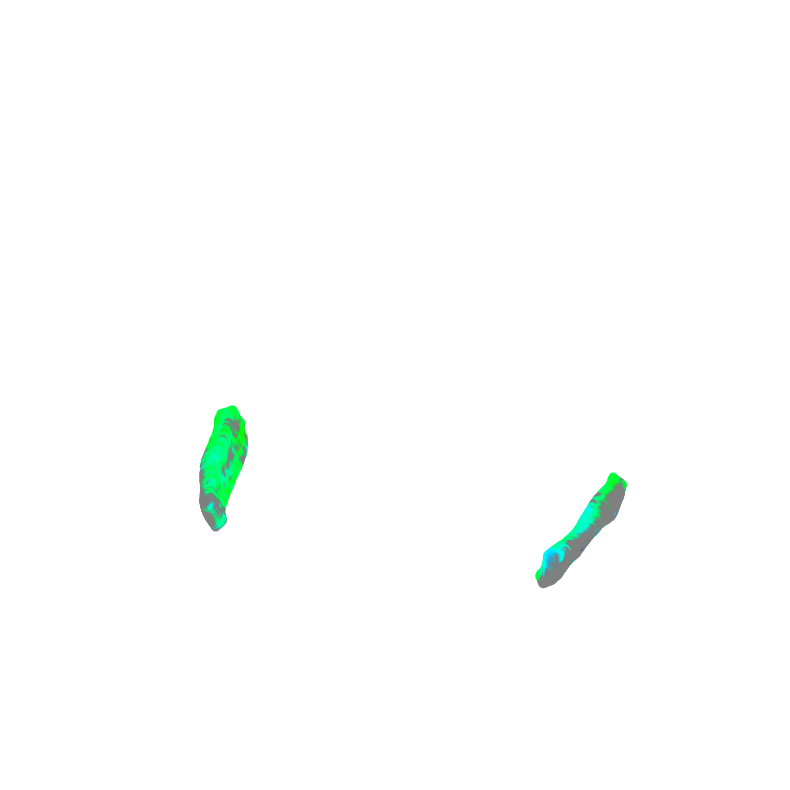

344 AIp5
314 AIp6a
355 AIp6b
119 AIv
704 AIv1
694 AIv2/3


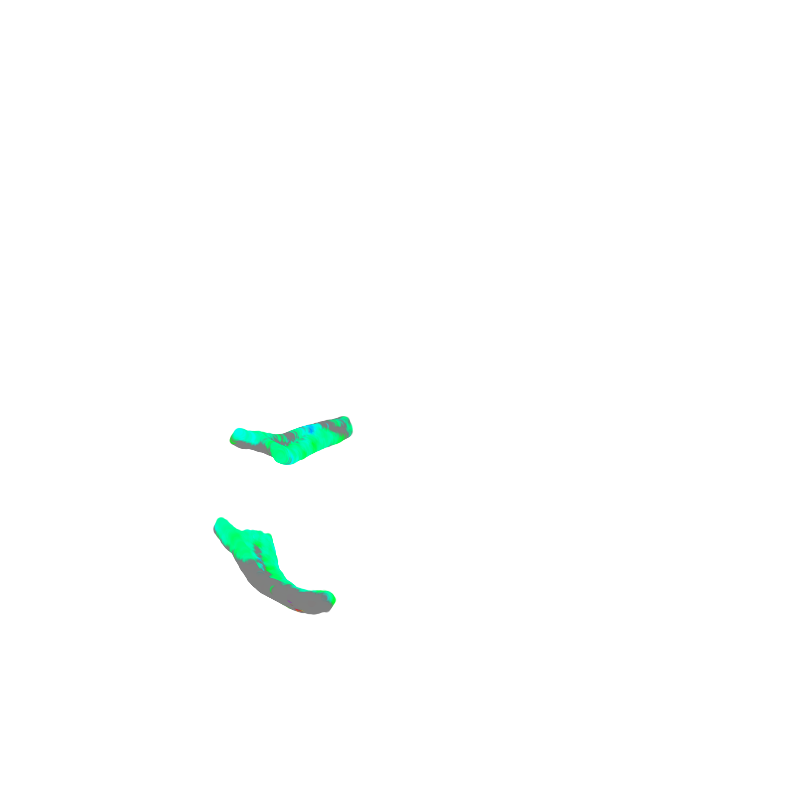

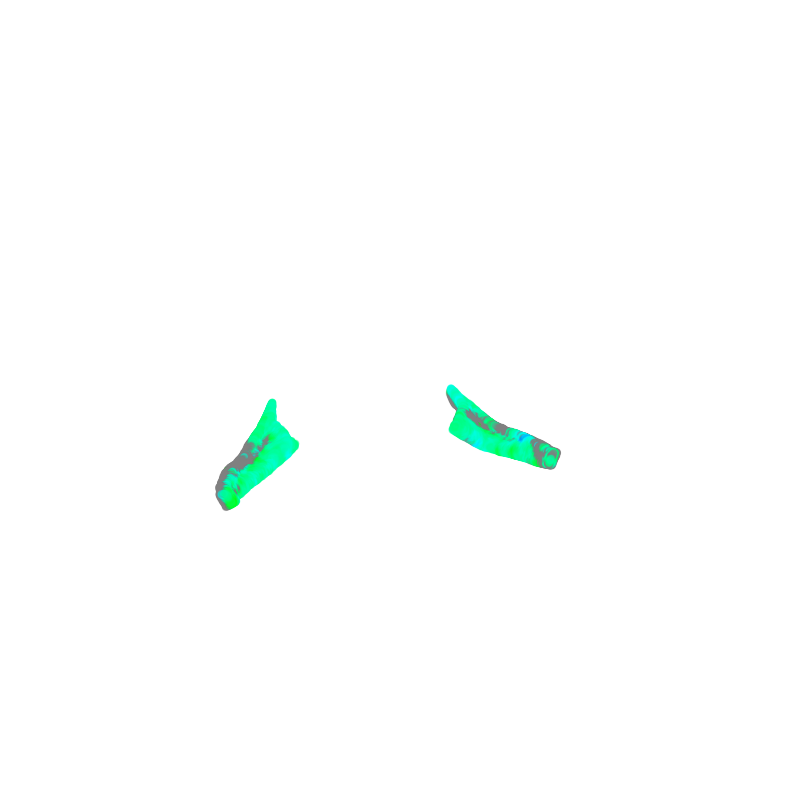

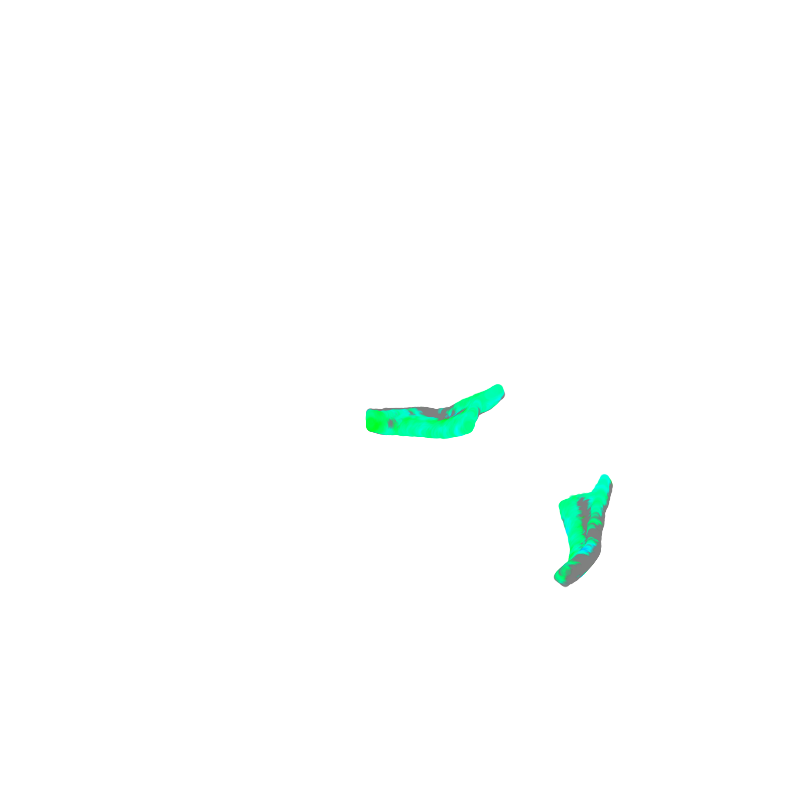

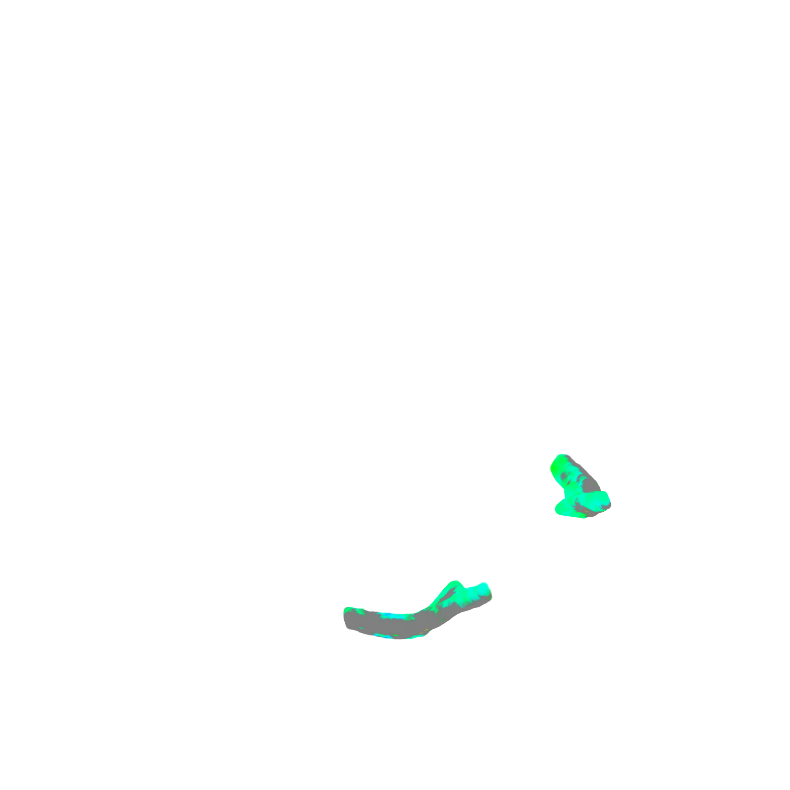

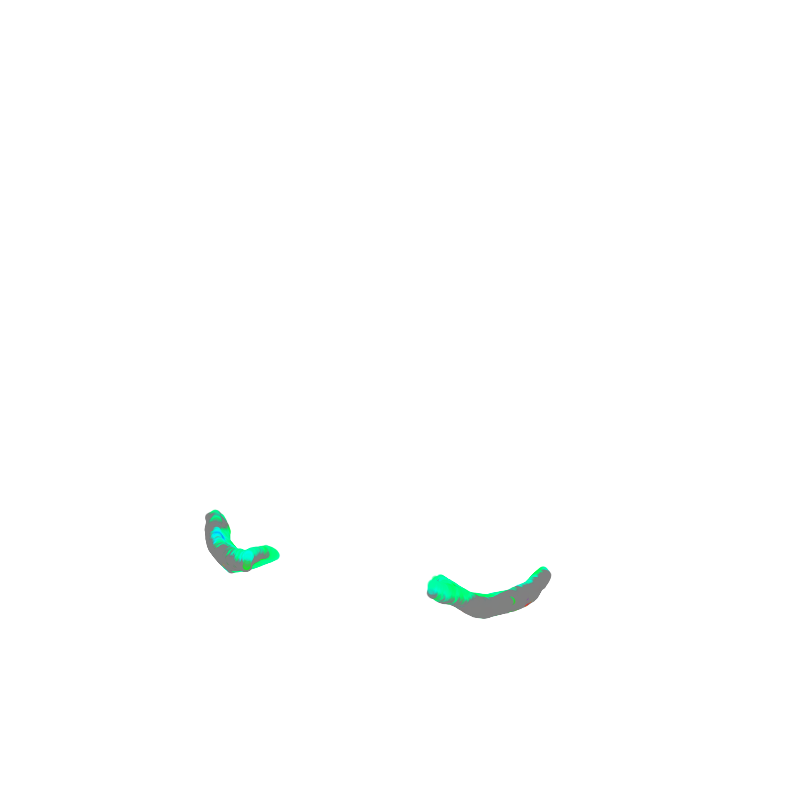

800 AIv5
675 AIv6a
699 AIv6b
254 RSP
894 RSPagl
671 RSPagl1
965 RSPagl2/3


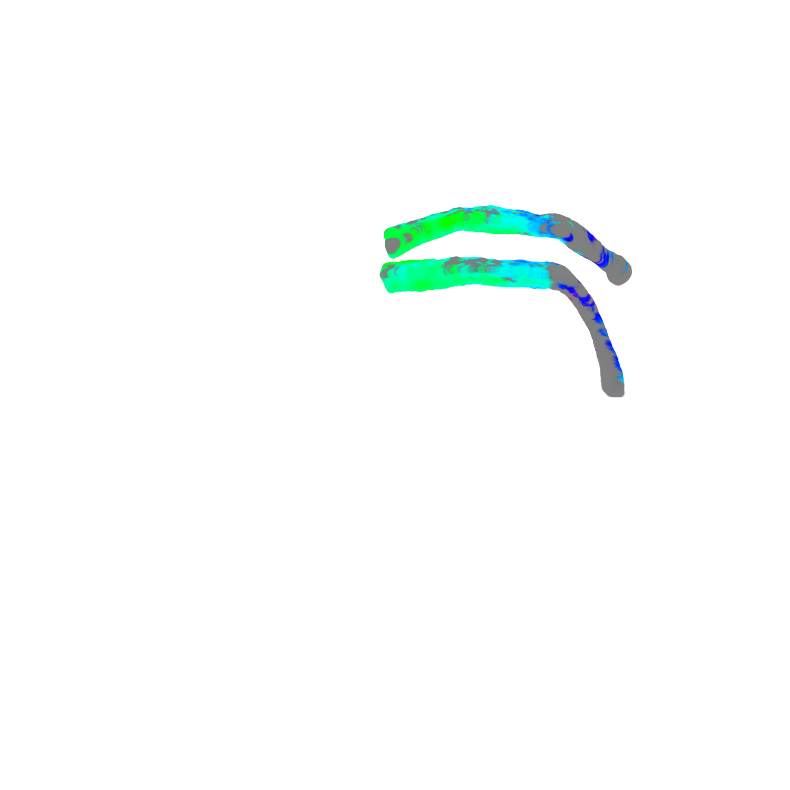

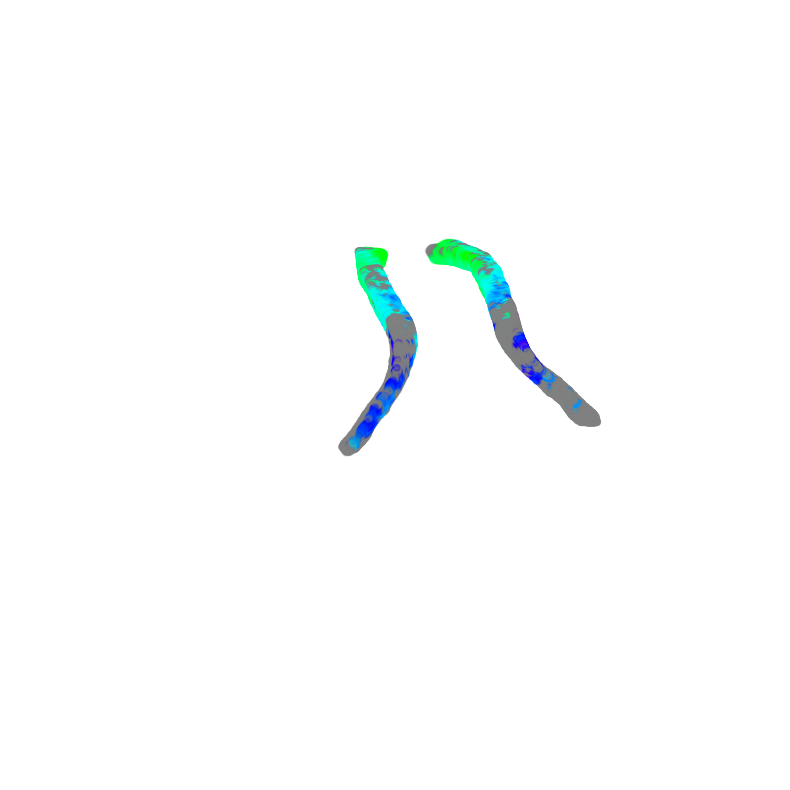

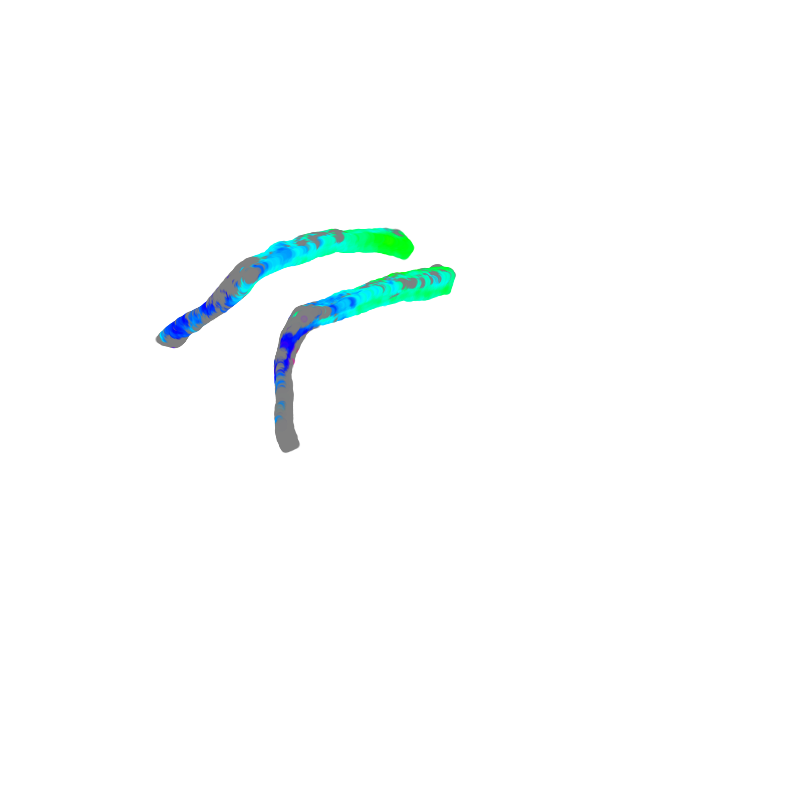

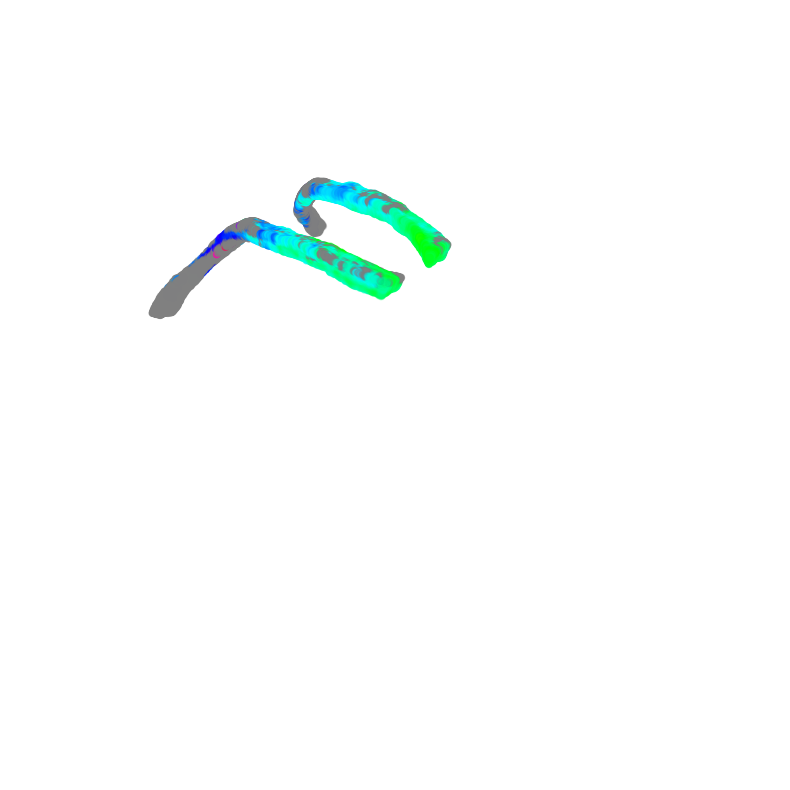

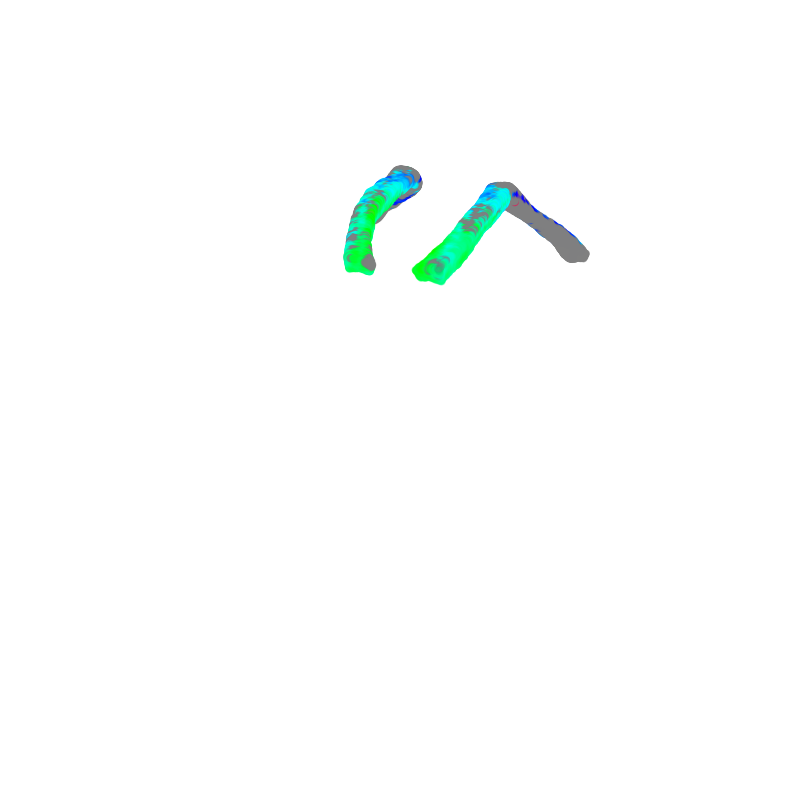

774 RSPagl5
906 RSPagl6a
279 RSPagl6b
879 RSPd
442 RSPd1
434 RSPd2/3


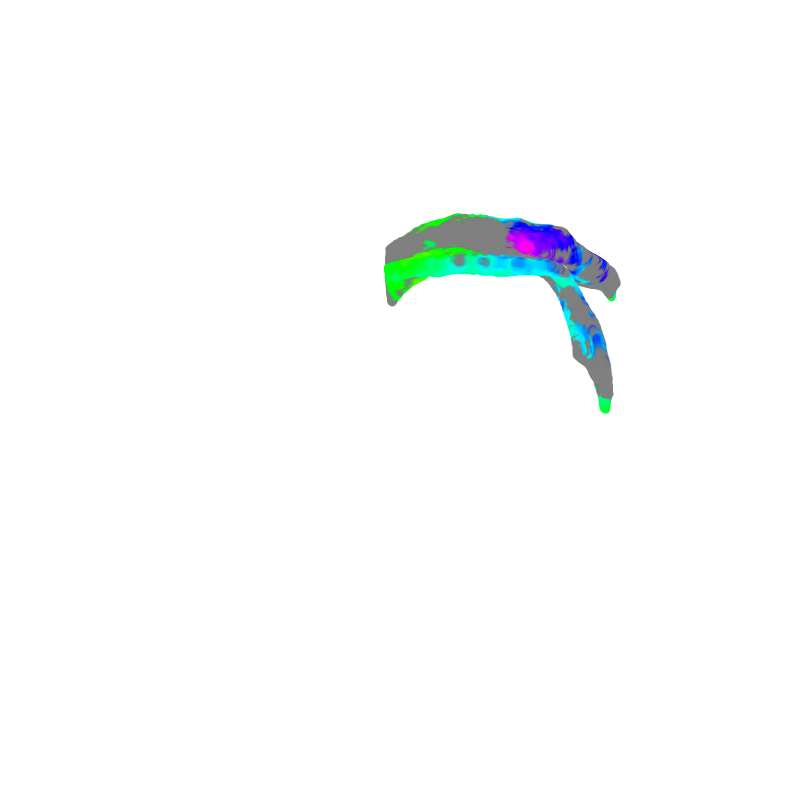

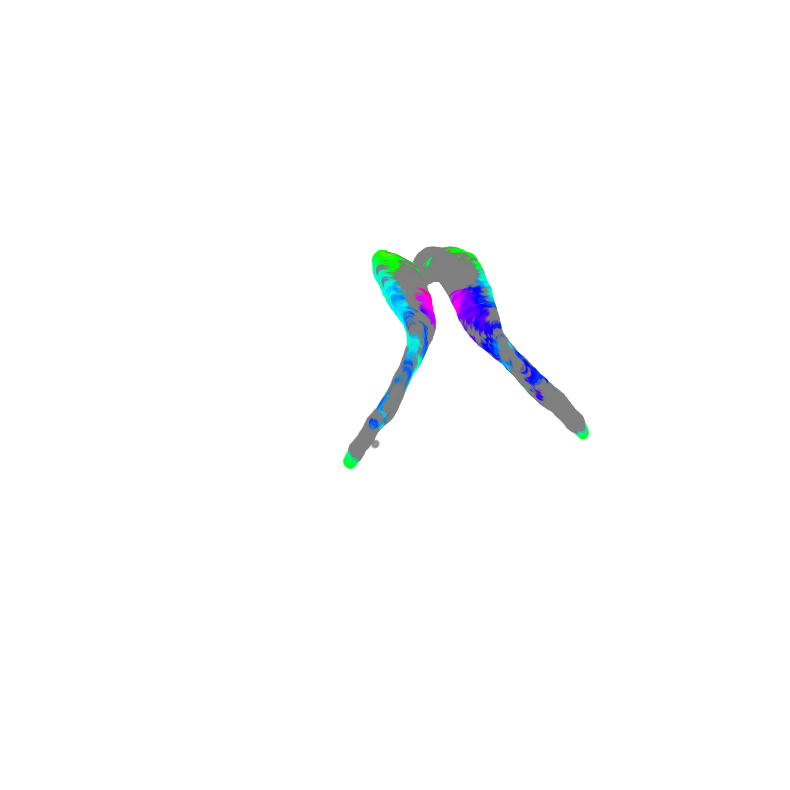

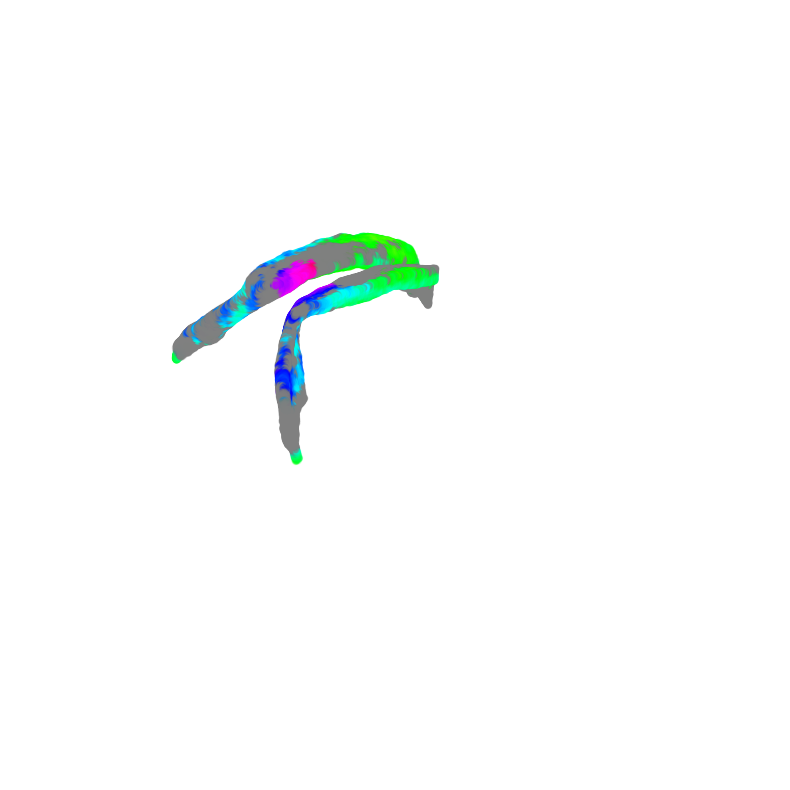

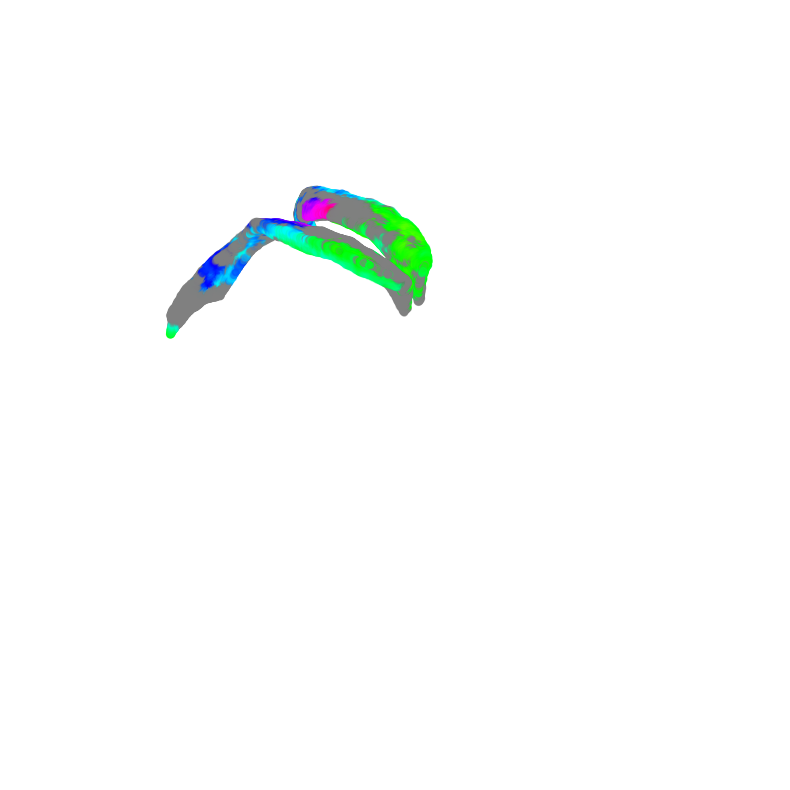

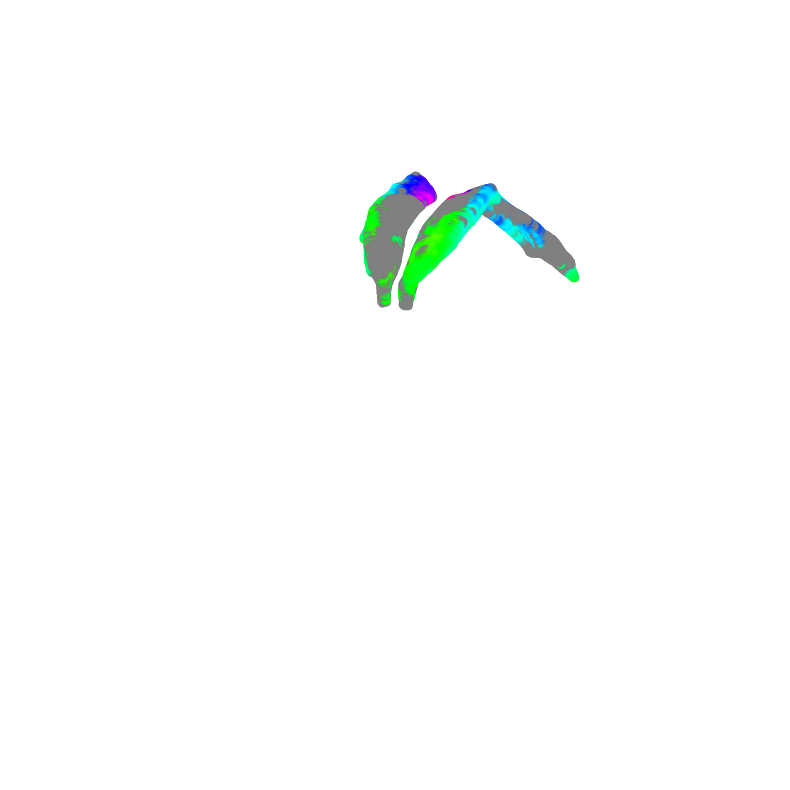

610 RSPd5
274 RSPd6a
330 RSPd6b
886 RSPv
542 RSPv1
430 RSPv2/3


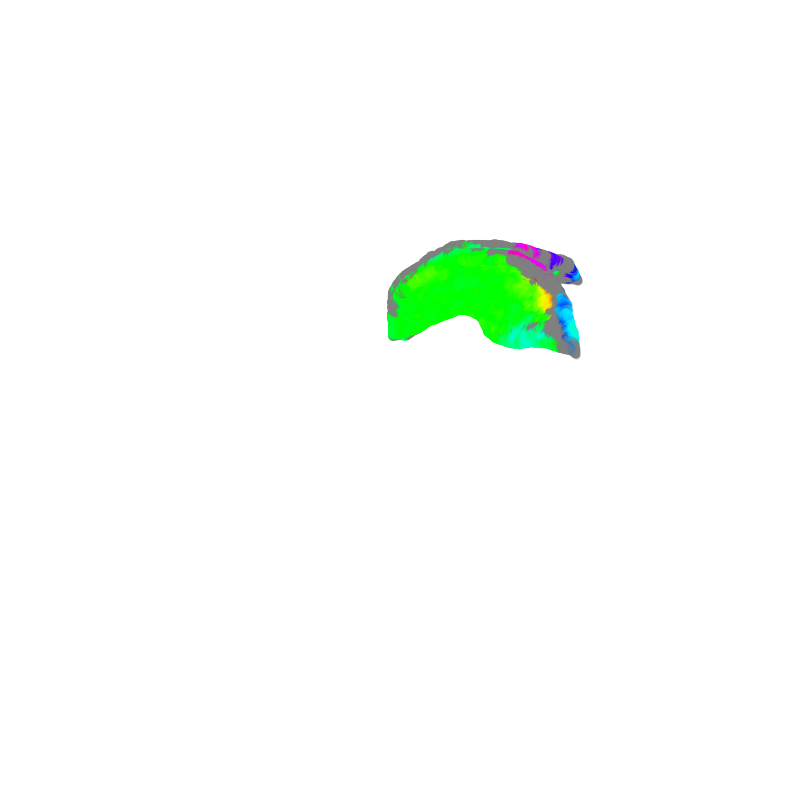

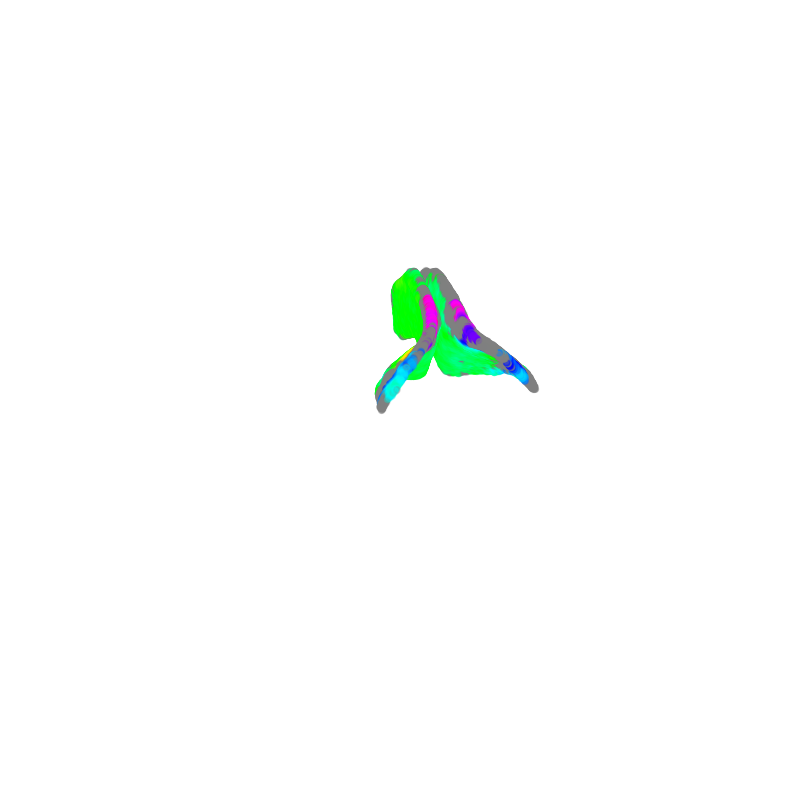

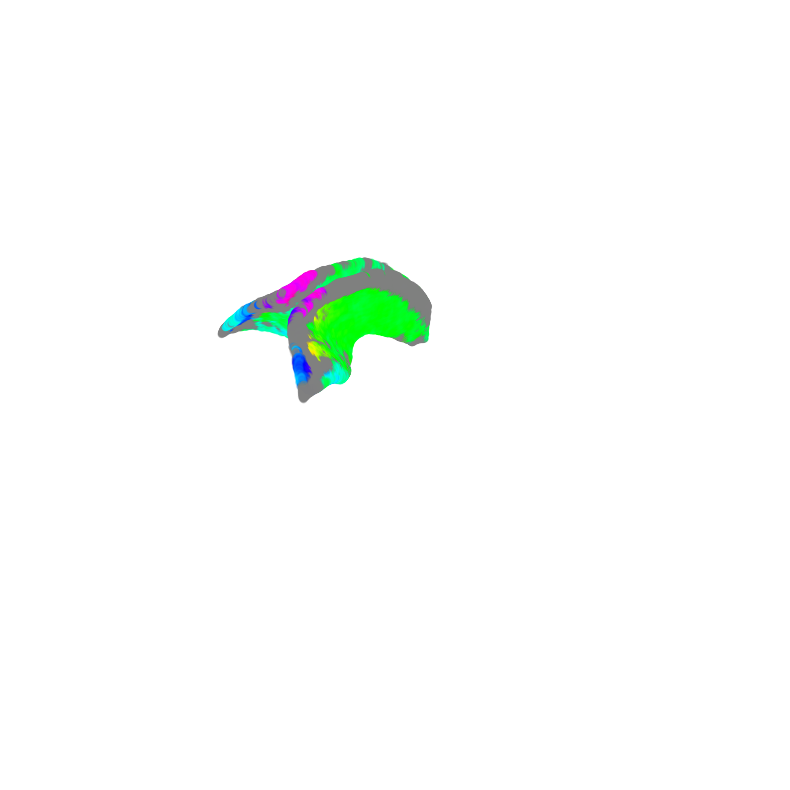

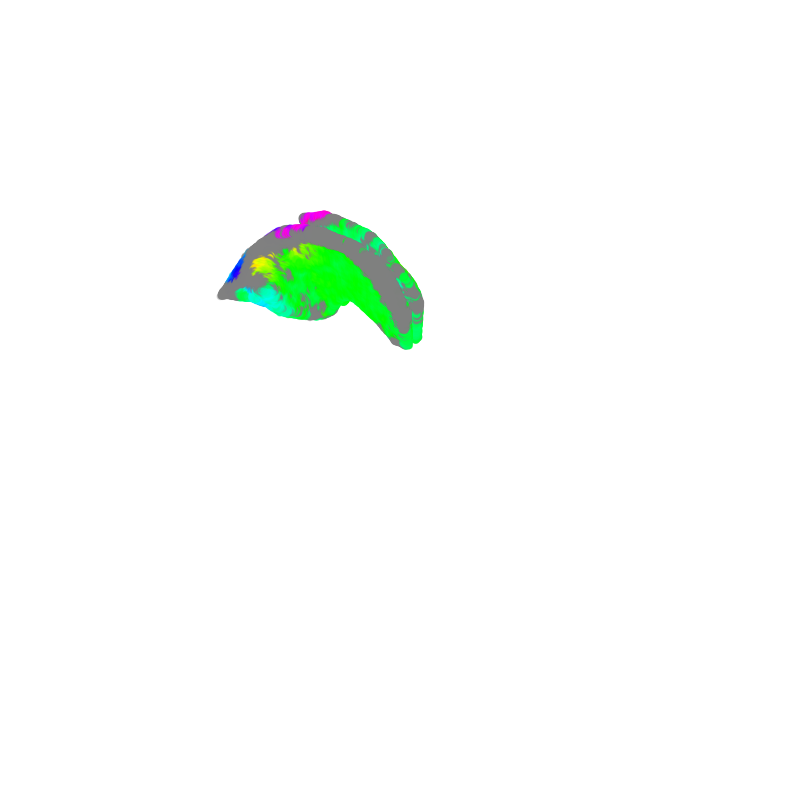

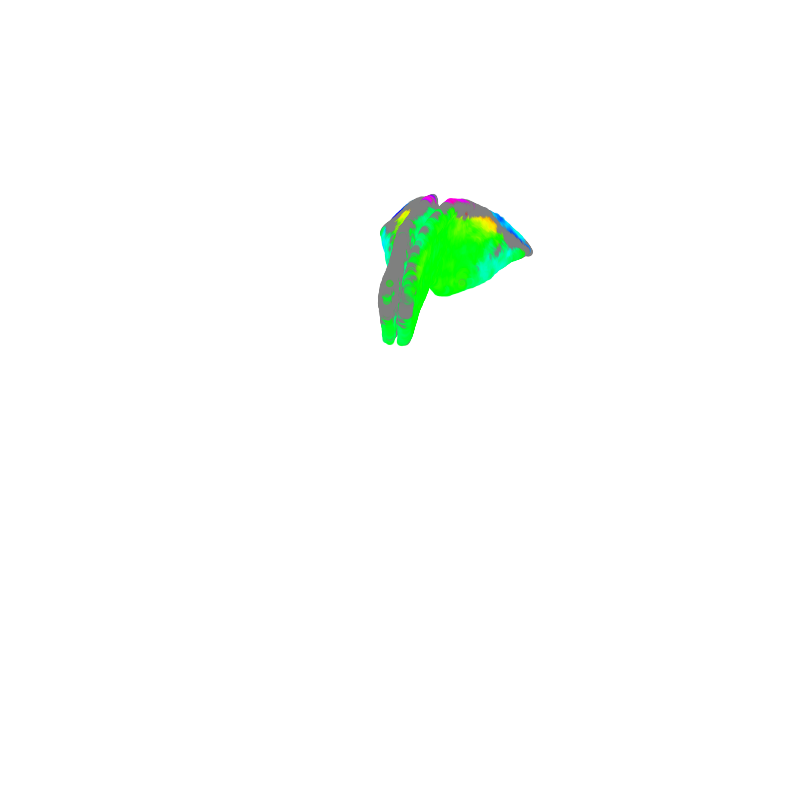

687 RSPv5
590 RSPv6a
622 RSPv6b
22 PTLp
31546 VISa
31550 VISa1
31554 VISa2/3


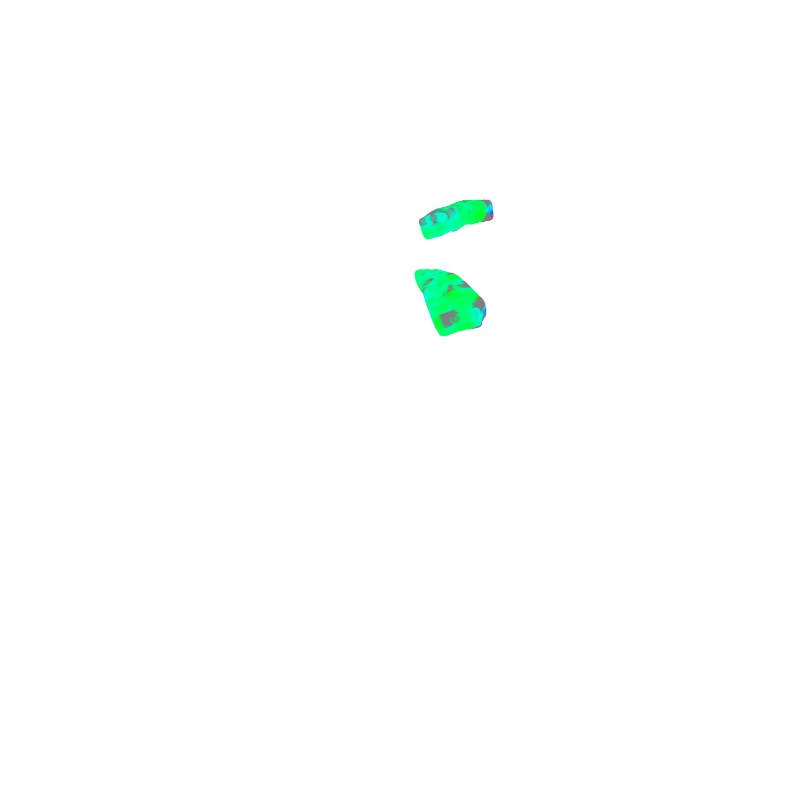

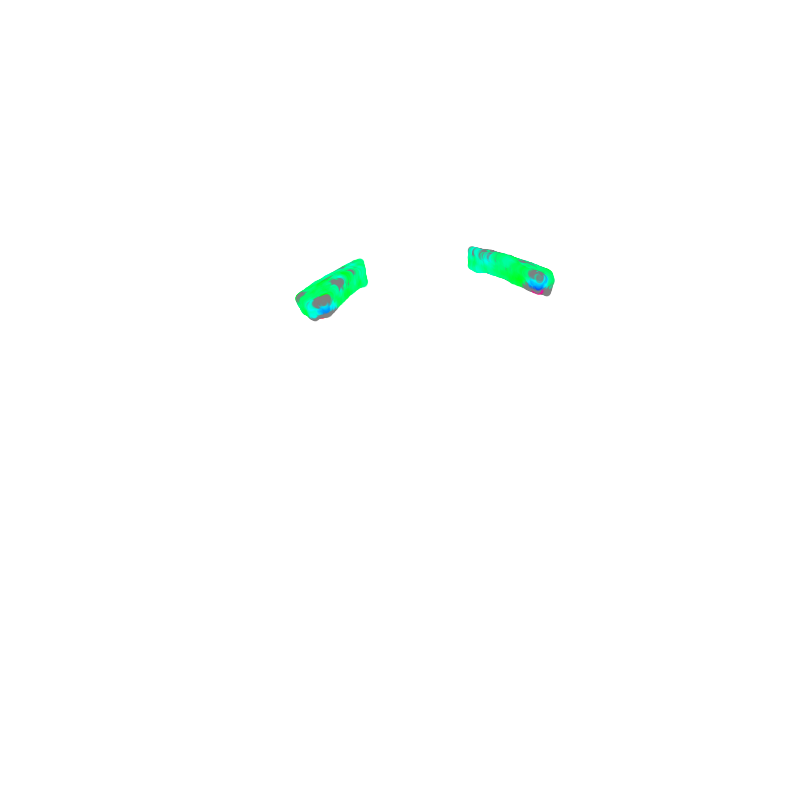

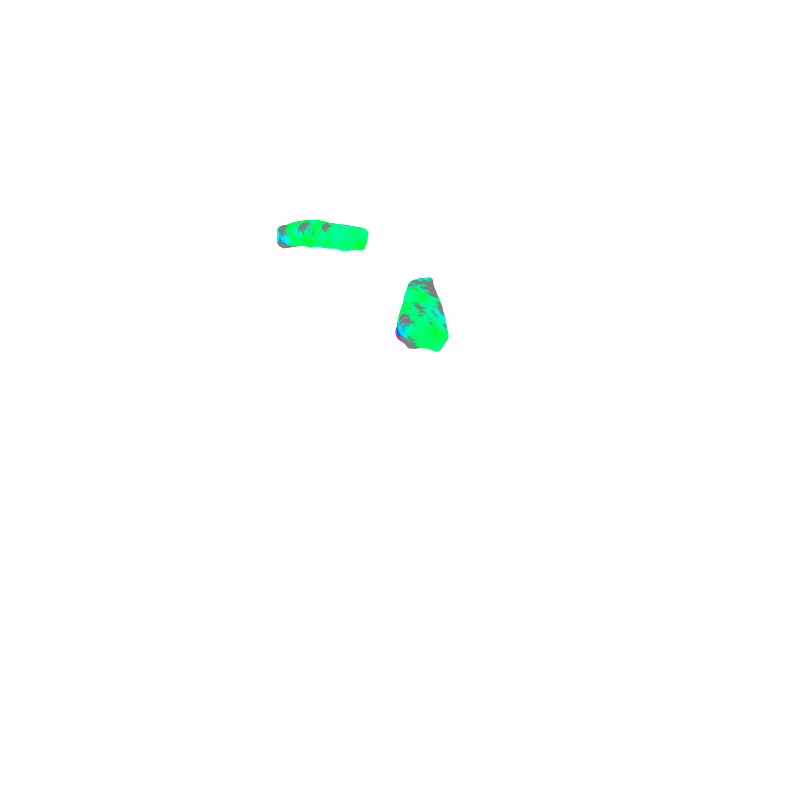

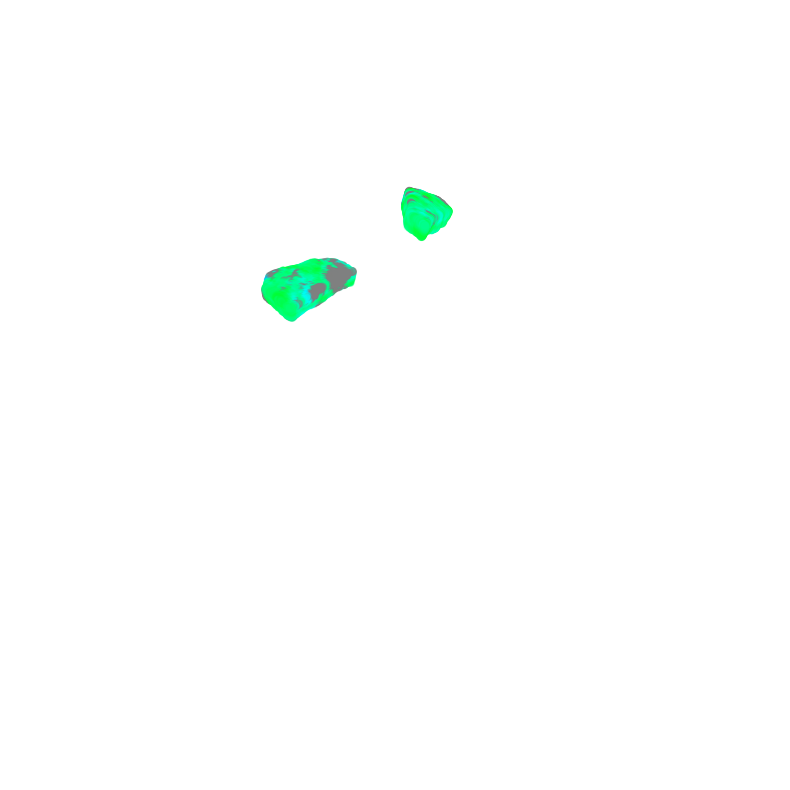

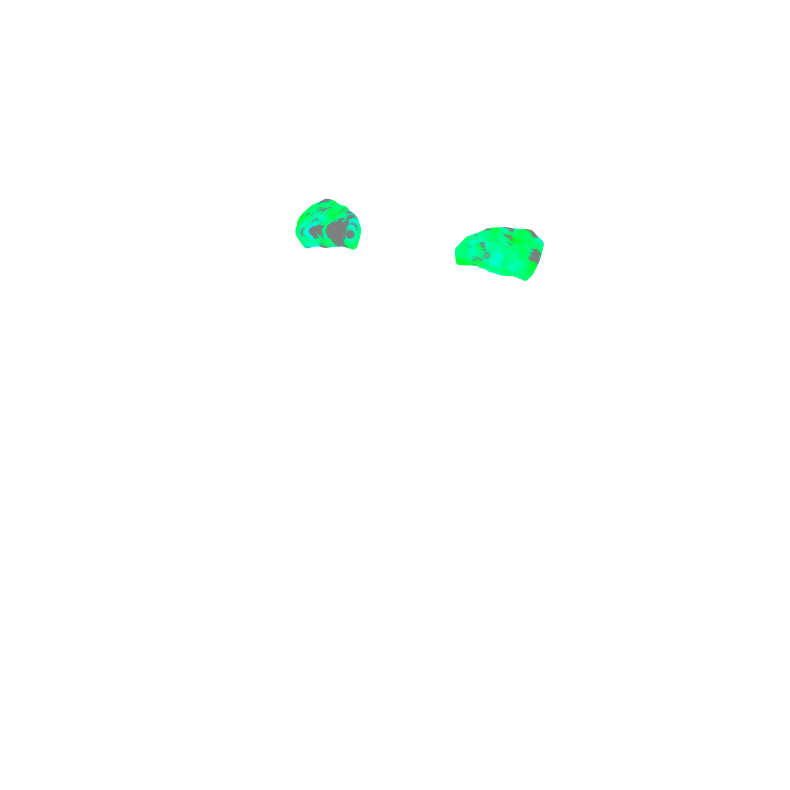

31558 VISa4
31562 VISa5
31566 VISa6a
31570 VISa6b
417 VISrl
31604 VISrl1
31608 VISrl2/3


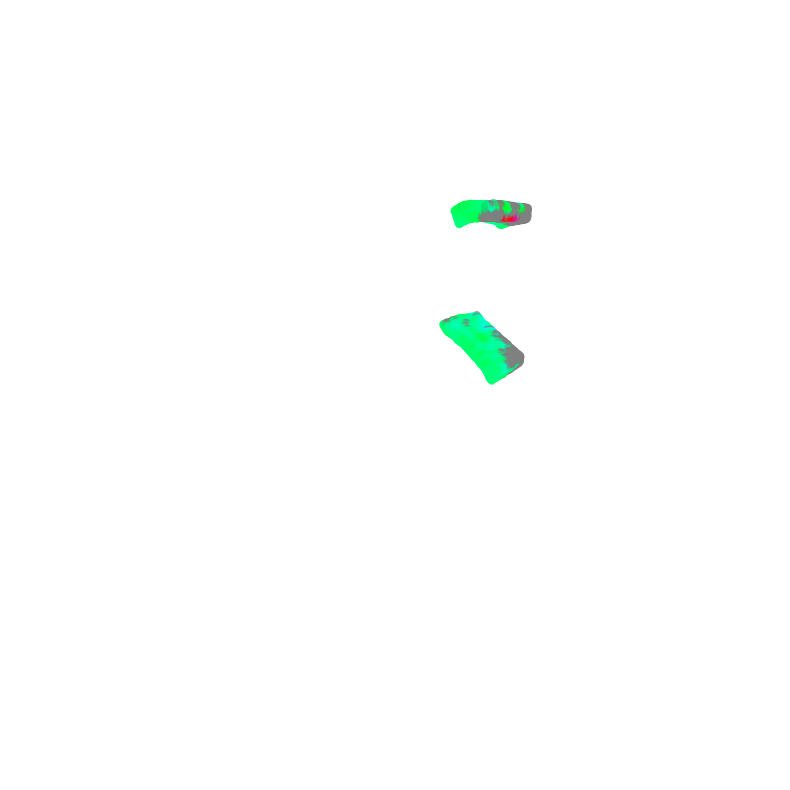

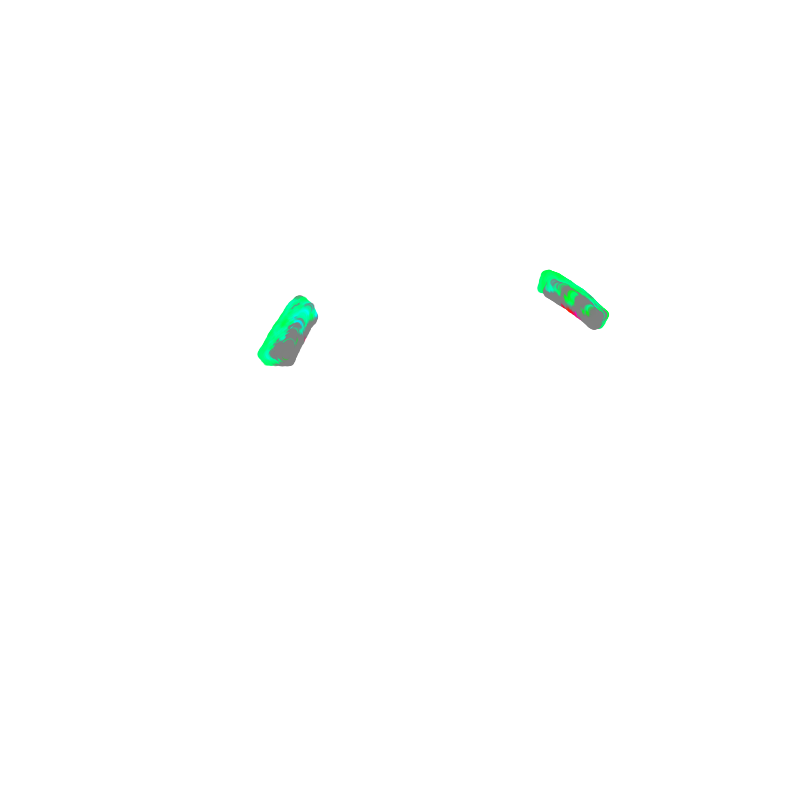

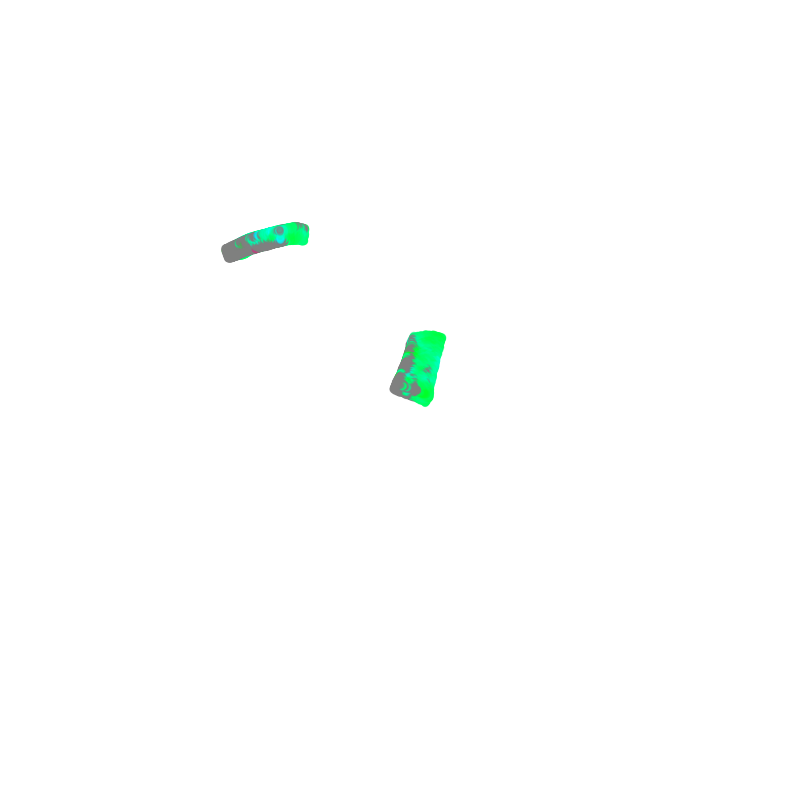

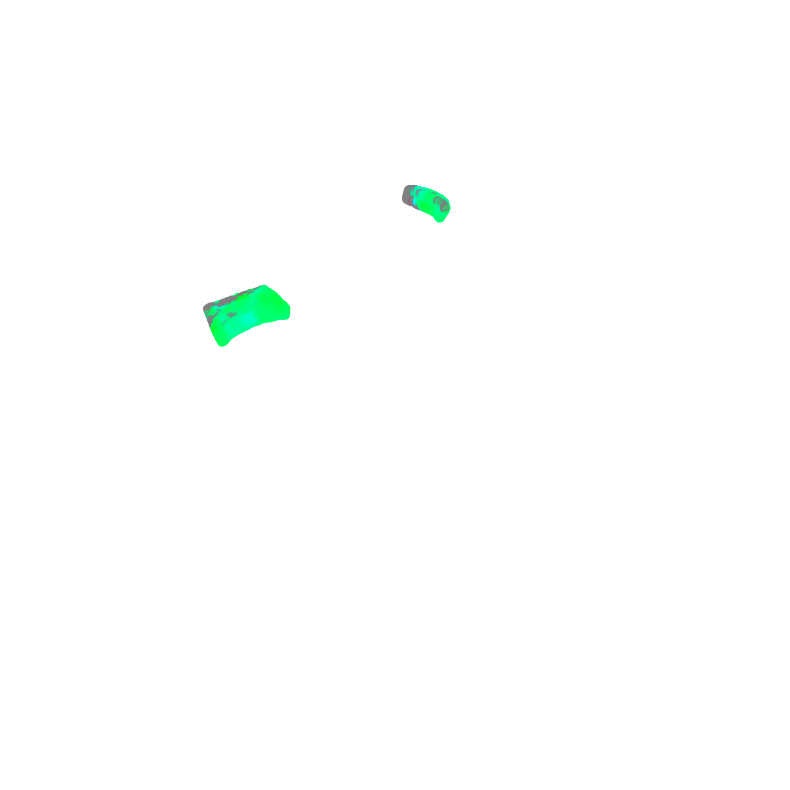

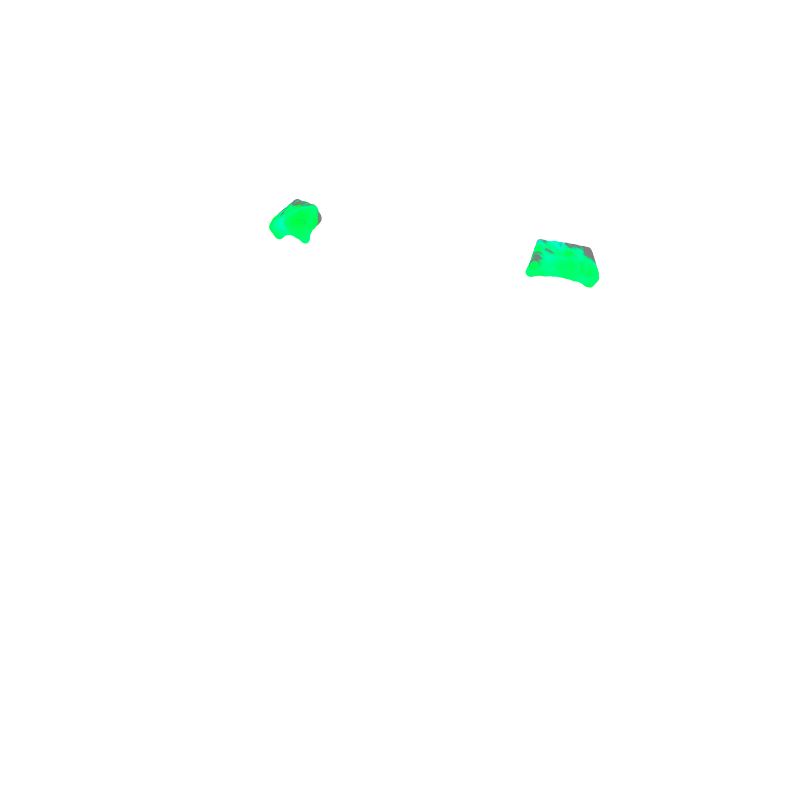

31612 VISrl4
31616 VISrl5
31620 VISrl6a
31624 VISrl6b
541 TEa
97 TEa1
1127 TEa2/3


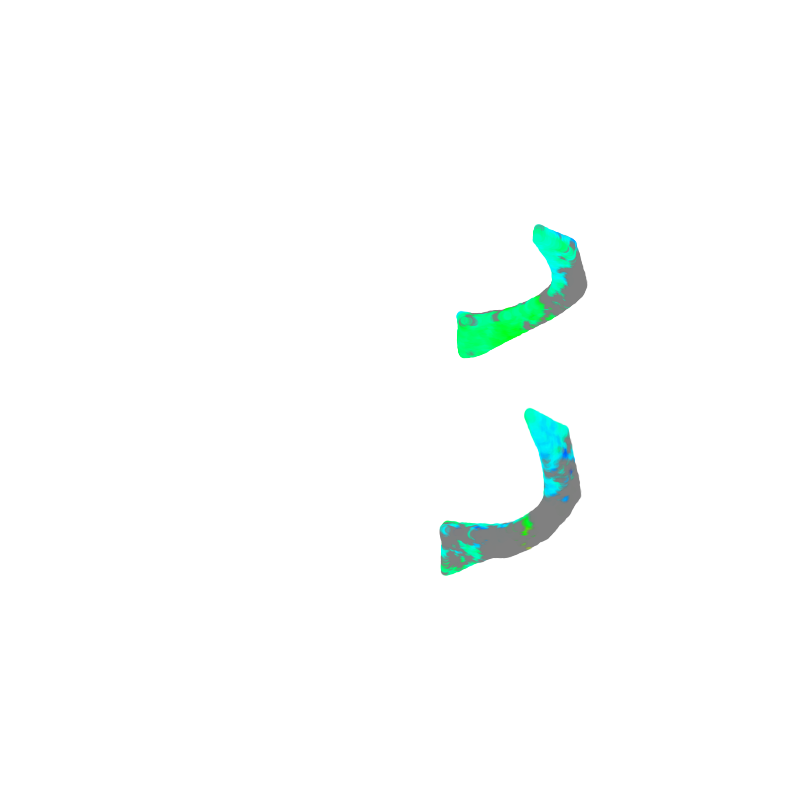

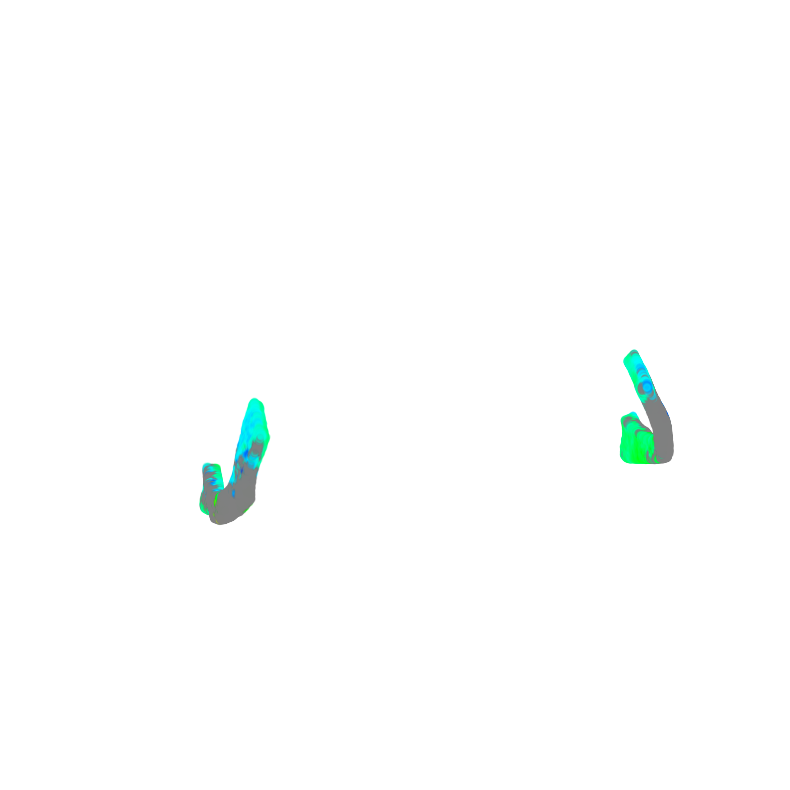

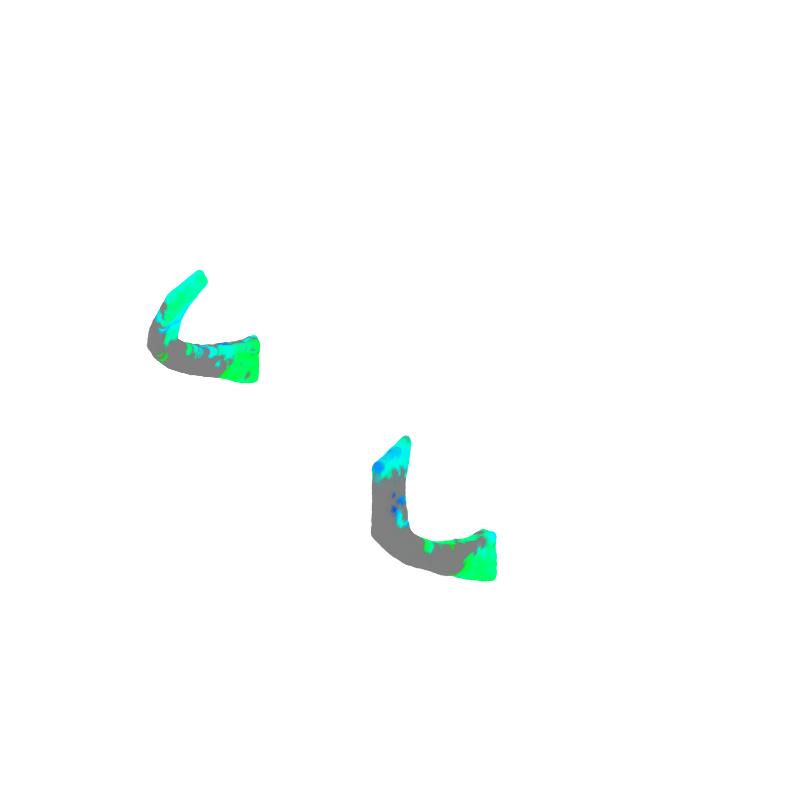

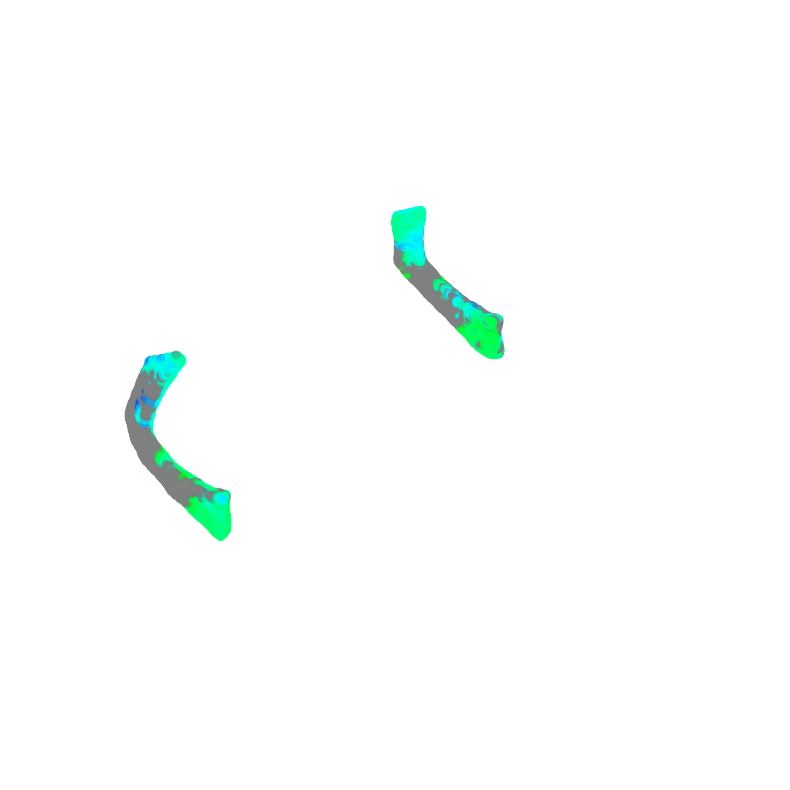

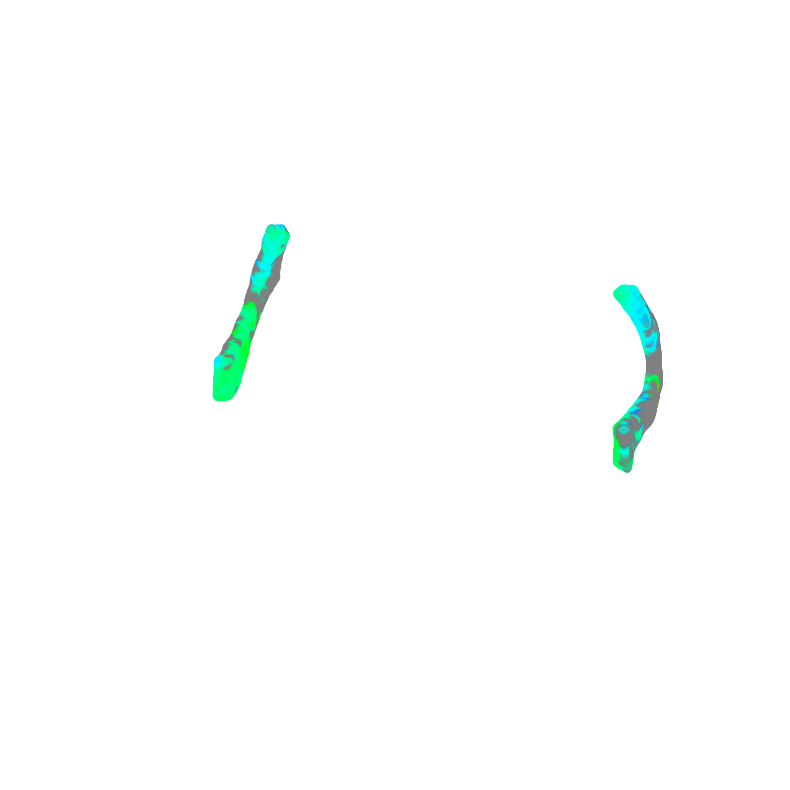

234 TEa4
289 TEa5
729 TEa6a
786 TEa6b
922 PERI
335 PERI6a
368 PERI6b
540 PERI1
692 PERI5
888 PERI2/3


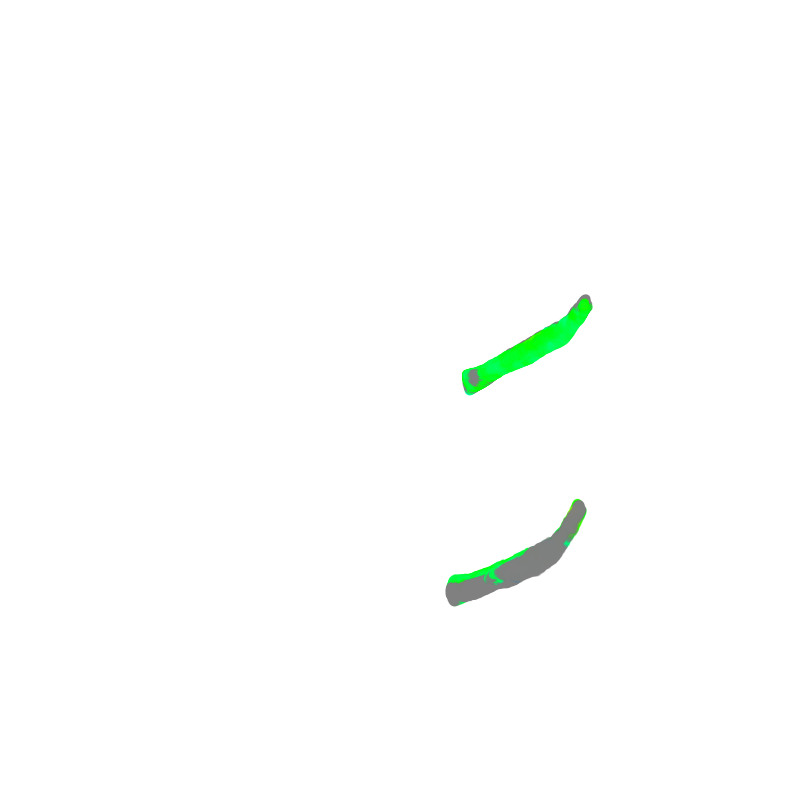

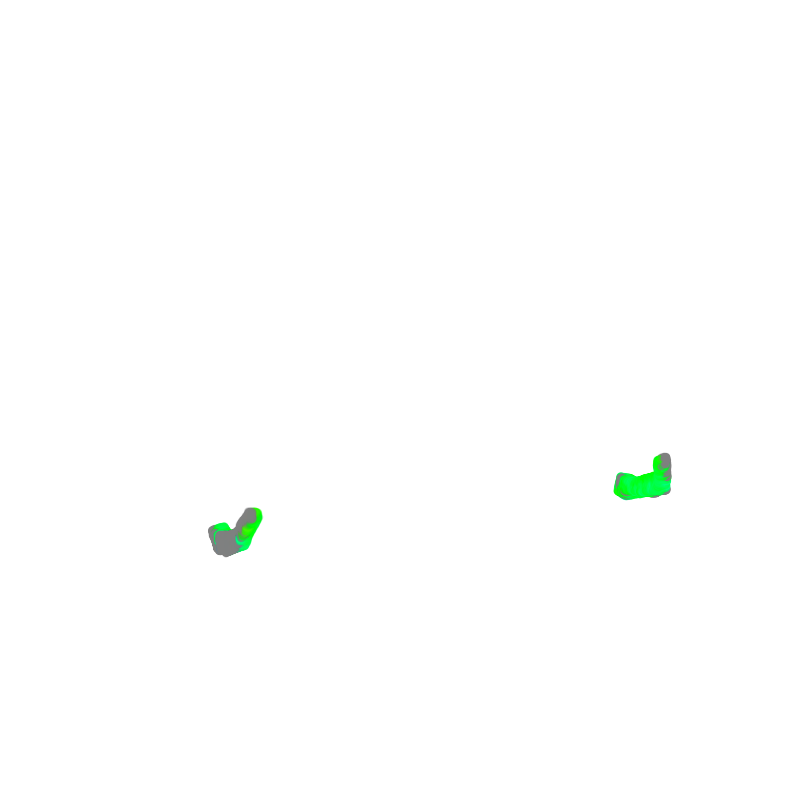

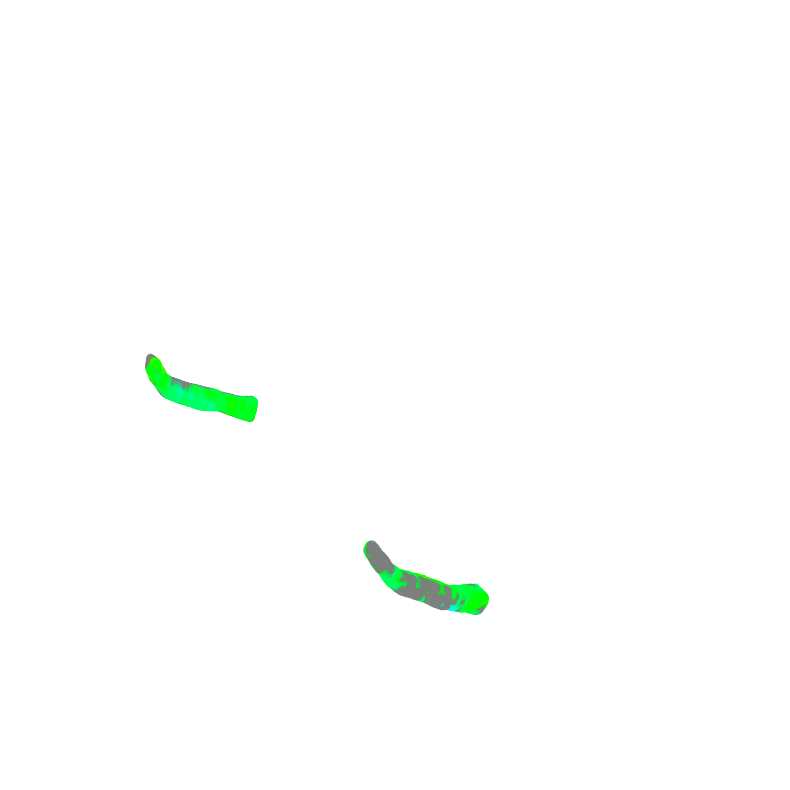

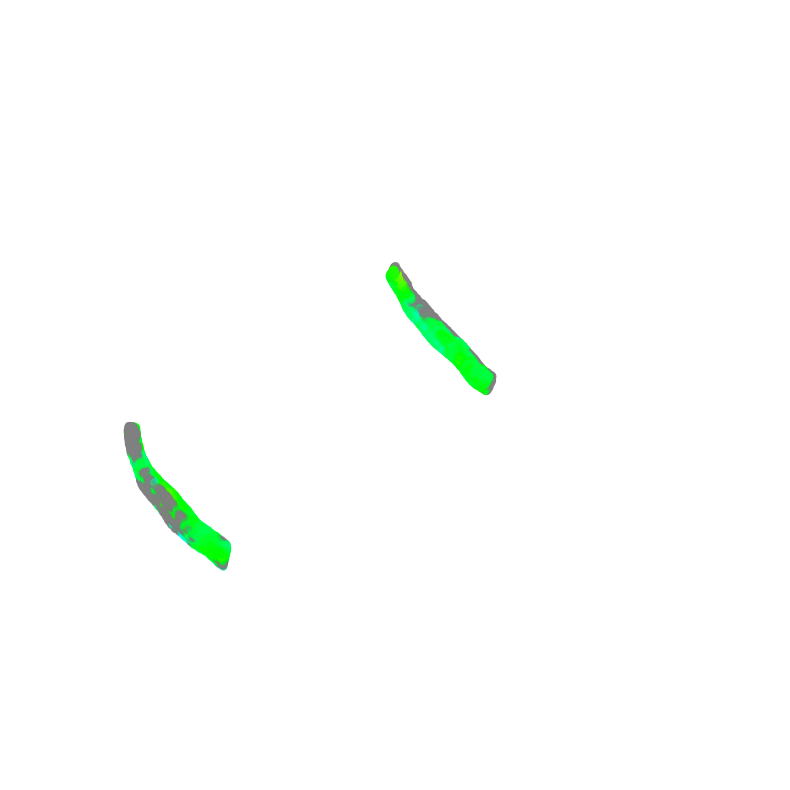

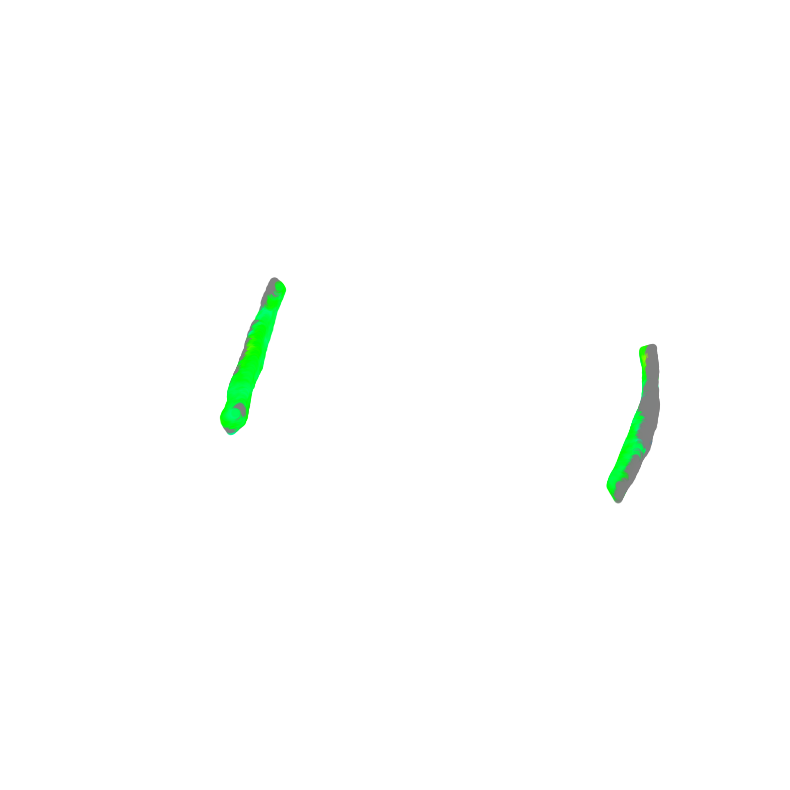

895 ECT
836 ECT1
427 ECT2/3


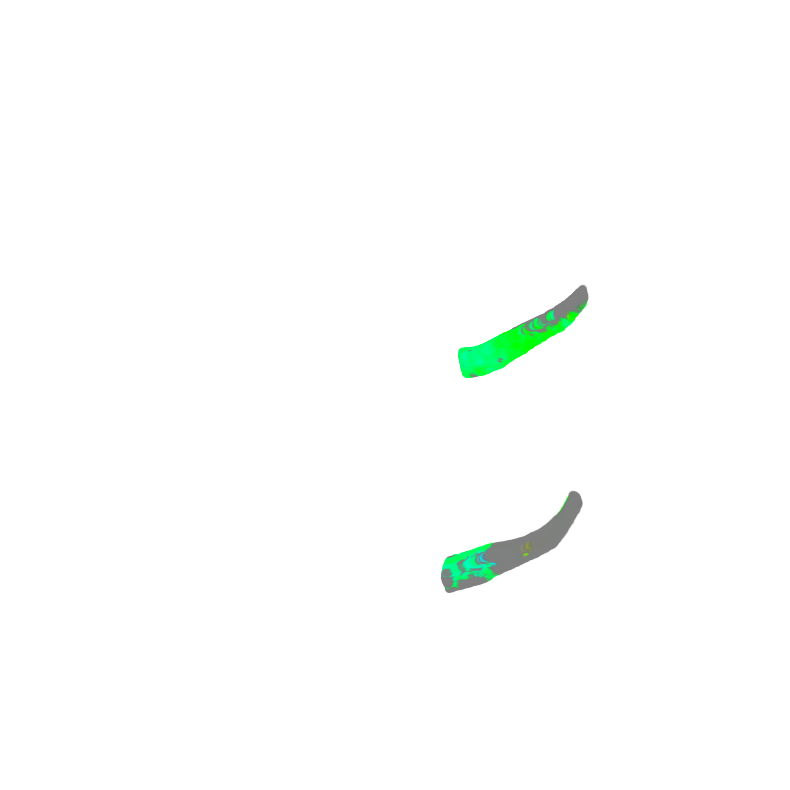

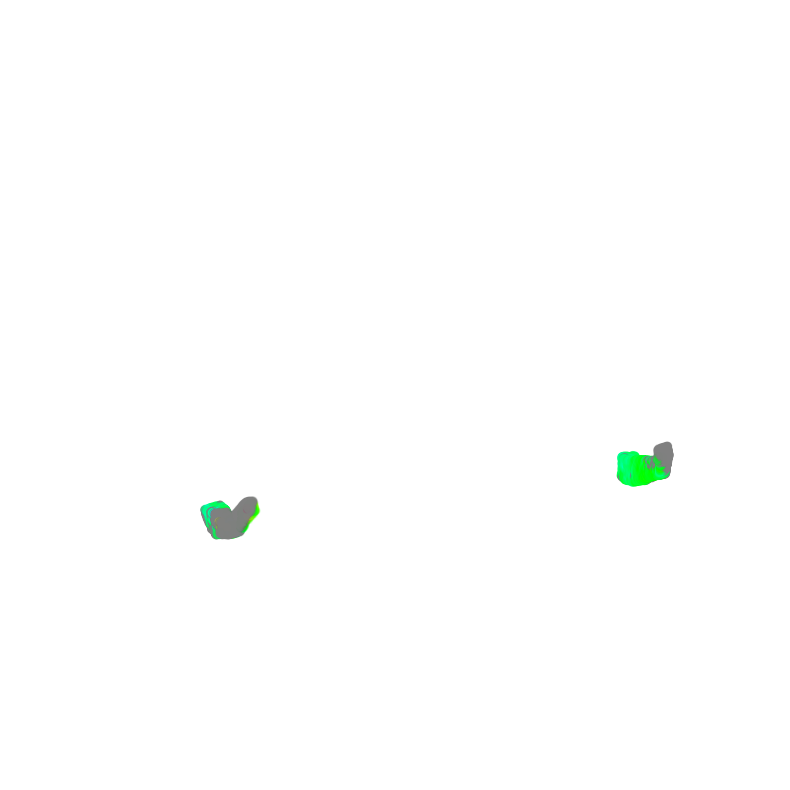

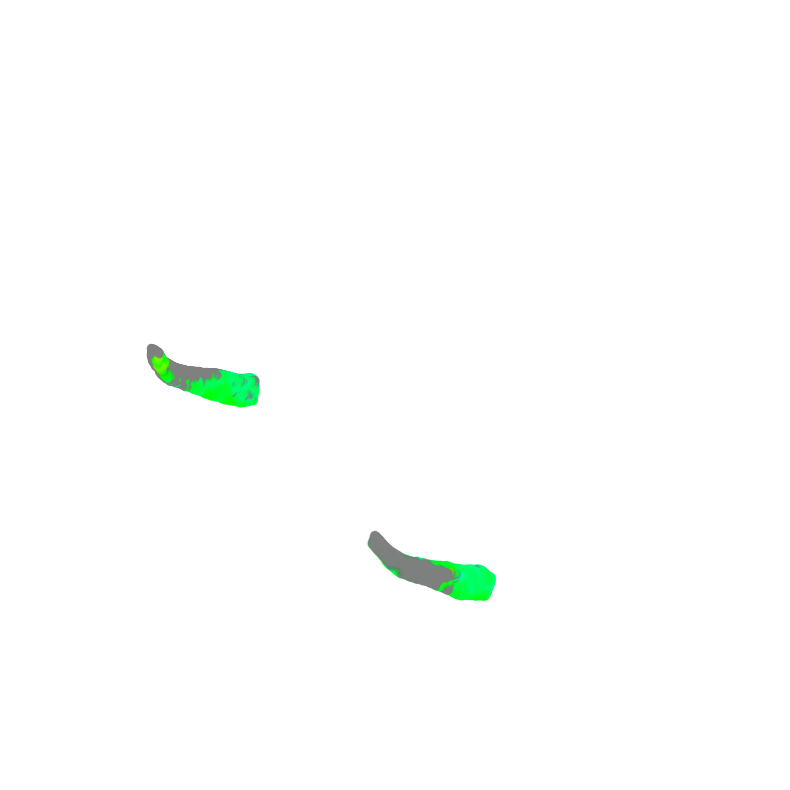

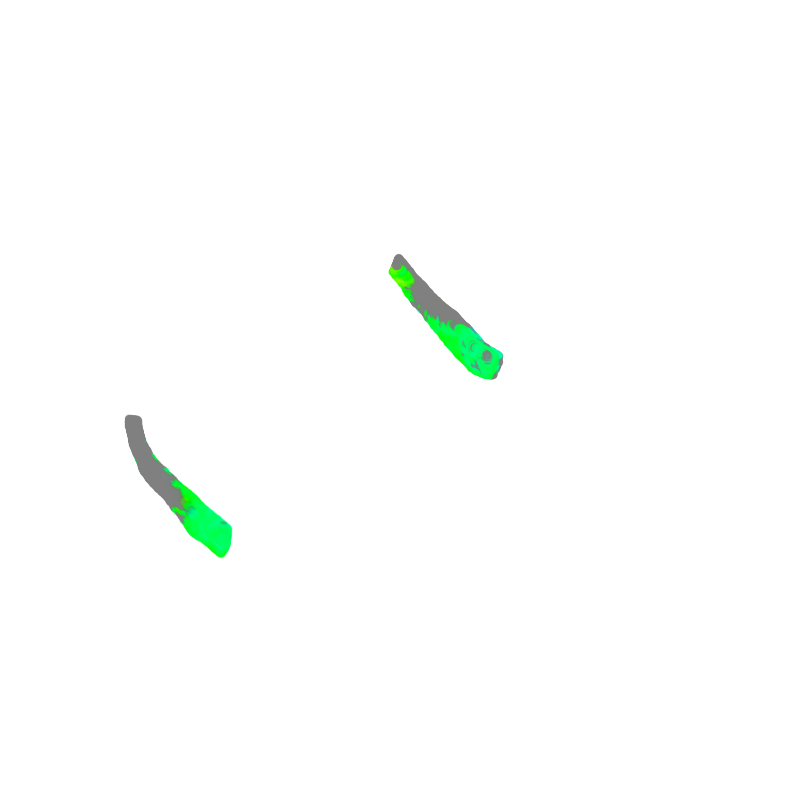

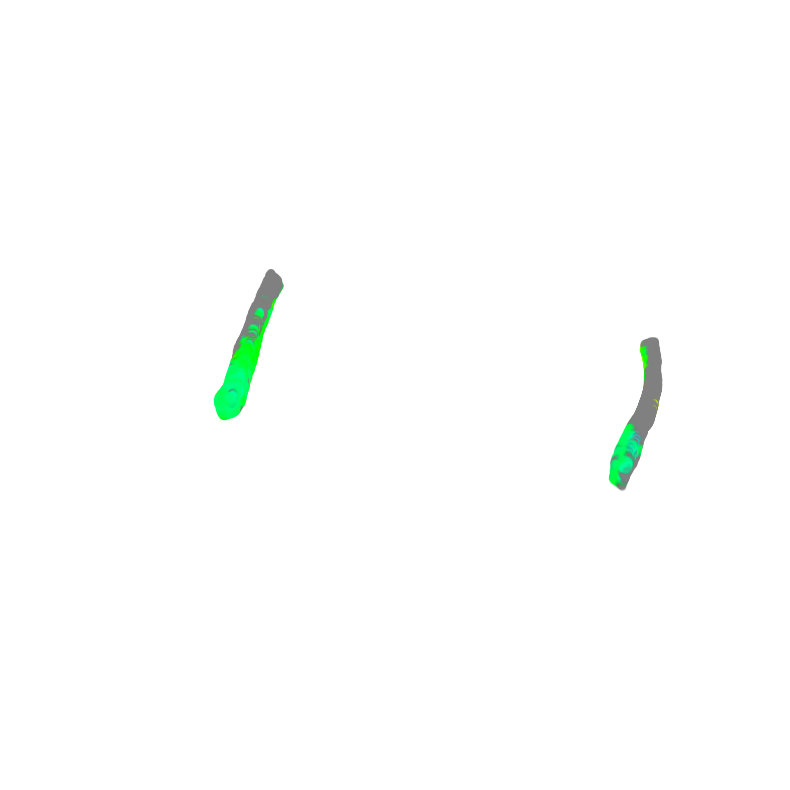

988 ECT5
977 ECT6a
1045 ECT6b
698 OLF
507 MOB
151 AOB
188 AOBgl
196 AOBgr
204 AOBmi
159 AON
589 TT
597 TTd
605 TTv
814 DP
961 PIR
619 NLOT
260 NLOT1
268 NLOT2
1139 NLOT3
631 COA
639 COAa
647 COAp
655 COApl
663 COApm
788 PAA
566 TR
1089 HPF
1080 HIP
375 CA
382 CA1
423 CA2
463 CA3
726 DG
10703 DG-mo
10704 DG-po
632 DG-sg
982 FC
19 IG
822 RHP
909 ENT
918 ENTl
1121 ENTl1
20 ENTl2
52 ENTl3
139 ENTl5
28 ENTl6a
926 ENTm
526 ENTm1
543 ENTm2
664 ENTm3
727 ENTm5
743 ENTm6
843 PAR
1037 POST
1084 PRE
502 SUB
48470 ProS
58447 HATA
48508 APr
703 CTXsp
583 CLA
942 EP
952 EPd
966 EPv
131 LA
295 BLA
303 BLAa
311 BLAp
451 BLAv
319 BMA
327 BMAa
334 BMAp
780 PA
623 CNU
477 STR
672 CP
493 STRv
56 ACB
998 FS
754 OT
275 LSX
242 LS
250 LSc
258 LSr
266 LSv
310 SF
333 SH
278 sAMY
23 AAA
292 BA
536 CEA
544 CEAc
551 CEAl
559 CEAm
1105 IA
403 MEA
803 PAL
818 PALd
1022 GPe
1031 GPi
835 PALv
342 SI
298 MA
826 PALm
904 MSC
564 MS
596 NDB
581 TRS
809 PALc
351 BST
287 BAC
343 BS
1129 IB
549 TH
864 DORsm
637 VENT
629 VA

In [16]:
#rotation phase voxel level  

#phase -> png rotation movie
fig_dir = savedir + "figures_movie/"
region_IDs = uni_IDs[5:] #[194, 56, 689,  170, 749, 830]#

phase_li = np.arange(0,24, 4)
num_frames = 6


vx=20
vx2 = 20
rx=vx/vx2
r = 5

angles  = ["hor"]#, "cor", "sag"]
elev = 30

# child_IDs_o, child_regions_o, middle_IDs_o, middle_regions_o = ca.get_child_IDs2(1089)
brain_ind = np.where(np.ravel(np.swapaxes(atlas_mask, 0, 2))==1)[0]
brain_ind = ca.voxel_ID_order_all[brain_ind]

for i, rID in enumerate(region_IDs):
#     print(rID, middle_regions_o[i])
#     name = "{}_vx".format(middle_regions_o[i])
    region = ca.df_allen[ca.df_allen["ID"]==rID]["acronym"].iloc[0]
    print(rID, region)
    
    if "/" in region:
                region = region.replace("/", "_")
    name = "{}_vx".format(region)
    os.makedirs(fig_dir+name, exist_ok=True)
    
    
    if ca.smallID_q(rID):
        
    #     child_IDs, child_regions, middle_IDs, middle_regions = ca.get_child_IDs2(rID)
        index =[]
    #     for rID in child_IDs+middle_IDs:

        index += np.where(brain_ind==rID)[0].tolist()  #get indexes having region ID 
#         cos_v_df2 = cos_v_df.iloc[index]
    else:
        child_IDs, child_regions, middle_IDs, middle_regions = ca.get_child_IDs2(rID)
        index =[]
        index += np.where(brain_ind==rID)[0].tolist()
        for mID in child_IDs+middle_IDs:

            index += np.where(brain_ind==mID)[0].tolist()  #get indexes having region ID 
    cos_v_df2 = cos_v_df.iloc[index]

    brain_IDs =[315, rID]#,698, 1089, 703, 477, 803, 549, 1097,  313, 771, 354,  512]
   
    xmin, xmax, ymin, ymax, zmin, zmax = mask_range(brain_IDs, vx, 100)
    
    


    x_li = cos_v_df2["X"].tolist()
    y_li = cos_v_df2["Y"].tolist()
    z_li = cos_v_df2["Z"].tolist()
    alphas = cos_v_df2["alpha"].tolist()
    colors= cos_v_df2["color"].tolist()

    if os.path.exists(fig_dir +name+"/phase_rot_{}_{}.png".format(elev, 4)):
        continue

    c=0
    for j, azim in enumerate(np.linspace(0, 360, num_frames)[0:5]):
        if os.path.exists(fig_dir +name+"/phase_rot_{}_{}.png".format(elev, c)):
            c+=1
            continue

        fig = plt.figure(figsize=(10, 10))
        ax = fig.add_subplot(111, projection='3d')

        ax.view_init(elev, azim)
        ax.scatter(x_li, y_li, z_li, color = colors, alpha = alphas)



        ax.set_xlim(xmin*vx/vx2, xmax*vx/vx2)

        ax.set_ylim(ymin*vx/vx2, ymax*vx/vx2)
        ax.set_zlim(zmin*vx/vx2, zmax*vx/vx2)


        ax.set_zlim(ax.get_zlim()[::-1])
        ax.axis("off")

        input_path = fig_dir +name+"/phase_rot_{}_{}.png".format(elev, c)
        input_path_SVG = fig_dir +name+"/phase_rot_{}_{}.SVG".format(elev, c)
    #         output_path =fig_dir + "phase_small_rot_{}_{}_{}_tri.png".format(ph, elev, azim)
        
        fig.savefig(input_path)
        fig.savefig(input_path_SVG)
        
        
        c+=1

    #


        plt.show()

286 SCH


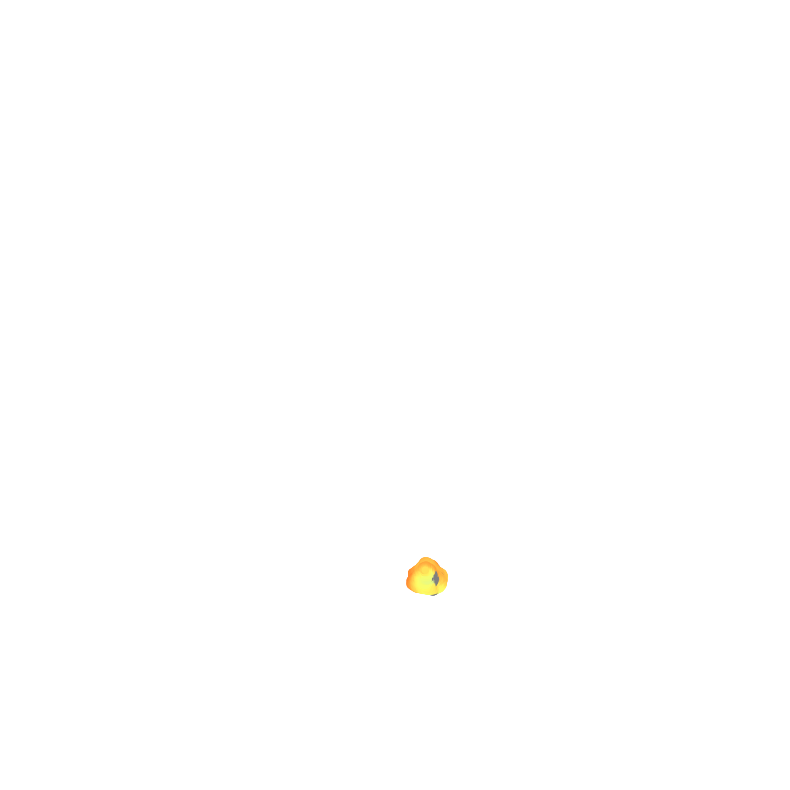

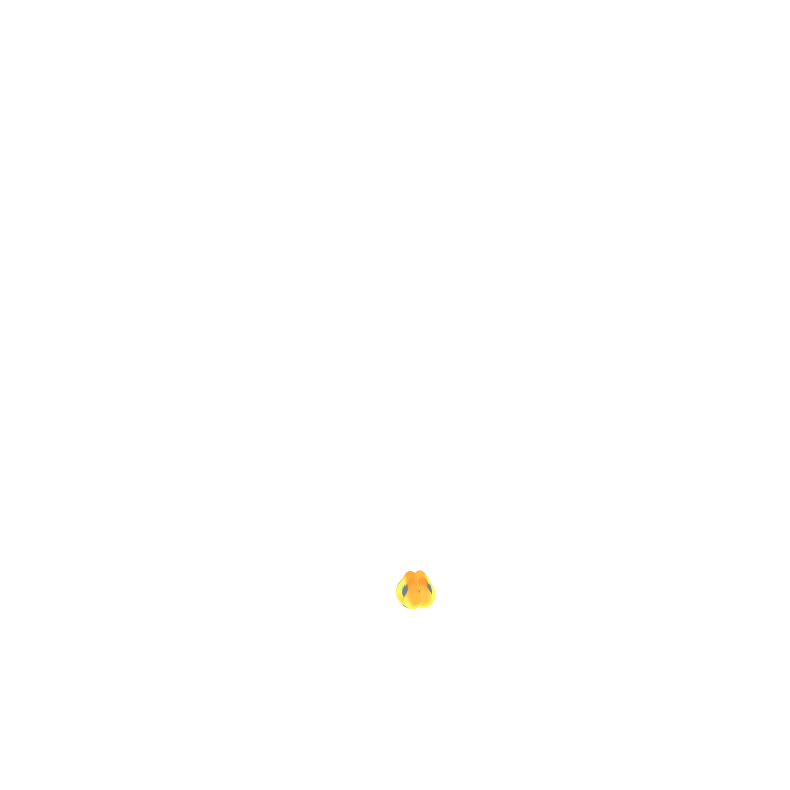

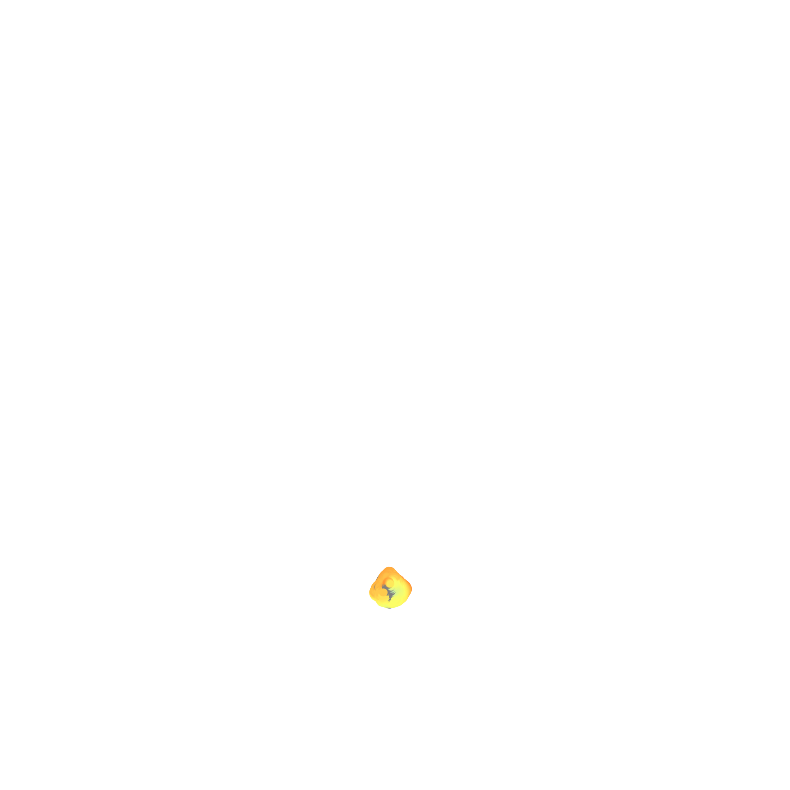

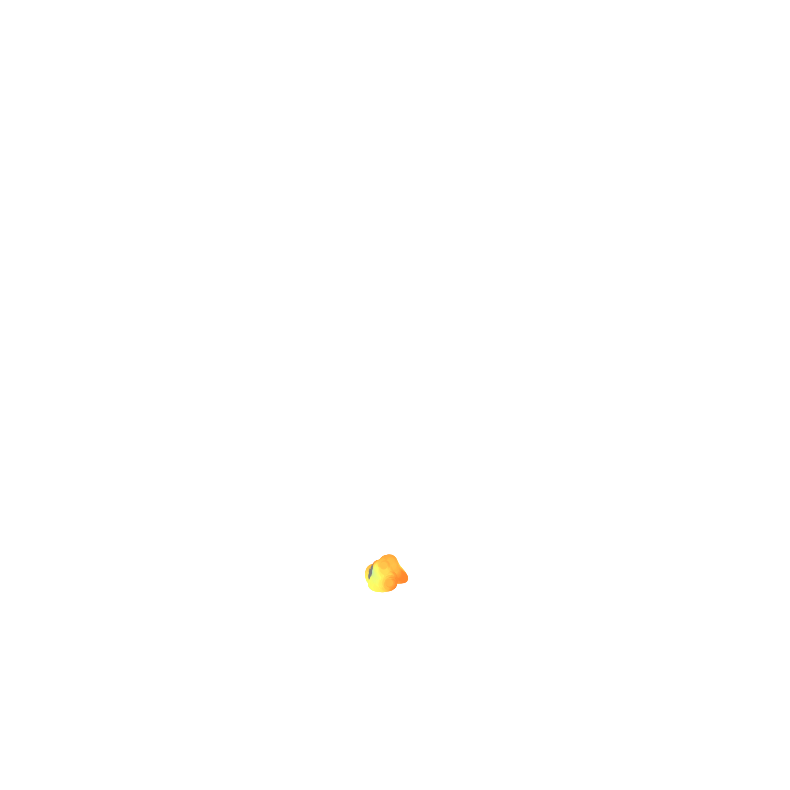

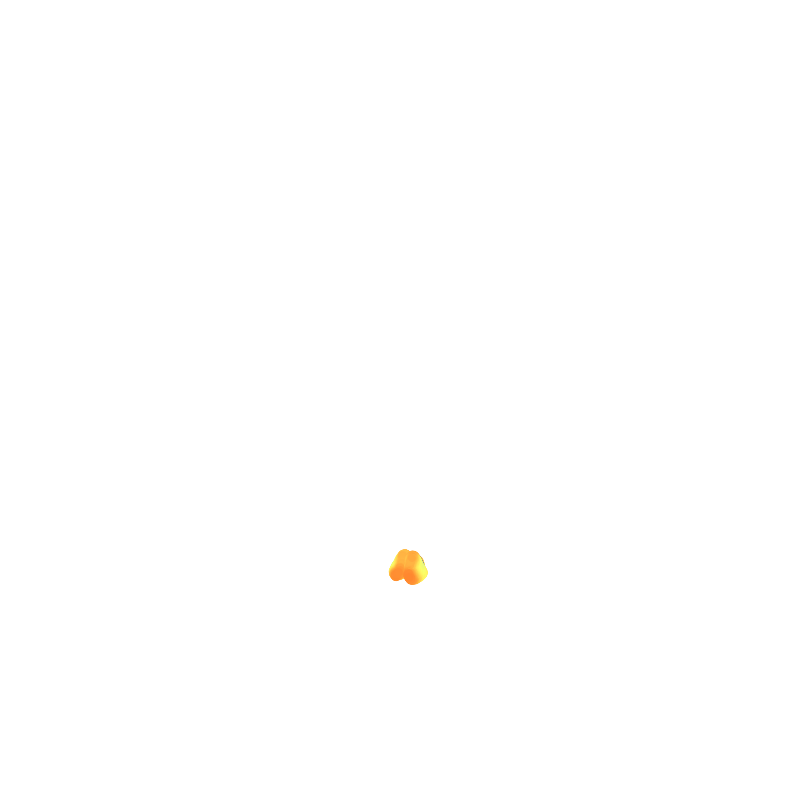

382 CA1


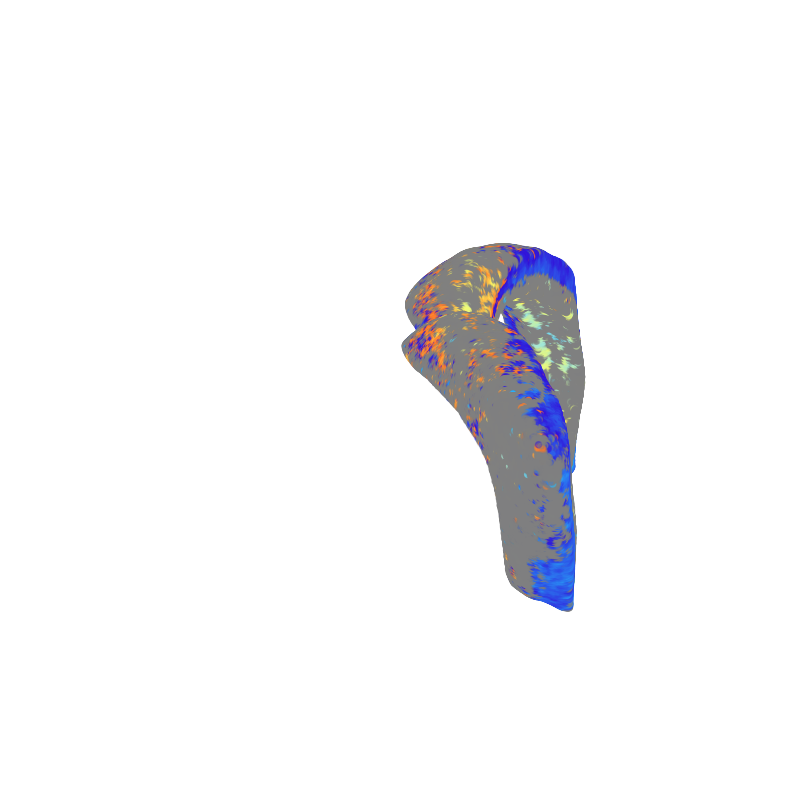

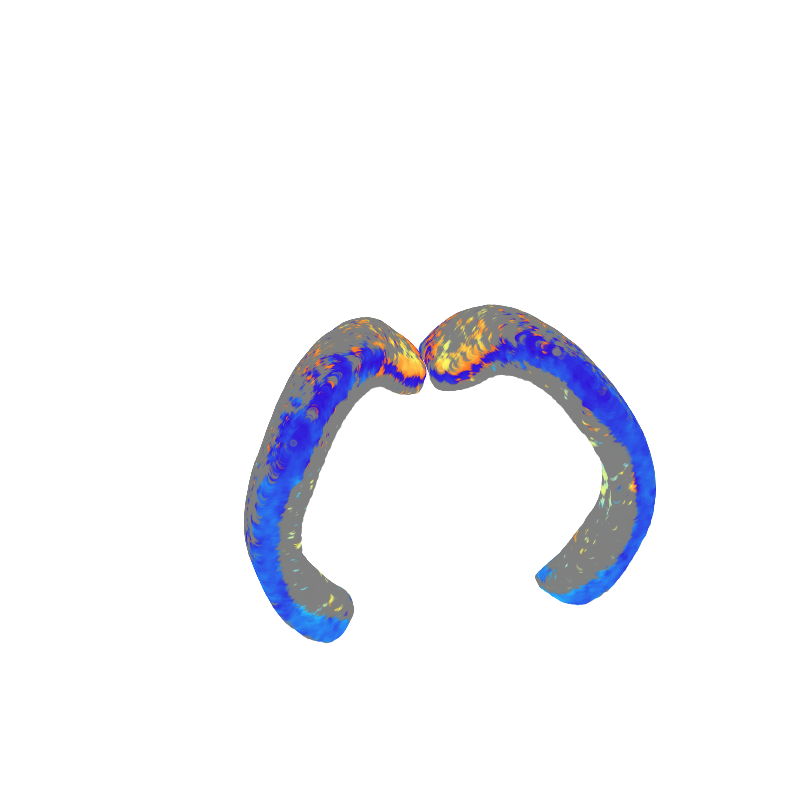

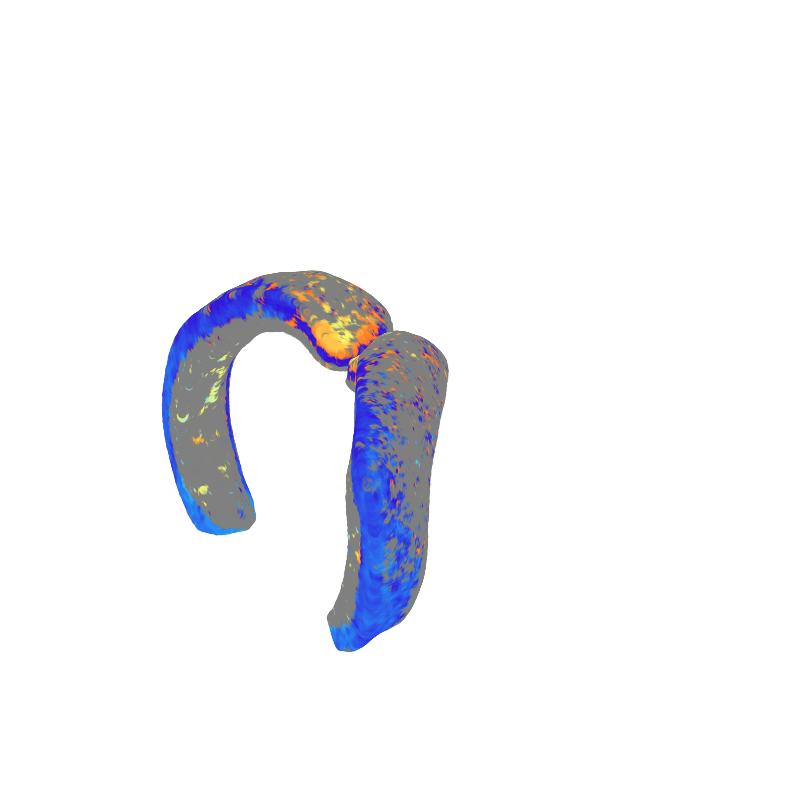

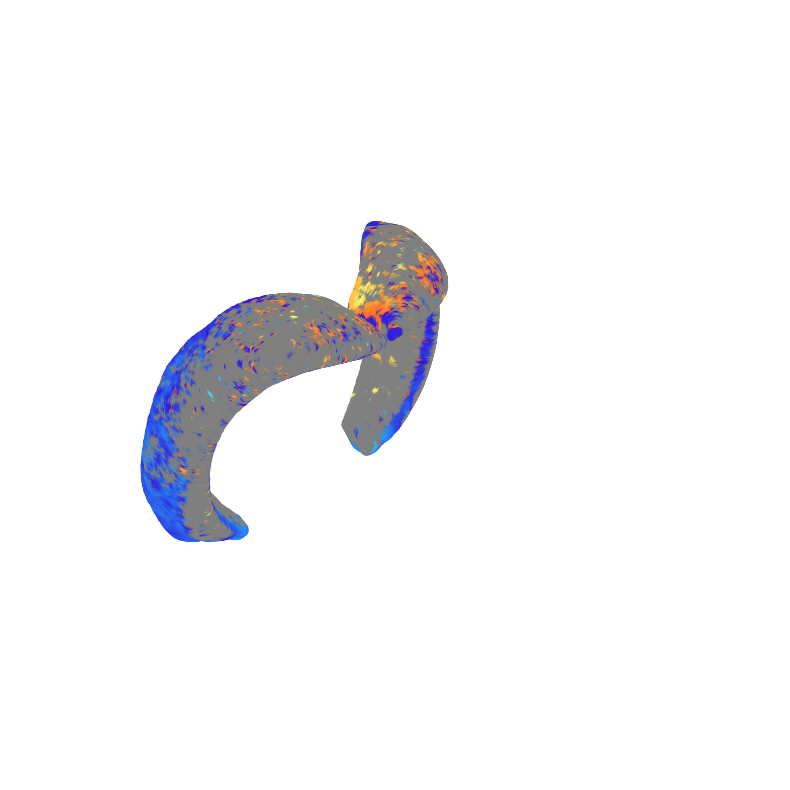

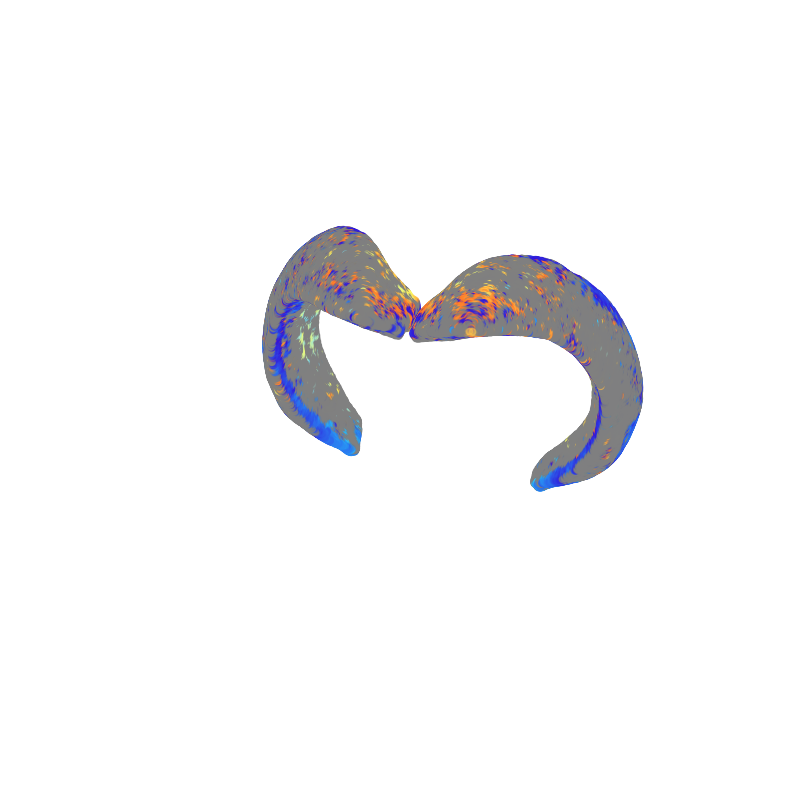

909 ENT


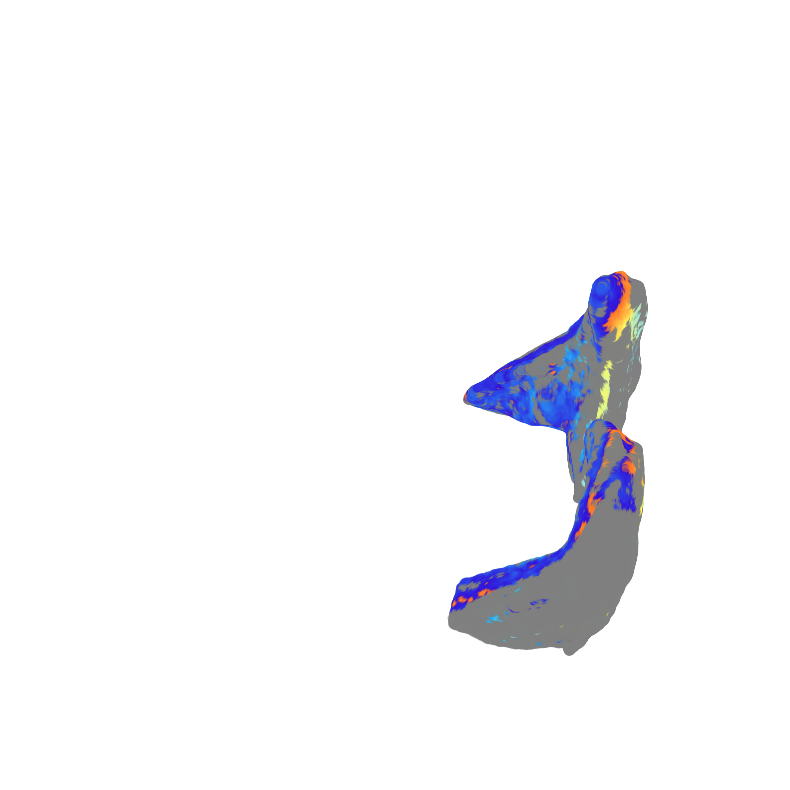

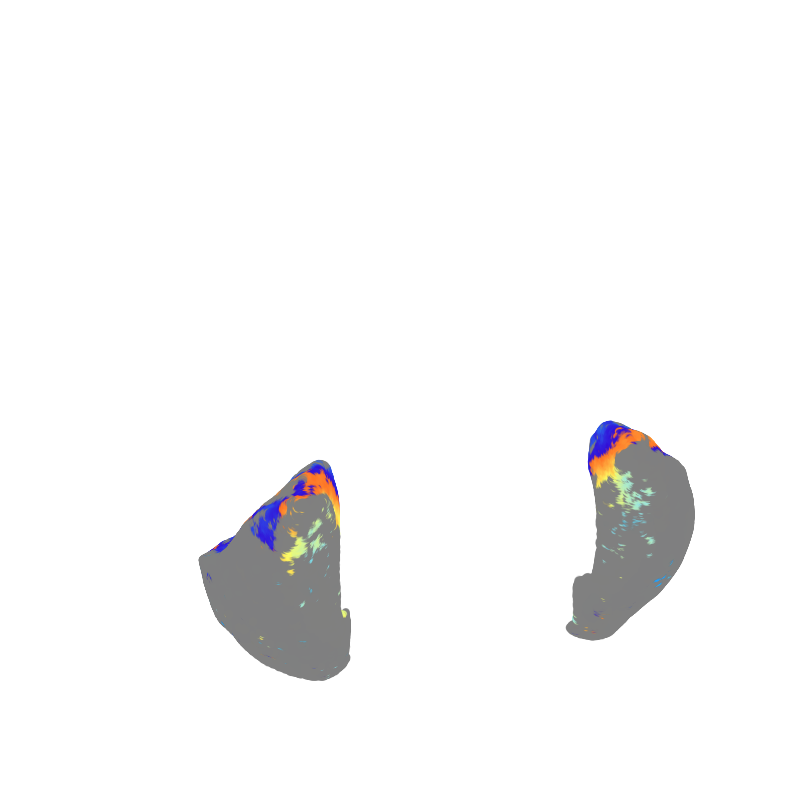

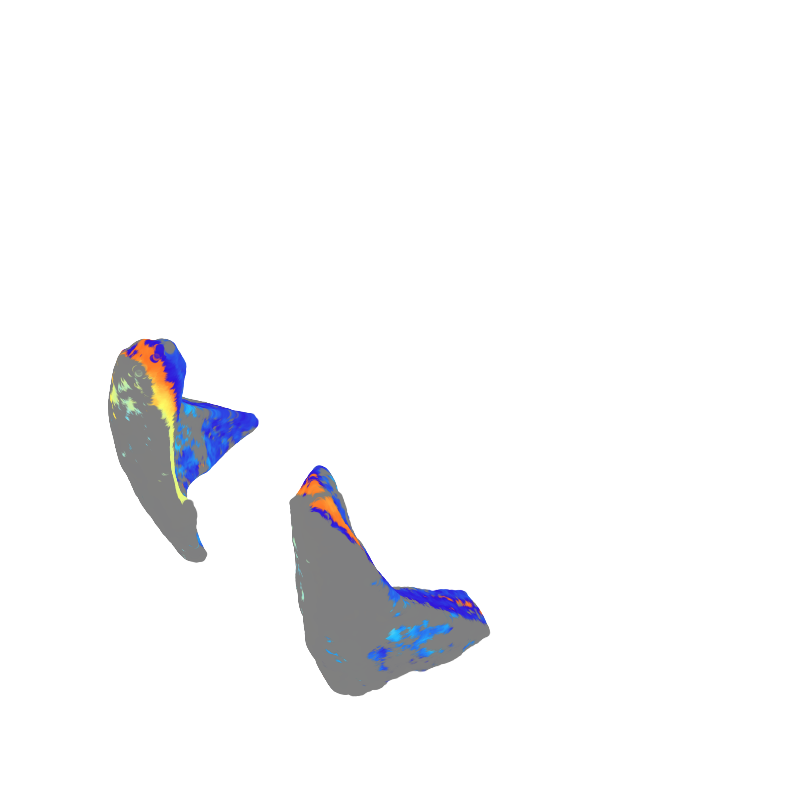

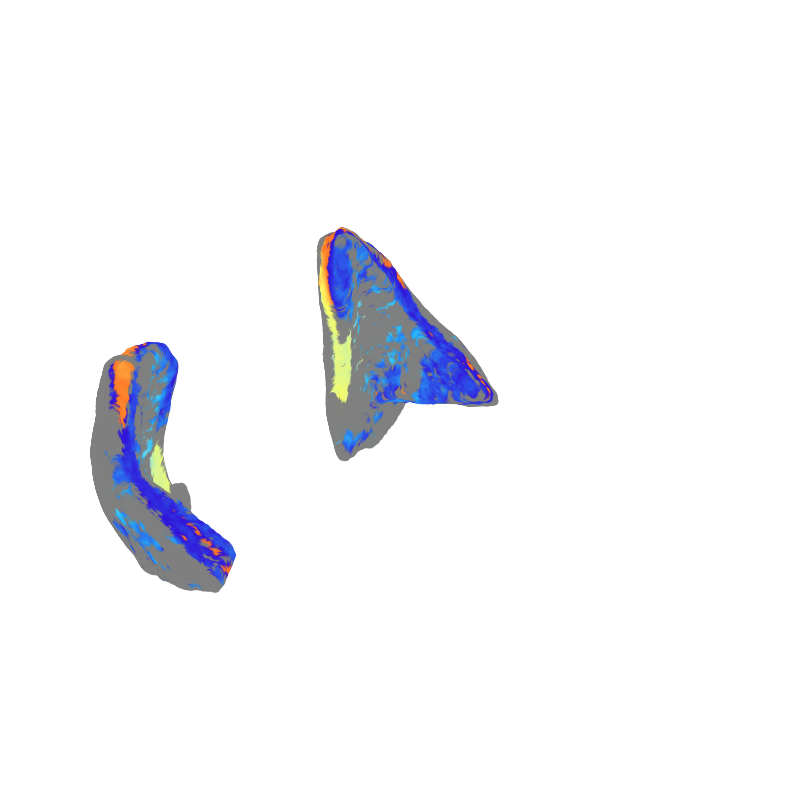

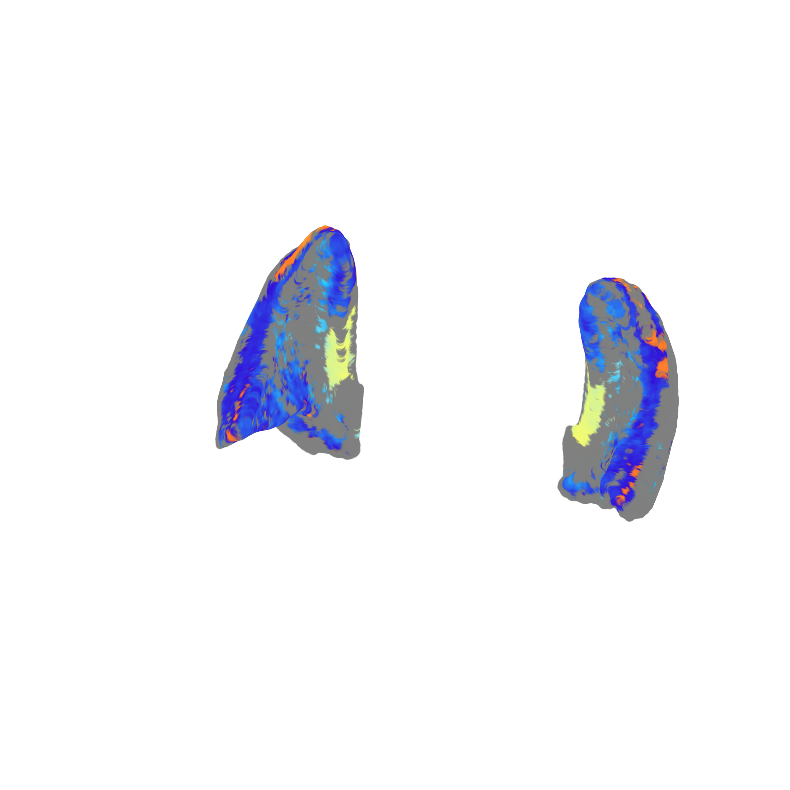

830 DMH


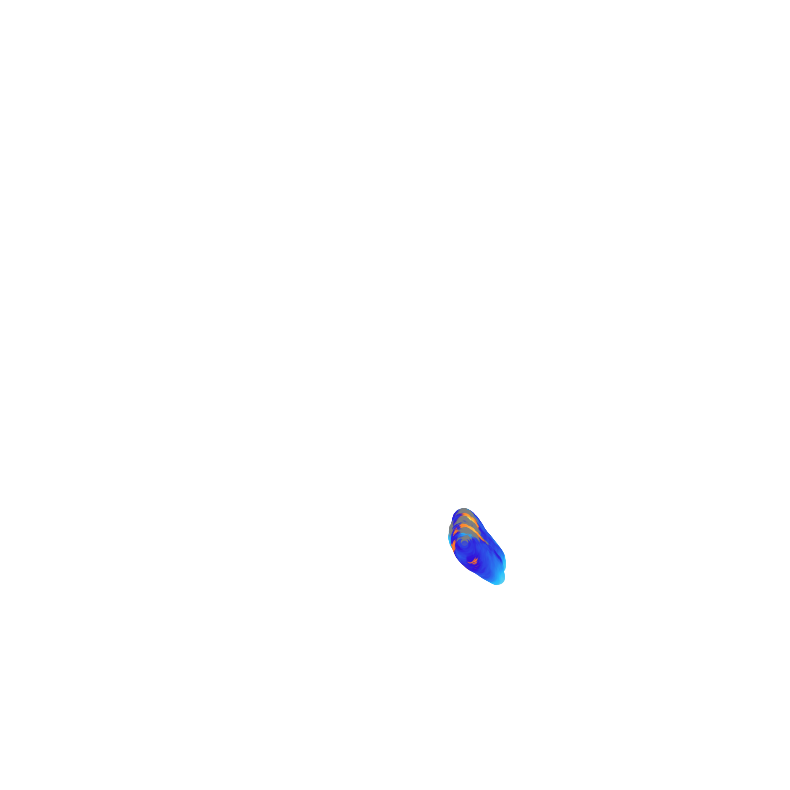

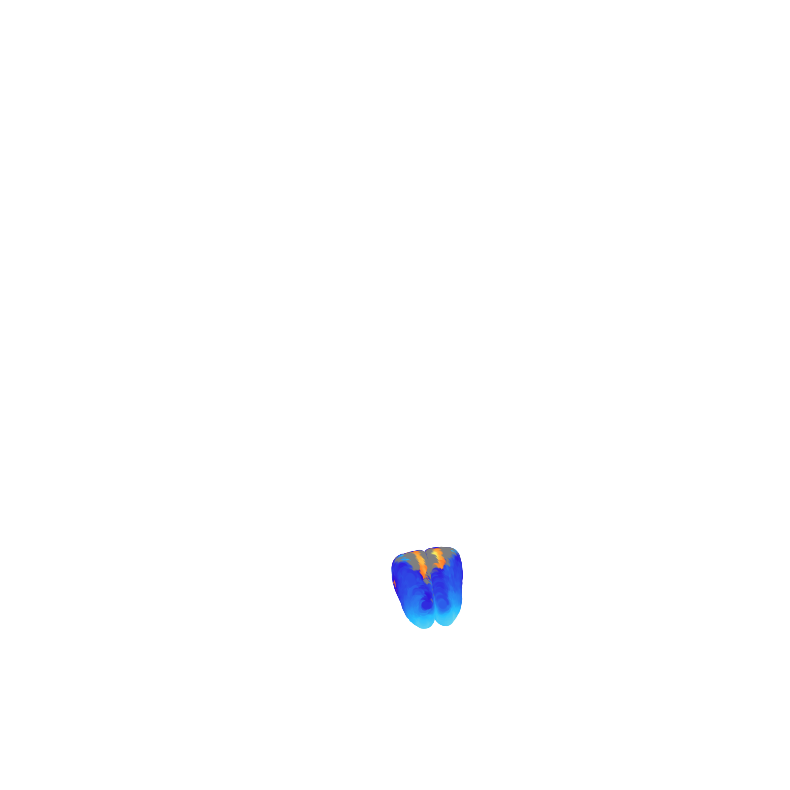

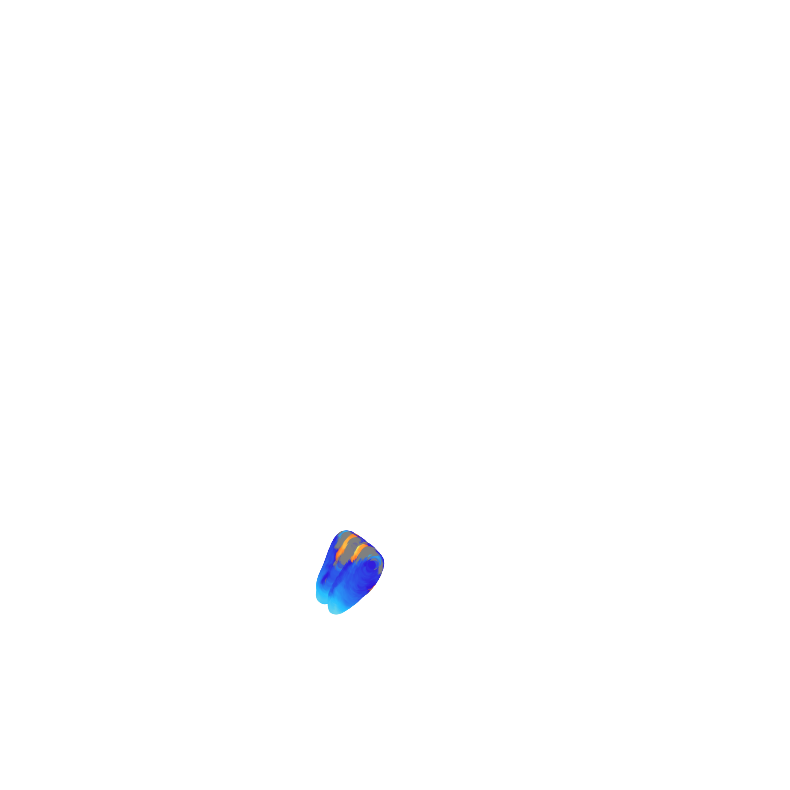

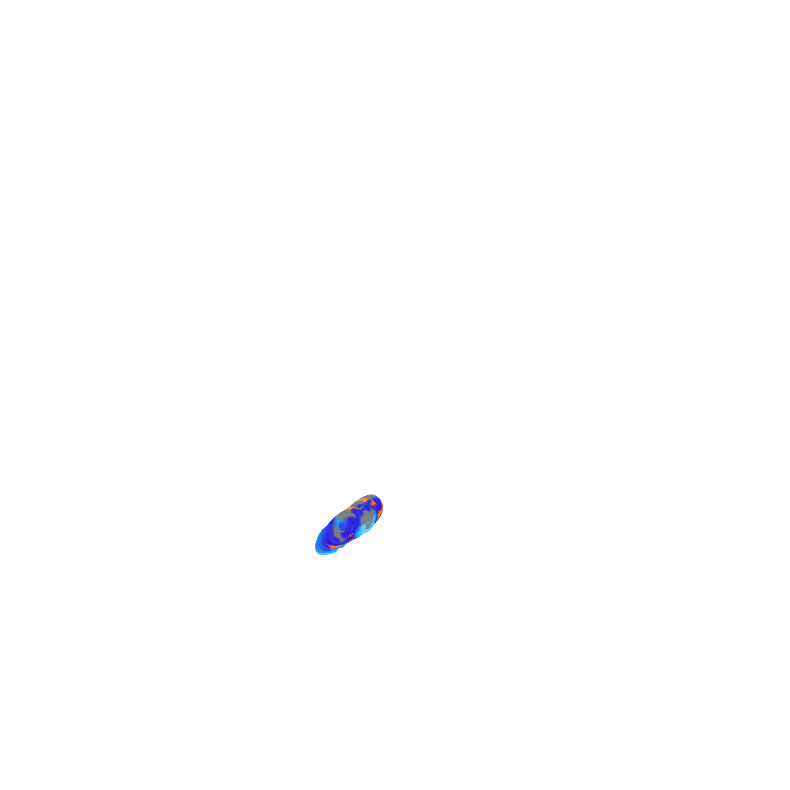

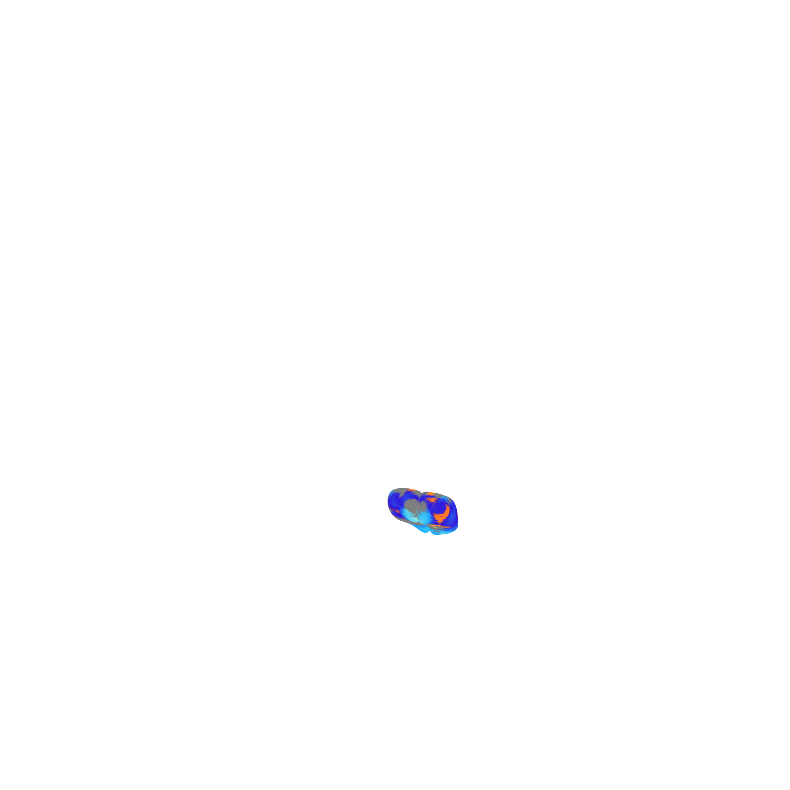

In [22]:
#rotation phase voxel level  by regions for blindness

#phase -> png rotation movie
bc_fol = savedir + "/blindness/"
fig_dir = bc_fol + "figures_movie/"
os.makedirs(fig_dir, exist_ok=True)
region_IDs = [286, 382, 909, 830] #uni_IDs[5:] #[194, 56, 689,  170, 749, 830]#

phase_li = np.arange(0,24, 4)
num_frames = 6


vx=20
vx2 = 20
rx=vx/vx2
r = 5

angles  = ["hor"]#, "cor", "sag"]
elev = 30

# child_IDs_o, child_regions_o, middle_IDs_o, middle_regions_o = ca.get_child_IDs2(1089)
brain_ind = np.where(np.ravel(np.swapaxes(atlas_mask, 0, 2))==1)[0]
brain_ind = ca.voxel_ID_order_all[brain_ind]

for i, rID in enumerate(region_IDs):
#     print(rID, middle_regions_o[i])
#     name = "{}_vx".format(middle_regions_o[i])
    region = ca.df_allen[ca.df_allen["ID"]==rID]["acronym"].iloc[0]
    print(rID, region)
    
    if "/" in region:
                region = region.replace("/", "_")
    name = "{}_vx".format(region)
    os.makedirs(fig_dir+name, exist_ok=True)
    
    
    if ca.smallID_q(rID):
        
    #     child_IDs, child_regions, middle_IDs, middle_regions = ca.get_child_IDs2(rID)
        index =[]
    #     for rID in child_IDs+middle_IDs:

        index += np.where(brain_ind==rID)[0].tolist()  #get indexes having region ID 
#         cos_v_df2 = cos_v_df.iloc[index]
    else:
        child_IDs, child_regions, middle_IDs, middle_regions = ca.get_child_IDs2(rID)
        index =[]
        index += np.where(brain_ind==rID)[0].tolist()
        for mID in child_IDs+middle_IDs:

            index += np.where(brain_ind==mID)[0].tolist()  #get indexes having region ID 
    cos_v_df2 = cos_v_df.iloc[index]

    brain_IDs =[315, rID]#,698, 1089, 703, 477, 803, 549, 1097,  313, 771, 354,  512]
   
    xmin, xmax, ymin, ymax, zmin, zmax = mask_range(brain_IDs, vx, 100)
    
    


    x_li = cos_v_df2["X"].tolist()
    y_li = cos_v_df2["Y"].tolist()
    z_li = cos_v_df2["Z"].tolist()
    alphas = cos_v_df2["alpha"].tolist()
    colors= cos_v_df2["color"].tolist()

    # if os.path.exists(fig_dir +name+"/phase_rot_{}_{}.png".format(elev, 4)):
    #     continue

    c=0
    for j, azim in enumerate(np.linspace(0, 360, num_frames)[0:5]):
        # if os.path.exists(fig_dir +name+"/phase_rot_{}_{}.png".format(elev, c)):
        #     c+=1
        #     continue

        fig = plt.figure(figsize=(10, 10))
        ax = fig.add_subplot(111, projection='3d')

        ax.view_init(elev, azim)
        ax.scatter(x_li, y_li, z_li, color = colors, alpha = alphas)



        ax.set_xlim(xmin*vx/vx2, xmax*vx/vx2)

        ax.set_ylim(ymin*vx/vx2, ymax*vx/vx2)
        ax.set_zlim(zmin*vx/vx2, zmax*vx/vx2)


        ax.set_zlim(ax.get_zlim()[::-1])
        ax.axis("off")

        input_path = fig_dir +name+"/phase_rot_{}_{}.png".format(elev, c)
        input_path_SVG = fig_dir +name+"/phase_rot_{}_{}.SVG".format(elev, c)
    #         output_path =fig_dir + "phase_small_rot_{}_{}_{}_tri.png".format(ph, elev, azim)
        
        fig.savefig(input_path)
        fig.savefig(input_path_SVG)
        
        
        c+=1

    #


        plt.show()

In [14]:
cos_v_df["alpha"] = alpha_li

In [22]:
colors[0]

array([182, 243, 149], dtype=uint8)

DMH 830
[0.  1.  0.9]


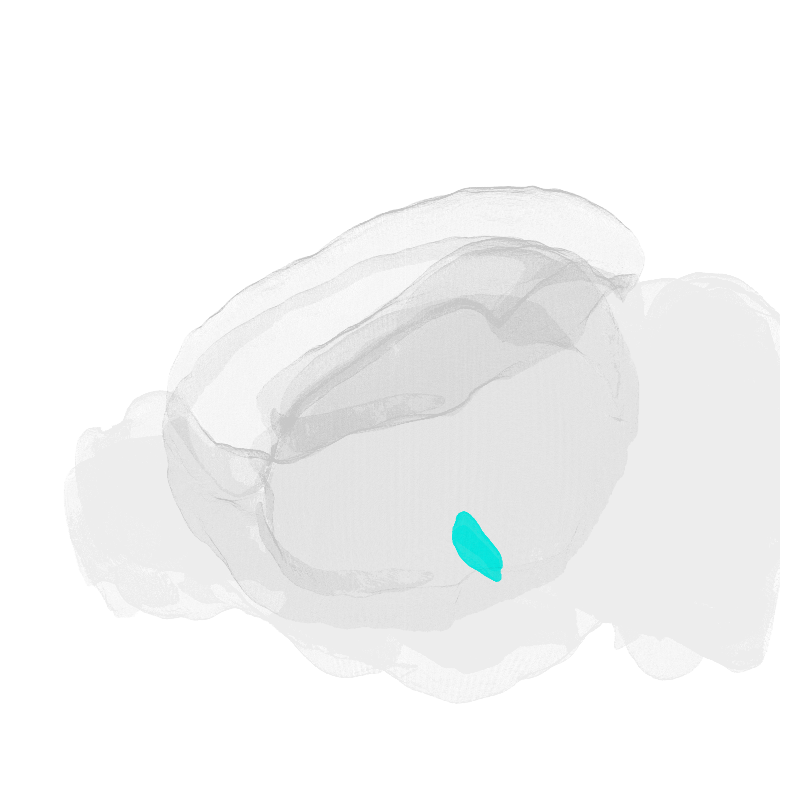

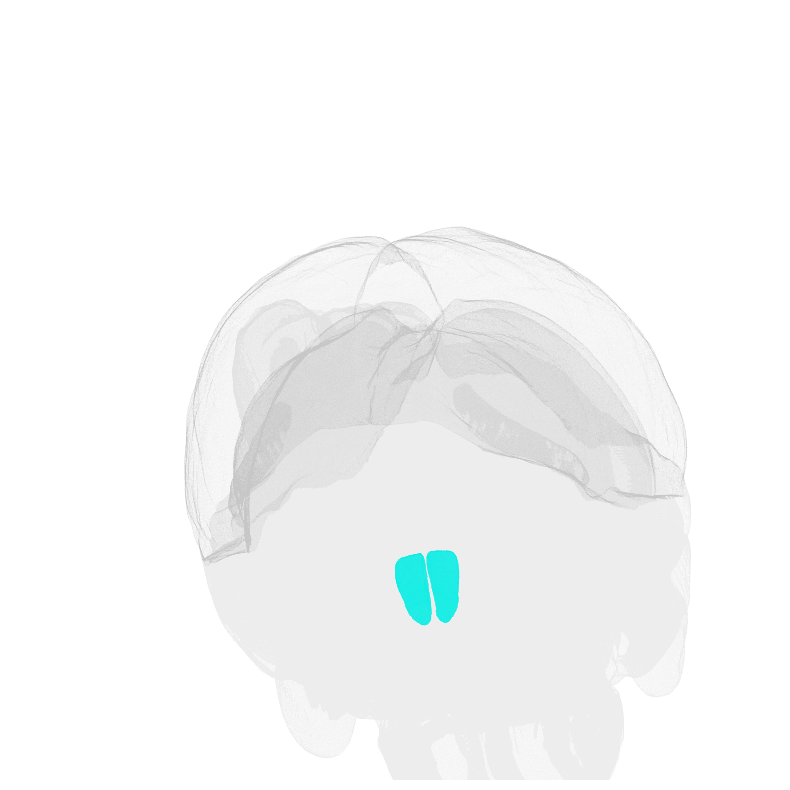

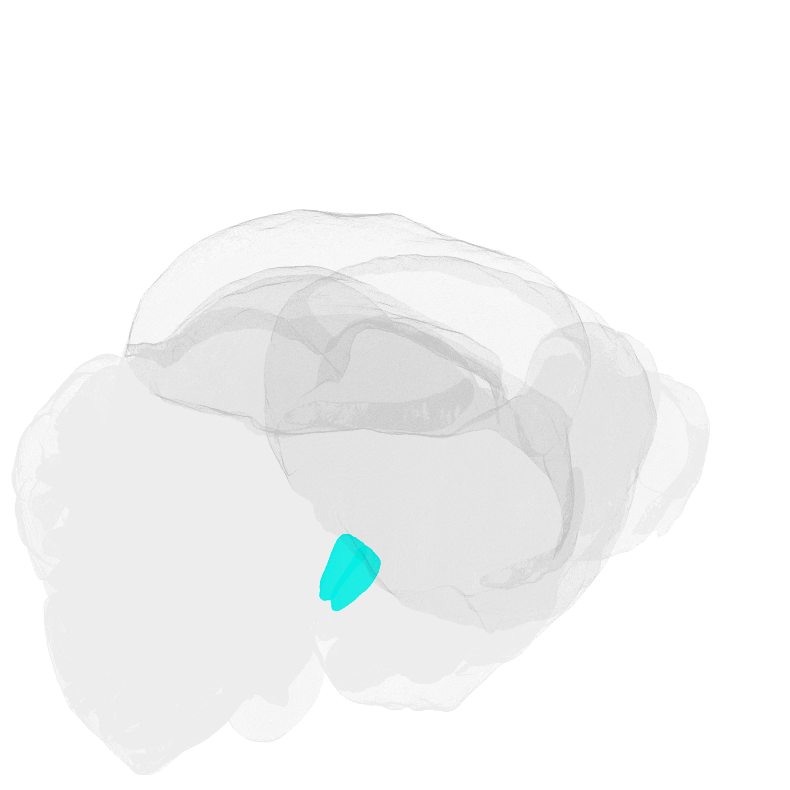

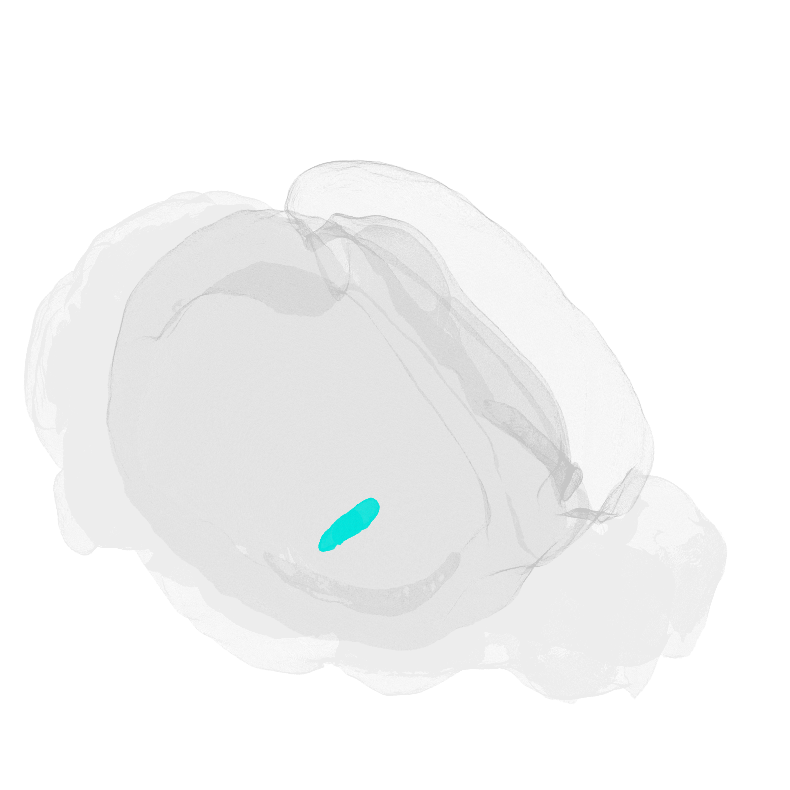

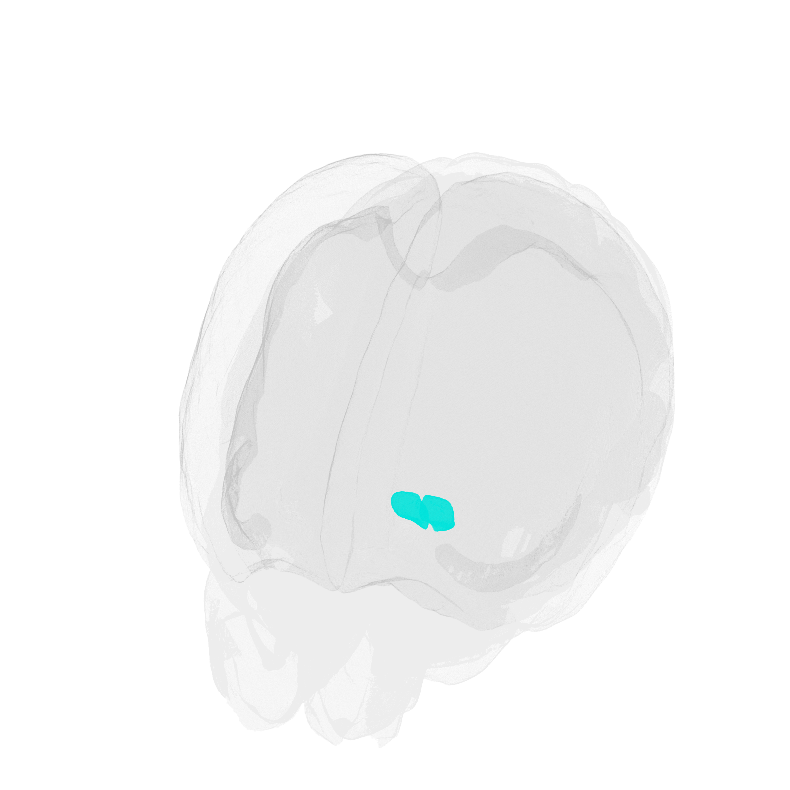

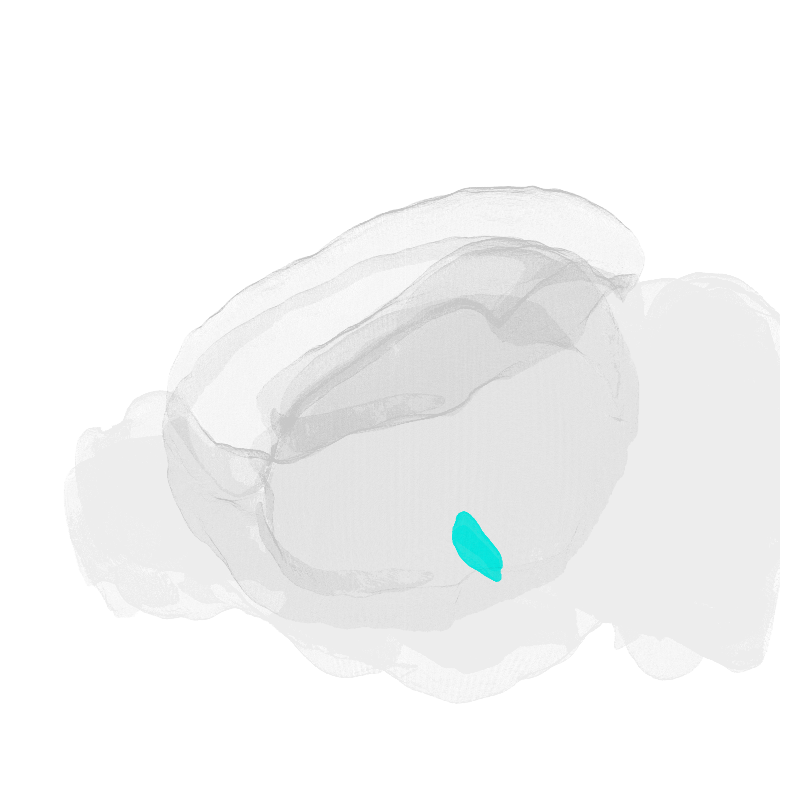

ENT 909
[0.   1.   0.35]


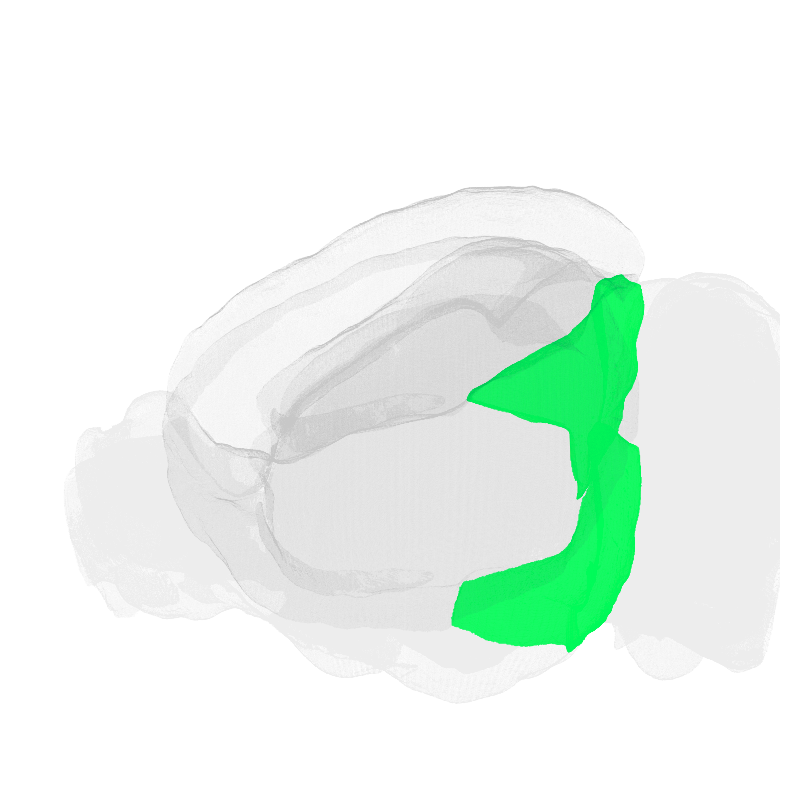

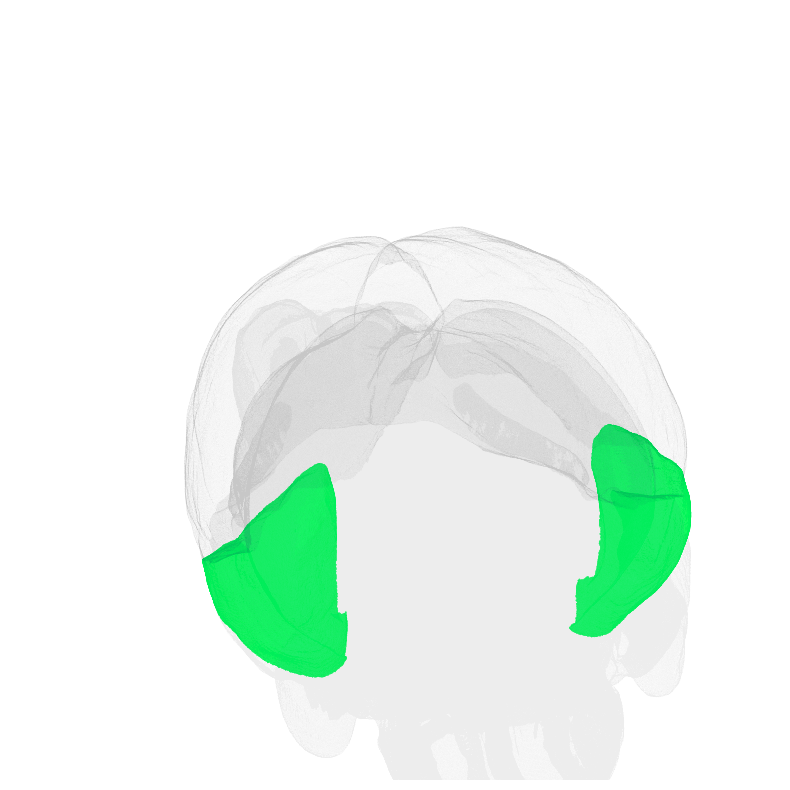

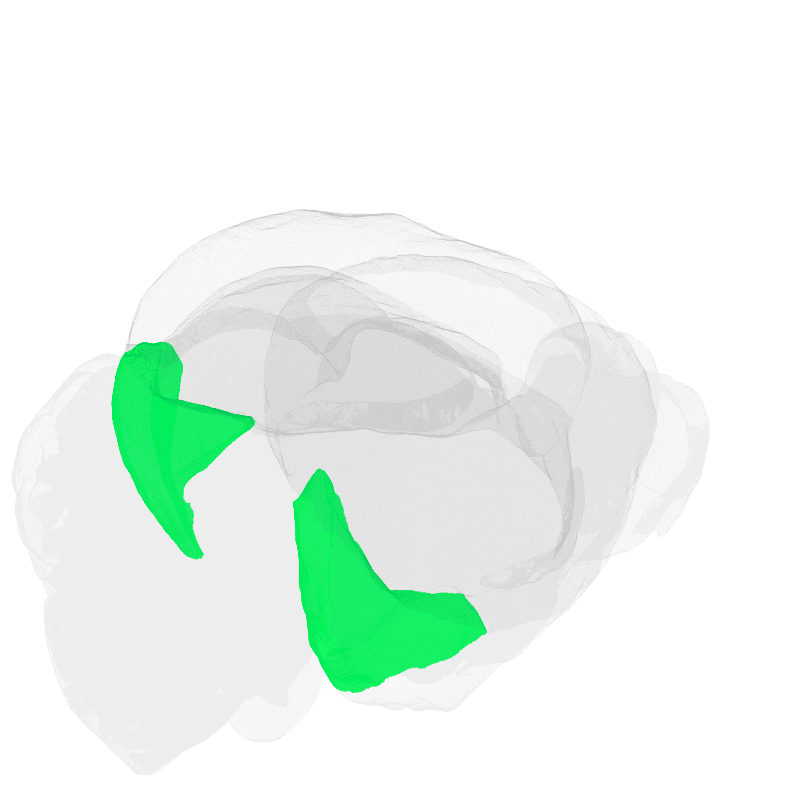

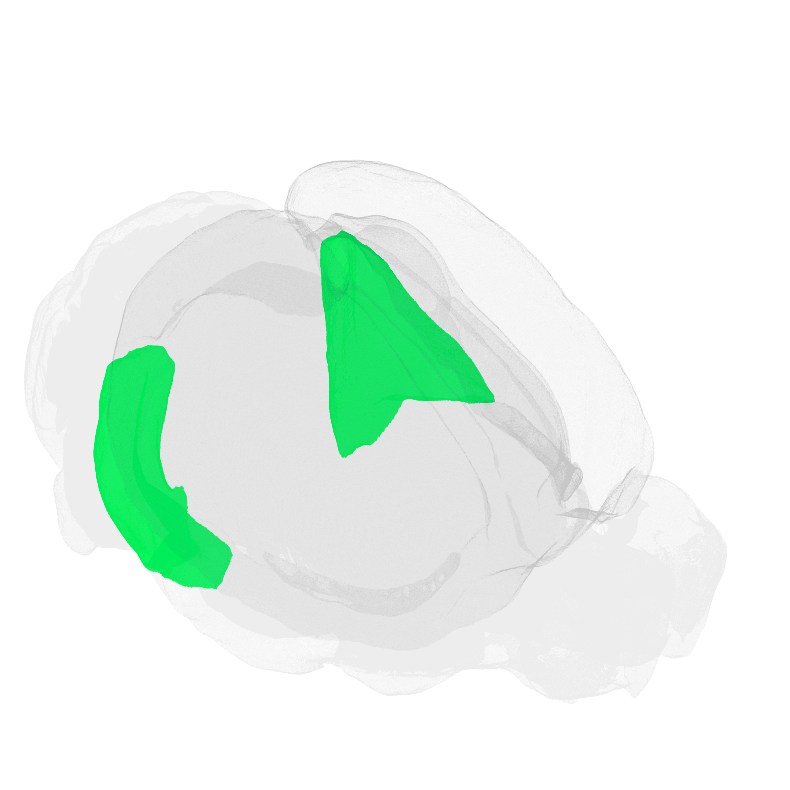

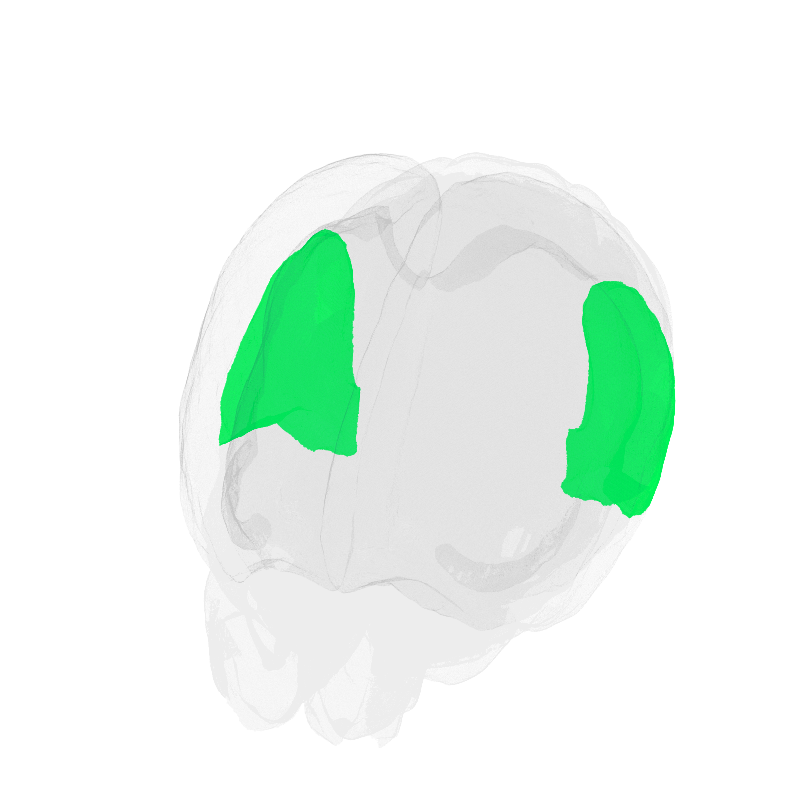

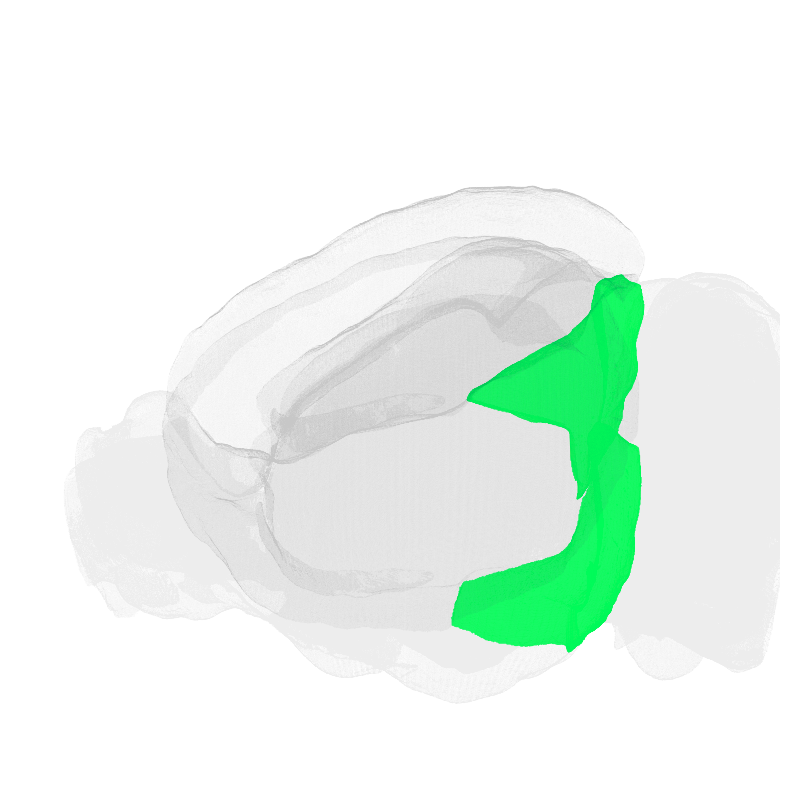

CA1 382
[0.    1.    0.525]


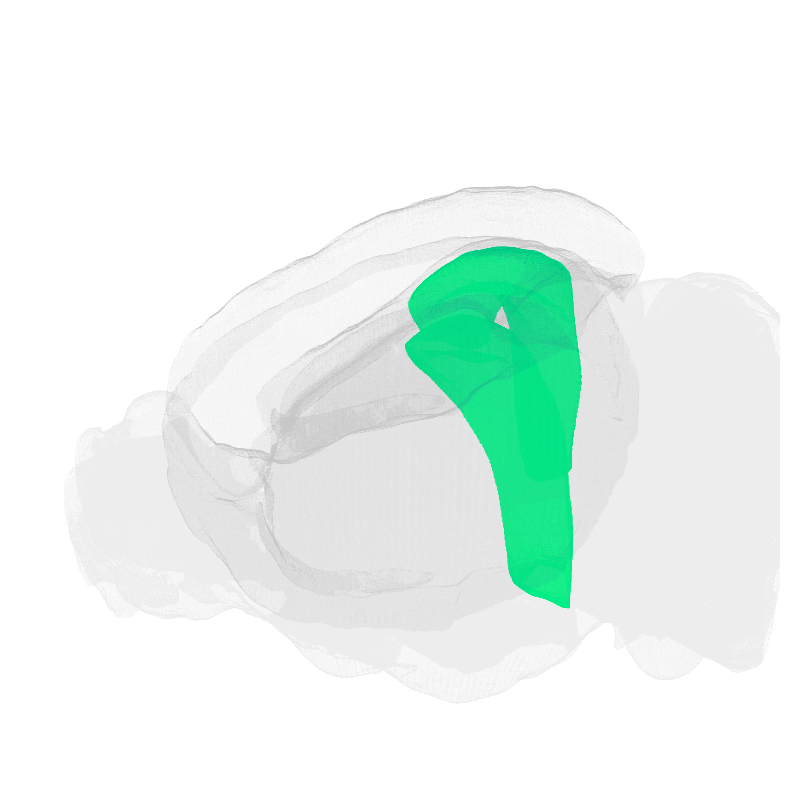

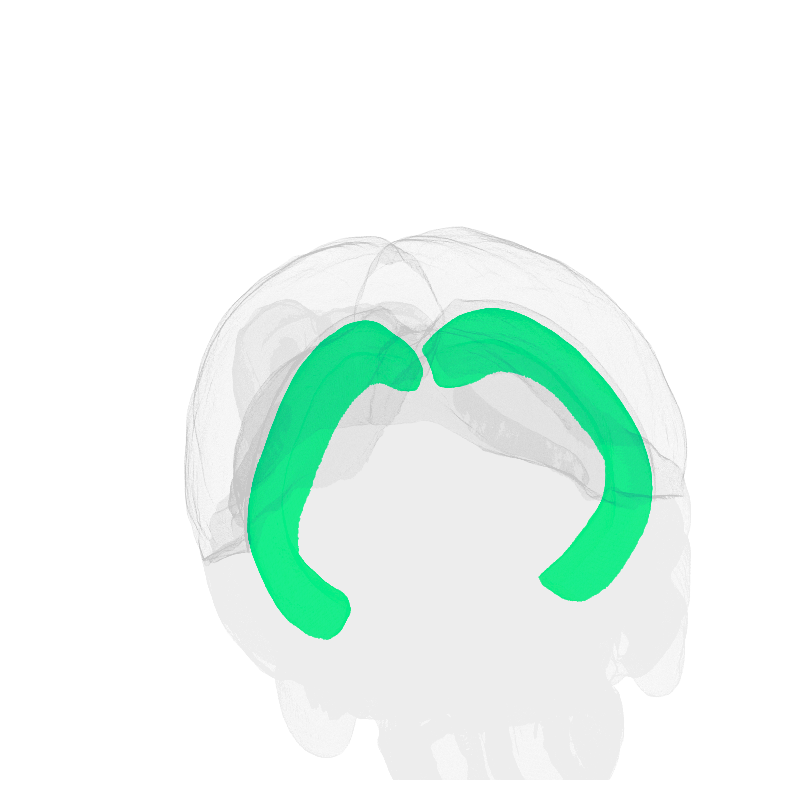

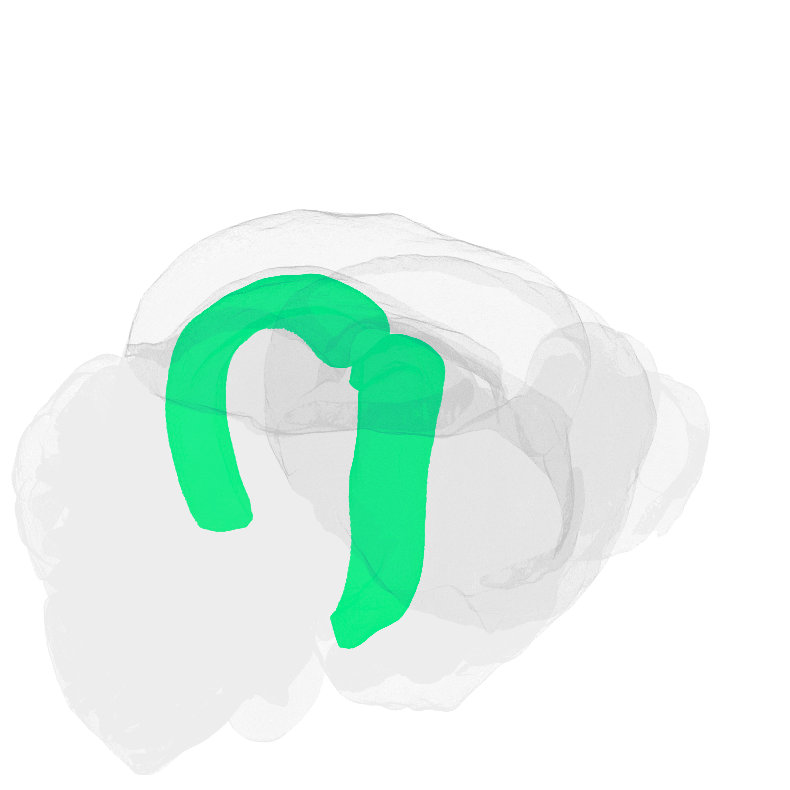

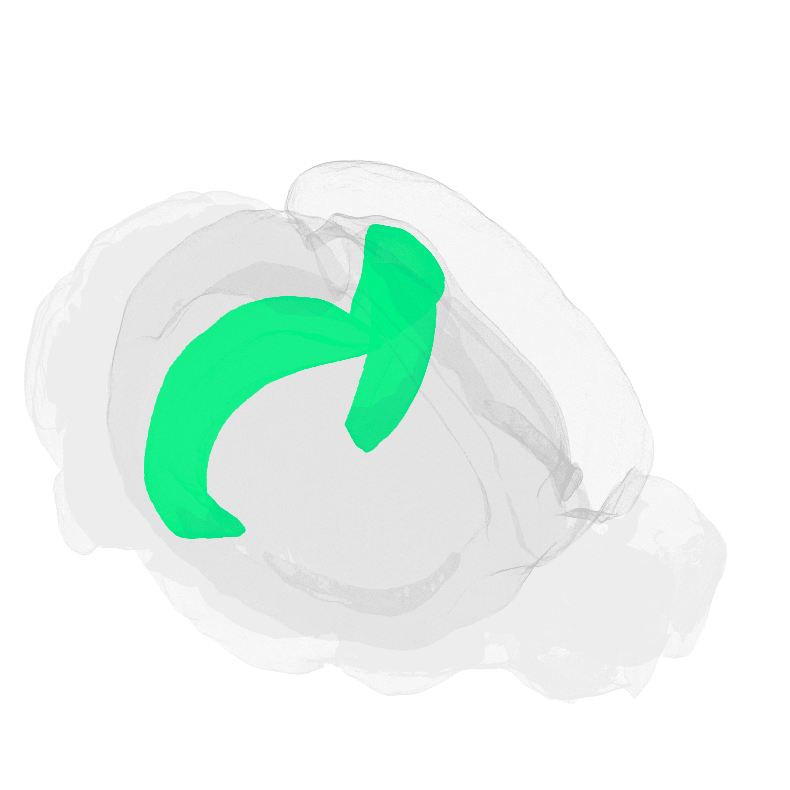

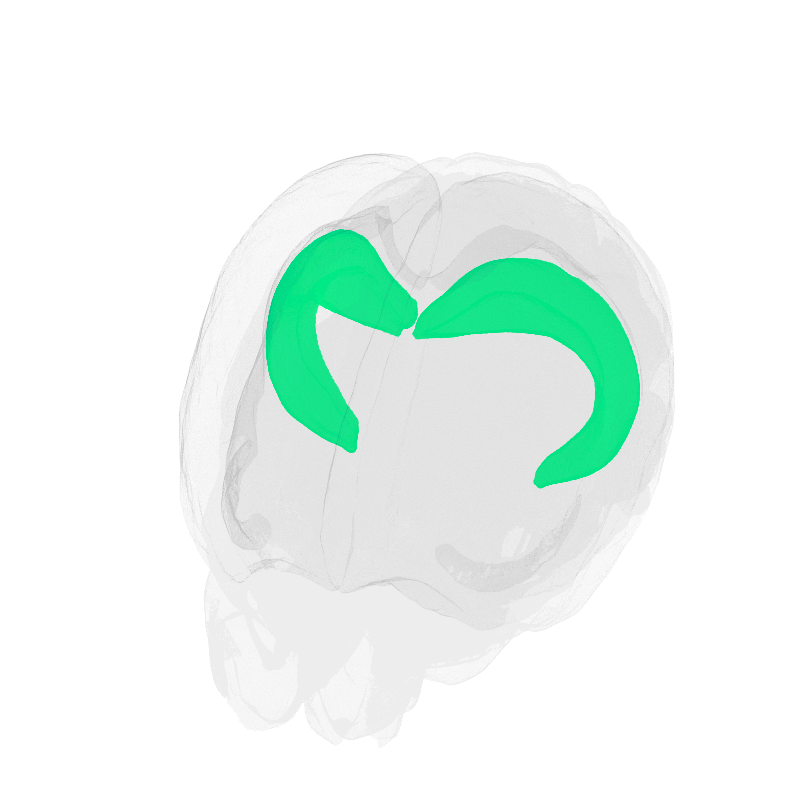

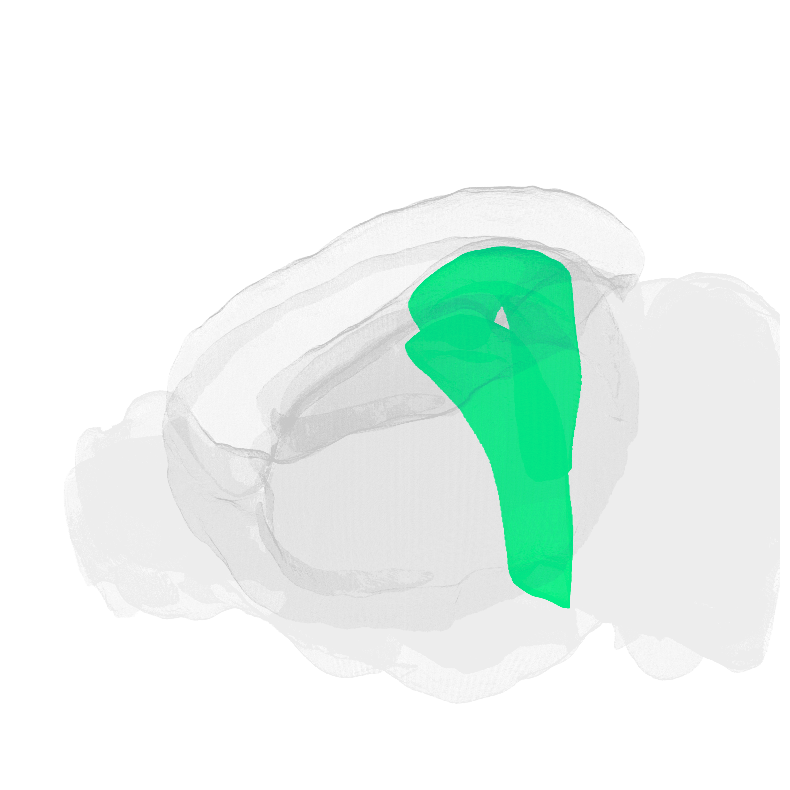

SCH 286
[1.    0.675 0.   ]


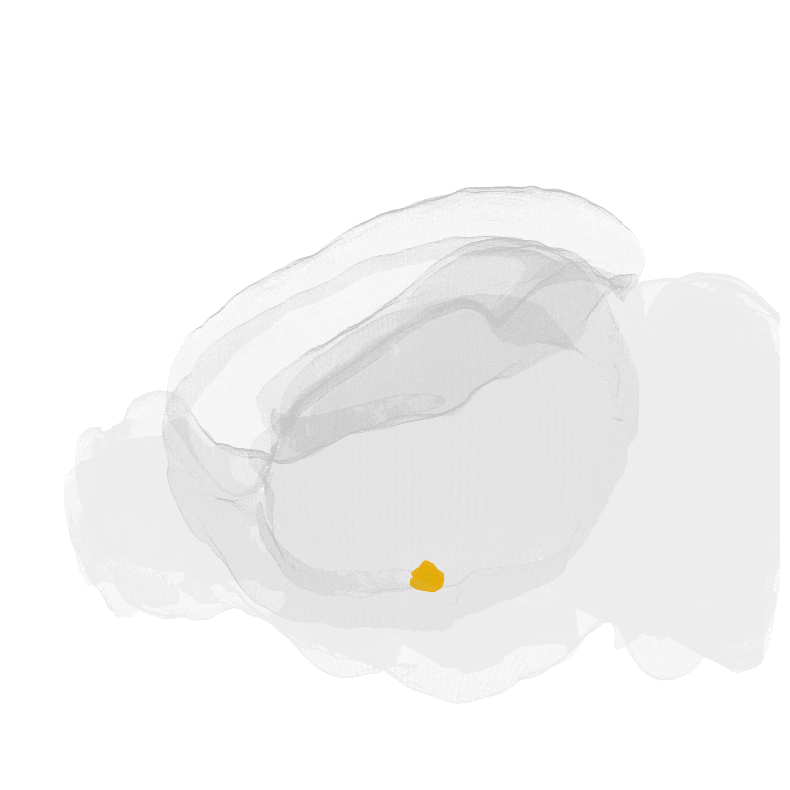

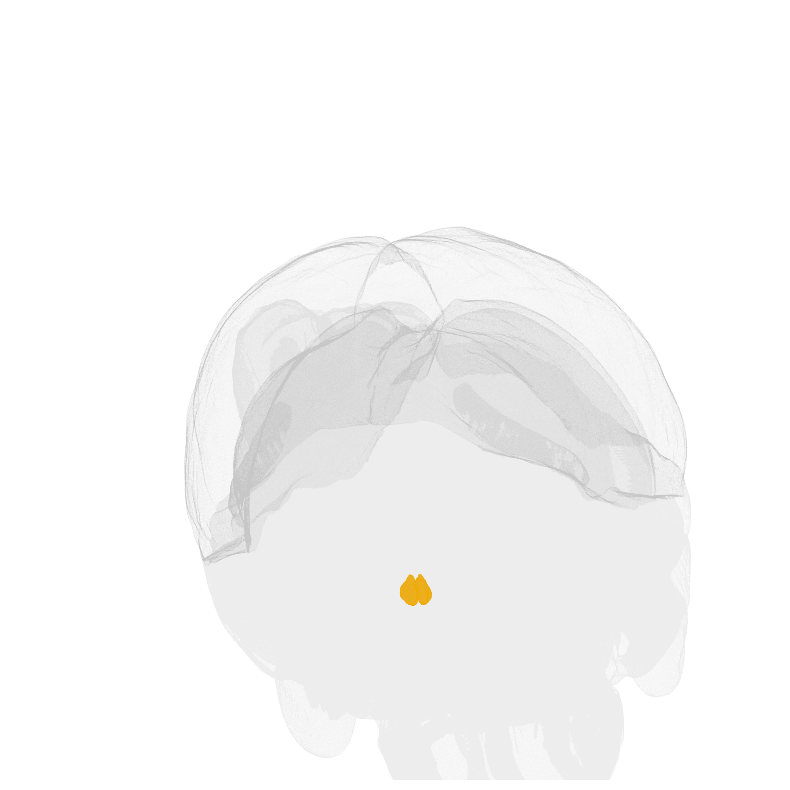

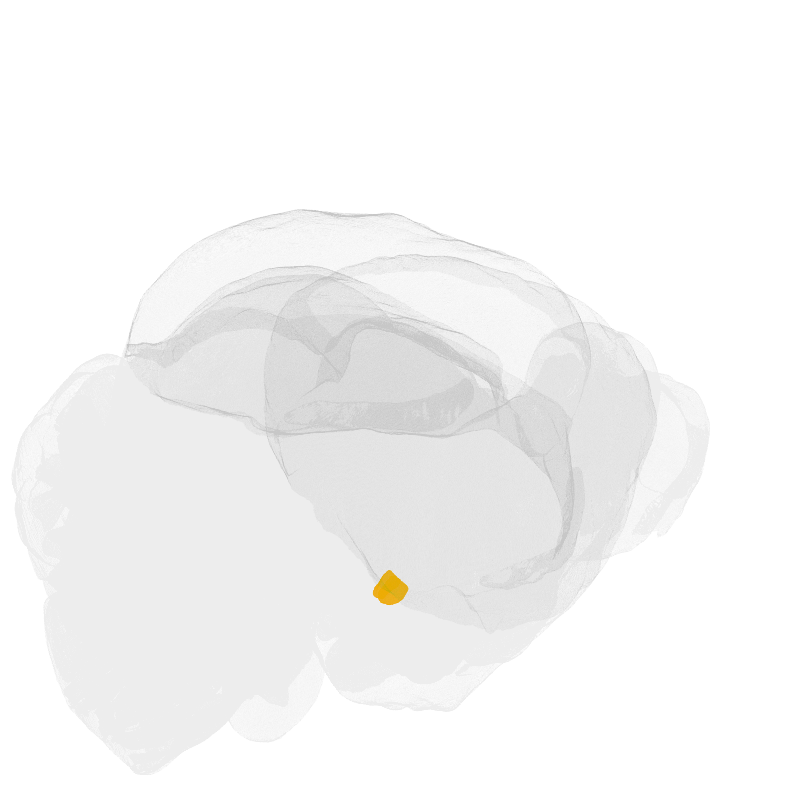

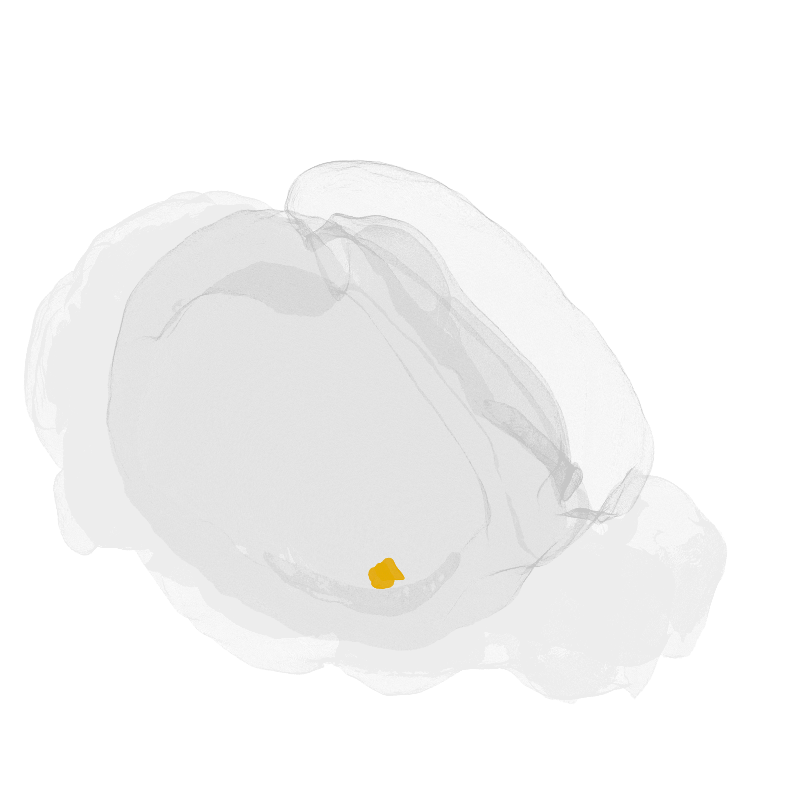

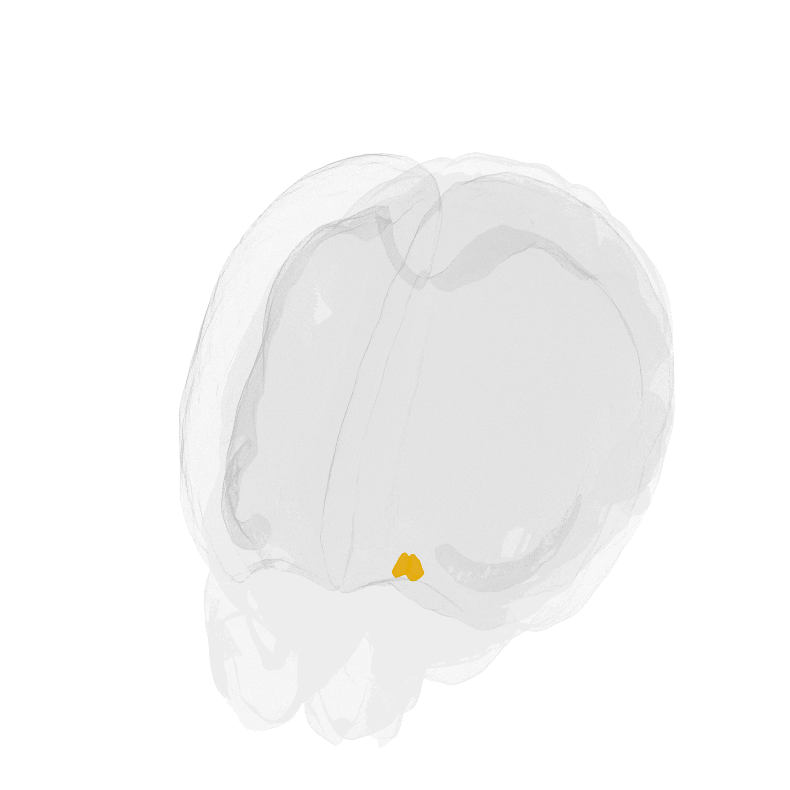

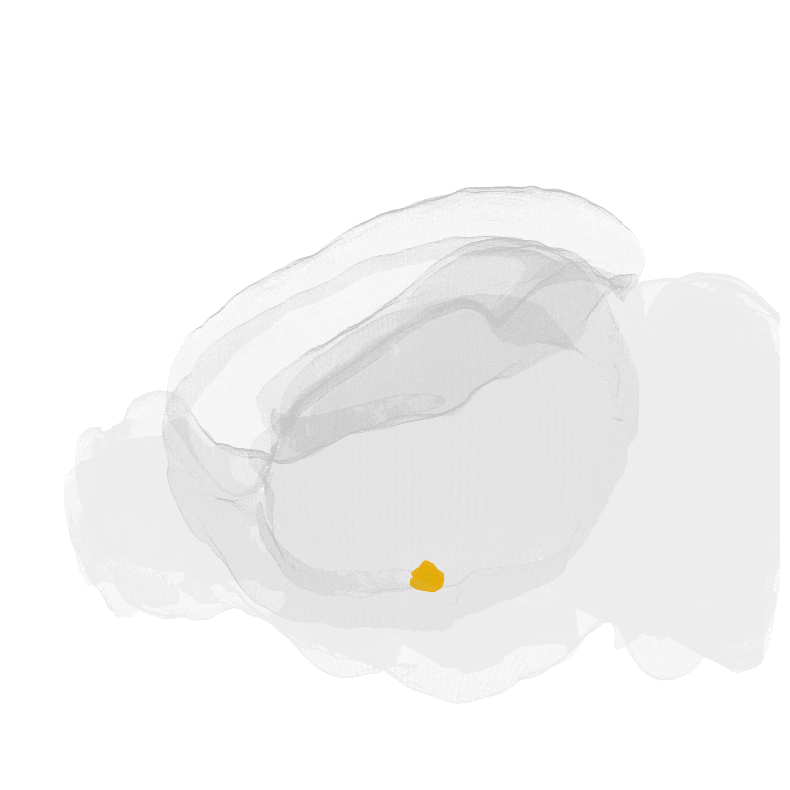

In [25]:
#rotation whole brain + region color  or phase color
#whole slice plane  mask2 + tri   20um
from PIL import Image
#region 3D object region/whole mask
# dst = "/mnt/gpu_data/data8/"
# fig_dir = dst+"cfos_app/whole_3D_2/"
# os.makedirs(fig_dir, exist_ok=True)

from skimage import measure
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
# vx=20
fig_dir = savedir + "figures_movie_phasec/"


phase_li = np.arange(0,24, 4)
num_frames = 6
angles  = ["hor"]#, "cor", "sag"]
elev = 30

xcenter = int(ca.x_num/2)
r = 5


region_IDs = [385]


brain_IDs = [315, 698, 1089, 703, 477, 803, 549, 1097,  313, 771, 354,  512]
# region_IDs = region_per_IDs

xmin, xmax, ymin, ymax, zmin, zmax = mask_range(brain_IDs, vx, 100)

x_scale = 1
y_scale = 1.5
z_scale = 1


brain_masks = []
face_colors = []
for rID in brain_IDs:
    
    
    ind = ca.get_vx_ind(rID)
#     print(len(ind))
    brain_mask = np.zeros(ca.voxel_nums, dtype="uint16")
    brain_mask[ind]=1
    brain_mask = np.swapaxes(brain_mask.reshape(ca.x_num, ca.y_num, ca.z_num), 0, 2)
#     brain_mask=np.repeat(brain_mask, x_scale, axis=2)
    brain_mask=np.repeat(brain_mask, y_scale, axis=1)
#     brain_mask=np.repeat(brain_mask, z_scale, axis=0)

    brain_masks.append(brain_mask)
#     face_colors.append((0.75, 0.75, 0.75))#df_sum[df_sum["id"]==rID]["rgb_triplet2"].iloc[0])
    if rID == 315:
        face_colors.append((0.78, 0.78, 0.78))
    else:
        face_colors.append((0.93, 0.93, 0.93))

        
for m, region_ID in enumerate(region_IDs):
        
    
    region = ca.df_allen[ca.df_allen["ID"]==region_ID]["acronym"].iloc[0]
    print(region, region_ID)
    if "/" in region:
        region = region.replace("/", "_")
        
    name = "{}_whole_vx".format(region)
    os.makedirs(fig_dir+name, exist_ok=True)
    
#     if os.path.exists(fig_dir+"{}_{}_tri.png".format(region, "sag")):
#         continue
    

    ind = ca.get_vx_ind(region_ID)
    region_mask = np.zeros(ca.voxel_nums, dtype="uint16")
    region_mask[ind]=1

    region_mask = np.swapaxes(region_mask.reshape(ca.x_num, ca.y_num, ca.z_num), 0, 2)

    

    #phase color
    ph = CT_df[CT_df["id"]==region_ID]["LAG"].tolist()
    ph = 1-(ph[0]/24)
    if (ph + 1/3) > 1:
        ph = ph + 1/3 - 1
    else:
        ph = ph + 1/3
    face_color_r = hsv_to_rgb([ph, 1, 1])
    print(face_color_r)

    #region color
    # try:
    #     face_color_r=df_sum[df_sum["id"]==region_ID]["rgb_triplet2"].iloc[0]
    # except:
    #     df_c  = pd.read_csv("parcellation_term.csv")
    #     region_pre = ca.df_allen[ca.df_allen["ID"]==region_ID]["acronym"].iloc[0]
    #     face_color_r = (df_c[df_c["acronym"]==region_pre]["red"].iloc[0]/255, df_c[df_c["acronym"]==region_pre]["green"].iloc[0]/255, df_c[df_c["acronym"]==region_pre]["blue"].iloc[0]/255)
       
    
#     for lr in lrs:
       
       
    region_mask=np.repeat(region_mask, y_scale, axis=1)
    #     region_mask=np.repeat(region_mask, z_scale, axis=0)
    if np.sum(region_mask)==0:
        continue
        print(lr, "0 mask continue")


#     
    c=0
    for j, azim in enumerate(np.linspace(0, 360, num_frames)):
            fig = plt.figure(figsize=(10, 10))
            ax = fig.add_subplot(111, projection='3d')

             # 等値面の抽出
            for brain_mask, face_color in zip(brain_masks, face_colors):
                verts, faces, _, _ = measure.marching_cubes(brain_mask, level=0.5)
                verts_swapped = verts[:, [2, 1, 0]]
                mesh = Poly3DCollection(verts_swapped[faces], alpha=0.025)
                mesh.set_facecolor(face_color)
                ax.add_collection3d(mesh)

            verts, faces, _, _ = measure.marching_cubes(region_mask, level=0.5)
            verts_swapped = verts[:, [2, 1, 0]]
            mesh = Poly3DCollection(verts_swapped[faces], alpha=1.0)
            mesh.set_facecolor(face_color_r)
            ax.add_collection3d(mesh)

            ax.view_init(elev=elev, azim=azim)

            ax.set_xlim(xmin, xmax)
            ax.set_ylim(ymin, ymax)
            ax.set_zlim(zmin, zmax)

            ax.set_xlabel('X')
            ax.set_ylabel('Y')
            ax.set_zlabel('Z')
            ax.set_zlim(ax.get_zlim()[::-1])
            ax.axis("off")


            fig.savefig(fig_dir +name+"/phase_small_rot_{}_{}_{}.png".format(elev, num_frames, c))
            c+=1
            plt.show()
            plt.close()


#                 if not os.path.exists(fig_dir+"{}_{}_tri.png".format(region, angle)):

#                 img1=Image.open(fig_dir+"{}_{}.png".format(region, angle))
#                 if angle =="hor":
#                     img1 = img1.rotate(3.0, expand=True, fillcolor=(255, 255, 255))
#                     left=280
#                     top=220
#                     right=590
#                     bottom=640
#                 elif angle =="sag":
#                     left=215
#                     top=270
#                     right=645
#                     bottom=565
#                 elif angle =="cor":
#                     left=230
#                     top=247
#                     right=603
#                     bottom=603
#                 img1 = img1.crop((left,top,right,bottom))

#                 fig = plt.figure(figsize=(8,8))
#                 ax = fig.add_subplot()
#                 ax.imshow(img1)
#                 ax.axis('off')

#                 img1.save(fig_dir+"{}_{}_tri.png".format(region, angle))
#                     plt.show()
#                     plt.close()

SCH 286
(1.0, 0.9331372549019608, 0.3696078431372549, 1.0)


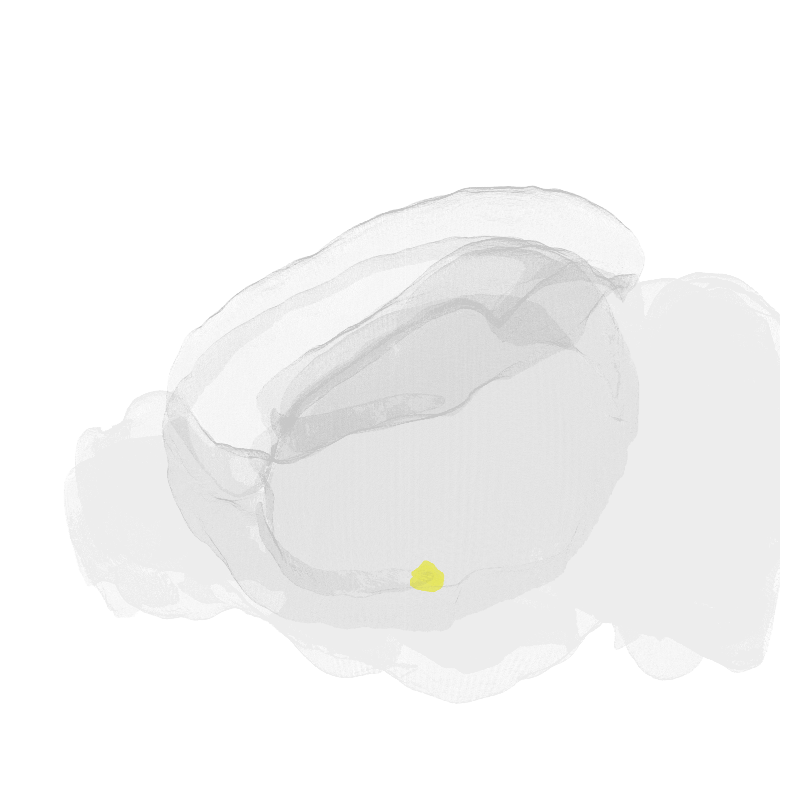

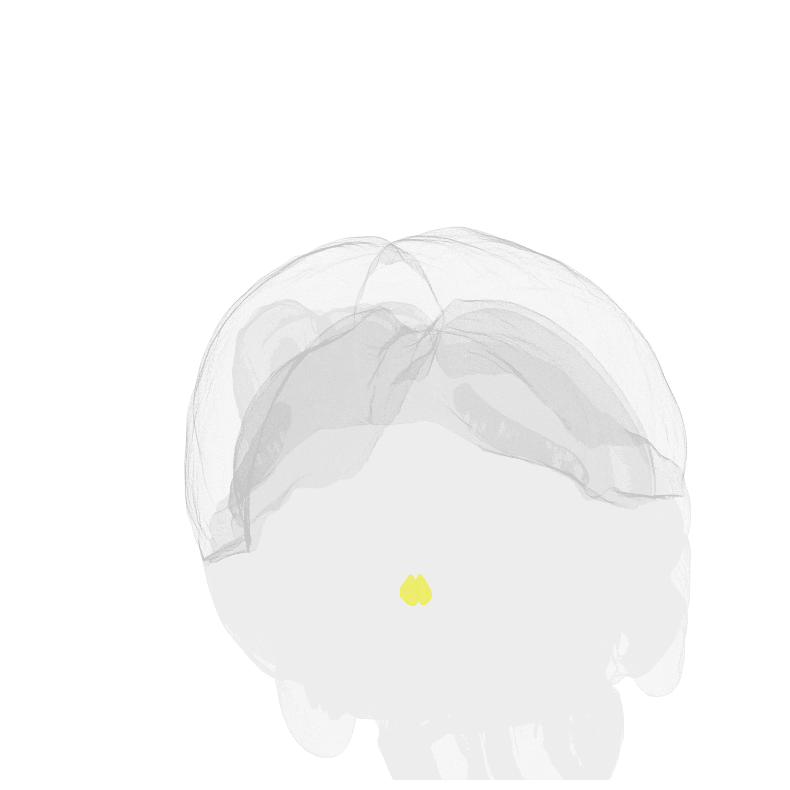

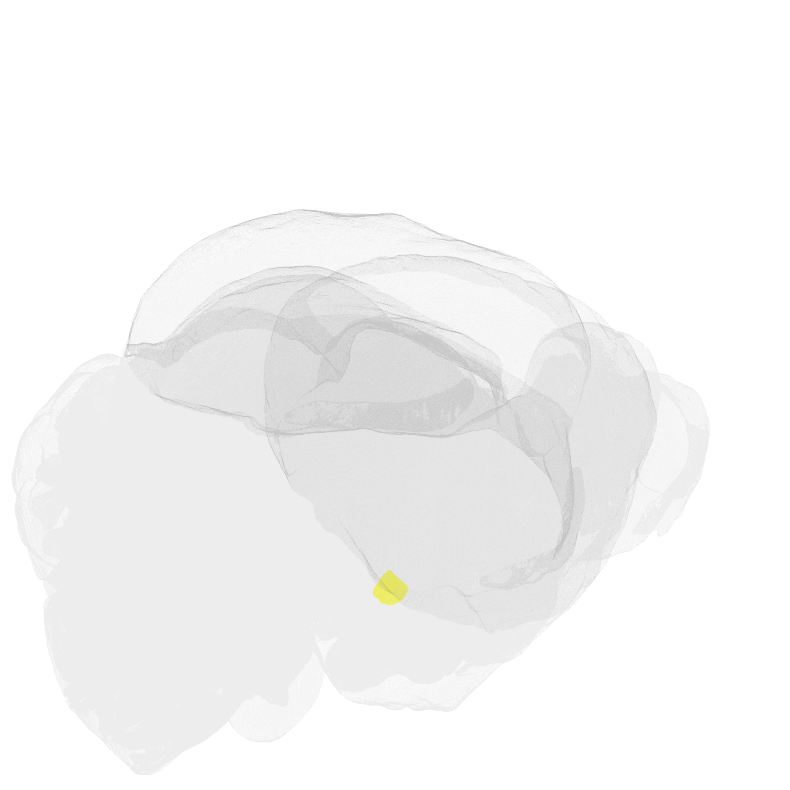

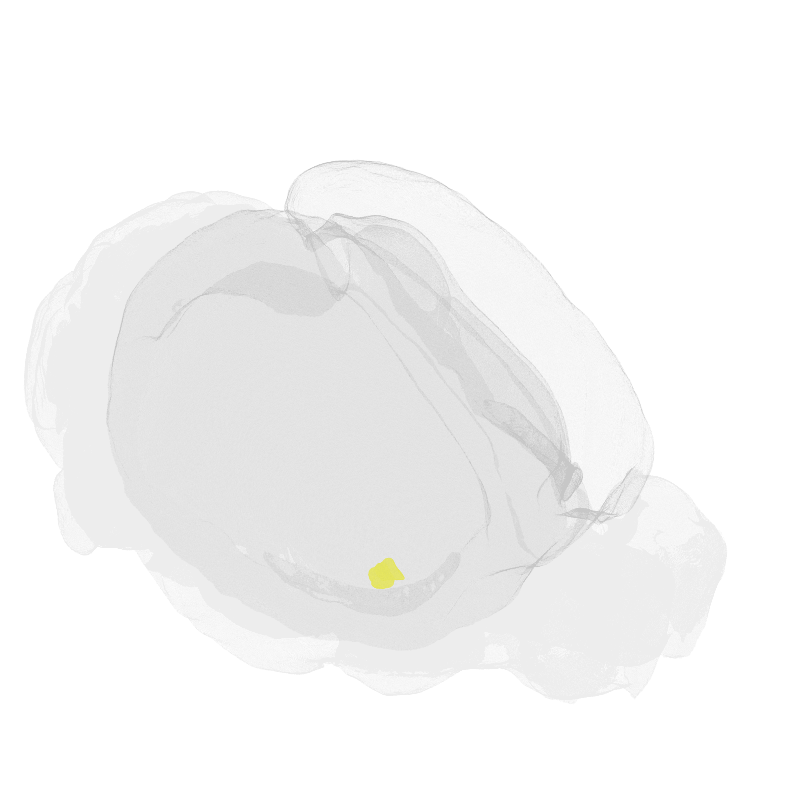

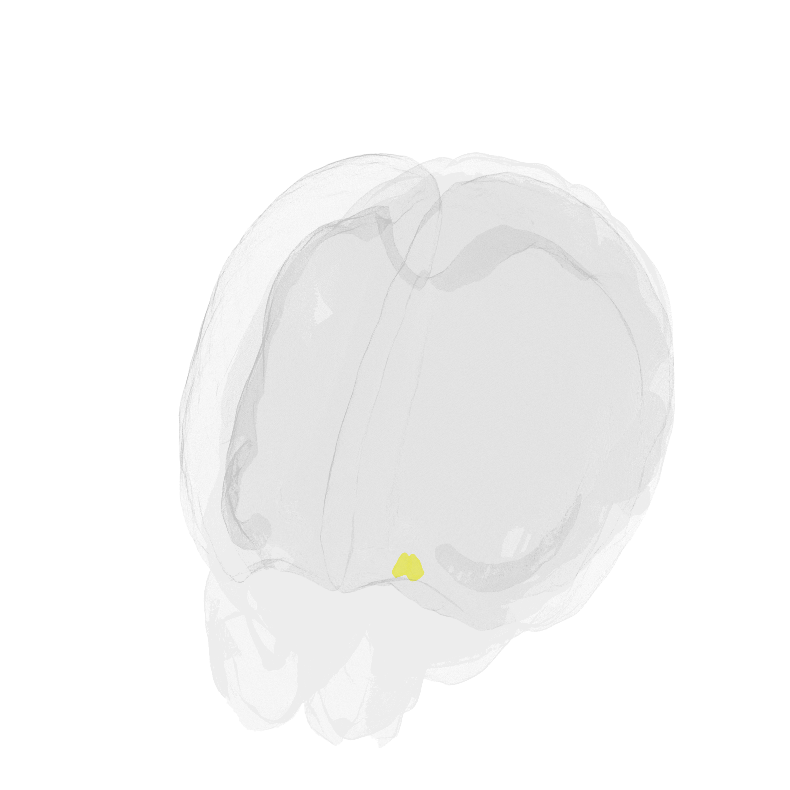

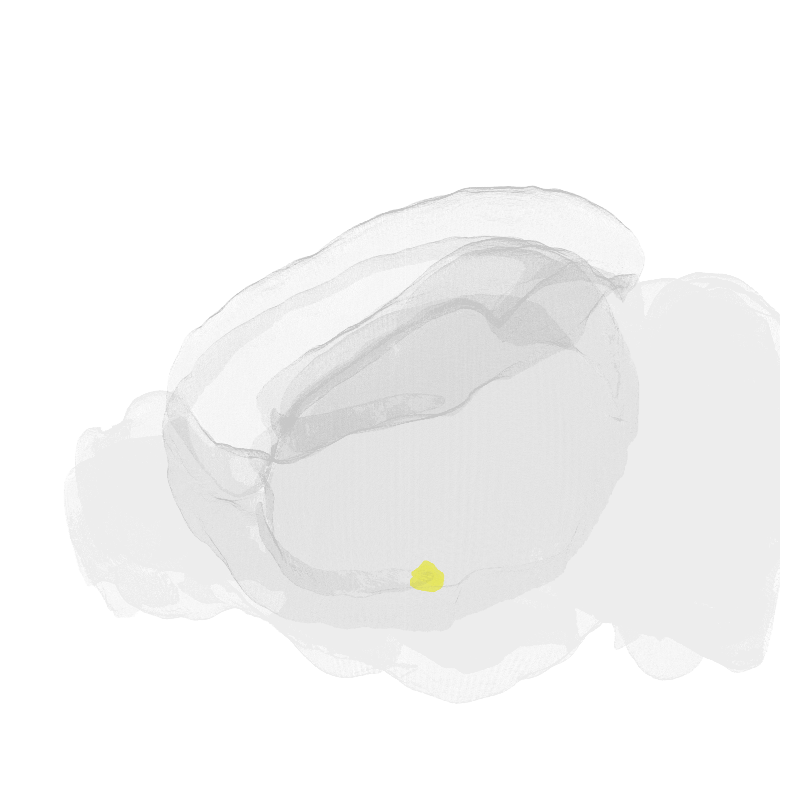

CA1 382
(0.18274509803921568, 0.29156862745098044, 0.9017647058823529, 1.0)


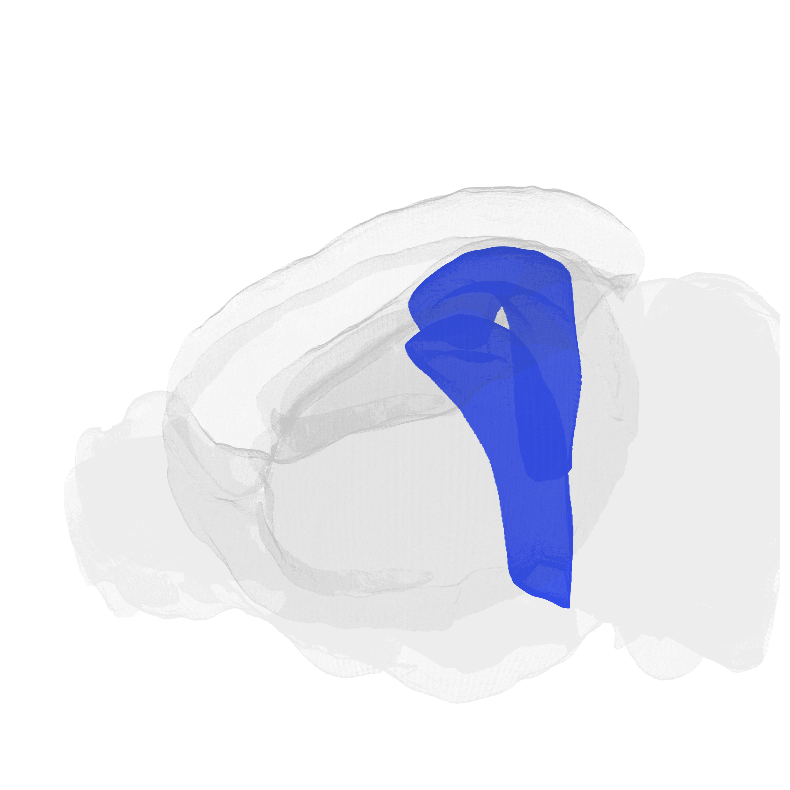

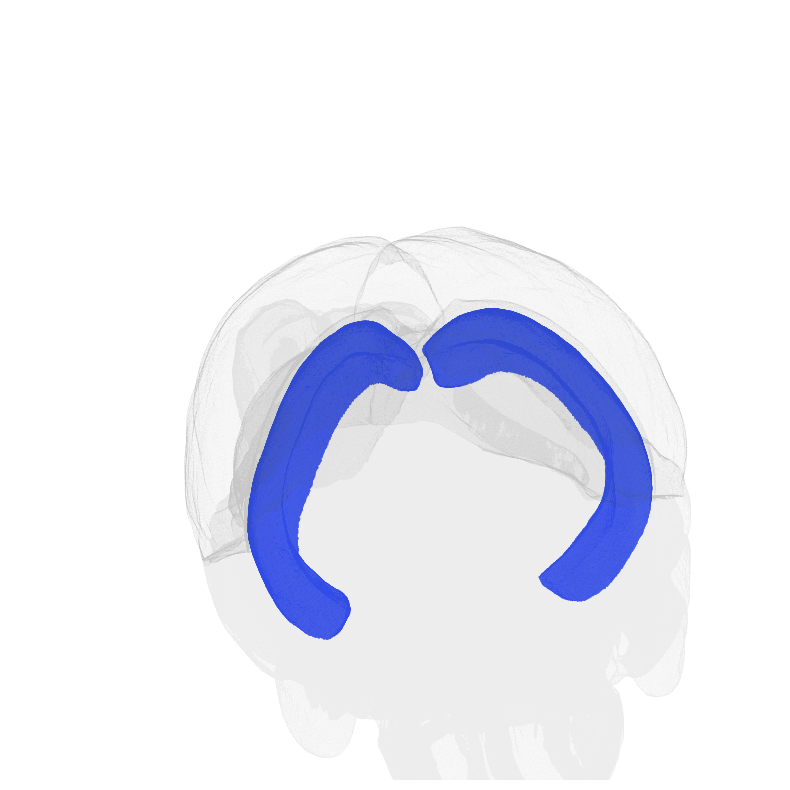

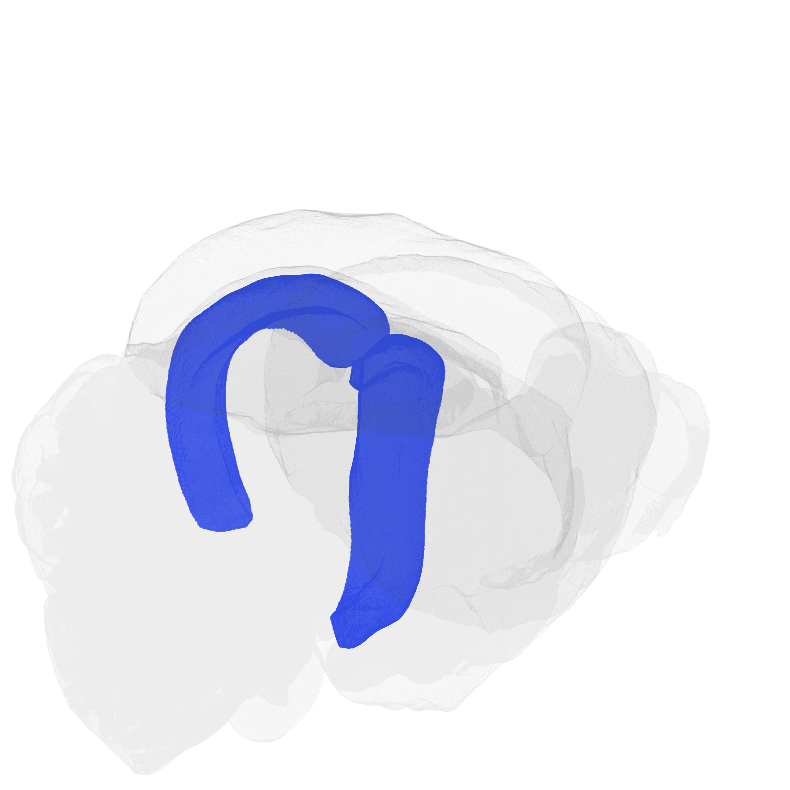

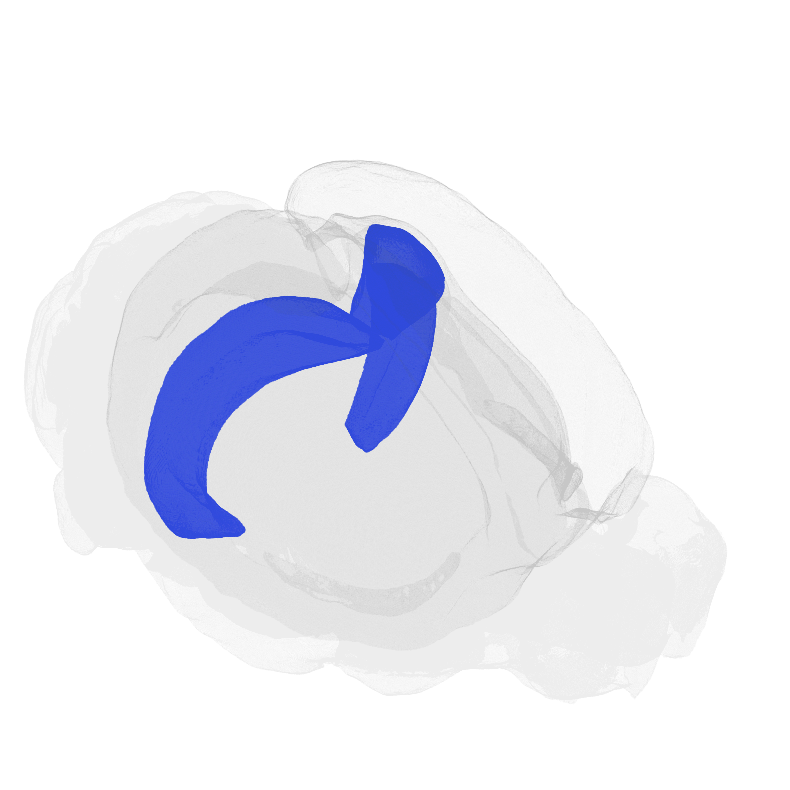

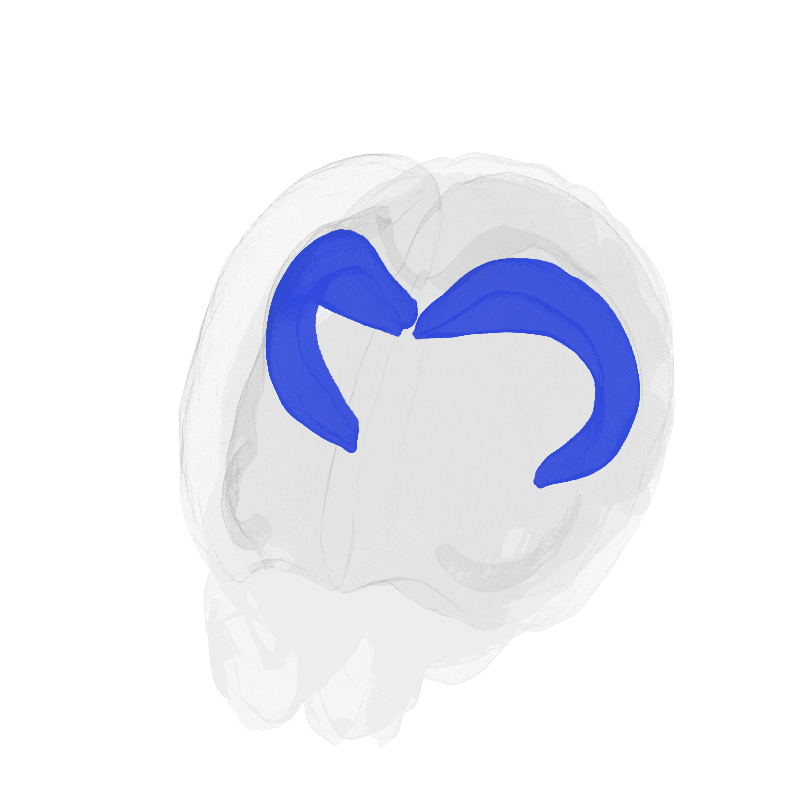

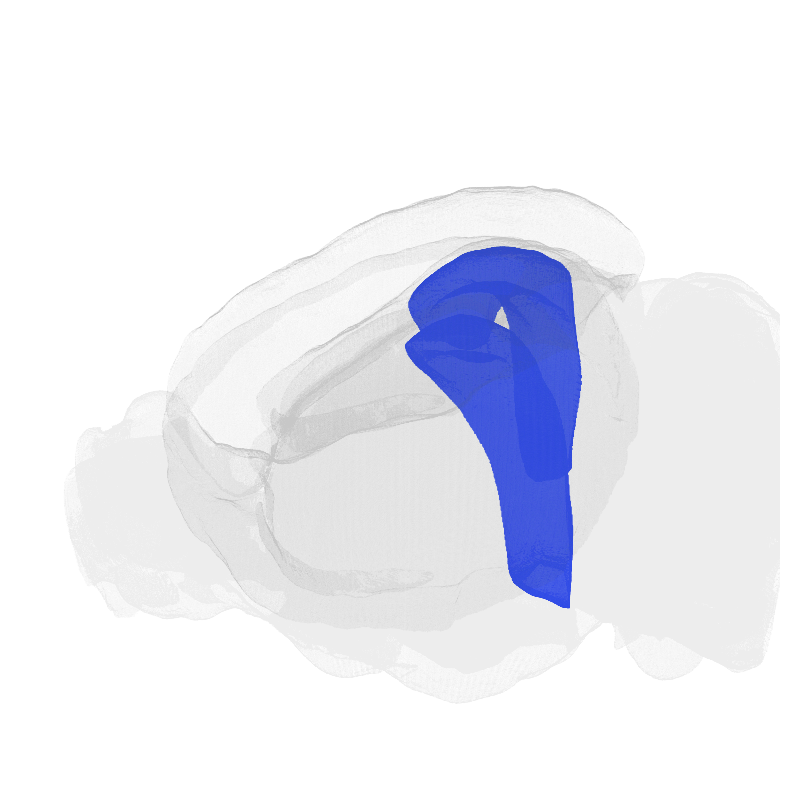

ENT 909
(0.18901960784313726, 0.20372549019607844, 0.8829411764705882, 1.0)


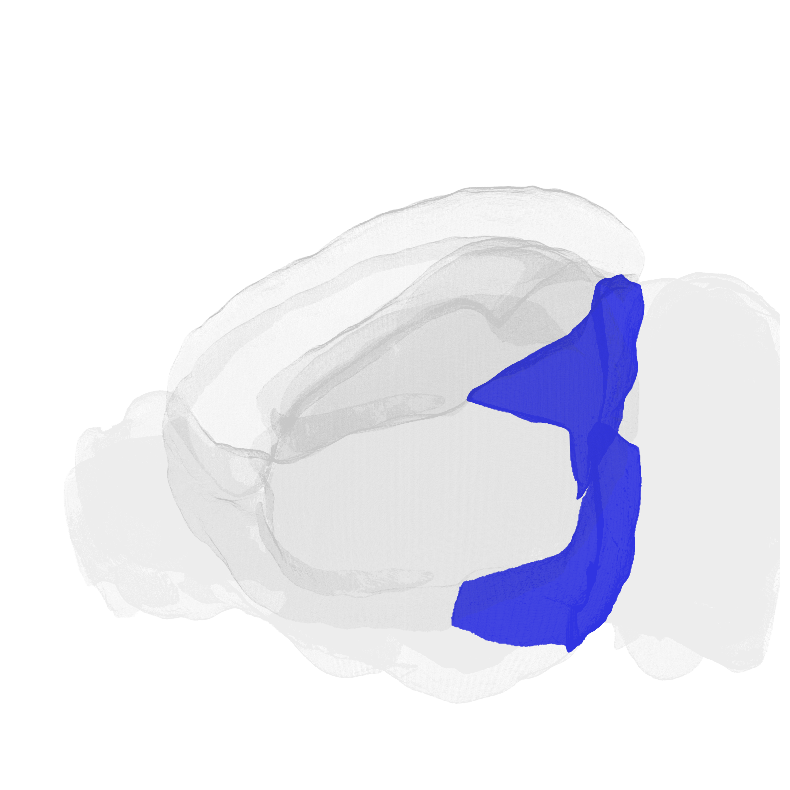

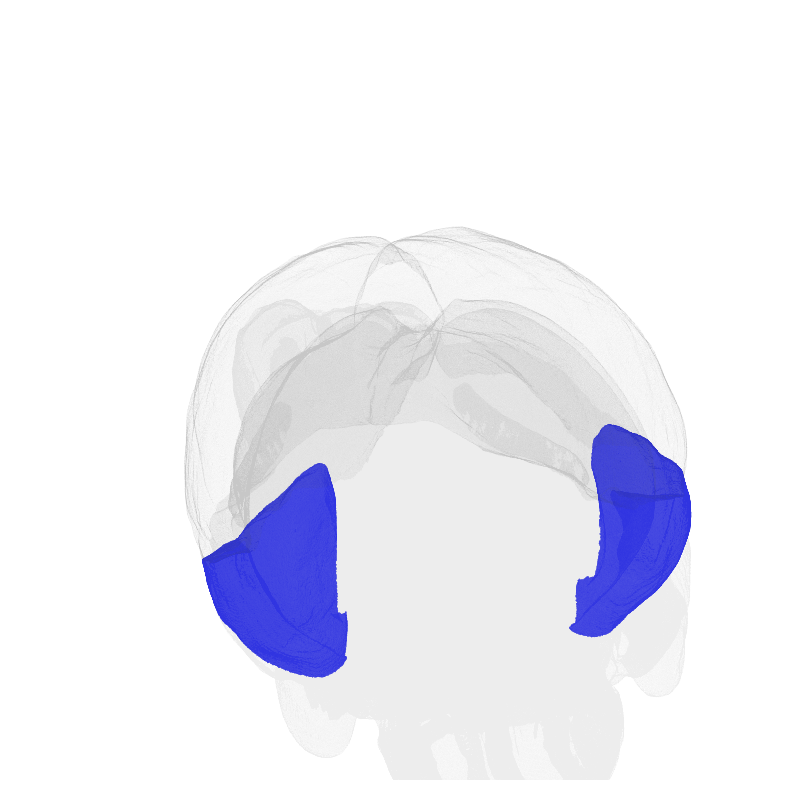

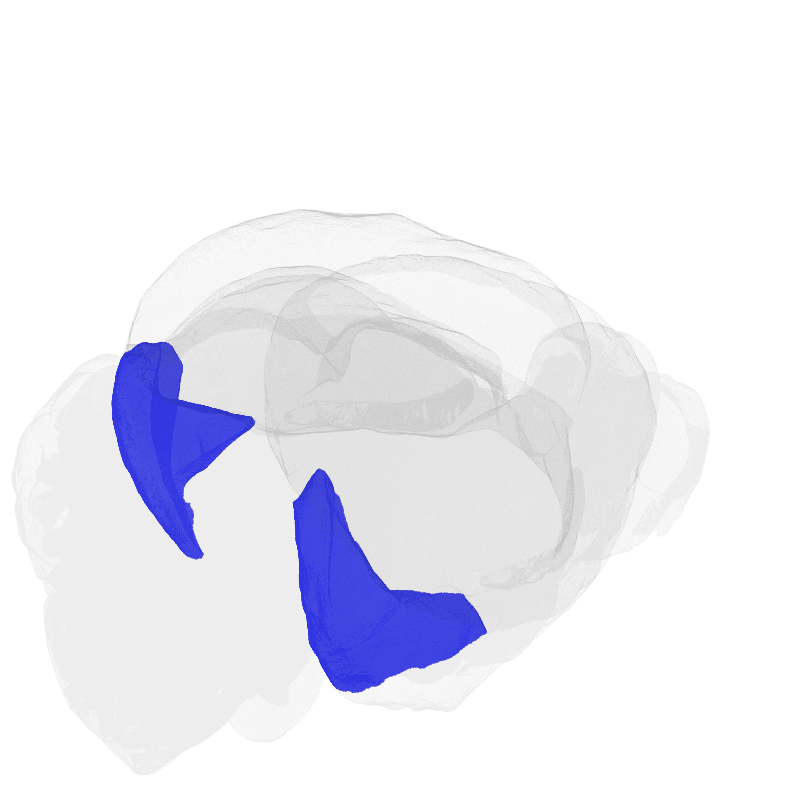

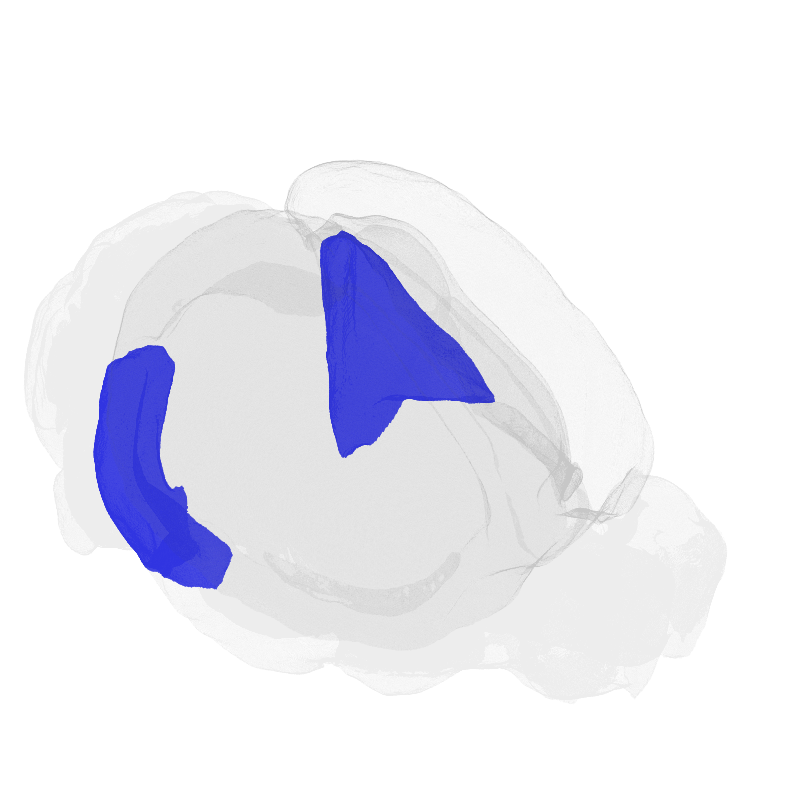

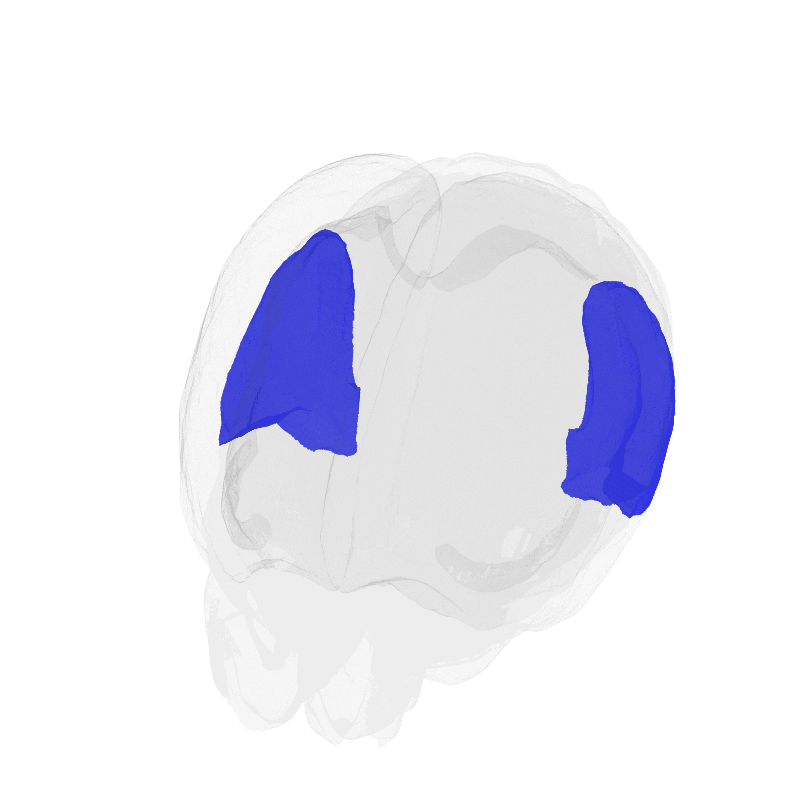

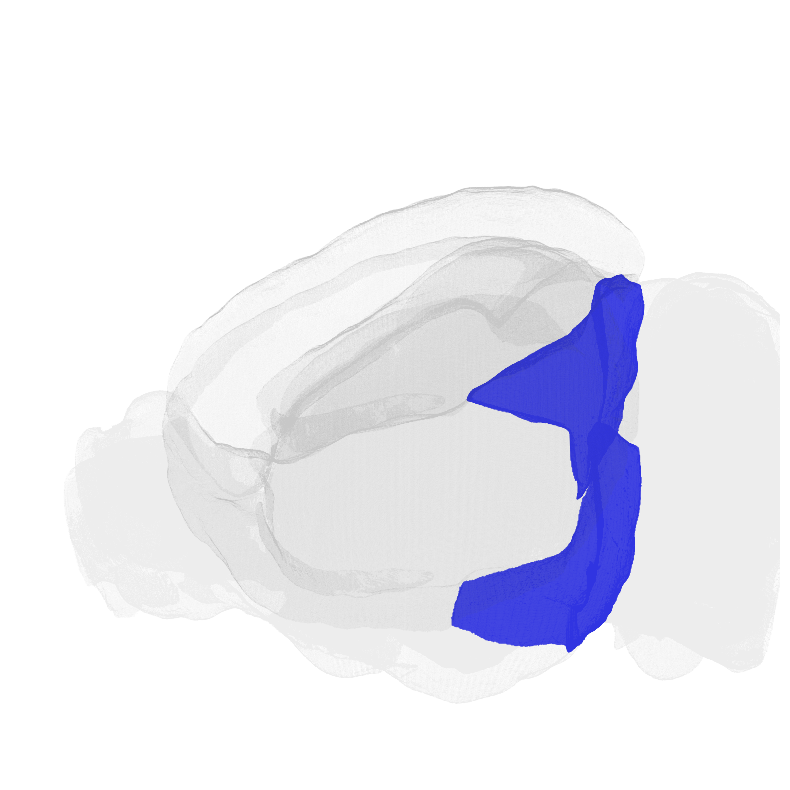

DMH 830
(0.17019607843137255, 0.46725490196078434, 0.9394117647058824, 1.0)


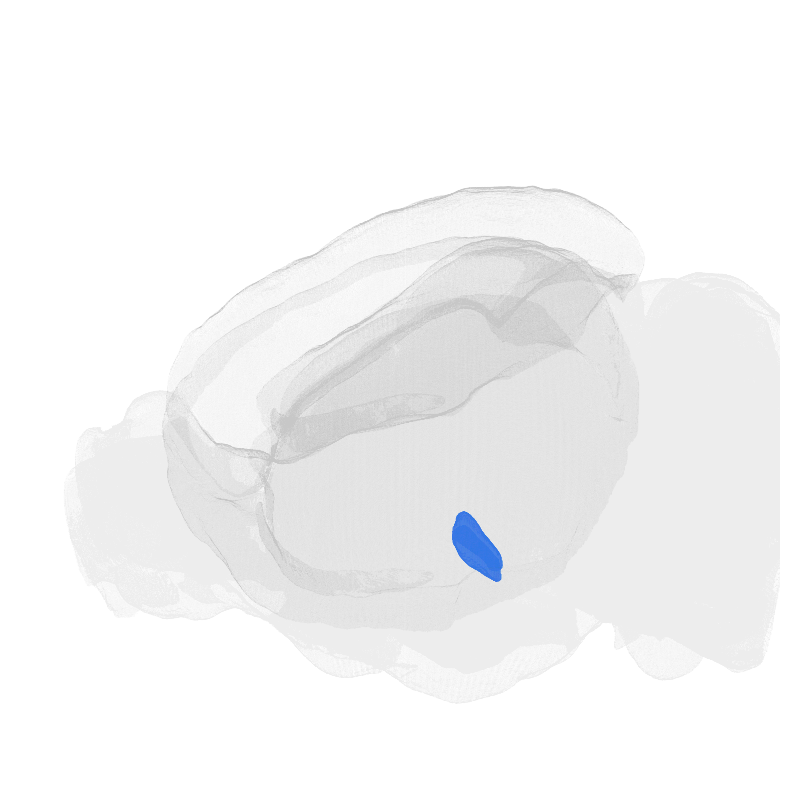

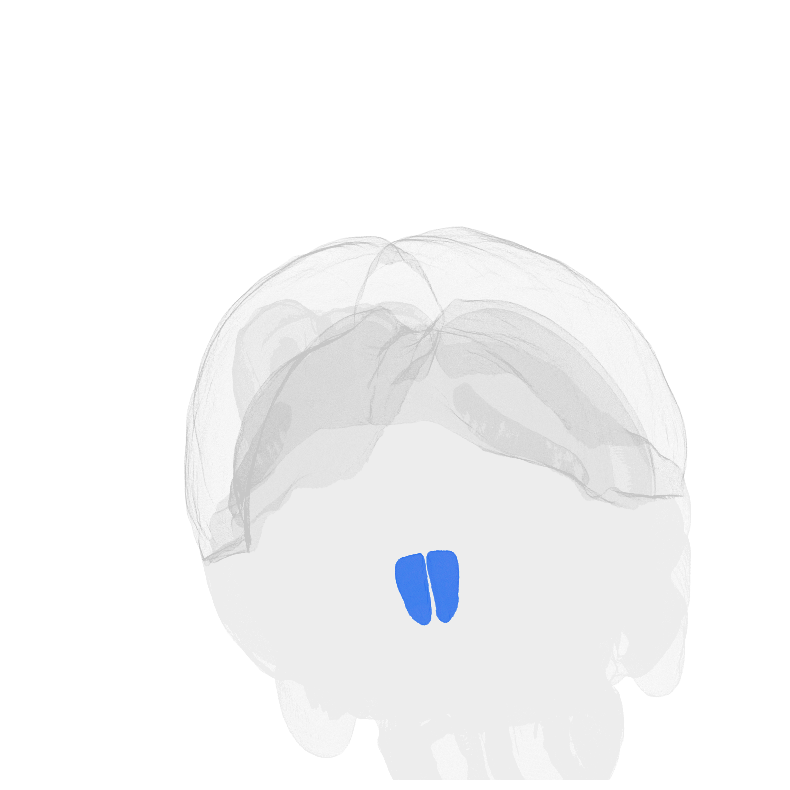

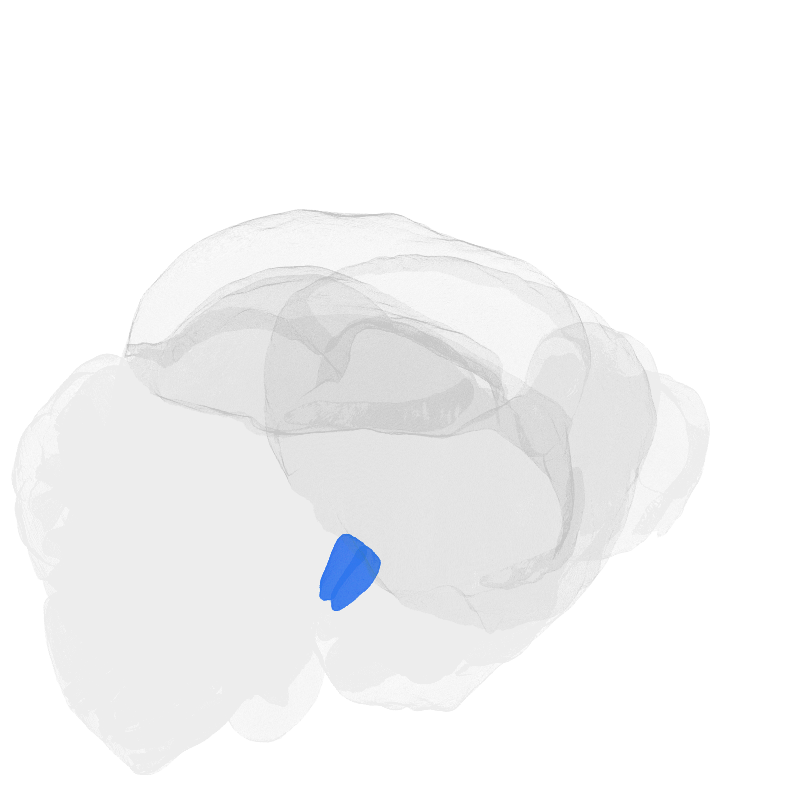

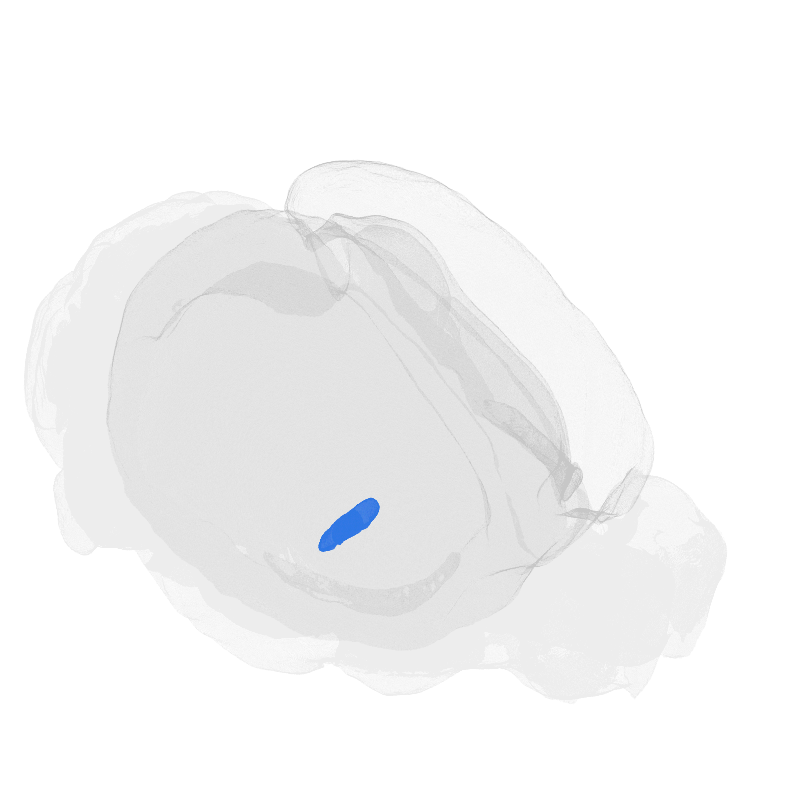

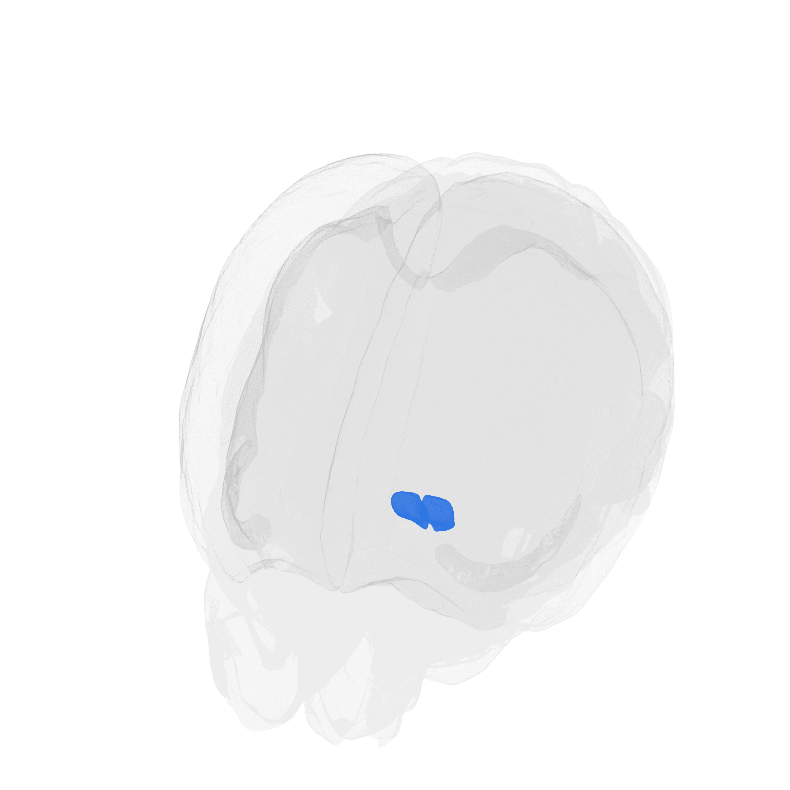

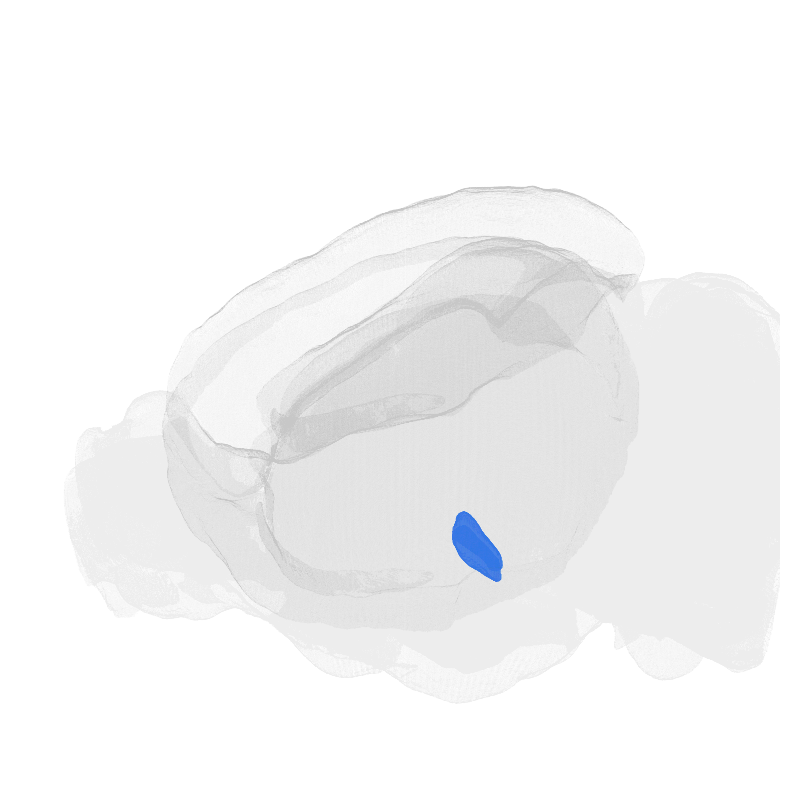

In [23]:
#rotation whole brain + region color  or phase color for blindness
#whole slice plane  mask2 + tri   20um
from PIL import Image
#region 3D object region/whole mask
# dst = "/mnt/gpu_data/data8/"
# fig_dir = dst+"cfos_app/whole_3D_2/"
# os.makedirs(fig_dir, exist_ok=True)

from skimage import measure
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
# vx=20

bc_fol = savedir + "/blindness/"
fig_dir = bc_fol + "figures_movie_phasec/"
os.makedirs(fig_dir, exist_ok=True)

phase_li = np.arange(0,24, 4)
num_frames = 6
angles  = ["hor"]#, "cor", "sag"]
elev = 30

xcenter = int(ca.x_num/2)
r = 5


region_IDs = [286, 382, 909, 830]


brain_IDs = [315, 698, 1089, 703, 477, 803, 549, 1097,  313, 771, 354,  512]
# region_IDs = region_per_IDs

xmin, xmax, ymin, ymax, zmin, zmax = mask_range(brain_IDs, vx, 100)

x_scale = 1
y_scale = 1.5
z_scale = 1


brain_masks = []
face_colors = []
for rID in brain_IDs:
    
    
    ind = ca.get_vx_ind(rID)
#     print(len(ind))
    brain_mask = np.zeros(ca.voxel_nums, dtype="uint16")
    brain_mask[ind]=1
    brain_mask = np.swapaxes(brain_mask.reshape(ca.x_num, ca.y_num, ca.z_num), 0, 2)
#     brain_mask=np.repeat(brain_mask, x_scale, axis=2)
    brain_mask=np.repeat(brain_mask, y_scale, axis=1)
#     brain_mask=np.repeat(brain_mask, z_scale, axis=0)

    brain_masks.append(brain_mask)
#     face_colors.append((0.75, 0.75, 0.75))#df_sum[df_sum["id"]==rID]["rgb_triplet2"].iloc[0])
    if rID == 315:
        face_colors.append((0.78, 0.78, 0.78))
    else:
        face_colors.append((0.93, 0.93, 0.93))

        
for m, region_ID in enumerate(region_IDs):
        
    
    region = ca.df_allen[ca.df_allen["ID"]==region_ID]["acronym"].iloc[0]
    print(region, region_ID)
    if "/" in region:
        region = region.replace("/", "_")
        
    name = "{}_whole_vx".format(region)
    os.makedirs(fig_dir+name, exist_ok=True)
    
#     if os.path.exists(fig_dir+"{}_{}_tri.png".format(region, "sag")):
#         continue
    

    ind = ca.get_vx_ind(region_ID)
    region_mask = np.zeros(ca.voxel_nums, dtype="uint16")
    region_mask[ind]=1

    region_mask = np.swapaxes(region_mask.reshape(ca.x_num, ca.y_num, ca.z_num), 0, 2)

    

    #phase color
    ph = CT_df[CT_df["id"]==region_ID]["LAG"].tolist()
    ph = (ph[0]/24)
    # if (ph + 1/3) > 1:
    #     ph = ph + 1/3 - 1
    # else:
    #     ph = ph + 1/3
    face_color_r = cmap_icefire(ph)
    print(face_color_r)

    #region color
    # try:
    #     face_color_r=df_sum[df_sum["id"]==region_ID]["rgb_triplet2"].iloc[0]
    # except:
    #     df_c  = pd.read_csv("parcellation_term.csv")
    #     region_pre = ca.df_allen[ca.df_allen["ID"]==region_ID]["acronym"].iloc[0]
    #     face_color_r = (df_c[df_c["acronym"]==region_pre]["red"].iloc[0]/255, df_c[df_c["acronym"]==region_pre]["green"].iloc[0]/255, df_c[df_c["acronym"]==region_pre]["blue"].iloc[0]/255)
       
    
#     for lr in lrs:
       
       
    region_mask=np.repeat(region_mask, y_scale, axis=1)
    #     region_mask=np.repeat(region_mask, z_scale, axis=0)
    if np.sum(region_mask)==0:
        continue
        print(lr, "0 mask continue")


#     
    c=0
    for j, azim in enumerate(np.linspace(0, 360, num_frames)):
            fig = plt.figure(figsize=(10, 10))
            ax = fig.add_subplot(111, projection='3d')

             # 等値面の抽出
            for brain_mask, face_color in zip(brain_masks, face_colors):
                verts, faces, _, _ = measure.marching_cubes(brain_mask, level=0.5)
                verts_swapped = verts[:, [2, 1, 0]]
                mesh = Poly3DCollection(verts_swapped[faces], alpha=0.025)
                mesh.set_facecolor(face_color)
                ax.add_collection3d(mesh)

            verts, faces, _, _ = measure.marching_cubes(region_mask, level=0.5)
            verts_swapped = verts[:, [2, 1, 0]]
            mesh = Poly3DCollection(verts_swapped[faces], alpha=1.0)
            mesh.set_facecolor(face_color_r)
            ax.add_collection3d(mesh)

            ax.view_init(elev=elev, azim=azim)

            ax.set_xlim(xmin, xmax)
            ax.set_ylim(ymin, ymax)
            ax.set_zlim(zmin, zmax)

            ax.set_xlabel('X')
            ax.set_ylabel('Y')
            ax.set_zlabel('Z')
            ax.set_zlim(ax.get_zlim()[::-1])
            ax.axis("off")


            fig.savefig(fig_dir +name+"/phase_small_rot_{}_{}_{}.png".format(elev, num_frames, c))
            c+=1
            plt.show()
            plt.close()


#                 if not os.path.exists(fig_dir+"{}_{}_tri.png".format(region, angle)):

#                 img1=Image.open(fig_dir+"{}_{}.png".format(region, angle))
#                 if angle =="hor":
#                     img1 = img1.rotate(3.0, expand=True, fillcolor=(255, 255, 255))
#                     left=280
#                     top=220
#                     right=590
#                     bottom=640
#                 elif angle =="sag":
#                     left=215
#                     top=270
#                     right=645
#                     bottom=565
#                 elif angle =="cor":
#                     left=230
#                     top=247
#                     right=603
#                     bottom=603
#                 img1 = img1.crop((left,top,right,bottom))

#                 fig = plt.figure(figsize=(8,8))
#                 ax = fig.add_subplot()
#                 ax.imshow(img1)
#                 ax.axis('off')

#                 img1.save(fig_dir+"{}_{}_tri.png".format(region, angle))
#                     plt.show()
#                     plt.close()